# **0. Load Preliminary Functions**

# a. Import Libraries and Functions

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

from torchvision import datasets
from torchvision import transforms
from torch.autograd import Variable

import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import numpy as np
from mpl_toolkits.mplot3d import Axes3D

import pickle
import itertools
import math

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)


# b. MNIST Data Loader

In [ ]:
tensor_transform = transforms.Compose([
    transforms.ToTensor(),
		transforms.Normalize(mean=(0.5, ), std=(0.5, ))
])

batch_size = 128
train_dataset = datasets.MNIST(root = "./data",
									train = True,
									download = True,
									transform = tensor_transform)
test_dataset = datasets.MNIST(root = "./data",
									train = False,
									download = True,
									transform = tensor_transform)

train_loader = torch.utils.data.DataLoader(dataset = train_dataset,
							   batch_size = batch_size,
								 shuffle = True)
test_loader = torch.utils.data.DataLoader(dataset = test_dataset,
							   batch_size = batch_size,
								 shuffle = False)


# **1. Unconditional GAN**


# a. Training Function for Discriminator

In [ ]:
criterion = nn.BCELoss()

def train_discriminator(discriminator, d_optimizer, images, real_labels, fake_images, fake_labels, with_condition, cls_labels):
    discriminator.zero_grad()
    if with_condition:
      outputs = discriminator(images, cls_labels)
    else:
      outputs = discriminator(images)
    real_loss = criterion(outputs, real_labels.view(-1, 1))
    real_score = outputs

    if with_condition:
      outputs = discriminator(fake_images, cls_labels)
    else:
      outputs = discriminator(fake_images)

    fake_loss = criterion(outputs, fake_labels.view(-1, 1))
    fake_score = outputs

    d_loss = real_loss + fake_loss
    d_loss.backward()
    d_optimizer.step()
    return d_loss, real_score, fake_score, fake_loss

# b. Training Function for Generator

In [ ]:
def train_generator(generator, g_optimizer, discriminator_outputs, real_labels, with_condition):
    generator.zero_grad()
    g_loss = criterion(discriminator_outputs, real_labels.view(-1, 1))
    g_loss_fake = criterion(discriminator_outputs, 1 - real_labels.view(-1, 1))
    g_loss.backward()
    g_optimizer.step()
    return g_loss, g_loss_fake

# c. Monitors for Images and Losses


In [ ]:
def monitor_images(generator, test_noise, with_condition):
    num_test_samples = test_noise.shape[0]
    size_figure_grid = int(math.sqrt(num_test_samples))
    fig, ax = plt.subplots(size_figure_grid, size_figure_grid, figsize=(6, 6))
    for i, j in itertools.product(range(size_figure_grid), range(size_figure_grid)):
        ax[i,j].get_xaxis().set_visible(False)
        ax[i,j].get_yaxis().set_visible(False)

    if with_condition:
      cls_labels = torch.randint(0, 10, (num_test_samples,)).to(device)
      test_images = generator(test_noise, label = cls_labels)
    else:
      test_images = generator(test_noise)

    for k in range(num_test_samples):
        i = k//4
        j = k%4
        ax[i,j].cla()
        ax[i,j].imshow(test_images[k,:].data.cpu().numpy().reshape(28, 28), cmap='Greys')
        if with_condition:
            ax[i, j].set_title(f'Class: {cls_labels[k].item()}', fontsize=10)
    plt.show()


def monitor_losses(d_losses, d_losses_fake, g_losses, g_losses_fake):
    def moving_average(x, win=100):
        return np.convolve(x, np.ones(win), 'same') / np.convolve(np.ones_like(x), np.ones(win), 'same')

    plt.figure(figsize=(10, 5))
    iters = np.arange(len(d_losses))
    epochs = iters * batch_size / 60000
    plt.plot(epochs, moving_average(d_losses), label='d_loss')
    plt.plot(epochs, moving_average(g_losses), label='g_loss')
    plt.plot(epochs, moving_average(d_losses_fake), label='d_loss_fake')
    plt.plot(epochs, moving_average(g_losses_fake), label='g_loss_fake')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.legend()
    plt.show()


# c. Model for Discriminator

In [ ]:
# class Discriminator(nn.Module):
#     def __init__(self, channels = [512, 256, 128], with_condition=False):
#         super().__init__()
#         self.with_condition = with_condition
#         self.model = None

#         ##################
#         ### Problem 1: Implement Discriminator
#         ##################

#         init_chn_num = 784 if not self.with_condition else 784 + 10

#         linear_list = [torch.nn.Linear(init_chn_num, channels[0]), 
#                        torch.nn.LeakyReLU(),
#                        torch.nn.Dropout(0.3)
#                        ]
        
#         for i in range(len(channels)-1):
#             in_ch_num, out_ch_num = channels[i], channels[i+1]
#             linear_list.append(torch.nn.Linear(in_ch_num, out_ch_num))
#             linear_list.append(torch.nn.LeakyReLU())
#             linear_list.append(torch.nn.Dropout(0.3))
        
#         linear_list.append(torch.nn.Linear(channels[-1], 1))
#         # linear_list.append(torch.nn.LeakyReLU())
#         linear_list.append(torch.nn.Sigmoid())
          
#         self.model = torch.nn.Sequential(*linear_list)
            


#     def forward(self, x, label=None):
#         x = x.view(x.size(0), 784)
#         if self.with_condition:
#           assert label is not None
#           ##################
#           ### Problem 3: Implement Conditional GAN
#           ##################
#           label = torch.nn.functional.one_hot(label, num_classes=10)
#         #   print('label size {}'.format(label.size()))
#           x = torch.cat([x, label], dim=1)
#         out = self.model(x)
#         # out = out.view(out.size(0), -1)
#         # print('D out size: {}'.format(out.size()))
#         return out


class LinearSFT(nn.Module):
    def __init__(self, input_chn, out_chn, dropOut=False, with_condition=False) -> None:
        super().__init__()
        self.dropOut = dropOut
        self.with_condition = with_condition


        self.linear = torch.nn.Linear(input_chn, out_chn)
        self.lrelu = torch.nn.LeakyReLU()

        if self.dropOut:
            self.dropoutModule = torch.nn.Dropout(0.3)
        
        label_condition_emb = [torch.nn.Linear(input_chn, out_chn),
                              torch.nn.LeakyReLU()]
        self.label_condition_emb = torch.nn.Sequential(*label_condition_emb)
        # self.label_mu_sigma_linear = torch.nn.Linear(out_chn, 2)


    def forward(self, x):
        if self.with_condition:
          x, label_fea = x[0], x[1]
          label_fea = self.label_condition_emb(label_fea)
          # label_mu_sigma = self.label_mu_sigma_linear(label_fea)
          # mu, sigma = label_mu_sigma[:,0], label_mu_sigma[:,1]
          # mu, sigma = torch.split(label_mu_sigma, split_size_or_sections=[1, 1], dim=-1)

          # print('label_mu_sigma size {}'.format(label_mu_sigma.size()))
          # print('mu size {}'.format(mu.size()))
          # print('sigma size {}'.format(sigma.size()))

          # img_fea = self.linear(x) * sigma + mu
          
          img_fea = self.linear(x) * label_fea
          img_fea = self.lrelu(img_fea)
          if self.dropOut:
              img_fea = self.dropoutModule(img_fea)
          return [img_fea, label_fea]
        else:
          x = self.lrelu(self.linear(x))
          if self.dropOut:
            x = self.dropoutModule(x)
        
        return x

          

          
          
        


class Discriminator(nn.Module):
    def __init__(self, channels = [512, 256, 128], with_condition=False):
        super().__init__()
        self.with_condition = with_condition
        self.model = None

        ##################
        ### Problem 1: Implement Discriminator
        ##################

        init_chn_num = 784

        label_linear = [torch.nn.Linear(10, 784),
                          torch.nn.LeakyReLU()]


        linear_list = [LinearSFT(init_chn_num, channels[0], dropOut=True, with_condition=self.with_condition)]
        
        for i in range(len(channels)-1):
            in_ch_num, out_ch_num = channels[i], channels[i+1]
            linear_list.append(LinearSFT(in_ch_num, out_ch_num, dropOut=True, with_condition=self.with_condition))
        

        linear_logits = [torch.nn.Linear(channels[-1], 1),
                              torch.nn.Sigmoid()]

        self.label_linear = torch.nn.Sequential(*label_linear)
        self.linearSFT_blocks = torch.nn.Sequential(*linear_list)
        self.linear_logits = torch.nn.Sequential(*linear_logits)

            
    def forward(self, x, label=None):
        x = x.view(x.size(0), 784)
        
        if self.with_condition:
          assert label is not None
          ##################
          ### Problem 3: Implement Conditional GAN
          ##################
          label = torch.nn.functional.one_hot(label, num_classes=10)
          label = label.float()
          label_fea = self.label_linear(label)
          x, label_fea = self.linearSFT_blocks([x, label_fea])
        else:
          label_fea = label
          x = self.linearSFT_blocks(x)
        out = self.linear_logits(x)
        # out = out.view(out.size(0), -1)
        # print('D out size: {}'.format(out.size()))
        return out




test_tensor = torch.randn([2, 1, 28, 28]).to(device)
label = torch.randint(0, 10, [2, ]).type(torch.LongTensor).to(device)
D = Discriminator(with_condition=True).to(device)
print(D)
with torch.no_grad():
  test_out = D(test_tensor, label)
print(test_out.size())

# e. Model for Generator


In [ ]:
# class Generator(nn.Module):
#     def __init__(self, dim_z=100, channels = [128, 256, 512], with_condition=False):
#         super().__init__()
#         self.dim_z = dim_z
#         self.with_condition = with_condition

#         self.model = None
#         ##################
#         ### Problem 1: Implement Generator
#         ##################

#         init_chn_num = self.dim_z if not self.with_condition else self.dim_z + 10

#         linear_list = [torch.nn.Linear(init_chn_num, channels[0]), 
#                        torch.nn.LeakyReLU()]
        
#         for i in range(len(channels)-1):
#             in_ch_num, out_ch_num = channels[i], channels[i+1]
#             linear_list.append(torch.nn.Linear(in_ch_num, out_ch_num))
#             linear_list.append(torch.nn.LeakyReLU())
        
#         linear_list.append(torch.nn.Linear(channels[-1], 28*28))
#         # linear_list.append(torch.nn.LeakyReLU())
#         # linear_list.append(torch.nn.Sigmoid())

#         self.model = torch.nn.Sequential(*linear_list)


#     def forward(self, x, label=None):
#         x = x.view(x.size(0), self.dim_z)

#         if self.with_condition:
#           assert label is not None
#           ##################
#           ### Problem 3: Implement Conditional GAN
#           ##################
#           label = torch.nn.functional.one_hot(label, num_classes=10)
#           x = torch.cat([x, label], dim=1)

#         out = self.model(x)
#         out = out.view(out.size(0), 28, 28)
#         # print('G out size: {}'.format(out.size()))
#         return out




class Generator(nn.Module):
    def __init__(self, dim_z=100, channels = [128, 256, 512], with_condition=False):
        super().__init__()
        self.dim_z = dim_z
        self.with_condition = with_condition

        # self.model = None
        ##################
        ### Problem 1: Implement Generator
        ##################

        init_chn_num = self.dim_z

        label_linear = [torch.nn.Linear(10, self.dim_z),
                        torch.nn.LeakyReLU()]


        linear_list = [LinearSFT(init_chn_num, channels[0], dropOut=False, with_condition=self.with_condition)]
        
        for i in range(len(channels)-1):
            in_ch_num, out_ch_num = channels[i], channels[i+1]
            linear_list.append(LinearSFT(in_ch_num, out_ch_num, dropOut=False, with_condition=self.with_condition))
        

        linear_out = [torch.nn.Linear(channels[-1], 28*28)]

        self.label_linear = torch.nn.Sequential(*label_linear)
        self.linearSFT_blocks = torch.nn.Sequential(*linear_list)
        self.linear_out = torch.nn.Sequential(*linear_out)


    def forward(self, x, label=None):
        # x = x.view(x.size(0), self.dim_z)

        # if self.with_condition:
        #   assert label is not None
        #   ##################
        #   ### Problem 3: Implement Conditional GAN
        #   ##################
        #   label = torch.nn.functional.one_hot(label, num_classes=10)
        #   x = torch.cat([x, label], dim=1)

        # out = self.model(x)
        # out = out.view(out.size(0), 28, 28)
        # # print('G out size: {}'.format(out.size()))


        x = x.view(x.size(0), self.dim_z)
        
        if self.with_condition:
          assert label is not None
          label = torch.nn.functional.one_hot(label, num_classes=10)
          label = label.float()
          label_fea = self.label_linear(label)
          x, label_fea = self.linearSFT_blocks([x, label_fea])
        else:
          label_fea = label
          x = self.linearSFT_blocks(x)
        out = self.linear_out(x)
        # out = out.view(out.size(0), -1)
        # print('D out size: {}'.format(out.size()))
        return out
    


test_tensor = torch.randn([2, 1, 100]).to(device)
label = torch.randint(0, 10, [2, ]).type(torch.LongTensor).to(device)
G = Generator(with_condition=True).to(device)
print(G)
with torch.no_grad():
  test_out = G(test_tensor, label)
print(test_out.size())

# d. Training

In [ ]:
num_batches = len(train_loader)

def train_main_loop(generator, discriminator, d_optimizer, g_optimizer, test_noise,
                    num_epochs, d_freq, with_condition):
  d_losses = []
  g_losses = []
  d_losses_fake = []
  g_losses_fake = []
  for epoch in range(num_epochs):
      for n, (images, cls_labels) in enumerate(train_loader):
          images = Variable(images.to(device))
          real_labels = Variable(torch.ones(images.size(0)).to(device))
          cls_labels = cls_labels.to(device)

          # print('images size {}'.format(images.size()))
          # print('real_labels size {}'.format(real_labels.size()))
          # print('cls_labels size {}'.format(cls_labels.size()))
          # print('cls_labels {}'.format(cls_labels.data))
          # print('cls_labels {}'.format(cls_labels.type()))

          # Sample from generator
          noise = Variable(torch.randn(images.size(0), dim_z).to(device))
          fake_images = generator(noise, label=cls_labels if with_condition else None)
          fake_labels = Variable(torch.zeros(images.size(0)).to(device))

          # Train the discriminator
          d_loss, real_score, fake_score, d_loss_fake = train_discriminator(discriminator, d_optimizer, images, real_labels, fake_images, fake_labels, with_condition, cls_labels=cls_labels)

          if n % d_freq == 0:
            # Sample again from the generator and get output from discriminator
            noise = Variable(torch.randn(images.size(0), dim_z).to(device))
            fake_images = generator(noise, label=cls_labels if with_condition else None)
            outputs = discriminator(fake_images, label=cls_labels if with_condition else None)

            # Train the generator
            g_loss, g_loss_fake = train_generator(generator, g_optimizer, outputs, real_labels, with_condition)

          d_losses.append(d_loss.data.detach().cpu().numpy())
          g_losses.append(g_loss.data.detach().cpu().numpy())
          d_losses_fake.append(d_loss_fake.data.detach().cpu().numpy())
          g_losses_fake.append(g_loss_fake.data.detach().cpu().numpy())

          if (n+1) % 100 == 0:
              print('Epoch [%d/%d], Step[%d/%d], d_loss: %.4f, d_loss_fake: %.4f, g_loss: %.4f, g_loss_fake: %.4f, '
                    'D(x): %.2f, D(G(z)): %.2f'
                    %(epoch + 1, num_epochs, n+1, num_batches, d_loss.data, d_loss_fake.data, g_loss.data, g_loss_fake.data,
                      real_score.data.mean(), fake_score.data.mean()))

      monitor_images(generator, test_noise, with_condition=with_condition)
      monitor_losses(d_losses, d_losses_fake, g_losses, g_losses_fake)
  return d_losses, d_losses_fake, g_losses, g_losses_fake

In [ ]:
# set number of epochs and initialize figure counter
num_epochs = 500
dim_z = 100

num_test_samples = 16
test_noise = Variable(torch.randn(num_test_samples, dim_z).to(device))
d_freq = 1

with_condition = False

discriminator = Discriminator(with_condition=with_condition).to(device)
generator = Generator(with_condition=with_condition).to(device)

lr = 0.0002
d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=lr)
g_optimizer = torch.optim.Adam(generator.parameters(), lr=lr)

d_losses, d_losses_fake, g_losses, g_losses_fake = train_main_loop(generator, discriminator, d_optimizer, g_optimizer, test_noise, num_epochs, d_freq, with_condition)
monitor_images(generator, test_noise, with_condition=with_condition)
monitor_losses(d_losses, d_losses_fake, g_losses, g_losses_fake)

# e. Ablation Study

In [ ]:
##################
### Problem 2: Ablation study 1, 2, and 3
##################


# 1. Double the size of the channels in generator.



# **2. Conditional GAN**

Epoch [270/500], Step[300/469], d_loss: 0.7640, d_loss_fake: 0.3734, g_loss: 1.6196, g_loss_fake: 0.3681, D(x): 0.74, D(G(z)): 0.27
Epoch [270/500], Step[400/469], d_loss: 0.8130, d_loss_fake: 0.4244, g_loss: 1.6908, g_loss_fake: 0.3754, D(x): 0.74, D(G(z)): 0.29


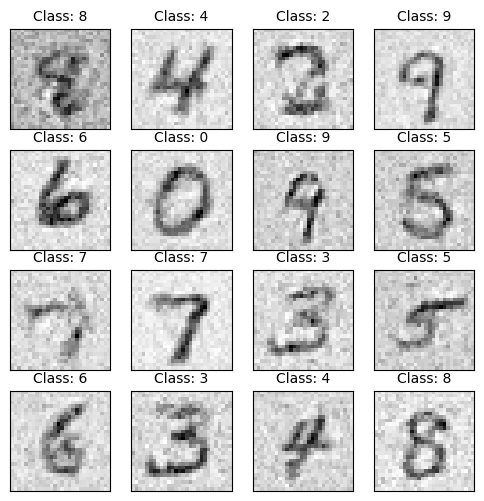

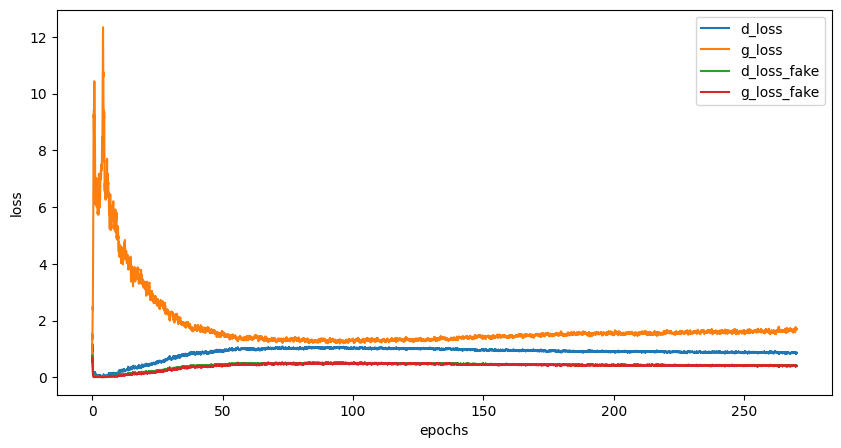

Epoch [271/500], Step[100/469], d_loss: 0.9546, d_loss_fake: 0.4512, g_loss: 1.7584, g_loss_fake: 0.2965, D(x): 0.69, D(G(z)): 0.29
Epoch [271/500], Step[200/469], d_loss: 0.8403, d_loss_fake: 0.4787, g_loss: 2.0147, g_loss_fake: 0.3744, D(x): 0.76, D(G(z)): 0.31
Epoch [271/500], Step[300/469], d_loss: 0.8605, d_loss_fake: 0.4300, g_loss: 1.7379, g_loss_fake: 0.3709, D(x): 0.74, D(G(z)): 0.30
Epoch [271/500], Step[400/469], d_loss: 0.8306, d_loss_fake: 0.4154, g_loss: 1.7617, g_loss_fake: 0.3525, D(x): 0.73, D(G(z)): 0.29


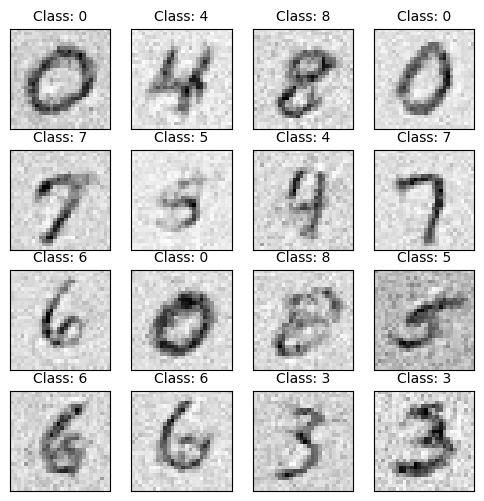

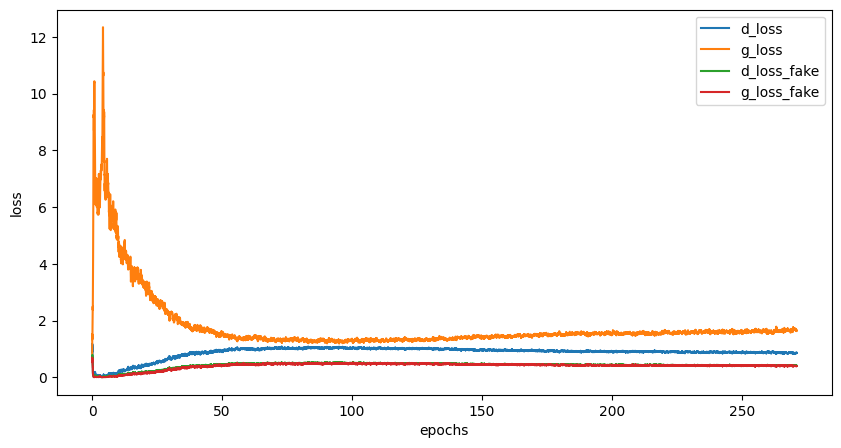

Epoch [272/500], Step[100/469], d_loss: 0.9648, d_loss_fake: 0.4956, g_loss: 1.7343, g_loss_fake: 0.4292, D(x): 0.71, D(G(z)): 0.30
Epoch [272/500], Step[200/469], d_loss: 0.7466, d_loss_fake: 0.4615, g_loss: 1.5444, g_loss_fake: 0.3675, D(x): 0.80, D(G(z)): 0.29
Epoch [272/500], Step[300/469], d_loss: 0.8089, d_loss_fake: 0.5099, g_loss: 1.4191, g_loss_fake: 0.4227, D(x): 0.78, D(G(z)): 0.32
Epoch [272/500], Step[400/469], d_loss: 0.8341, d_loss_fake: 0.4560, g_loss: 1.6065, g_loss_fake: 0.4118, D(x): 0.75, D(G(z)): 0.30


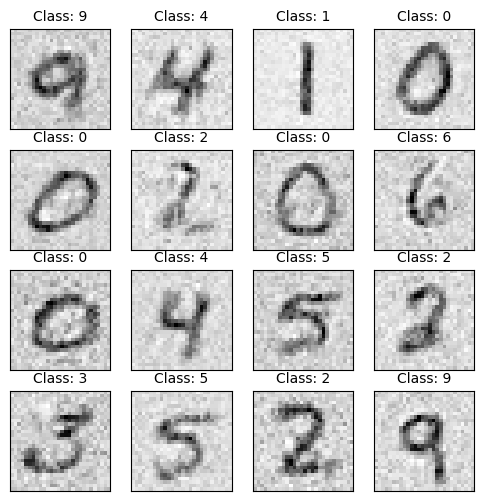

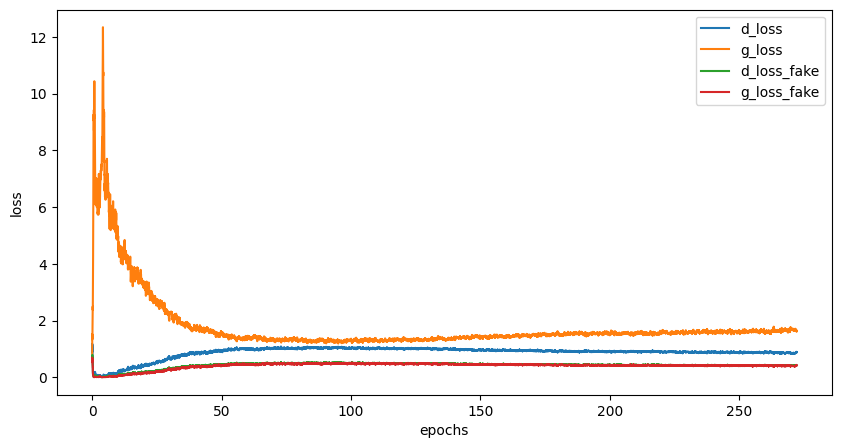

Epoch [273/500], Step[100/469], d_loss: 0.9050, d_loss_fake: 0.4159, g_loss: 1.8379, g_loss_fake: 0.2839, D(x): 0.69, D(G(z)): 0.28
Epoch [273/500], Step[200/469], d_loss: 0.8004, d_loss_fake: 0.3485, g_loss: 1.6358, g_loss_fake: 0.4264, D(x): 0.73, D(G(z)): 0.26
Epoch [273/500], Step[300/469], d_loss: 0.8143, d_loss_fake: 0.3862, g_loss: 2.0407, g_loss_fake: 0.3769, D(x): 0.72, D(G(z)): 0.26
Epoch [273/500], Step[400/469], d_loss: 0.8880, d_loss_fake: 0.4021, g_loss: 1.9266, g_loss_fake: 0.3527, D(x): 0.70, D(G(z)): 0.28


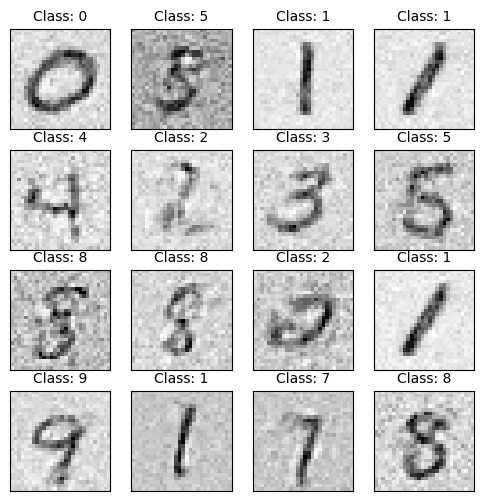

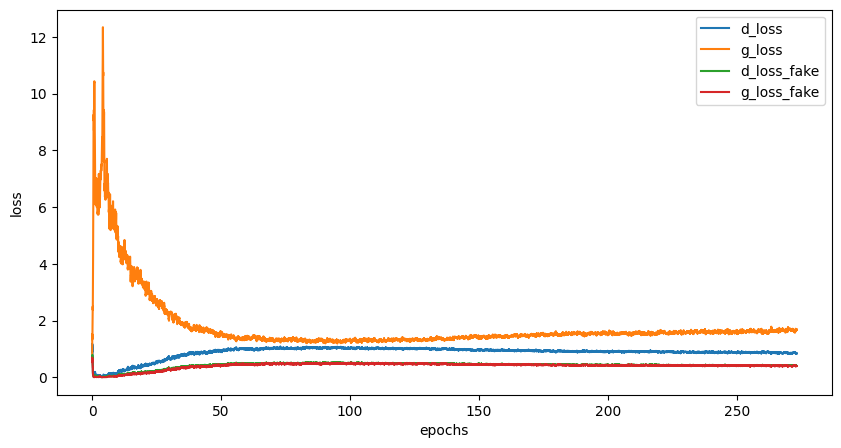

Epoch [274/500], Step[100/469], d_loss: 0.8446, d_loss_fake: 0.4148, g_loss: 1.4468, g_loss_fake: 0.4737, D(x): 0.72, D(G(z)): 0.29
Epoch [274/500], Step[200/469], d_loss: 0.7502, d_loss_fake: 0.3271, g_loss: 1.7466, g_loss_fake: 0.3760, D(x): 0.72, D(G(z)): 0.25
Epoch [274/500], Step[300/469], d_loss: 0.7749, d_loss_fake: 0.3981, g_loss: 1.5893, g_loss_fake: 0.4274, D(x): 0.75, D(G(z)): 0.29
Epoch [274/500], Step[400/469], d_loss: 0.9536, d_loss_fake: 0.4703, g_loss: 1.6761, g_loss_fake: 0.3989, D(x): 0.71, D(G(z)): 0.32


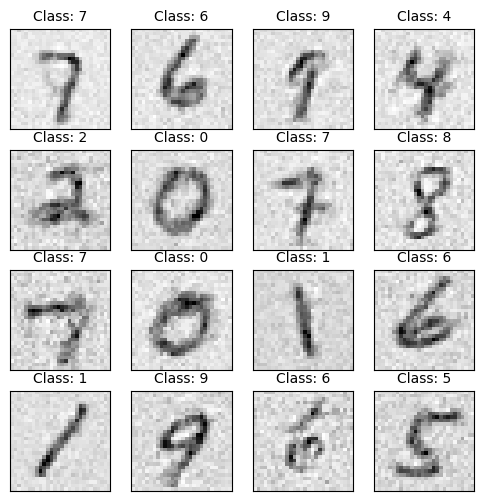

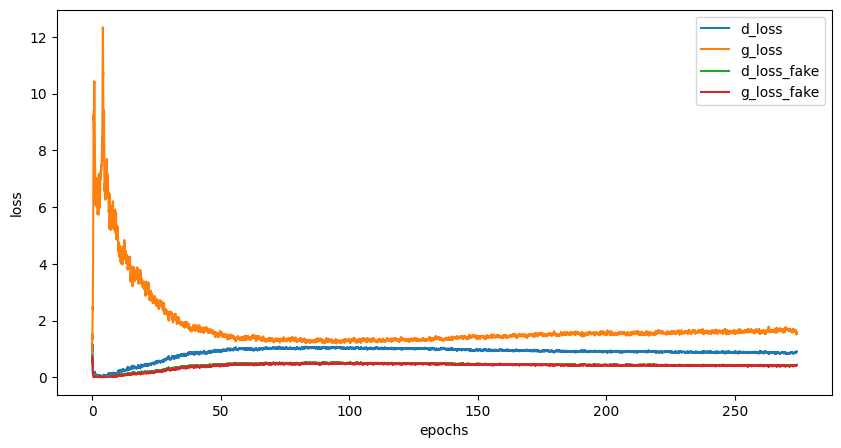

Epoch [275/500], Step[100/469], d_loss: 0.9118, d_loss_fake: 0.3860, g_loss: 1.7034, g_loss_fake: 0.3903, D(x): 0.68, D(G(z)): 0.27
Epoch [275/500], Step[200/469], d_loss: 0.8008, d_loss_fake: 0.4162, g_loss: 1.5840, g_loss_fake: 0.4757, D(x): 0.75, D(G(z)): 0.29
Epoch [275/500], Step[300/469], d_loss: 0.8227, d_loss_fake: 0.3944, g_loss: 1.5303, g_loss_fake: 0.4898, D(x): 0.72, D(G(z)): 0.28
Epoch [275/500], Step[400/469], d_loss: 0.9719, d_loss_fake: 0.5885, g_loss: 1.4065, g_loss_fake: 0.4741, D(x): 0.76, D(G(z)): 0.36


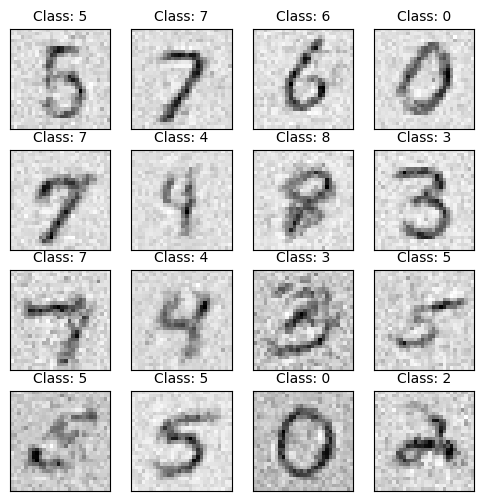

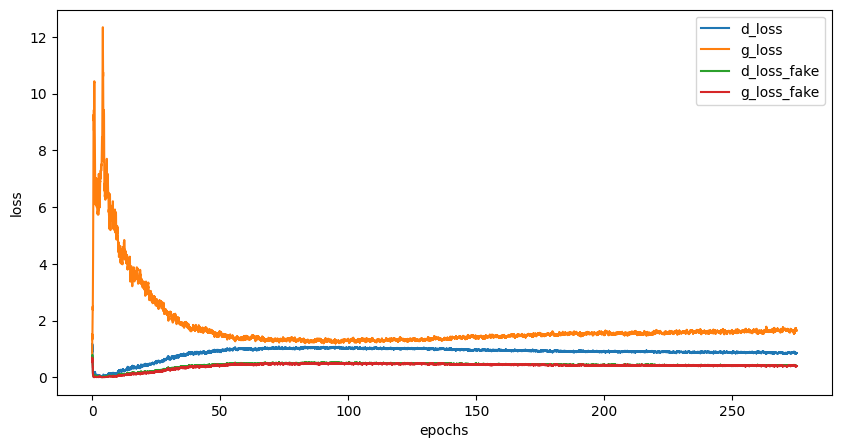

Epoch [276/500], Step[100/469], d_loss: 0.8979, d_loss_fake: 0.4931, g_loss: 1.8063, g_loss_fake: 0.3931, D(x): 0.74, D(G(z)): 0.31
Epoch [276/500], Step[200/469], d_loss: 0.8594, d_loss_fake: 0.4076, g_loss: 1.6838, g_loss_fake: 0.3852, D(x): 0.71, D(G(z)): 0.28
Epoch [276/500], Step[300/469], d_loss: 0.8103, d_loss_fake: 0.4901, g_loss: 1.4397, g_loss_fake: 0.4552, D(x): 0.77, D(G(z)): 0.33
Epoch [276/500], Step[400/469], d_loss: 0.8689, d_loss_fake: 0.3758, g_loss: 1.7344, g_loss_fake: 0.3739, D(x): 0.68, D(G(z)): 0.28


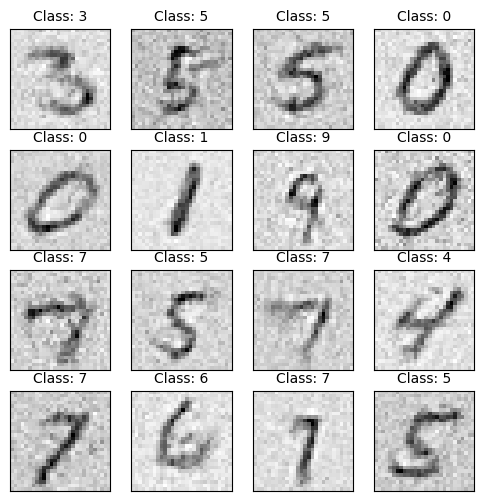

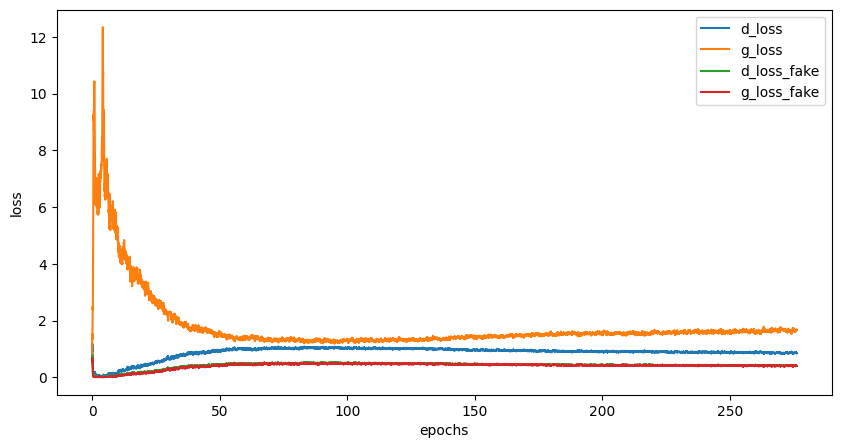

Epoch [277/500], Step[100/469], d_loss: 0.7839, d_loss_fake: 0.4076, g_loss: 1.8812, g_loss_fake: 0.3768, D(x): 0.75, D(G(z)): 0.29
Epoch [277/500], Step[200/469], d_loss: 0.9112, d_loss_fake: 0.3996, g_loss: 1.4106, g_loss_fake: 0.4779, D(x): 0.69, D(G(z)): 0.28
Epoch [277/500], Step[300/469], d_loss: 0.9939, d_loss_fake: 0.4406, g_loss: 1.4463, g_loss_fake: 0.4380, D(x): 0.68, D(G(z)): 0.30
Epoch [277/500], Step[400/469], d_loss: 0.7792, d_loss_fake: 0.4092, g_loss: 1.5214, g_loss_fake: 0.4355, D(x): 0.77, D(G(z)): 0.29


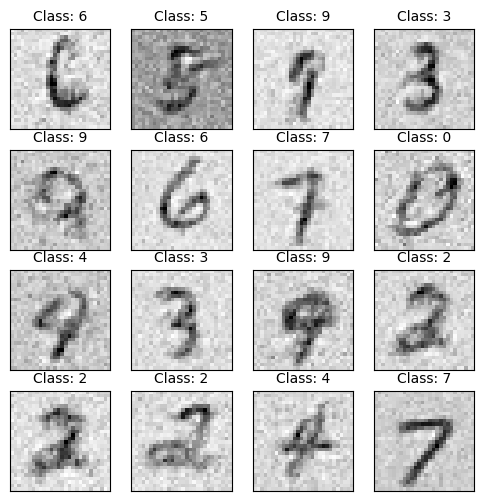

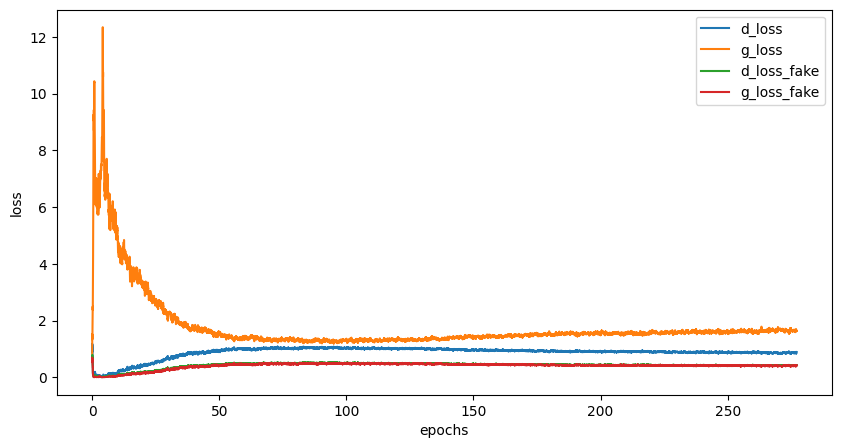

Epoch [278/500], Step[100/469], d_loss: 0.8877, d_loss_fake: 0.3704, g_loss: 1.6570, g_loss_fake: 0.3634, D(x): 0.68, D(G(z)): 0.26
Epoch [278/500], Step[200/469], d_loss: 0.8710, d_loss_fake: 0.4013, g_loss: 1.8221, g_loss_fake: 0.2964, D(x): 0.71, D(G(z)): 0.27
Epoch [278/500], Step[300/469], d_loss: 0.7099, d_loss_fake: 0.3275, g_loss: 1.7360, g_loss_fake: 0.3841, D(x): 0.75, D(G(z)): 0.24
Epoch [278/500], Step[400/469], d_loss: 0.9722, d_loss_fake: 0.4902, g_loss: 1.6221, g_loss_fake: 0.3966, D(x): 0.70, D(G(z)): 0.32


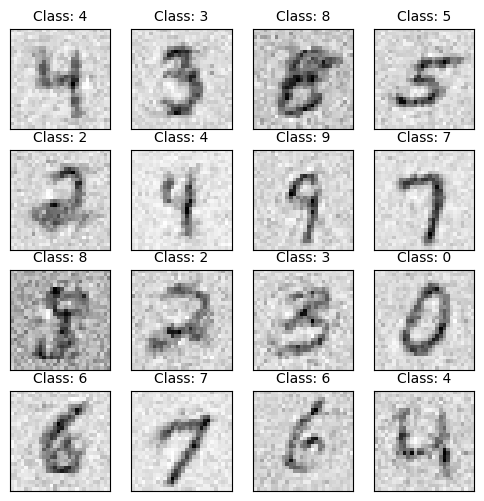

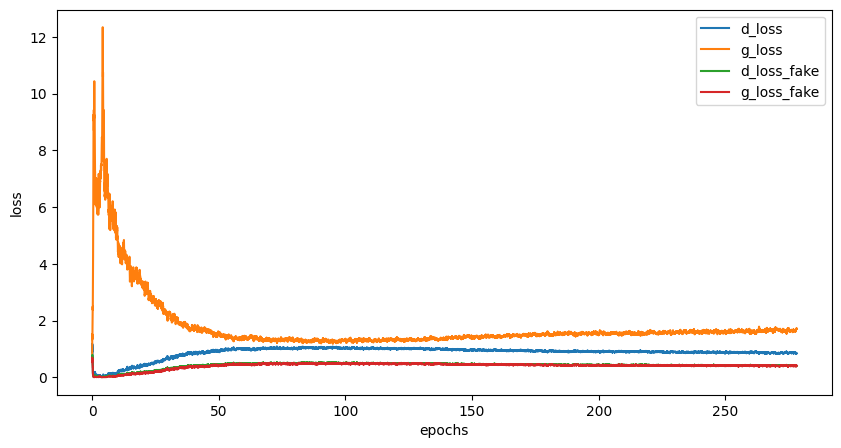

Epoch [279/500], Step[100/469], d_loss: 0.7028, d_loss_fake: 0.3570, g_loss: 1.8842, g_loss_fake: 0.3014, D(x): 0.76, D(G(z)): 0.27
Epoch [279/500], Step[200/469], d_loss: 0.7820, d_loss_fake: 0.4134, g_loss: 1.4170, g_loss_fake: 0.4879, D(x): 0.77, D(G(z)): 0.29
Epoch [279/500], Step[300/469], d_loss: 0.8144, d_loss_fake: 0.3730, g_loss: 1.5076, g_loss_fake: 0.4085, D(x): 0.72, D(G(z)): 0.27
Epoch [279/500], Step[400/469], d_loss: 0.8483, d_loss_fake: 0.4400, g_loss: 1.6652, g_loss_fake: 0.4147, D(x): 0.76, D(G(z)): 0.29


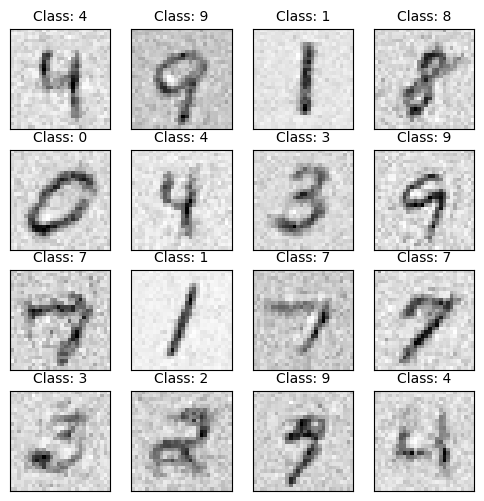

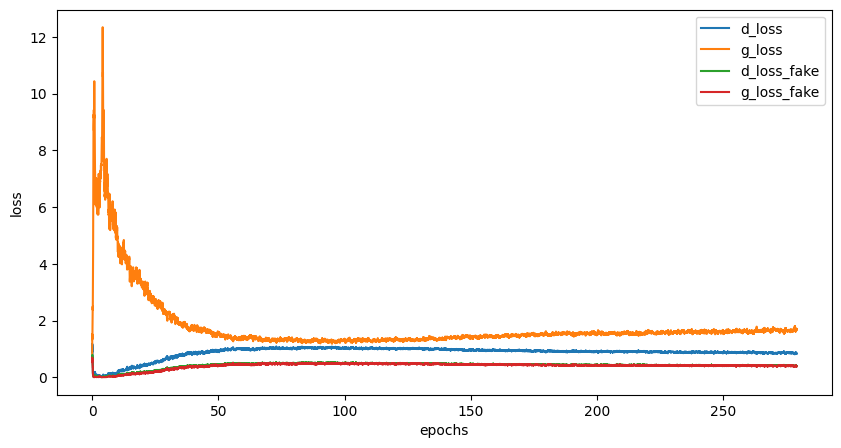

Epoch [280/500], Step[100/469], d_loss: 0.7534, d_loss_fake: 0.3800, g_loss: 1.5767, g_loss_fake: 0.4166, D(x): 0.76, D(G(z)): 0.27
Epoch [280/500], Step[200/469], d_loss: 0.9400, d_loss_fake: 0.4870, g_loss: 1.7312, g_loss_fake: 0.4075, D(x): 0.72, D(G(z)): 0.31
Epoch [280/500], Step[300/469], d_loss: 0.7156, d_loss_fake: 0.4173, g_loss: 1.5777, g_loss_fake: 0.4374, D(x): 0.79, D(G(z)): 0.29
Epoch [280/500], Step[400/469], d_loss: 0.8253, d_loss_fake: 0.4244, g_loss: 1.6470, g_loss_fake: 0.4215, D(x): 0.76, D(G(z)): 0.29


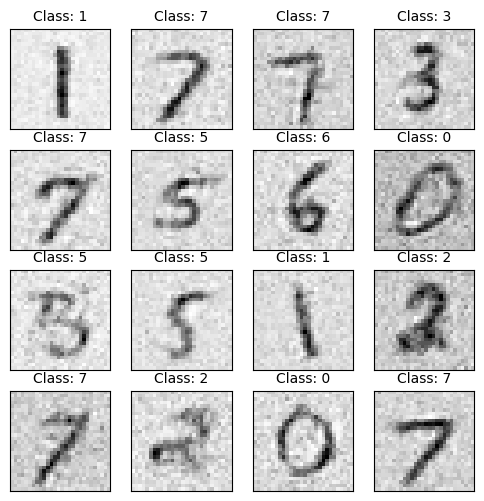

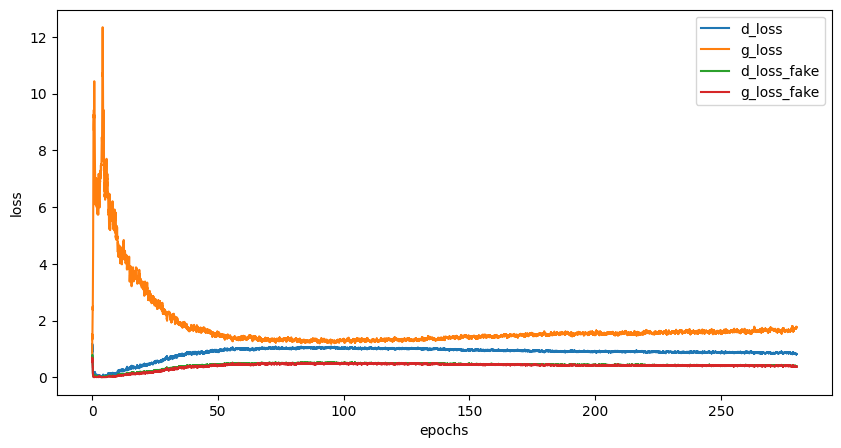

Epoch [281/500], Step[100/469], d_loss: 0.8350, d_loss_fake: 0.3797, g_loss: 1.6763, g_loss_fake: 0.4312, D(x): 0.72, D(G(z)): 0.26
Epoch [281/500], Step[200/469], d_loss: 0.7854, d_loss_fake: 0.4309, g_loss: 1.4989, g_loss_fake: 0.4969, D(x): 0.76, D(G(z)): 0.29
Epoch [281/500], Step[300/469], d_loss: 0.8596, d_loss_fake: 0.3590, g_loss: 1.6948, g_loss_fake: 0.3802, D(x): 0.71, D(G(z)): 0.25
Epoch [281/500], Step[400/469], d_loss: 0.7942, d_loss_fake: 0.3925, g_loss: 1.6203, g_loss_fake: 0.4058, D(x): 0.74, D(G(z)): 0.28


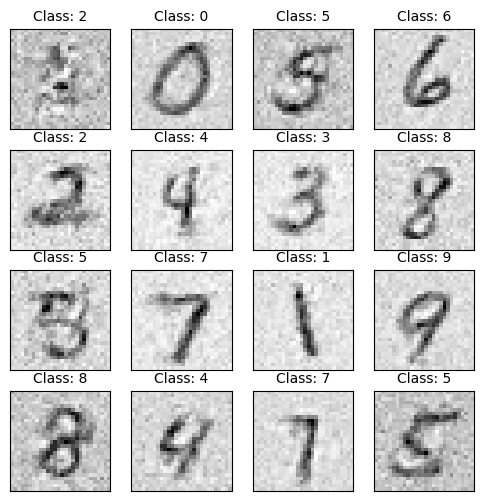

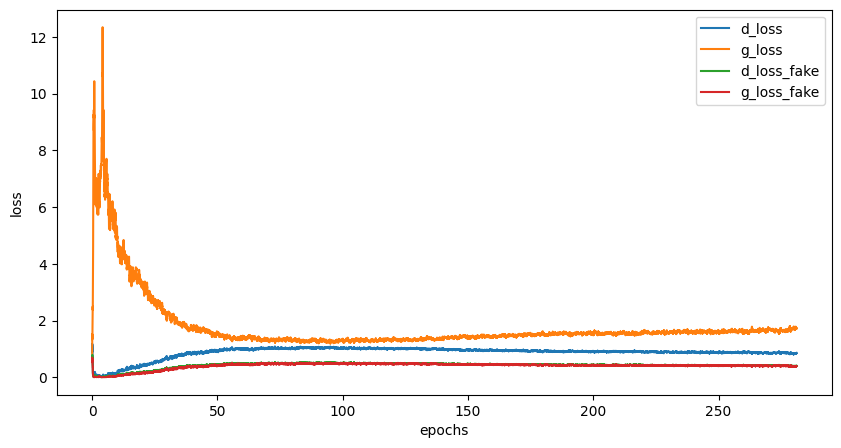

Epoch [282/500], Step[100/469], d_loss: 0.8620, d_loss_fake: 0.4261, g_loss: 1.5719, g_loss_fake: 0.3956, D(x): 0.73, D(G(z)): 0.29
Epoch [282/500], Step[200/469], d_loss: 0.9336, d_loss_fake: 0.4272, g_loss: 1.5669, g_loss_fake: 0.4173, D(x): 0.70, D(G(z)): 0.30
Epoch [282/500], Step[300/469], d_loss: 0.8239, d_loss_fake: 0.4145, g_loss: 1.6630, g_loss_fake: 0.3798, D(x): 0.74, D(G(z)): 0.28
Epoch [282/500], Step[400/469], d_loss: 0.8119, d_loss_fake: 0.4241, g_loss: 1.4910, g_loss_fake: 0.4387, D(x): 0.75, D(G(z)): 0.29


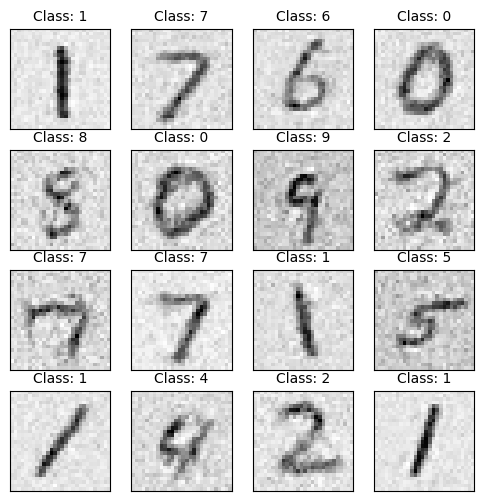

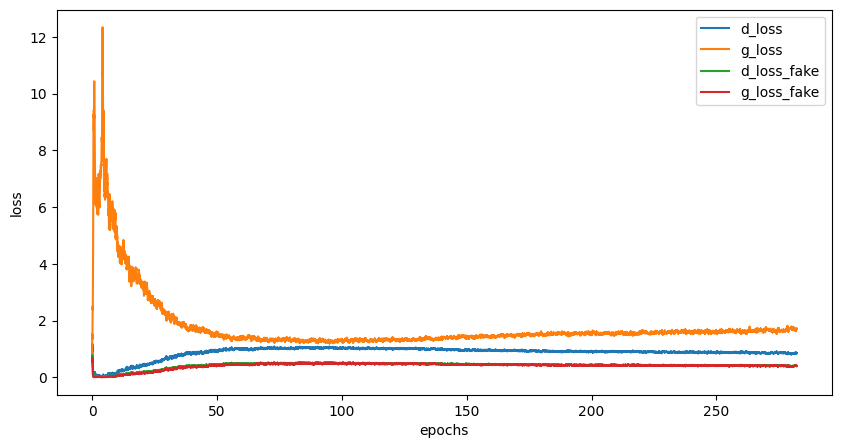

Epoch [283/500], Step[100/469], d_loss: 0.8092, d_loss_fake: 0.4392, g_loss: 1.6151, g_loss_fake: 0.4101, D(x): 0.75, D(G(z)): 0.30
Epoch [283/500], Step[200/469], d_loss: 0.6757, d_loss_fake: 0.3438, g_loss: 1.6504, g_loss_fake: 0.3906, D(x): 0.77, D(G(z)): 0.25
Epoch [283/500], Step[300/469], d_loss: 0.7931, d_loss_fake: 0.3210, g_loss: 1.9052, g_loss_fake: 0.3900, D(x): 0.70, D(G(z)): 0.24
Epoch [283/500], Step[400/469], d_loss: 0.8254, d_loss_fake: 0.4010, g_loss: 1.6397, g_loss_fake: 0.3707, D(x): 0.72, D(G(z)): 0.27


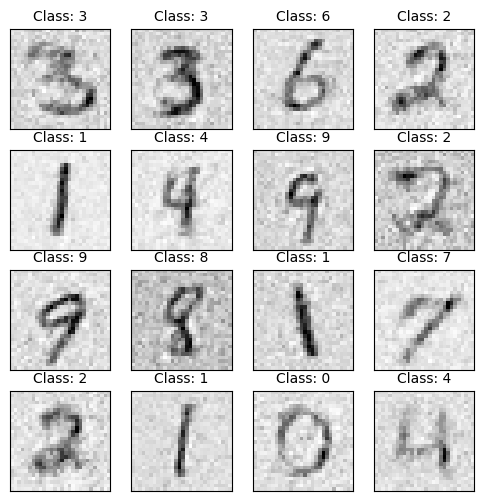

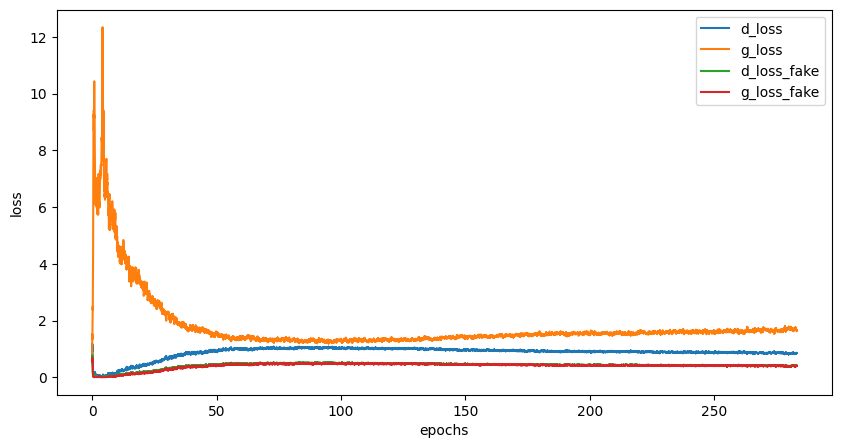

Epoch [284/500], Step[100/469], d_loss: 0.7626, d_loss_fake: 0.3580, g_loss: 1.6636, g_loss_fake: 0.4090, D(x): 0.74, D(G(z)): 0.27
Epoch [284/500], Step[200/469], d_loss: 1.0930, d_loss_fake: 0.5711, g_loss: 1.4859, g_loss_fake: 0.5105, D(x): 0.70, D(G(z)): 0.36
Epoch [284/500], Step[300/469], d_loss: 0.9181, d_loss_fake: 0.4719, g_loss: 1.4677, g_loss_fake: 0.5041, D(x): 0.71, D(G(z)): 0.30
Epoch [284/500], Step[400/469], d_loss: 0.9400, d_loss_fake: 0.4974, g_loss: 1.6407, g_loss_fake: 0.4137, D(x): 0.72, D(G(z)): 0.31


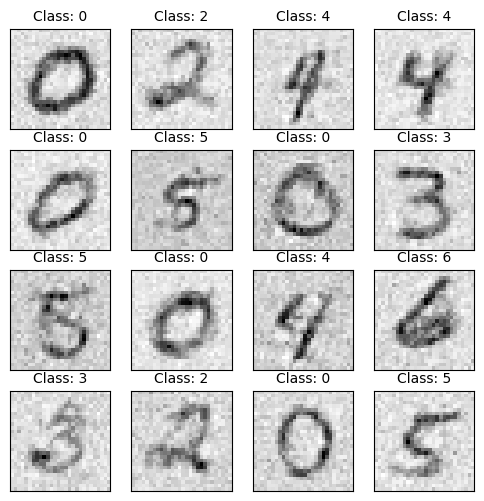

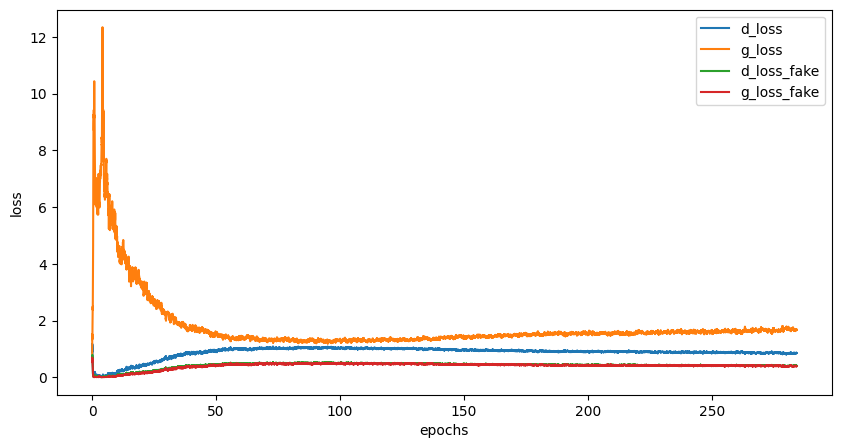

Epoch [285/500], Step[100/469], d_loss: 0.8609, d_loss_fake: 0.3723, g_loss: 1.6214, g_loss_fake: 0.3512, D(x): 0.70, D(G(z)): 0.27
Epoch [285/500], Step[200/469], d_loss: 0.8939, d_loss_fake: 0.3247, g_loss: 2.0133, g_loss_fake: 0.3572, D(x): 0.67, D(G(z)): 0.23
Epoch [285/500], Step[300/469], d_loss: 0.8391, d_loss_fake: 0.4990, g_loss: 1.4397, g_loss_fake: 0.4445, D(x): 0.77, D(G(z)): 0.32
Epoch [285/500], Step[400/469], d_loss: 0.8577, d_loss_fake: 0.3465, g_loss: 1.8440, g_loss_fake: 0.3338, D(x): 0.69, D(G(z)): 0.25


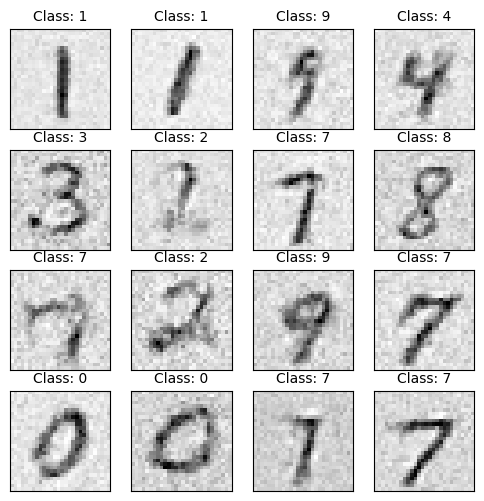

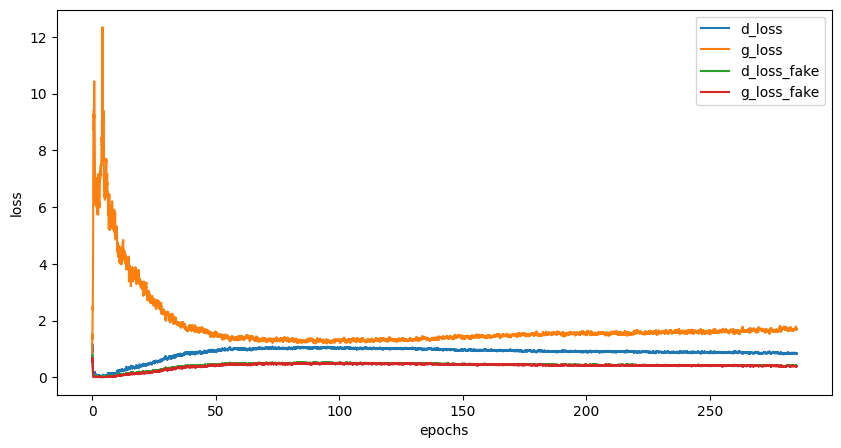

Epoch [286/500], Step[100/469], d_loss: 0.8333, d_loss_fake: 0.3581, g_loss: 1.6734, g_loss_fake: 0.4416, D(x): 0.72, D(G(z)): 0.25
Epoch [286/500], Step[200/469], d_loss: 0.8248, d_loss_fake: 0.3168, g_loss: 1.7533, g_loss_fake: 0.4569, D(x): 0.69, D(G(z)): 0.24
Epoch [286/500], Step[300/469], d_loss: 0.7509, d_loss_fake: 0.3568, g_loss: 1.6495, g_loss_fake: 0.4062, D(x): 0.74, D(G(z)): 0.26
Epoch [286/500], Step[400/469], d_loss: 0.8869, d_loss_fake: 0.4028, g_loss: 1.7540, g_loss_fake: 0.3699, D(x): 0.70, D(G(z)): 0.28


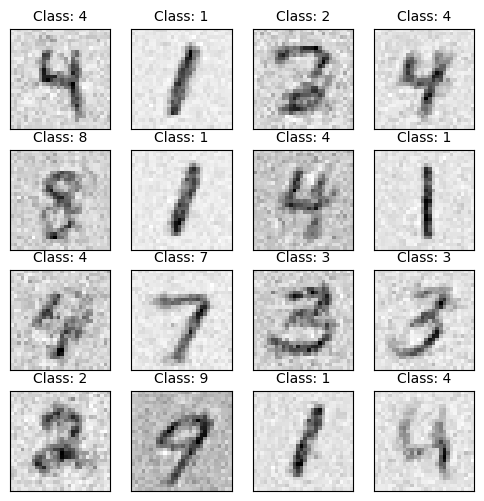

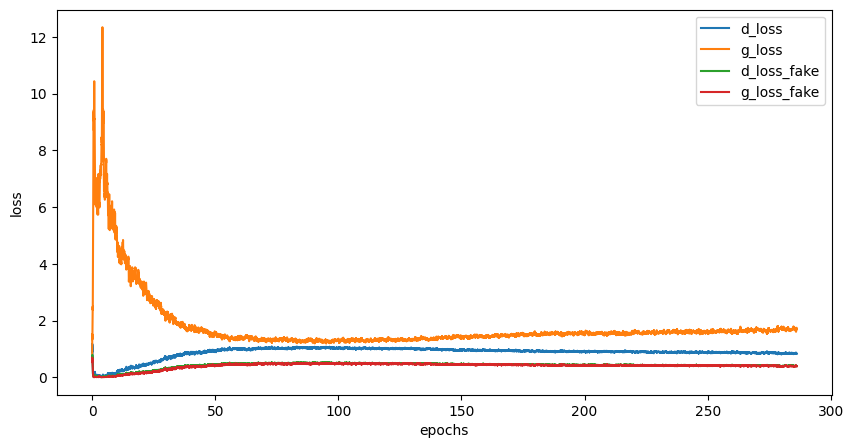

Epoch [287/500], Step[100/469], d_loss: 0.8052, d_loss_fake: 0.3983, g_loss: 1.6222, g_loss_fake: 0.4210, D(x): 0.74, D(G(z)): 0.28
Epoch [287/500], Step[200/469], d_loss: 0.8943, d_loss_fake: 0.4463, g_loss: 1.4481, g_loss_fake: 0.4427, D(x): 0.72, D(G(z)): 0.31
Epoch [287/500], Step[300/469], d_loss: 0.9547, d_loss_fake: 0.4006, g_loss: 1.5897, g_loss_fake: 0.4136, D(x): 0.68, D(G(z)): 0.28
Epoch [287/500], Step[400/469], d_loss: 0.8959, d_loss_fake: 0.4254, g_loss: 1.6874, g_loss_fake: 0.3930, D(x): 0.71, D(G(z)): 0.29


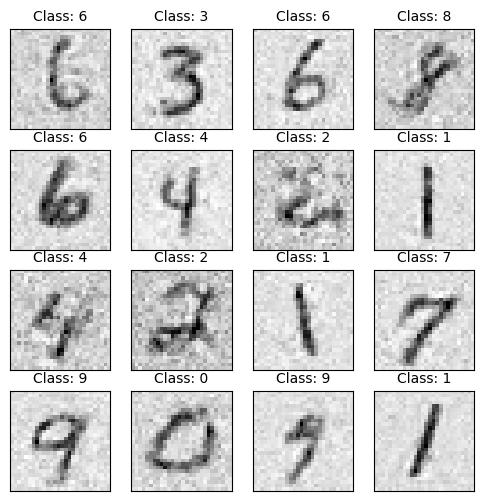

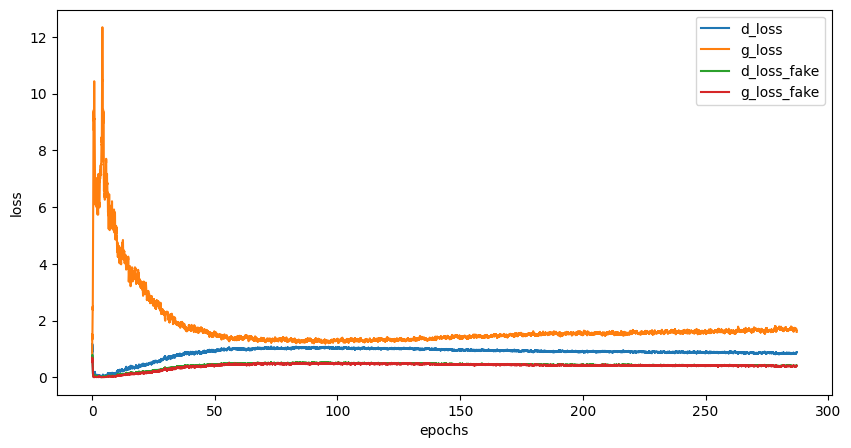

Epoch [288/500], Step[100/469], d_loss: 0.7767, d_loss_fake: 0.3979, g_loss: 1.6809, g_loss_fake: 0.3279, D(x): 0.76, D(G(z)): 0.26
Epoch [288/500], Step[200/469], d_loss: 0.8814, d_loss_fake: 0.4200, g_loss: 1.6610, g_loss_fake: 0.4074, D(x): 0.71, D(G(z)): 0.27
Epoch [288/500], Step[300/469], d_loss: 0.9481, d_loss_fake: 0.3926, g_loss: 1.6910, g_loss_fake: 0.3441, D(x): 0.68, D(G(z)): 0.27
Epoch [288/500], Step[400/469], d_loss: 0.9621, d_loss_fake: 0.4259, g_loss: 1.4982, g_loss_fake: 0.4636, D(x): 0.68, D(G(z)): 0.30


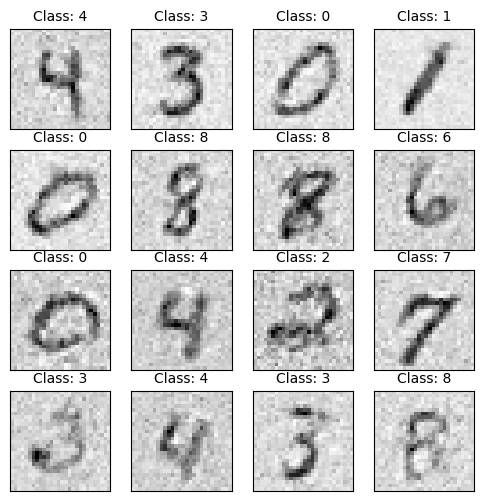

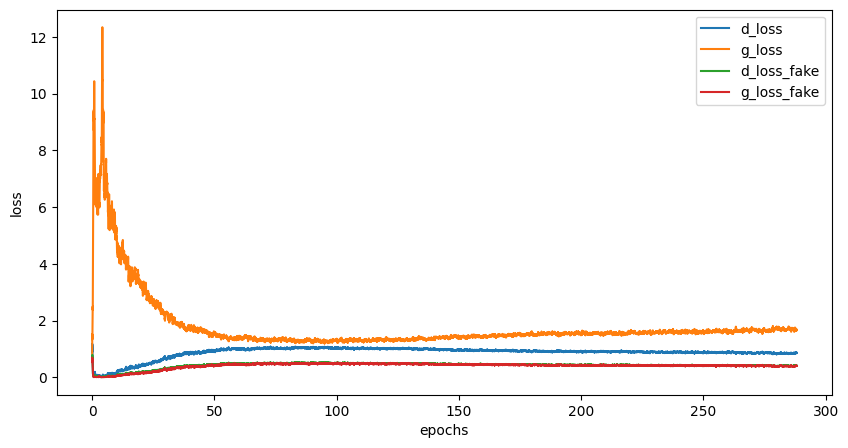

Epoch [289/500], Step[100/469], d_loss: 0.8089, d_loss_fake: 0.4066, g_loss: 1.7581, g_loss_fake: 0.3053, D(x): 0.74, D(G(z)): 0.27
Epoch [289/500], Step[200/469], d_loss: 0.9619, d_loss_fake: 0.4546, g_loss: 1.4822, g_loss_fake: 0.4083, D(x): 0.69, D(G(z)): 0.32
Epoch [289/500], Step[300/469], d_loss: 0.7449, d_loss_fake: 0.3510, g_loss: 1.8825, g_loss_fake: 0.3304, D(x): 0.75, D(G(z)): 0.24
Epoch [289/500], Step[400/469], d_loss: 0.8346, d_loss_fake: 0.4762, g_loss: 1.8499, g_loss_fake: 0.3176, D(x): 0.78, D(G(z)): 0.31


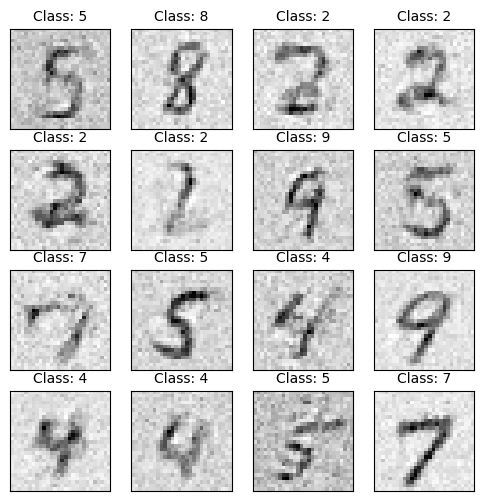

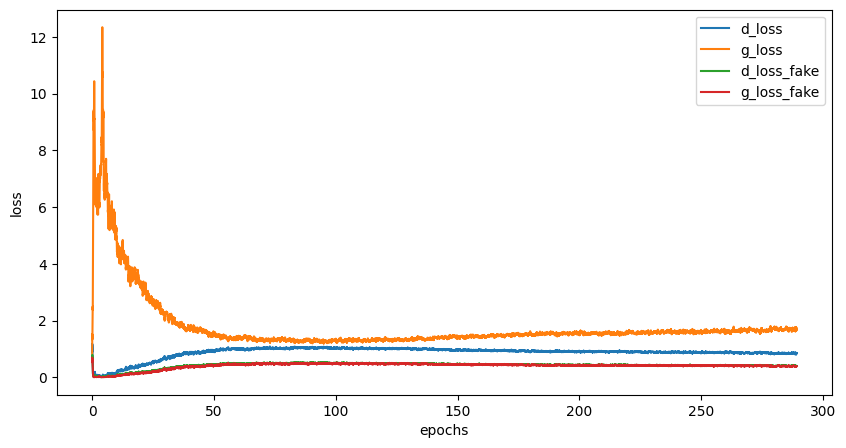

Epoch [290/500], Step[100/469], d_loss: 0.8375, d_loss_fake: 0.4008, g_loss: 1.7525, g_loss_fake: 0.4070, D(x): 0.73, D(G(z)): 0.28
Epoch [290/500], Step[200/469], d_loss: 0.7520, d_loss_fake: 0.2901, g_loss: 2.0000, g_loss_fake: 0.3457, D(x): 0.72, D(G(z)): 0.22
Epoch [290/500], Step[300/469], d_loss: 0.8443, d_loss_fake: 0.4836, g_loss: 1.7670, g_loss_fake: 0.3366, D(x): 0.77, D(G(z)): 0.30
Epoch [290/500], Step[400/469], d_loss: 0.8717, d_loss_fake: 0.3613, g_loss: 1.7499, g_loss_fake: 0.3643, D(x): 0.69, D(G(z)): 0.27


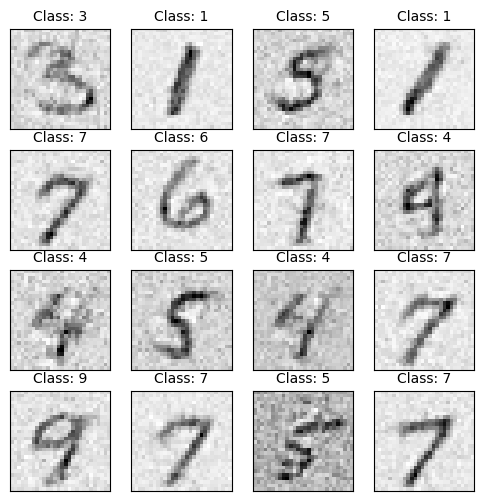

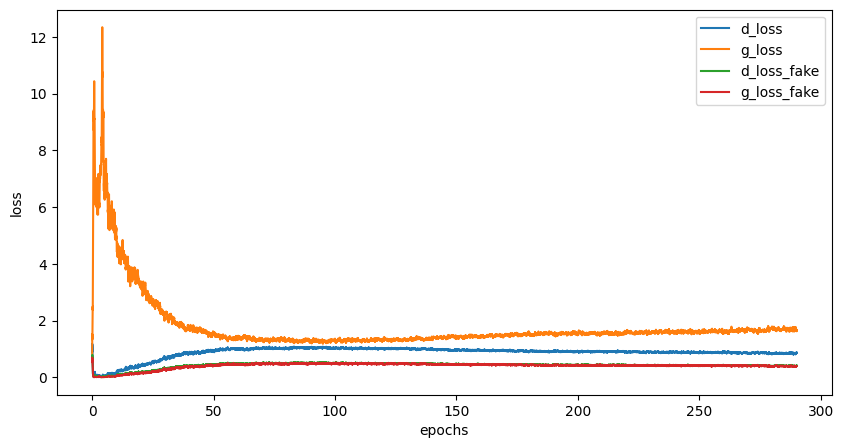

Epoch [291/500], Step[100/469], d_loss: 0.9389, d_loss_fake: 0.5268, g_loss: 1.6564, g_loss_fake: 0.4554, D(x): 0.75, D(G(z)): 0.33
Epoch [291/500], Step[200/469], d_loss: 0.7222, d_loss_fake: 0.3734, g_loss: 1.4984, g_loss_fake: 0.4586, D(x): 0.79, D(G(z)): 0.26
Epoch [291/500], Step[300/469], d_loss: 0.7132, d_loss_fake: 0.3174, g_loss: 1.6743, g_loss_fake: 0.3584, D(x): 0.75, D(G(z)): 0.23
Epoch [291/500], Step[400/469], d_loss: 0.7537, d_loss_fake: 0.3470, g_loss: 1.9272, g_loss_fake: 0.3446, D(x): 0.75, D(G(z)): 0.25


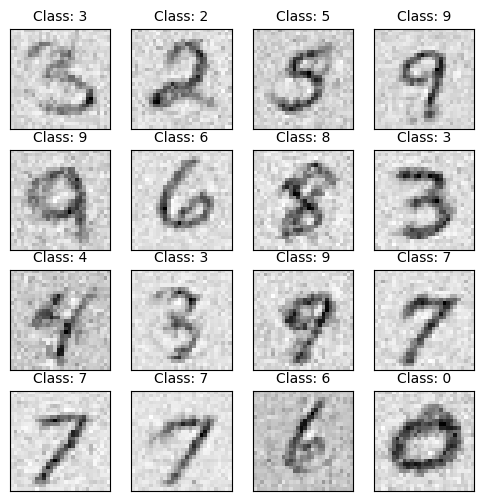

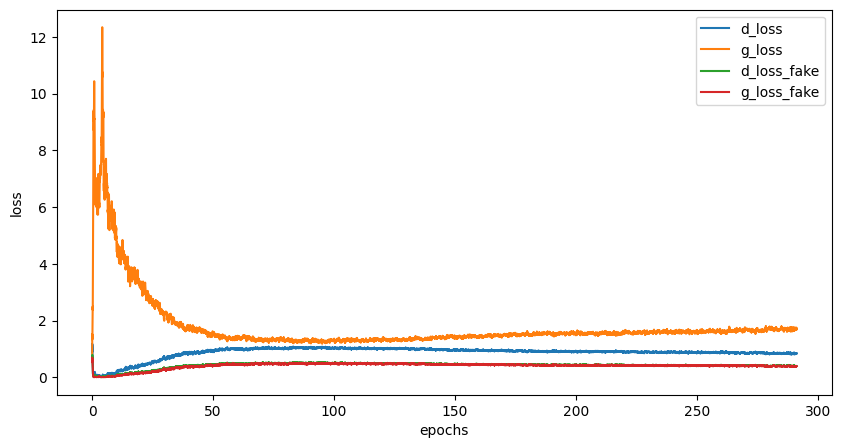

Epoch [292/500], Step[100/469], d_loss: 0.8618, d_loss_fake: 0.4589, g_loss: 1.6105, g_loss_fake: 0.3612, D(x): 0.74, D(G(z)): 0.31
Epoch [292/500], Step[200/469], d_loss: 0.7198, d_loss_fake: 0.3552, g_loss: 1.7364, g_loss_fake: 0.3741, D(x): 0.76, D(G(z)): 0.26
Epoch [292/500], Step[300/469], d_loss: 0.7810, d_loss_fake: 0.3502, g_loss: 1.9347, g_loss_fake: 0.3429, D(x): 0.74, D(G(z)): 0.24
Epoch [292/500], Step[400/469], d_loss: 0.8255, d_loss_fake: 0.4359, g_loss: 1.6040, g_loss_fake: 0.4524, D(x): 0.76, D(G(z)): 0.30


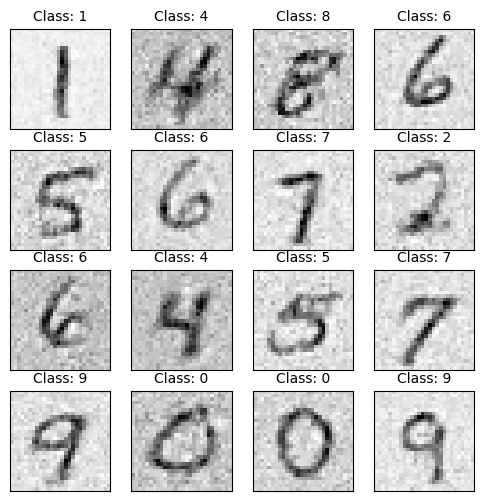

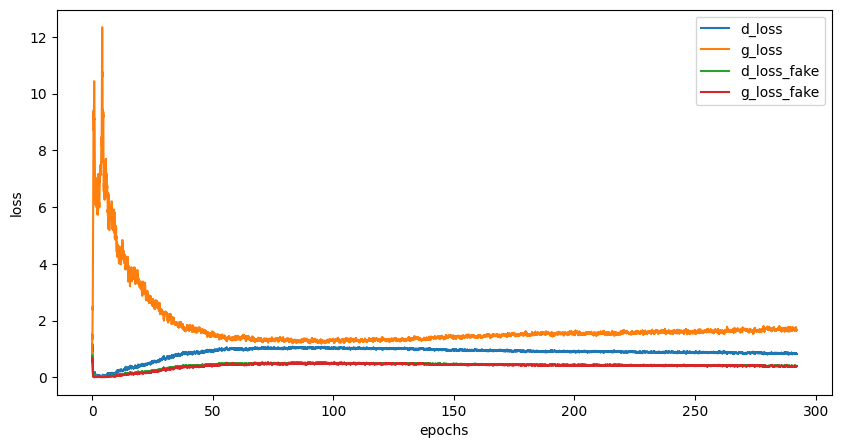

Epoch [293/500], Step[100/469], d_loss: 0.9509, d_loss_fake: 0.4988, g_loss: 1.7551, g_loss_fake: 0.3851, D(x): 0.72, D(G(z)): 0.30
Epoch [293/500], Step[200/469], d_loss: 0.7504, d_loss_fake: 0.4047, g_loss: 1.5707, g_loss_fake: 0.4063, D(x): 0.77, D(G(z)): 0.28
Epoch [293/500], Step[300/469], d_loss: 0.7971, d_loss_fake: 0.3541, g_loss: 1.7404, g_loss_fake: 0.3413, D(x): 0.72, D(G(z)): 0.25
Epoch [293/500], Step[400/469], d_loss: 0.9079, d_loss_fake: 0.5524, g_loss: 1.6984, g_loss_fake: 0.3931, D(x): 0.77, D(G(z)): 0.35


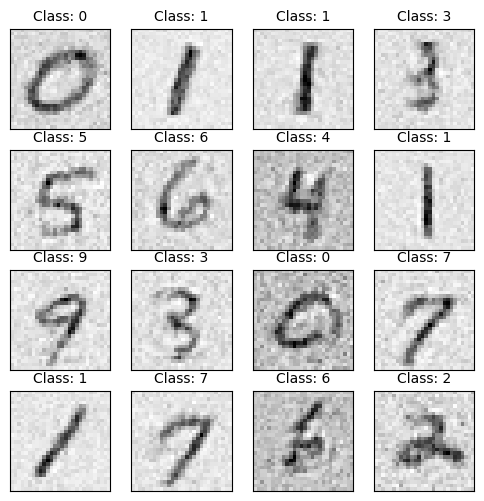

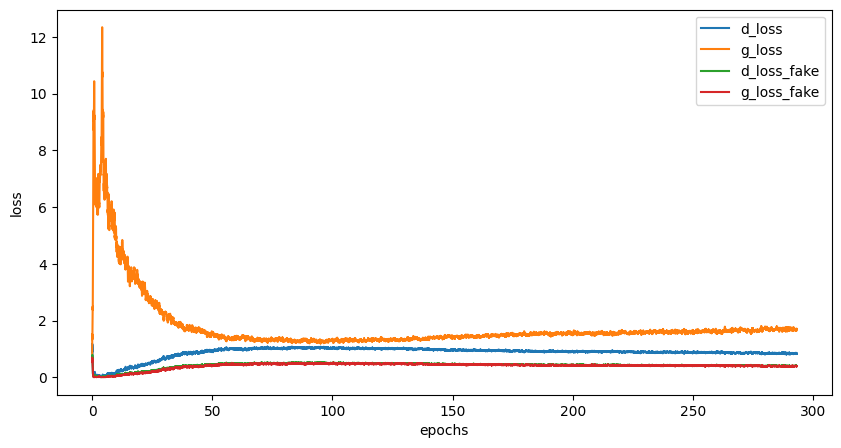

Epoch [294/500], Step[100/469], d_loss: 0.7619, d_loss_fake: 0.3373, g_loss: 1.6337, g_loss_fake: 0.4350, D(x): 0.73, D(G(z)): 0.24
Epoch [294/500], Step[200/469], d_loss: 0.9364, d_loss_fake: 0.5085, g_loss: 1.6566, g_loss_fake: 0.4435, D(x): 0.74, D(G(z)): 0.31
Epoch [294/500], Step[300/469], d_loss: 0.7936, d_loss_fake: 0.3772, g_loss: 1.6197, g_loss_fake: 0.3740, D(x): 0.74, D(G(z)): 0.27
Epoch [294/500], Step[400/469], d_loss: 0.8860, d_loss_fake: 0.3677, g_loss: 1.8678, g_loss_fake: 0.3304, D(x): 0.68, D(G(z)): 0.27


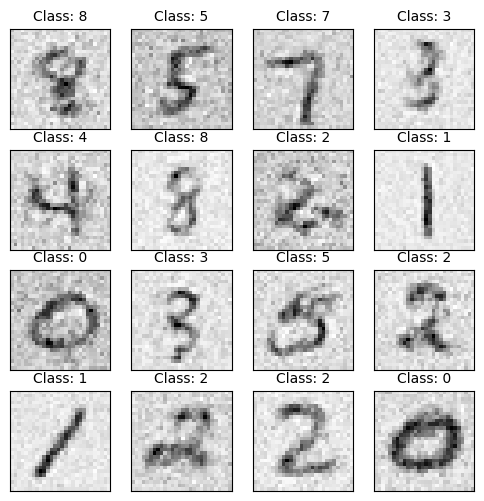

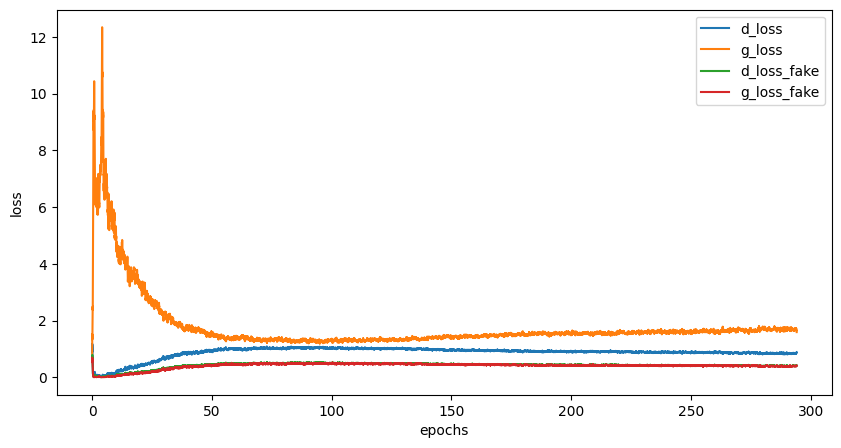

Epoch [295/500], Step[100/469], d_loss: 0.8465, d_loss_fake: 0.3868, g_loss: 1.5030, g_loss_fake: 0.4170, D(x): 0.71, D(G(z)): 0.28
Epoch [295/500], Step[200/469], d_loss: 0.8020, d_loss_fake: 0.4163, g_loss: 1.6316, g_loss_fake: 0.3888, D(x): 0.75, D(G(z)): 0.29
Epoch [295/500], Step[300/469], d_loss: 0.9724, d_loss_fake: 0.4143, g_loss: 1.7194, g_loss_fake: 0.3597, D(x): 0.66, D(G(z)): 0.28
Epoch [295/500], Step[400/469], d_loss: 0.8254, d_loss_fake: 0.3682, g_loss: 1.6672, g_loss_fake: 0.3991, D(x): 0.72, D(G(z)): 0.24


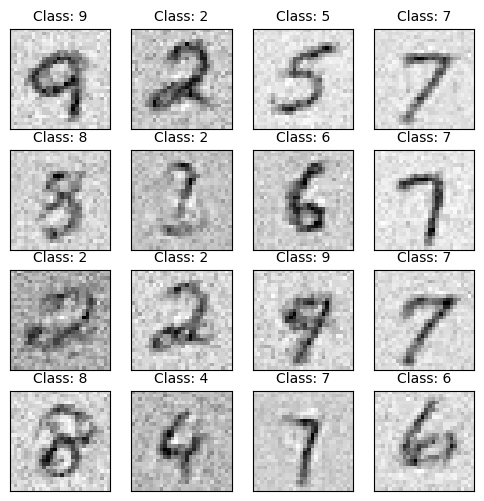

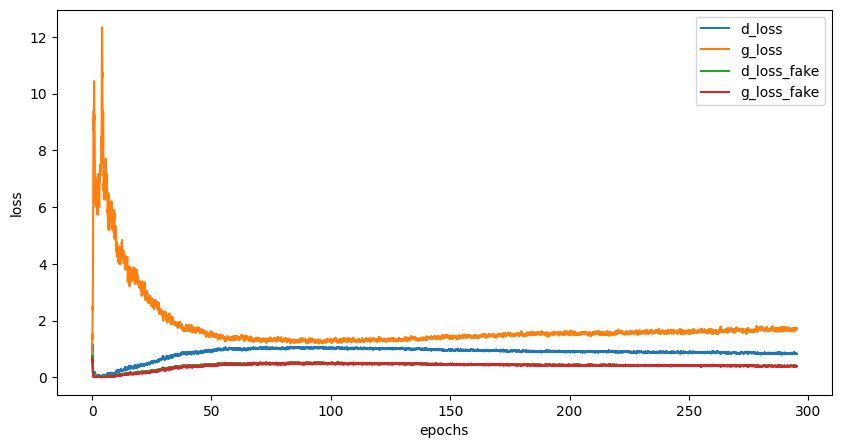

Epoch [296/500], Step[100/469], d_loss: 0.8280, d_loss_fake: 0.4048, g_loss: 1.7208, g_loss_fake: 0.3722, D(x): 0.73, D(G(z)): 0.28
Epoch [296/500], Step[200/469], d_loss: 0.7118, d_loss_fake: 0.3208, g_loss: 1.5785, g_loss_fake: 0.4435, D(x): 0.75, D(G(z)): 0.25
Epoch [296/500], Step[300/469], d_loss: 0.8802, d_loss_fake: 0.3335, g_loss: 1.7605, g_loss_fake: 0.4206, D(x): 0.68, D(G(z)): 0.24
Epoch [296/500], Step[400/469], d_loss: 0.8704, d_loss_fake: 0.3727, g_loss: 1.7614, g_loss_fake: 0.4156, D(x): 0.71, D(G(z)): 0.25


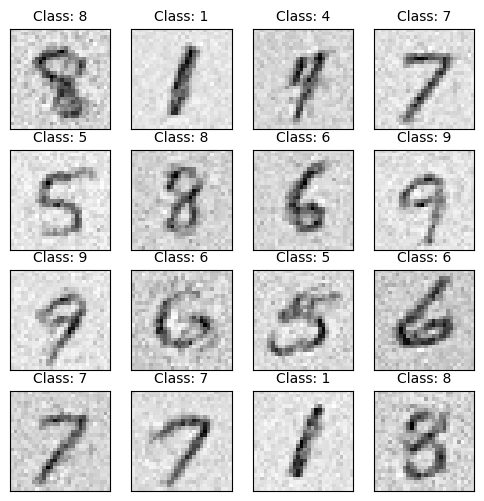

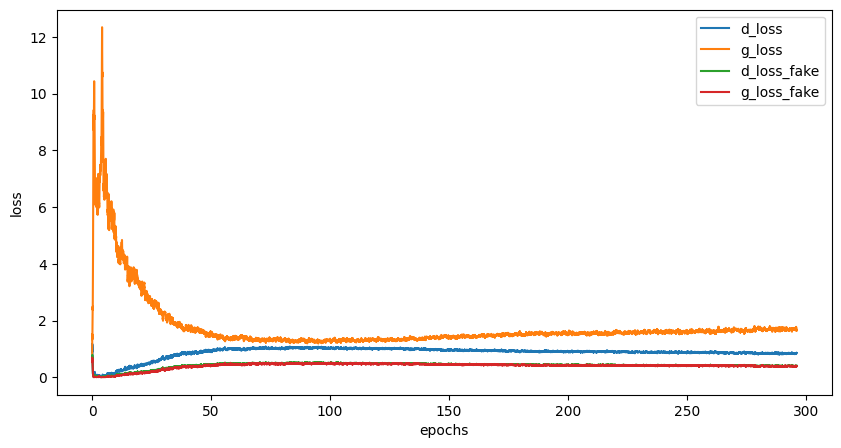

Epoch [297/500], Step[100/469], d_loss: 0.8413, d_loss_fake: 0.3663, g_loss: 1.5682, g_loss_fake: 0.4545, D(x): 0.72, D(G(z)): 0.27
Epoch [297/500], Step[200/469], d_loss: 0.8463, d_loss_fake: 0.3987, g_loss: 1.3811, g_loss_fake: 0.4715, D(x): 0.71, D(G(z)): 0.28
Epoch [297/500], Step[300/469], d_loss: 0.7997, d_loss_fake: 0.4592, g_loss: 1.3971, g_loss_fake: 0.5200, D(x): 0.78, D(G(z)): 0.32
Epoch [297/500], Step[400/469], d_loss: 0.7744, d_loss_fake: 0.3185, g_loss: 1.7284, g_loss_fake: 0.3726, D(x): 0.72, D(G(z)): 0.24


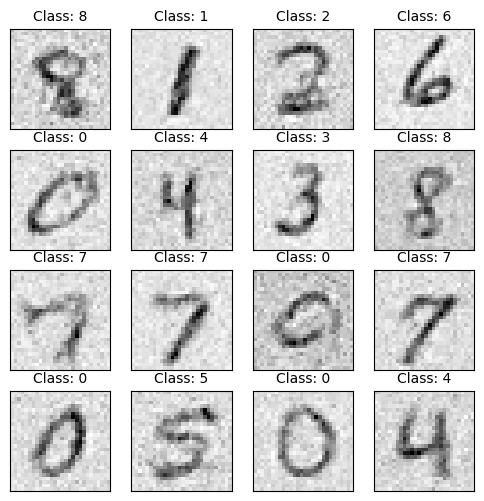

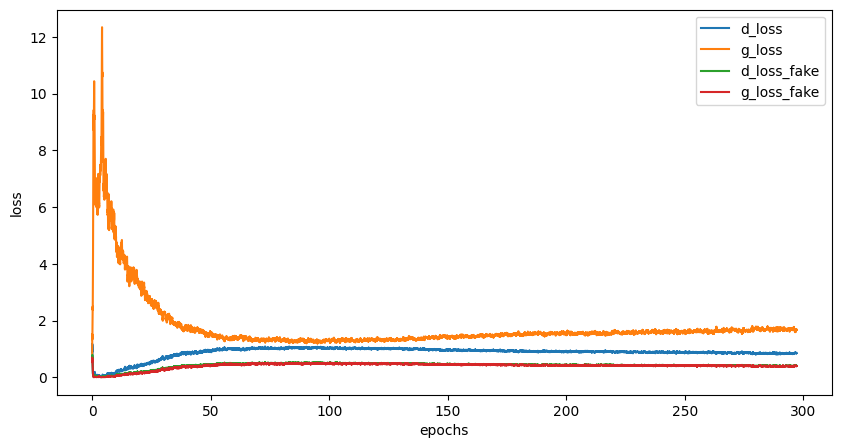

Epoch [298/500], Step[100/469], d_loss: 0.9472, d_loss_fake: 0.4981, g_loss: 1.4913, g_loss_fake: 0.5048, D(x): 0.72, D(G(z)): 0.32
Epoch [298/500], Step[200/469], d_loss: 0.7852, d_loss_fake: 0.4027, g_loss: 1.5691, g_loss_fake: 0.4406, D(x): 0.74, D(G(z)): 0.30
Epoch [298/500], Step[300/469], d_loss: 0.8641, d_loss_fake: 0.4504, g_loss: 1.6990, g_loss_fake: 0.4258, D(x): 0.74, D(G(z)): 0.30
Epoch [298/500], Step[400/469], d_loss: 0.8231, d_loss_fake: 0.2990, g_loss: 2.2041, g_loss_fake: 0.3235, D(x): 0.70, D(G(z)): 0.21


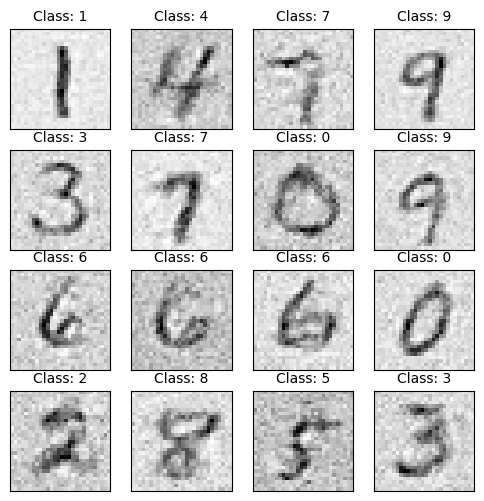

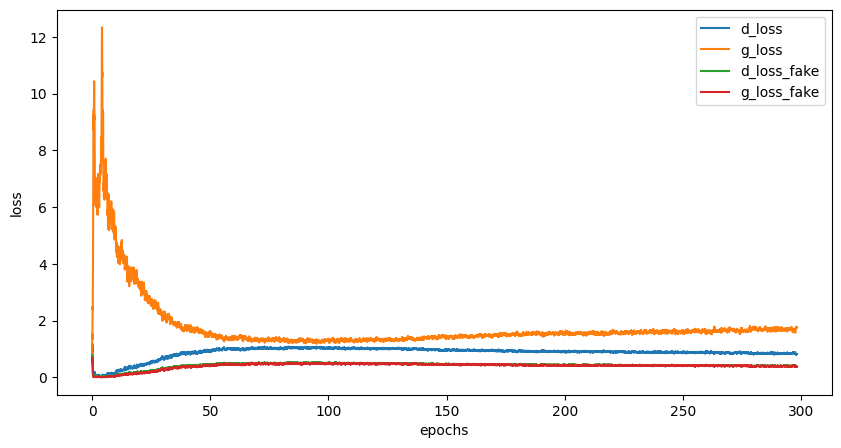

Epoch [299/500], Step[100/469], d_loss: 0.7847, d_loss_fake: 0.4210, g_loss: 1.4936, g_loss_fake: 0.4880, D(x): 0.76, D(G(z)): 0.28
Epoch [299/500], Step[200/469], d_loss: 0.8799, d_loss_fake: 0.3911, g_loss: 1.7644, g_loss_fake: 0.4215, D(x): 0.72, D(G(z)): 0.27
Epoch [299/500], Step[300/469], d_loss: 0.8985, d_loss_fake: 0.3769, g_loss: 1.5019, g_loss_fake: 0.4278, D(x): 0.69, D(G(z)): 0.26
Epoch [299/500], Step[400/469], d_loss: 0.8109, d_loss_fake: 0.3720, g_loss: 1.7715, g_loss_fake: 0.3754, D(x): 0.73, D(G(z)): 0.26


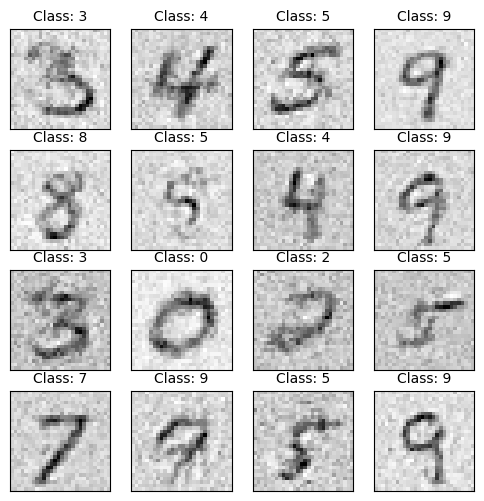

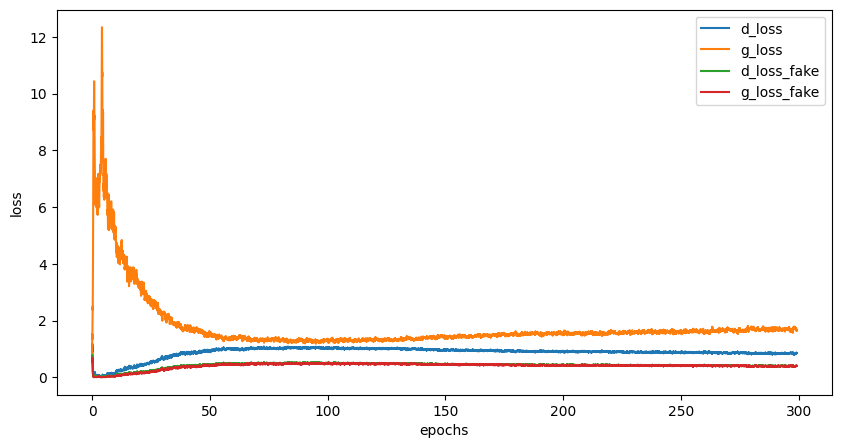

Epoch [300/500], Step[100/469], d_loss: 0.8569, d_loss_fake: 0.3646, g_loss: 2.0192, g_loss_fake: 0.3791, D(x): 0.72, D(G(z)): 0.25
Epoch [300/500], Step[200/469], d_loss: 0.8296, d_loss_fake: 0.3318, g_loss: 1.7344, g_loss_fake: 0.3813, D(x): 0.71, D(G(z)): 0.24
Epoch [300/500], Step[300/469], d_loss: 0.8938, d_loss_fake: 0.4881, g_loss: 1.5470, g_loss_fake: 0.5309, D(x): 0.77, D(G(z)): 0.29
Epoch [300/500], Step[400/469], d_loss: 0.8185, d_loss_fake: 0.3026, g_loss: 1.8194, g_loss_fake: 0.3236, D(x): 0.69, D(G(z)): 0.22


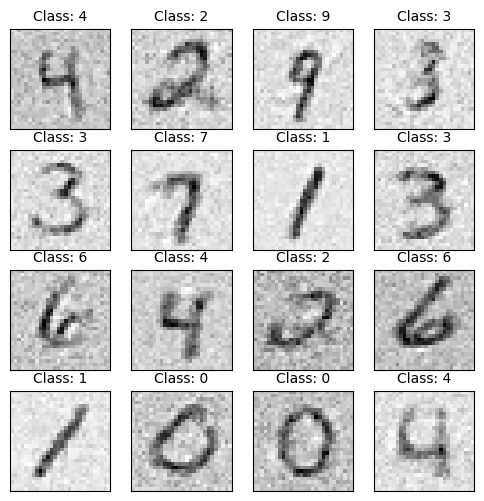

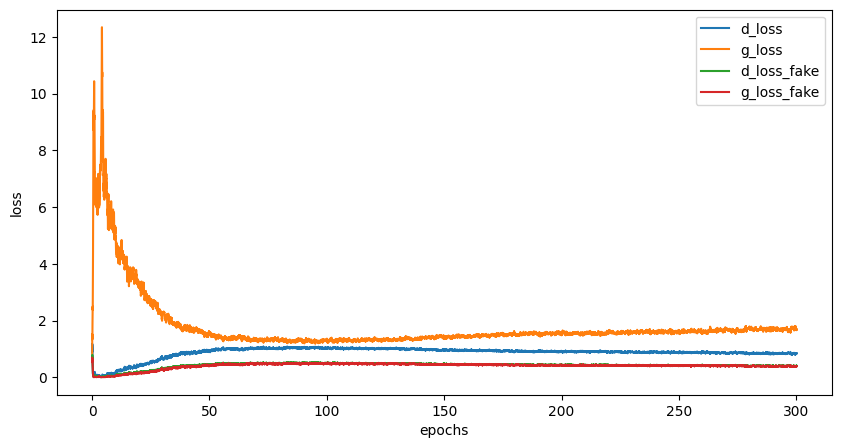

Epoch [301/500], Step[100/469], d_loss: 0.7710, d_loss_fake: 0.3702, g_loss: 1.6701, g_loss_fake: 0.3355, D(x): 0.74, D(G(z)): 0.27
Epoch [301/500], Step[200/469], d_loss: 0.8339, d_loss_fake: 0.3874, g_loss: 1.5173, g_loss_fake: 0.4072, D(x): 0.72, D(G(z)): 0.28
Epoch [301/500], Step[300/469], d_loss: 0.7869, d_loss_fake: 0.3773, g_loss: 1.6421, g_loss_fake: 0.3595, D(x): 0.75, D(G(z)): 0.25
Epoch [301/500], Step[400/469], d_loss: 0.9298, d_loss_fake: 0.4043, g_loss: 1.6027, g_loss_fake: 0.4228, D(x): 0.69, D(G(z)): 0.28


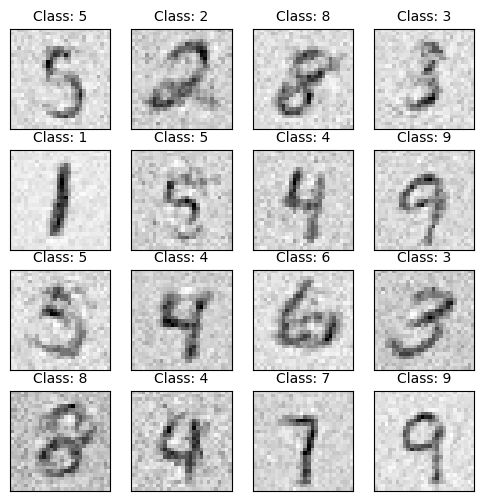

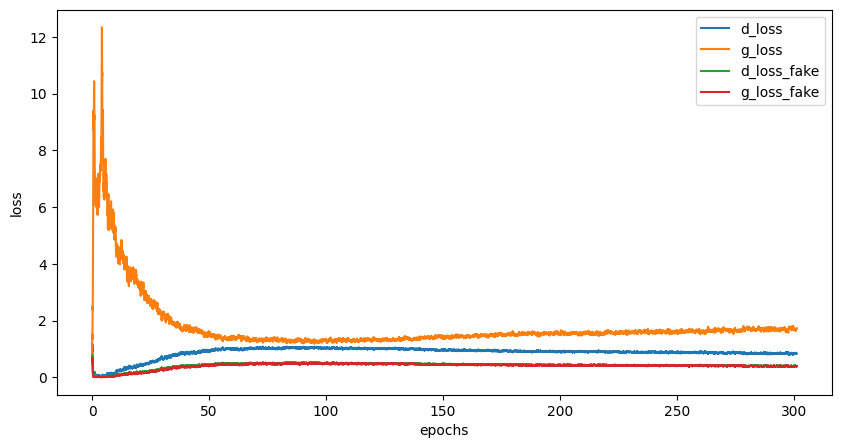

Epoch [302/500], Step[100/469], d_loss: 0.8147, d_loss_fake: 0.4433, g_loss: 1.6600, g_loss_fake: 0.4709, D(x): 0.76, D(G(z)): 0.29
Epoch [302/500], Step[200/469], d_loss: 0.9106, d_loss_fake: 0.5088, g_loss: 1.6938, g_loss_fake: 0.3147, D(x): 0.74, D(G(z)): 0.31
Epoch [302/500], Step[300/469], d_loss: 0.8611, d_loss_fake: 0.3876, g_loss: 1.6539, g_loss_fake: 0.4021, D(x): 0.72, D(G(z)): 0.28
Epoch [302/500], Step[400/469], d_loss: 0.8193, d_loss_fake: 0.4208, g_loss: 1.6818, g_loss_fake: 0.3664, D(x): 0.74, D(G(z)): 0.29


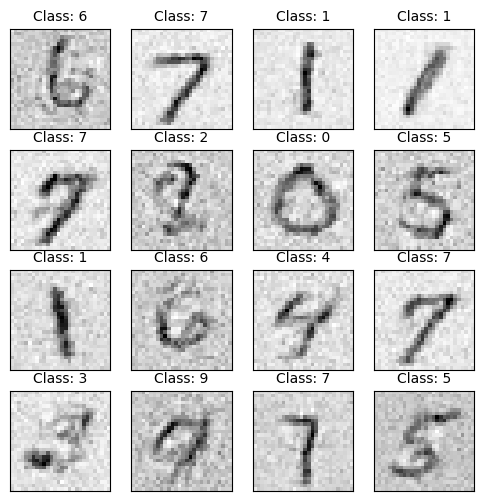

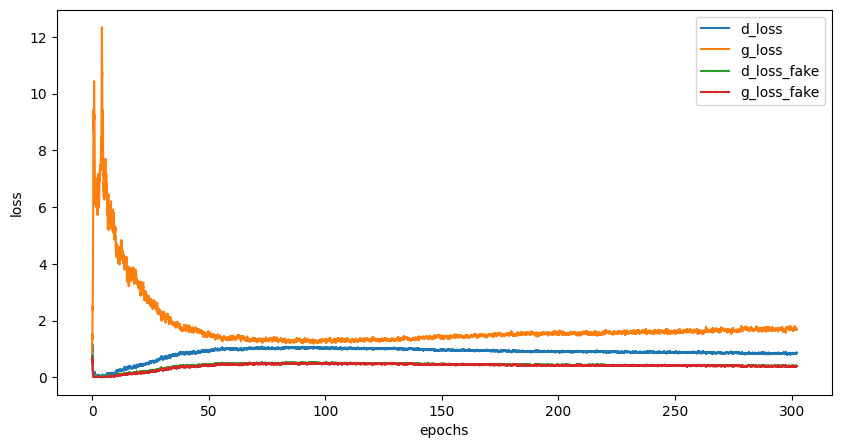

Epoch [303/500], Step[100/469], d_loss: 0.7403, d_loss_fake: 0.3599, g_loss: 1.7033, g_loss_fake: 0.3403, D(x): 0.74, D(G(z)): 0.27
Epoch [303/500], Step[200/469], d_loss: 0.7907, d_loss_fake: 0.3941, g_loss: 1.5516, g_loss_fake: 0.4785, D(x): 0.75, D(G(z)): 0.27
Epoch [303/500], Step[300/469], d_loss: 0.8967, d_loss_fake: 0.3878, g_loss: 1.7170, g_loss_fake: 0.3892, D(x): 0.68, D(G(z)): 0.26
Epoch [303/500], Step[400/469], d_loss: 0.8591, d_loss_fake: 0.4986, g_loss: 1.5408, g_loss_fake: 0.4216, D(x): 0.75, D(G(z)): 0.33


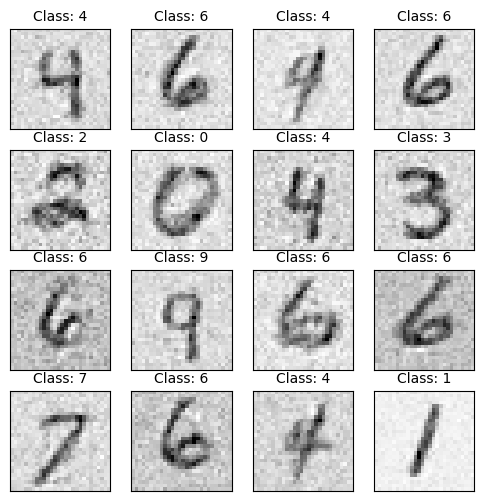

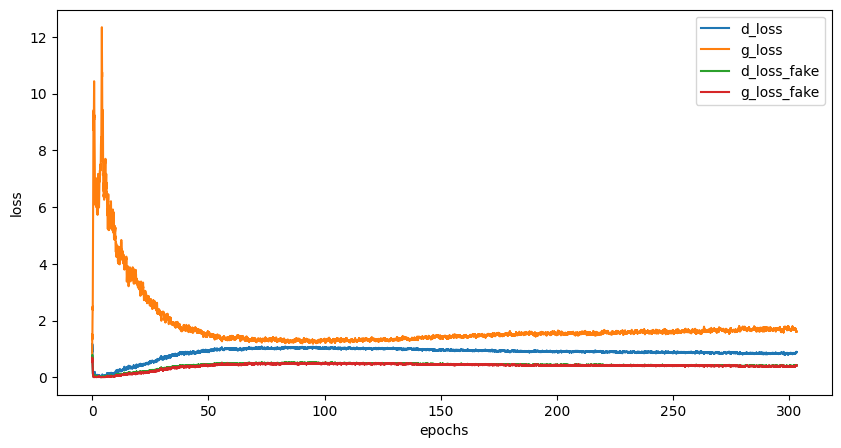

Epoch [304/500], Step[100/469], d_loss: 1.0222, d_loss_fake: 0.4163, g_loss: 1.9135, g_loss_fake: 0.3301, D(x): 0.65, D(G(z)): 0.26
Epoch [304/500], Step[200/469], d_loss: 0.8674, d_loss_fake: 0.3143, g_loss: 1.7874, g_loss_fake: 0.3367, D(x): 0.68, D(G(z)): 0.24
Epoch [304/500], Step[300/469], d_loss: 0.7963, d_loss_fake: 0.4228, g_loss: 1.6777, g_loss_fake: 0.3832, D(x): 0.77, D(G(z)): 0.28
Epoch [304/500], Step[400/469], d_loss: 0.8005, d_loss_fake: 0.3125, g_loss: 1.8101, g_loss_fake: 0.3277, D(x): 0.71, D(G(z)): 0.24


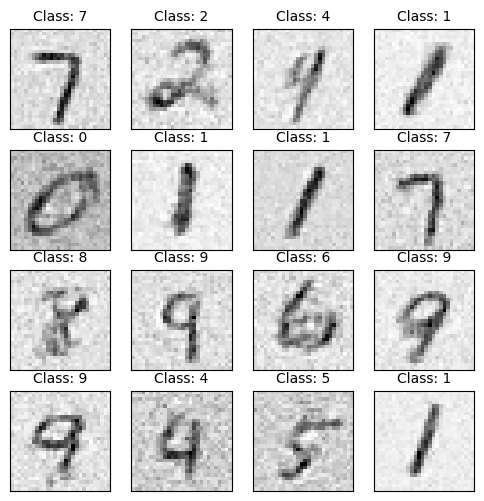

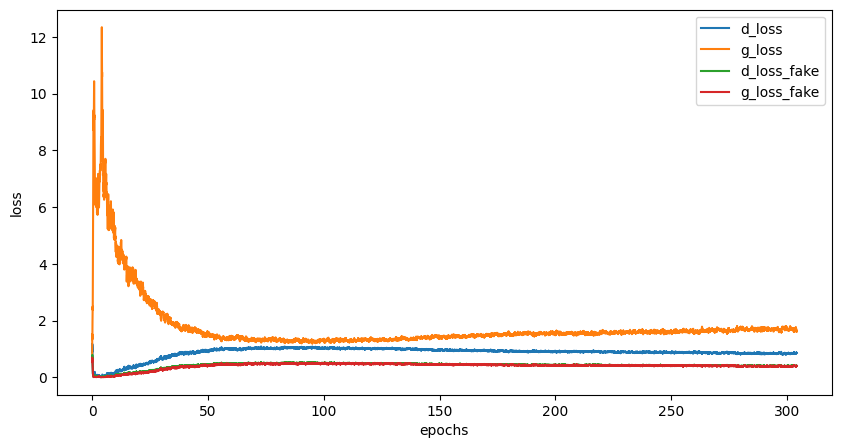

Epoch [305/500], Step[100/469], d_loss: 0.8565, d_loss_fake: 0.3872, g_loss: 1.6738, g_loss_fake: 0.3250, D(x): 0.72, D(G(z)): 0.29
Epoch [305/500], Step[200/469], d_loss: 0.8776, d_loss_fake: 0.3737, g_loss: 1.5949, g_loss_fake: 0.4098, D(x): 0.71, D(G(z)): 0.26
Epoch [305/500], Step[300/469], d_loss: 0.8109, d_loss_fake: 0.3983, g_loss: 1.6806, g_loss_fake: 0.3970, D(x): 0.75, D(G(z)): 0.28
Epoch [305/500], Step[400/469], d_loss: 0.7707, d_loss_fake: 0.3538, g_loss: 1.8468, g_loss_fake: 0.4295, D(x): 0.74, D(G(z)): 0.25


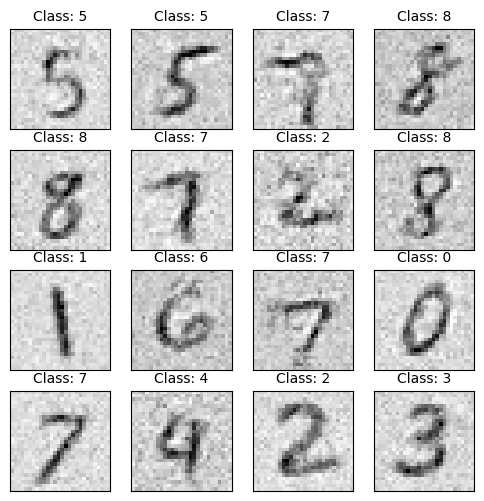

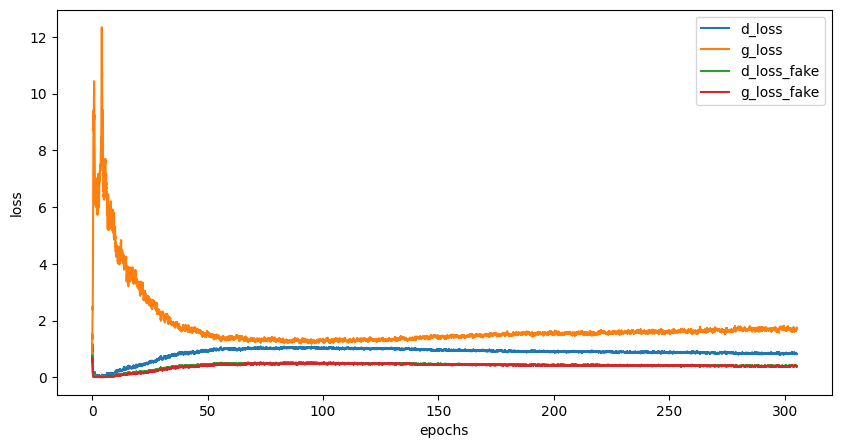

Epoch [306/500], Step[100/469], d_loss: 0.6830, d_loss_fake: 0.3029, g_loss: 1.8679, g_loss_fake: 0.3490, D(x): 0.74, D(G(z)): 0.22
Epoch [306/500], Step[200/469], d_loss: 0.8119, d_loss_fake: 0.4542, g_loss: 1.6479, g_loss_fake: 0.4440, D(x): 0.75, D(G(z)): 0.31
Epoch [306/500], Step[300/469], d_loss: 0.9082, d_loss_fake: 0.3976, g_loss: 1.6841, g_loss_fake: 0.3719, D(x): 0.69, D(G(z)): 0.26
Epoch [306/500], Step[400/469], d_loss: 0.8777, d_loss_fake: 0.4035, g_loss: 1.6447, g_loss_fake: 0.4687, D(x): 0.71, D(G(z)): 0.28


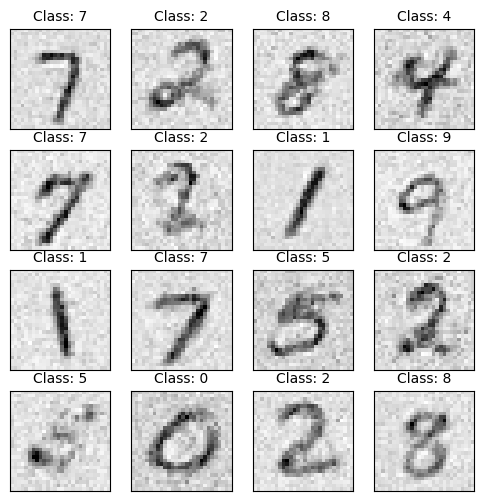

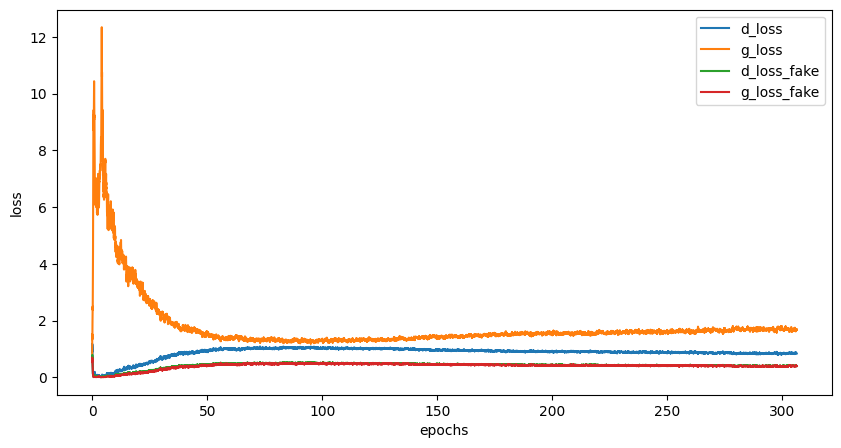

Epoch [307/500], Step[100/469], d_loss: 0.8797, d_loss_fake: 0.4199, g_loss: 1.8155, g_loss_fake: 0.3379, D(x): 0.71, D(G(z)): 0.30
Epoch [307/500], Step[200/469], d_loss: 0.9420, d_loss_fake: 0.3782, g_loss: 1.7227, g_loss_fake: 0.3667, D(x): 0.68, D(G(z)): 0.27
Epoch [307/500], Step[300/469], d_loss: 0.8527, d_loss_fake: 0.3505, g_loss: 1.6393, g_loss_fake: 0.3993, D(x): 0.69, D(G(z)): 0.26
Epoch [307/500], Step[400/469], d_loss: 0.8875, d_loss_fake: 0.4876, g_loss: 1.4809, g_loss_fake: 0.4676, D(x): 0.74, D(G(z)): 0.31


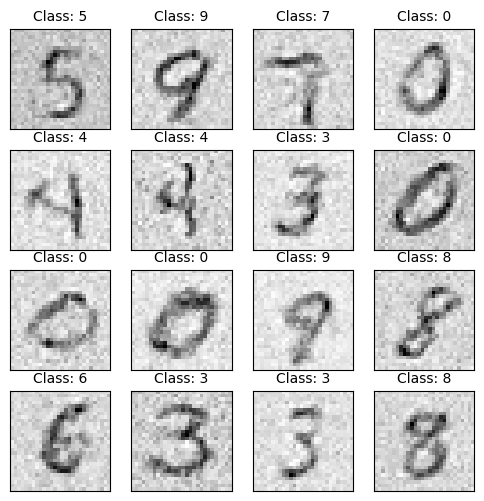

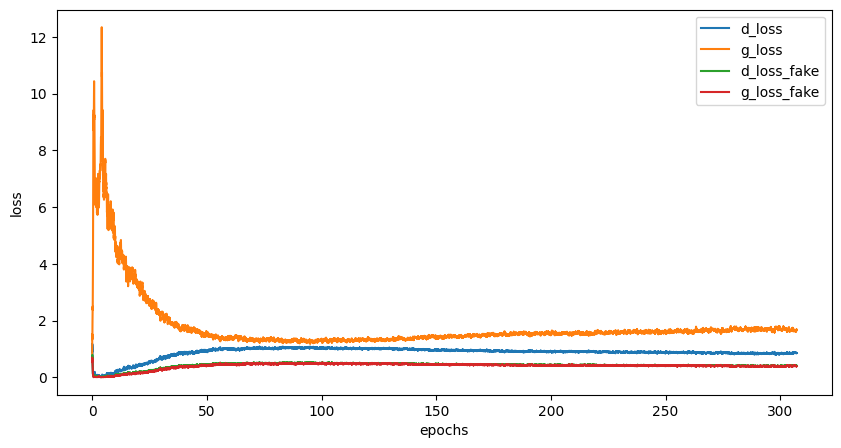

Epoch [308/500], Step[100/469], d_loss: 0.9332, d_loss_fake: 0.3941, g_loss: 1.7716, g_loss_fake: 0.4155, D(x): 0.69, D(G(z)): 0.27
Epoch [308/500], Step[200/469], d_loss: 0.8922, d_loss_fake: 0.4503, g_loss: 1.6240, g_loss_fake: 0.3996, D(x): 0.74, D(G(z)): 0.30
Epoch [308/500], Step[300/469], d_loss: 0.8511, d_loss_fake: 0.2710, g_loss: 2.3671, g_loss_fake: 0.3305, D(x): 0.66, D(G(z)): 0.20
Epoch [308/500], Step[400/469], d_loss: 0.7898, d_loss_fake: 0.3727, g_loss: 1.7165, g_loss_fake: 0.3399, D(x): 0.74, D(G(z)): 0.26


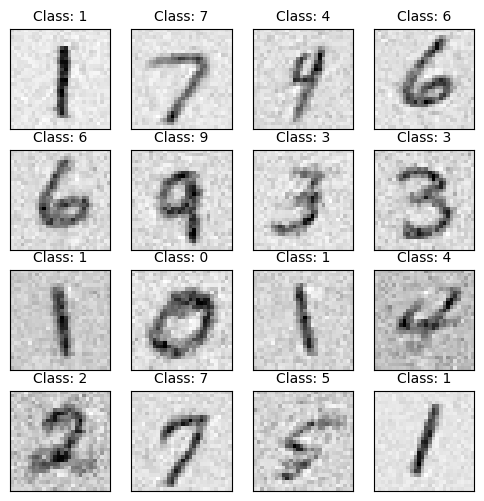

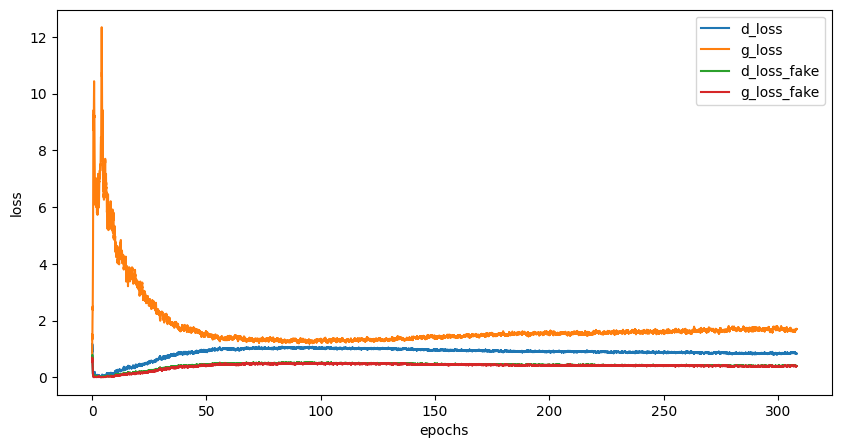

Epoch [309/500], Step[100/469], d_loss: 0.8696, d_loss_fake: 0.4625, g_loss: 1.5773, g_loss_fake: 0.4553, D(x): 0.74, D(G(z)): 0.30
Epoch [309/500], Step[200/469], d_loss: 0.8136, d_loss_fake: 0.3570, g_loss: 1.7483, g_loss_fake: 0.4171, D(x): 0.72, D(G(z)): 0.25
Epoch [309/500], Step[300/469], d_loss: 0.7166, d_loss_fake: 0.2964, g_loss: 1.4721, g_loss_fake: 0.4704, D(x): 0.72, D(G(z)): 0.24
Epoch [309/500], Step[400/469], d_loss: 0.9043, d_loss_fake: 0.3817, g_loss: 1.5523, g_loss_fake: 0.3453, D(x): 0.70, D(G(z)): 0.28


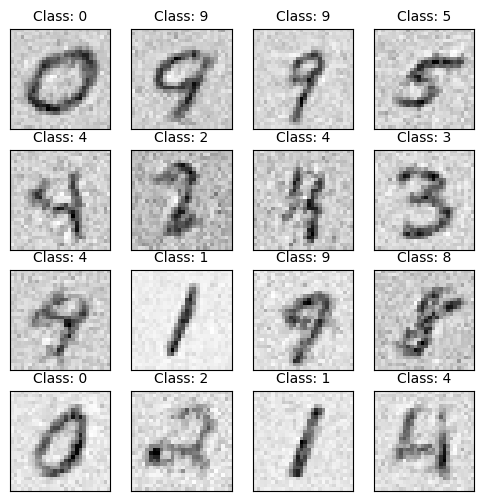

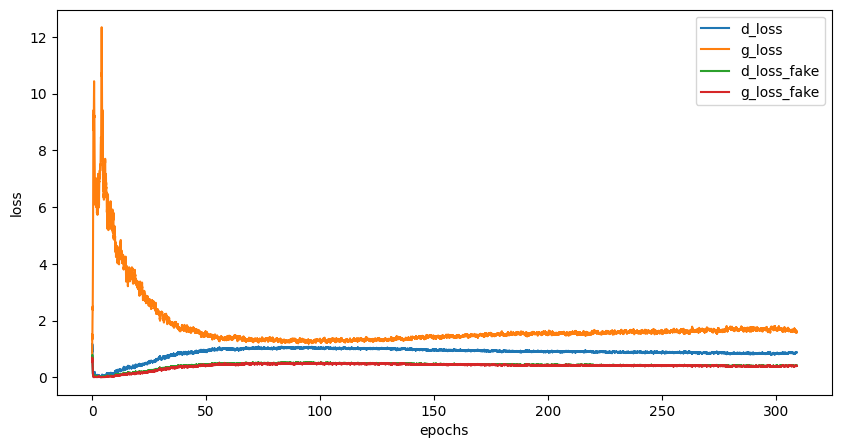

Epoch [310/500], Step[100/469], d_loss: 1.0550, d_loss_fake: 0.5708, g_loss: 1.6175, g_loss_fake: 0.4359, D(x): 0.70, D(G(z)): 0.35
Epoch [310/500], Step[200/469], d_loss: 0.8614, d_loss_fake: 0.3935, g_loss: 1.5132, g_loss_fake: 0.4249, D(x): 0.70, D(G(z)): 0.28
Epoch [310/500], Step[300/469], d_loss: 0.8862, d_loss_fake: 0.3738, g_loss: 1.8639, g_loss_fake: 0.3608, D(x): 0.70, D(G(z)): 0.26
Epoch [310/500], Step[400/469], d_loss: 0.8294, d_loss_fake: 0.4174, g_loss: 1.5559, g_loss_fake: 0.4901, D(x): 0.75, D(G(z)): 0.27


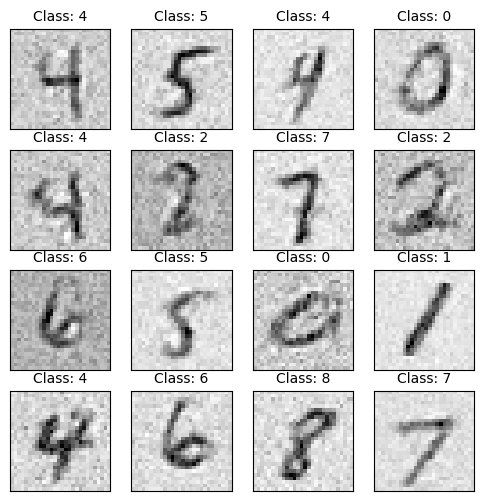

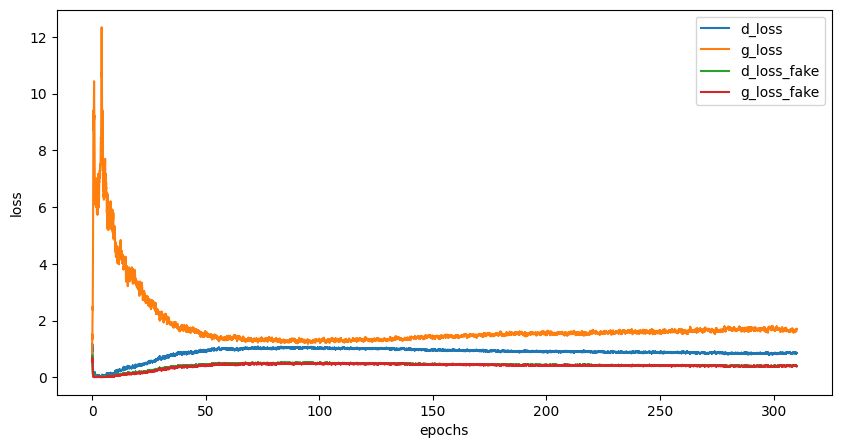

Epoch [311/500], Step[100/469], d_loss: 0.8585, d_loss_fake: 0.3492, g_loss: 1.6667, g_loss_fake: 0.3716, D(x): 0.68, D(G(z)): 0.25
Epoch [311/500], Step[200/469], d_loss: 0.8254, d_loss_fake: 0.4987, g_loss: 1.4194, g_loss_fake: 0.4433, D(x): 0.77, D(G(z)): 0.33
Epoch [311/500], Step[300/469], d_loss: 0.8779, d_loss_fake: 0.4235, g_loss: 1.6299, g_loss_fake: 0.4204, D(x): 0.71, D(G(z)): 0.30
Epoch [311/500], Step[400/469], d_loss: 0.8891, d_loss_fake: 0.4300, g_loss: 1.5853, g_loss_fake: 0.4463, D(x): 0.72, D(G(z)): 0.29


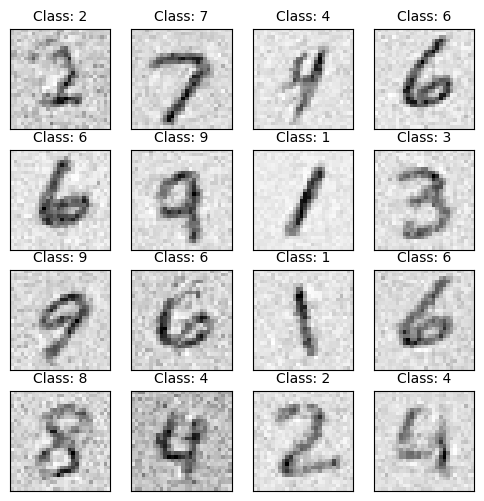

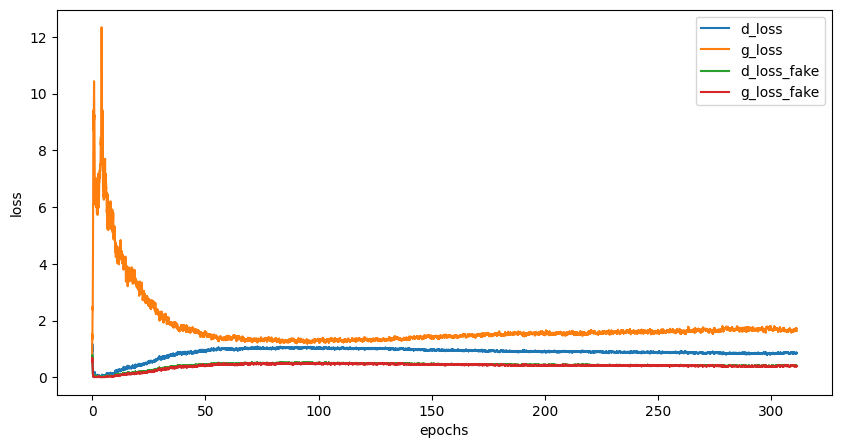

Epoch [312/500], Step[100/469], d_loss: 0.9367, d_loss_fake: 0.3861, g_loss: 1.5650, g_loss_fake: 0.3781, D(x): 0.68, D(G(z)): 0.27
Epoch [312/500], Step[200/469], d_loss: 0.9021, d_loss_fake: 0.3634, g_loss: 2.0256, g_loss_fake: 0.2509, D(x): 0.68, D(G(z)): 0.25
Epoch [312/500], Step[300/469], d_loss: 0.8280, d_loss_fake: 0.3942, g_loss: 1.3632, g_loss_fake: 0.4857, D(x): 0.73, D(G(z)): 0.29
Epoch [312/500], Step[400/469], d_loss: 0.8945, d_loss_fake: 0.4639, g_loss: 1.5955, g_loss_fake: 0.4727, D(x): 0.72, D(G(z)): 0.32


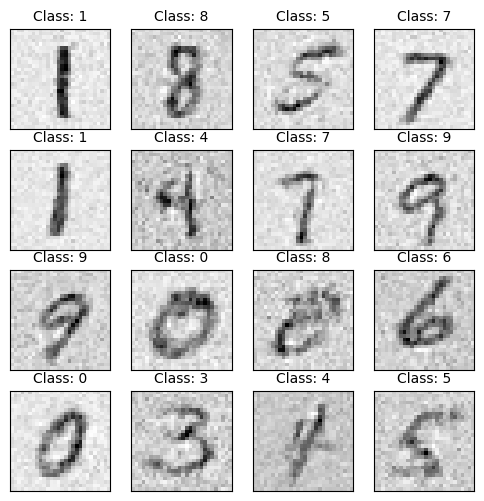

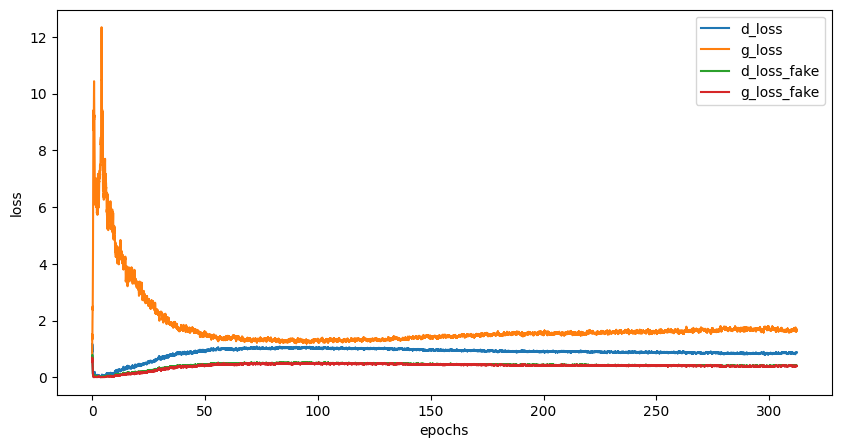

Epoch [313/500], Step[100/469], d_loss: 0.8704, d_loss_fake: 0.4577, g_loss: 1.8289, g_loss_fake: 0.4603, D(x): 0.73, D(G(z)): 0.31
Epoch [313/500], Step[200/469], d_loss: 0.9261, d_loss_fake: 0.4625, g_loss: 1.8070, g_loss_fake: 0.3778, D(x): 0.71, D(G(z)): 0.28
Epoch [313/500], Step[300/469], d_loss: 0.8263, d_loss_fake: 0.5566, g_loss: 1.4448, g_loss_fake: 0.4261, D(x): 0.82, D(G(z)): 0.33
Epoch [313/500], Step[400/469], d_loss: 0.9251, d_loss_fake: 0.3975, g_loss: 1.6372, g_loss_fake: 0.3848, D(x): 0.68, D(G(z)): 0.27


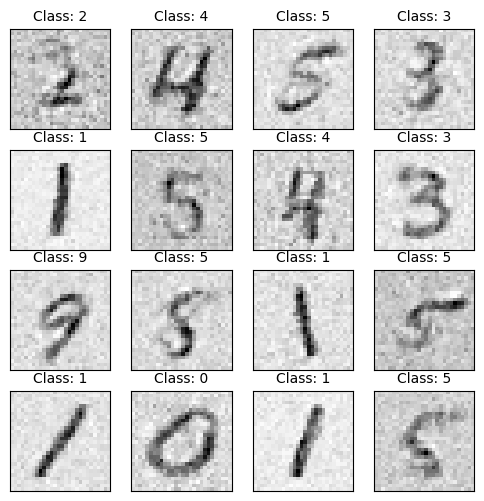

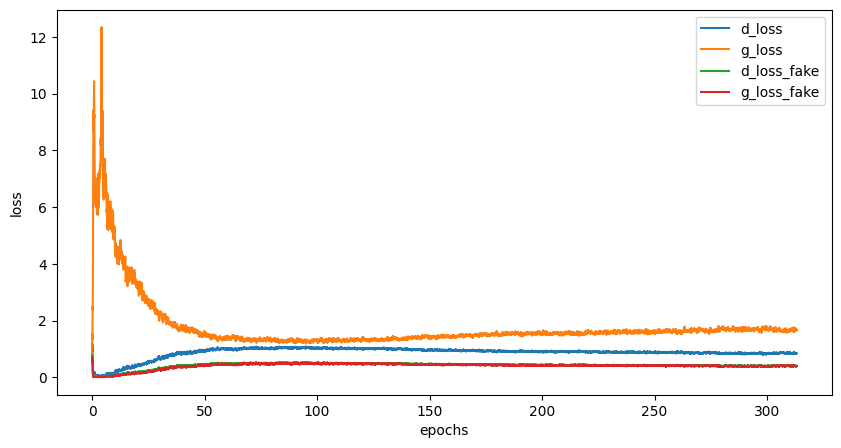

Epoch [314/500], Step[100/469], d_loss: 0.8853, d_loss_fake: 0.3788, g_loss: 2.2090, g_loss_fake: 0.2810, D(x): 0.71, D(G(z)): 0.24
Epoch [314/500], Step[200/469], d_loss: 0.8464, d_loss_fake: 0.3276, g_loss: 1.8866, g_loss_fake: 0.3794, D(x): 0.69, D(G(z)): 0.24
Epoch [314/500], Step[300/469], d_loss: 1.0790, d_loss_fake: 0.3460, g_loss: 1.4508, g_loss_fake: 0.4171, D(x): 0.60, D(G(z)): 0.25
Epoch [314/500], Step[400/469], d_loss: 0.8140, d_loss_fake: 0.4505, g_loss: 1.5724, g_loss_fake: 0.4398, D(x): 0.77, D(G(z)): 0.30


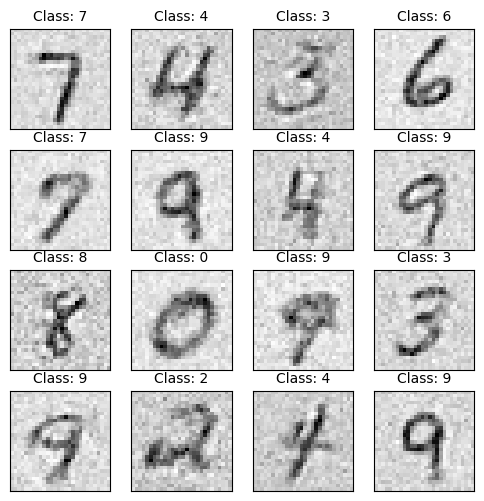

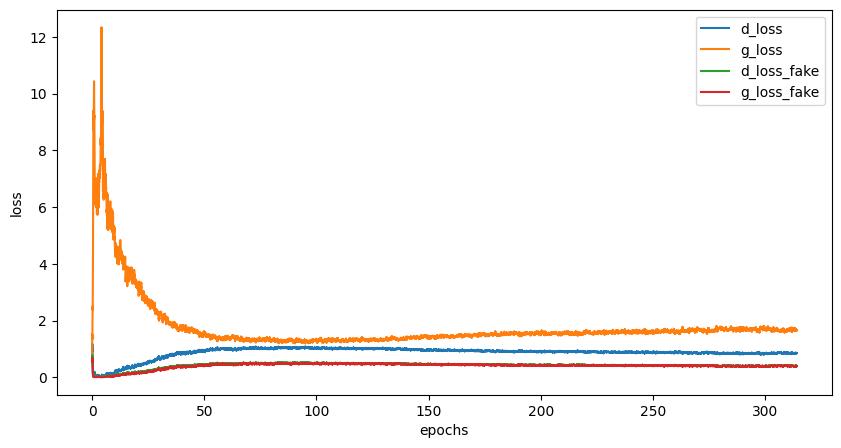

Epoch [315/500], Step[100/469], d_loss: 0.8472, d_loss_fake: 0.3322, g_loss: 1.6380, g_loss_fake: 0.4191, D(x): 0.69, D(G(z)): 0.25
Epoch [315/500], Step[200/469], d_loss: 0.9370, d_loss_fake: 0.4660, g_loss: 1.6099, g_loss_fake: 0.4161, D(x): 0.72, D(G(z)): 0.30
Epoch [315/500], Step[300/469], d_loss: 0.8364, d_loss_fake: 0.3541, g_loss: 1.5502, g_loss_fake: 0.4442, D(x): 0.72, D(G(z)): 0.25
Epoch [315/500], Step[400/469], d_loss: 0.7919, d_loss_fake: 0.4188, g_loss: 1.6922, g_loss_fake: 0.3628, D(x): 0.76, D(G(z)): 0.28


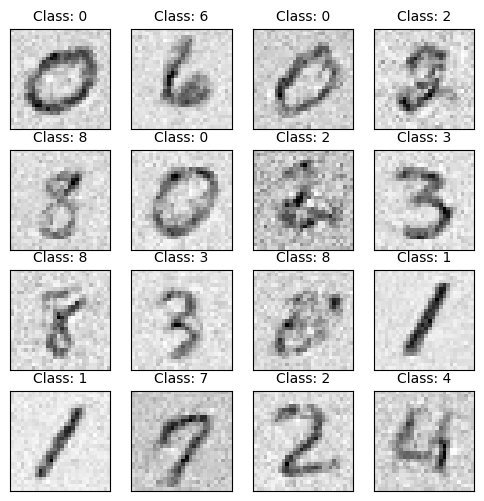

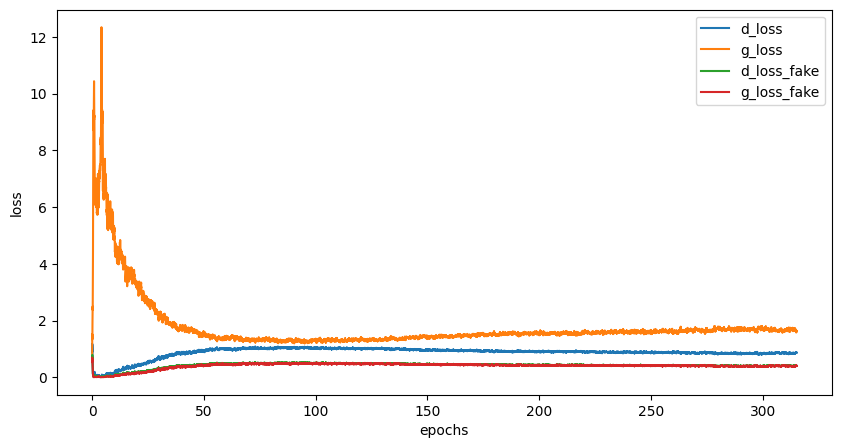

Epoch [316/500], Step[100/469], d_loss: 0.8898, d_loss_fake: 0.4061, g_loss: 1.4589, g_loss_fake: 0.4938, D(x): 0.70, D(G(z)): 0.28
Epoch [316/500], Step[200/469], d_loss: 0.7717, d_loss_fake: 0.3162, g_loss: 1.8480, g_loss_fake: 0.3572, D(x): 0.70, D(G(z)): 0.23
Epoch [316/500], Step[300/469], d_loss: 1.0294, d_loss_fake: 0.3266, g_loss: 1.9863, g_loss_fake: 0.3107, D(x): 0.61, D(G(z)): 0.23
Epoch [316/500], Step[400/469], d_loss: 0.8656, d_loss_fake: 0.4030, g_loss: 1.5978, g_loss_fake: 0.4207, D(x): 0.71, D(G(z)): 0.27


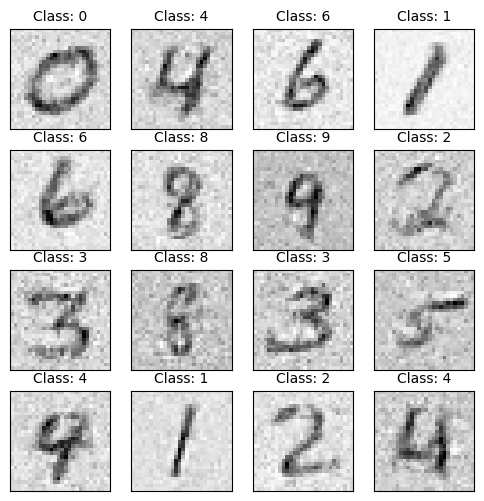

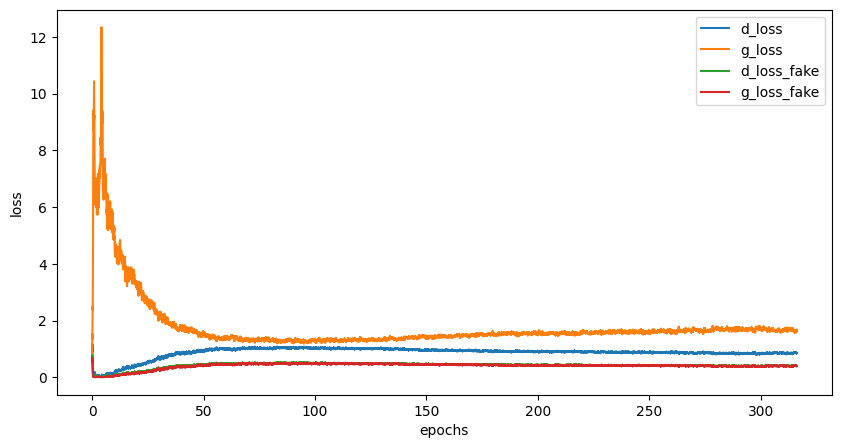

Epoch [317/500], Step[100/469], d_loss: 0.7969, d_loss_fake: 0.3998, g_loss: 1.5258, g_loss_fake: 0.4131, D(x): 0.76, D(G(z)): 0.28
Epoch [317/500], Step[200/469], d_loss: 0.9649, d_loss_fake: 0.4764, g_loss: 1.5894, g_loss_fake: 0.3732, D(x): 0.69, D(G(z)): 0.32
Epoch [317/500], Step[300/469], d_loss: 0.8610, d_loss_fake: 0.4480, g_loss: 1.6320, g_loss_fake: 0.5274, D(x): 0.74, D(G(z)): 0.29
Epoch [317/500], Step[400/469], d_loss: 0.8324, d_loss_fake: 0.4213, g_loss: 1.6457, g_loss_fake: 0.4298, D(x): 0.74, D(G(z)): 0.28


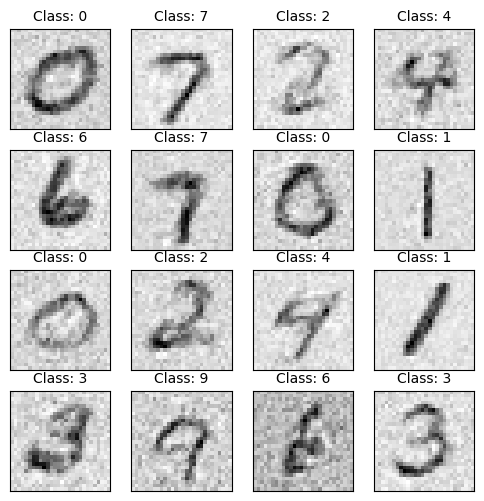

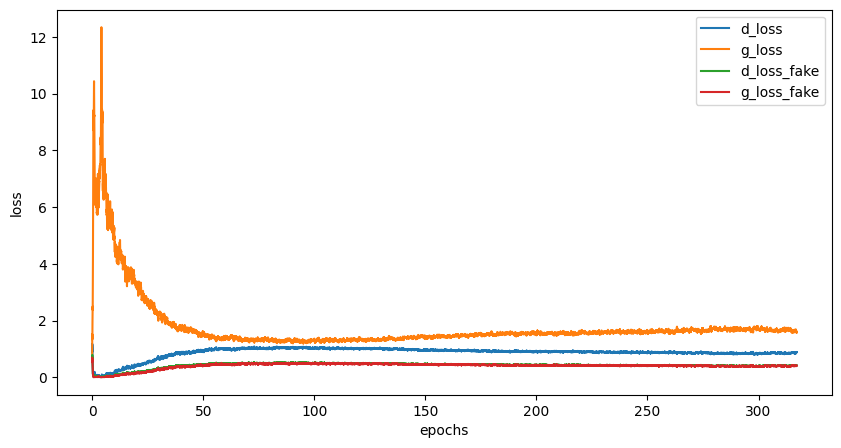

Epoch [318/500], Step[100/469], d_loss: 0.9337, d_loss_fake: 0.4754, g_loss: 1.5193, g_loss_fake: 0.4454, D(x): 0.71, D(G(z)): 0.30
Epoch [318/500], Step[200/469], d_loss: 0.8429, d_loss_fake: 0.4804, g_loss: 1.5832, g_loss_fake: 0.4275, D(x): 0.76, D(G(z)): 0.31
Epoch [318/500], Step[300/469], d_loss: 0.9605, d_loss_fake: 0.4616, g_loss: 1.6563, g_loss_fake: 0.3447, D(x): 0.70, D(G(z)): 0.31
Epoch [318/500], Step[400/469], d_loss: 0.9158, d_loss_fake: 0.4415, g_loss: 1.4277, g_loss_fake: 0.5052, D(x): 0.71, D(G(z)): 0.31


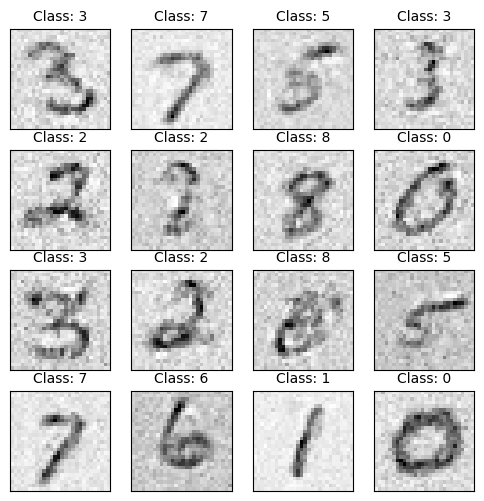

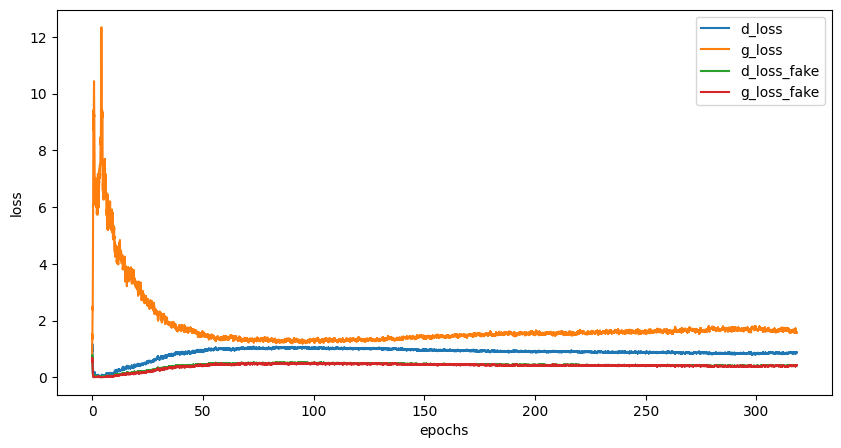

Epoch [319/500], Step[100/469], d_loss: 0.8829, d_loss_fake: 0.4157, g_loss: 1.5009, g_loss_fake: 0.4663, D(x): 0.73, D(G(z)): 0.29
Epoch [319/500], Step[200/469], d_loss: 0.9282, d_loss_fake: 0.4417, g_loss: 1.5559, g_loss_fake: 0.4251, D(x): 0.70, D(G(z)): 0.27
Epoch [319/500], Step[300/469], d_loss: 0.8536, d_loss_fake: 0.3751, g_loss: 1.6379, g_loss_fake: 0.4595, D(x): 0.71, D(G(z)): 0.27
Epoch [319/500], Step[400/469], d_loss: 0.8957, d_loss_fake: 0.3975, g_loss: 1.6959, g_loss_fake: 0.3521, D(x): 0.69, D(G(z)): 0.27


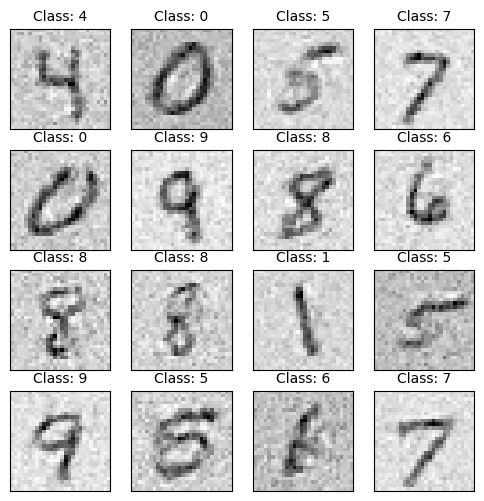

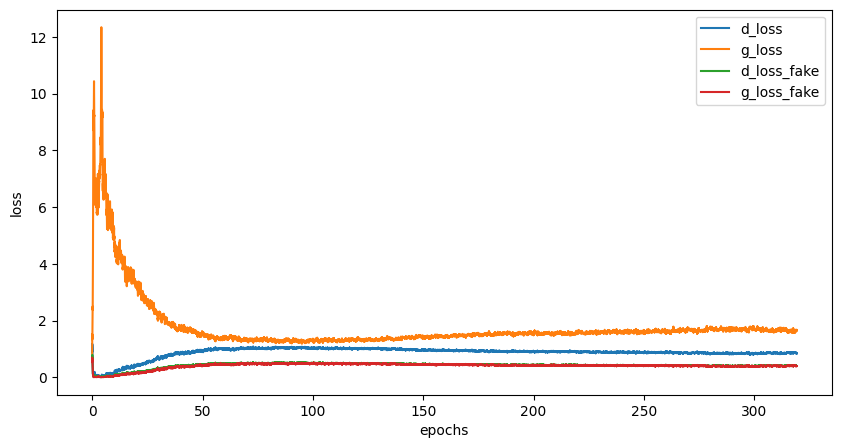

Epoch [320/500], Step[100/469], d_loss: 0.7546, d_loss_fake: 0.3290, g_loss: 1.8150, g_loss_fake: 0.2885, D(x): 0.72, D(G(z)): 0.24
Epoch [320/500], Step[200/469], d_loss: 0.8270, d_loss_fake: 0.2488, g_loss: 1.5018, g_loss_fake: 0.4690, D(x): 0.66, D(G(z)): 0.20
Epoch [320/500], Step[300/469], d_loss: 0.9089, d_loss_fake: 0.4000, g_loss: 1.7181, g_loss_fake: 0.3348, D(x): 0.69, D(G(z)): 0.29
Epoch [320/500], Step[400/469], d_loss: 0.9187, d_loss_fake: 0.4171, g_loss: 1.7240, g_loss_fake: 0.3639, D(x): 0.70, D(G(z)): 0.28


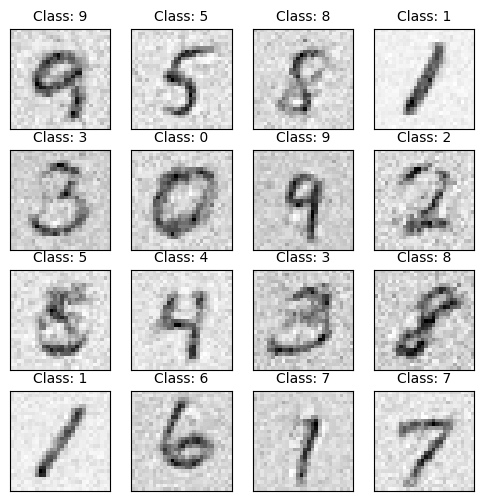

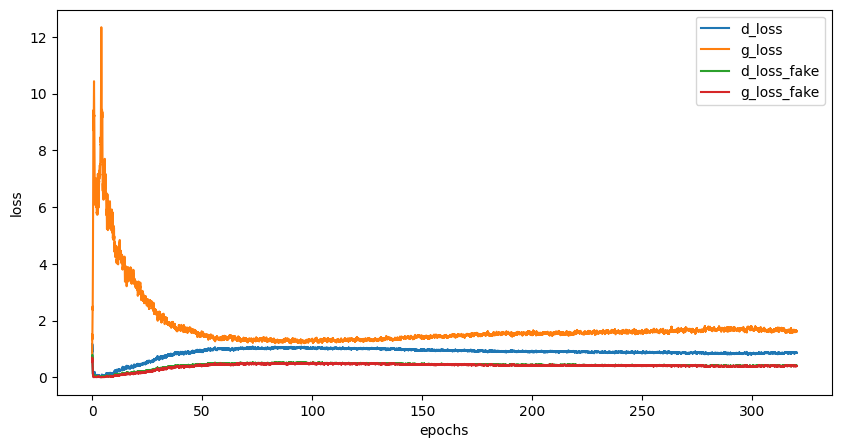

Epoch [321/500], Step[100/469], d_loss: 0.7994, d_loss_fake: 0.4142, g_loss: 1.6051, g_loss_fake: 0.4737, D(x): 0.77, D(G(z)): 0.28
Epoch [321/500], Step[200/469], d_loss: 0.7930, d_loss_fake: 0.2964, g_loss: 1.8604, g_loss_fake: 0.3245, D(x): 0.71, D(G(z)): 0.22
Epoch [321/500], Step[300/469], d_loss: 0.8447, d_loss_fake: 0.4418, g_loss: 1.5807, g_loss_fake: 0.3964, D(x): 0.74, D(G(z)): 0.30
Epoch [321/500], Step[400/469], d_loss: 0.9270, d_loss_fake: 0.4314, g_loss: 1.7995, g_loss_fake: 0.3839, D(x): 0.71, D(G(z)): 0.28


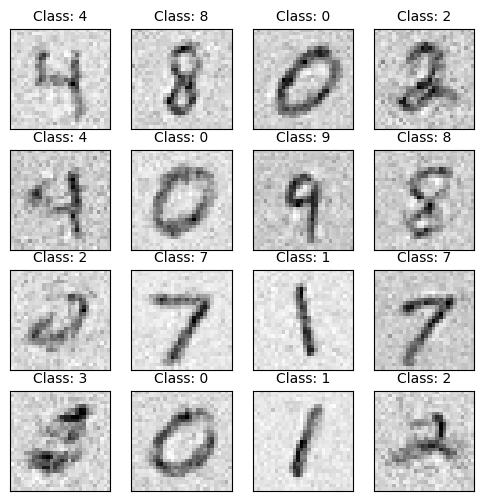

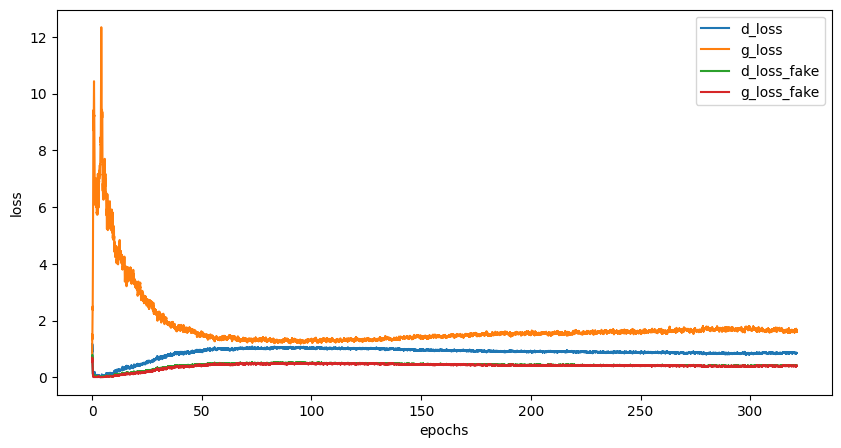

Epoch [322/500], Step[100/469], d_loss: 0.8912, d_loss_fake: 0.4608, g_loss: 1.6038, g_loss_fake: 0.4000, D(x): 0.73, D(G(z)): 0.32
Epoch [322/500], Step[200/469], d_loss: 0.8252, d_loss_fake: 0.4709, g_loss: 1.5707, g_loss_fake: 0.4456, D(x): 0.77, D(G(z)): 0.30
Epoch [322/500], Step[300/469], d_loss: 0.8400, d_loss_fake: 0.4140, g_loss: 1.6017, g_loss_fake: 0.4938, D(x): 0.74, D(G(z)): 0.27
Epoch [322/500], Step[400/469], d_loss: 0.7303, d_loss_fake: 0.3616, g_loss: 2.0851, g_loss_fake: 0.2902, D(x): 0.76, D(G(z)): 0.23


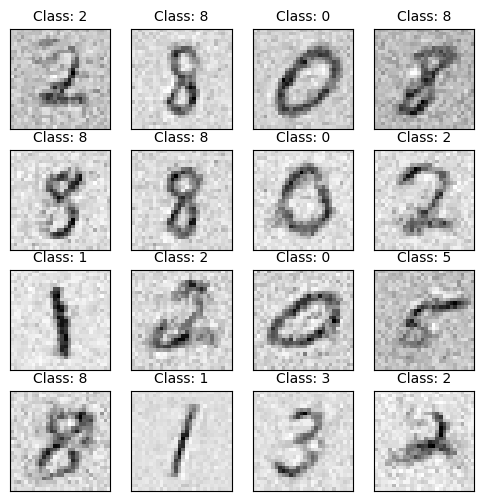

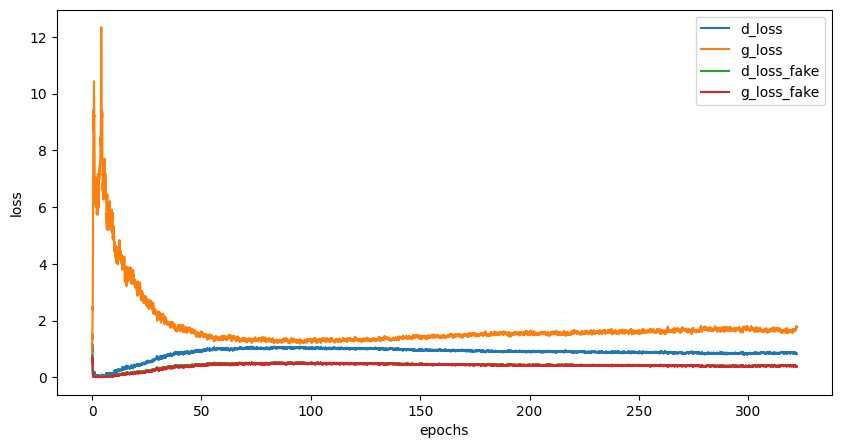

Epoch [323/500], Step[100/469], d_loss: 0.8994, d_loss_fake: 0.5006, g_loss: 1.5514, g_loss_fake: 0.3979, D(x): 0.75, D(G(z)): 0.32
Epoch [323/500], Step[200/469], d_loss: 0.9481, d_loss_fake: 0.4457, g_loss: 1.6246, g_loss_fake: 0.4241, D(x): 0.70, D(G(z)): 0.30
Epoch [323/500], Step[300/469], d_loss: 0.8194, d_loss_fake: 0.4695, g_loss: 1.7993, g_loss_fake: 0.3486, D(x): 0.77, D(G(z)): 0.28
Epoch [323/500], Step[400/469], d_loss: 0.8658, d_loss_fake: 0.3798, g_loss: 1.6515, g_loss_fake: 0.3726, D(x): 0.71, D(G(z)): 0.25


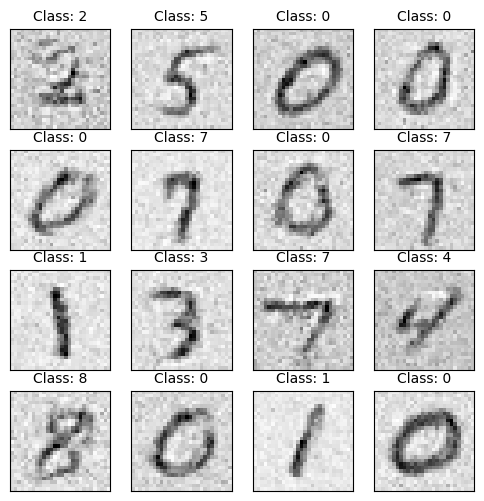

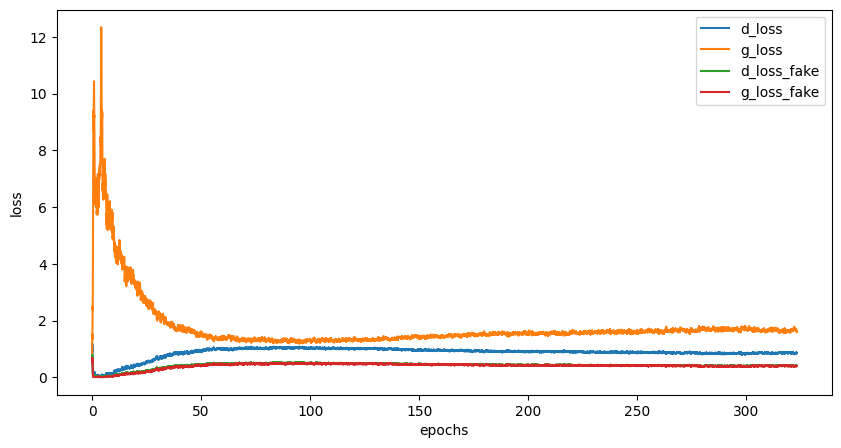

Epoch [324/500], Step[100/469], d_loss: 0.7875, d_loss_fake: 0.4953, g_loss: 1.7608, g_loss_fake: 0.3207, D(x): 0.80, D(G(z)): 0.30
Epoch [324/500], Step[200/469], d_loss: 0.8881, d_loss_fake: 0.4108, g_loss: 1.8135, g_loss_fake: 0.4442, D(x): 0.70, D(G(z)): 0.29
Epoch [324/500], Step[300/469], d_loss: 0.7796, d_loss_fake: 0.3655, g_loss: 1.7274, g_loss_fake: 0.3591, D(x): 0.73, D(G(z)): 0.26
Epoch [324/500], Step[400/469], d_loss: 0.8873, d_loss_fake: 0.4358, g_loss: 1.7972, g_loss_fake: 0.3468, D(x): 0.73, D(G(z)): 0.30


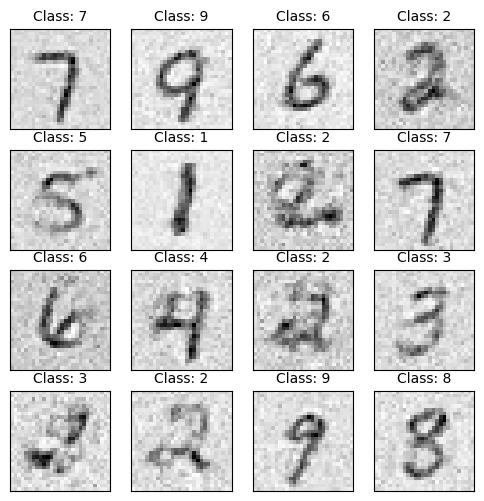

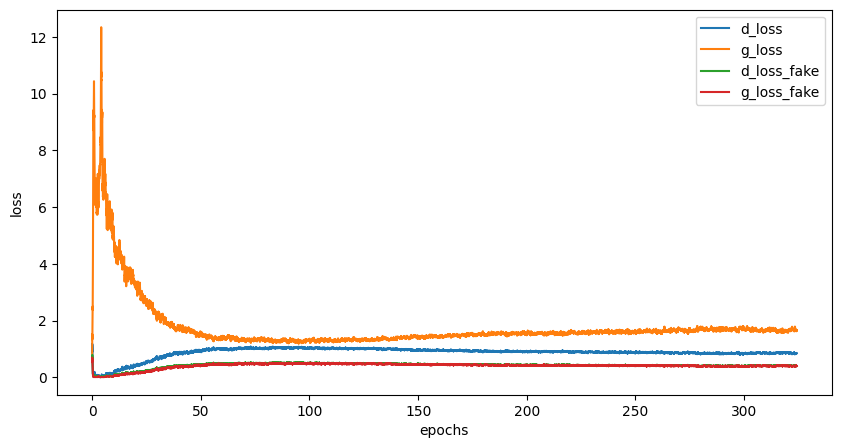

Epoch [325/500], Step[100/469], d_loss: 0.8400, d_loss_fake: 0.4089, g_loss: 1.7935, g_loss_fake: 0.3847, D(x): 0.73, D(G(z)): 0.28
Epoch [325/500], Step[200/469], d_loss: 0.7528, d_loss_fake: 0.3659, g_loss: 1.6126, g_loss_fake: 0.4035, D(x): 0.74, D(G(z)): 0.26
Epoch [325/500], Step[300/469], d_loss: 0.7847, d_loss_fake: 0.3333, g_loss: 1.6395, g_loss_fake: 0.3666, D(x): 0.72, D(G(z)): 0.25
Epoch [325/500], Step[400/469], d_loss: 0.8996, d_loss_fake: 0.3946, g_loss: 1.8817, g_loss_fake: 0.3791, D(x): 0.72, D(G(z)): 0.26


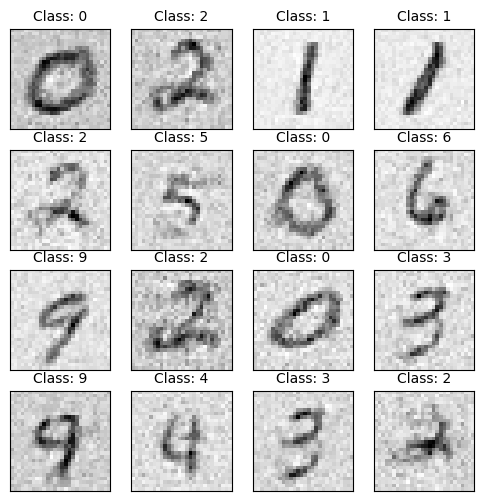

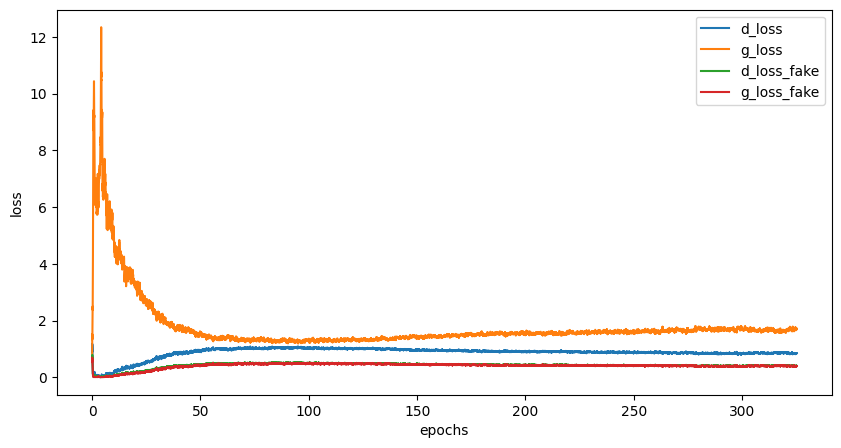

Epoch [326/500], Step[100/469], d_loss: 0.8255, d_loss_fake: 0.3374, g_loss: 1.5526, g_loss_fake: 0.4158, D(x): 0.71, D(G(z)): 0.25
Epoch [326/500], Step[200/469], d_loss: 0.8626, d_loss_fake: 0.4611, g_loss: 1.6556, g_loss_fake: 0.3594, D(x): 0.73, D(G(z)): 0.30
Epoch [326/500], Step[300/469], d_loss: 0.9011, d_loss_fake: 0.3739, g_loss: 1.5795, g_loss_fake: 0.4401, D(x): 0.69, D(G(z)): 0.27
Epoch [326/500], Step[400/469], d_loss: 0.7297, d_loss_fake: 0.3645, g_loss: 1.9407, g_loss_fake: 0.3296, D(x): 0.76, D(G(z)): 0.23


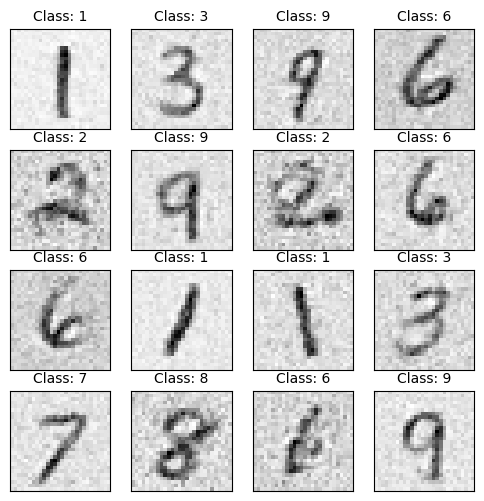

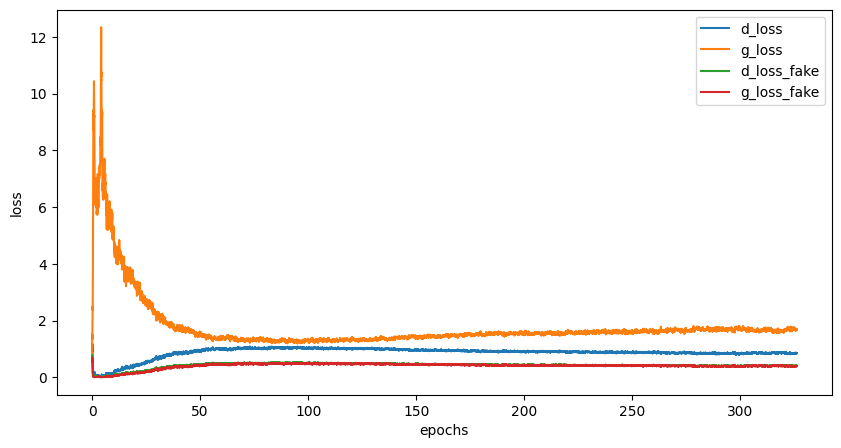

Epoch [327/500], Step[100/469], d_loss: 0.8863, d_loss_fake: 0.4740, g_loss: 1.5971, g_loss_fake: 0.4533, D(x): 0.73, D(G(z)): 0.31
Epoch [327/500], Step[200/469], d_loss: 0.8723, d_loss_fake: 0.3522, g_loss: 1.8415, g_loss_fake: 0.3395, D(x): 0.71, D(G(z)): 0.26
Epoch [327/500], Step[300/469], d_loss: 0.8545, d_loss_fake: 0.4081, g_loss: 1.6540, g_loss_fake: 0.4127, D(x): 0.73, D(G(z)): 0.29
Epoch [327/500], Step[400/469], d_loss: 0.8718, d_loss_fake: 0.3854, g_loss: 1.8918, g_loss_fake: 0.3075, D(x): 0.71, D(G(z)): 0.28


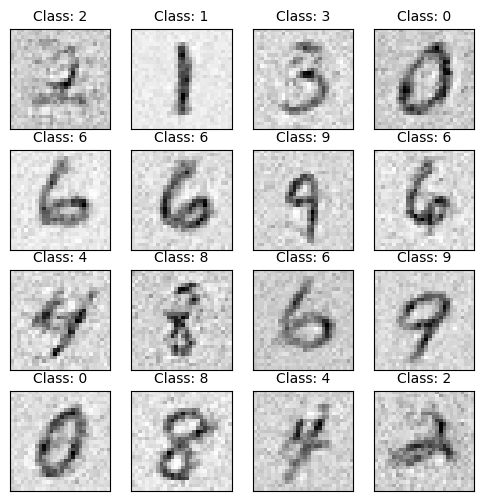

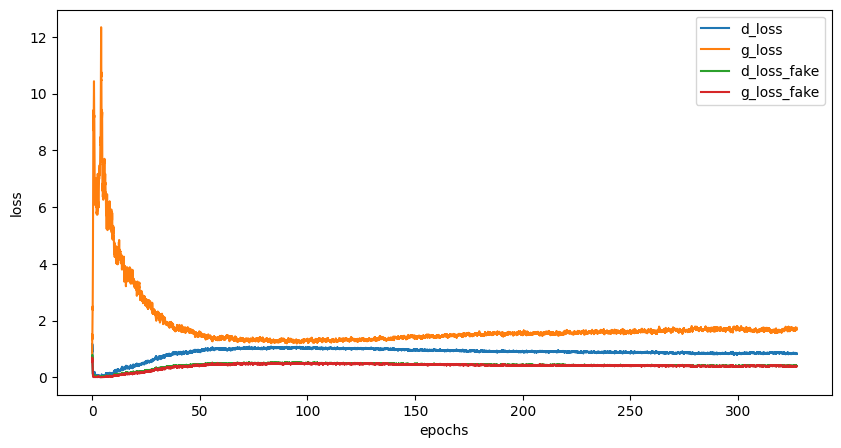

Epoch [328/500], Step[100/469], d_loss: 0.8714, d_loss_fake: 0.4068, g_loss: 1.5174, g_loss_fake: 0.5364, D(x): 0.70, D(G(z)): 0.27
Epoch [328/500], Step[200/469], d_loss: 0.9451, d_loss_fake: 0.4699, g_loss: 1.7828, g_loss_fake: 0.3085, D(x): 0.71, D(G(z)): 0.31
Epoch [328/500], Step[300/469], d_loss: 0.7904, d_loss_fake: 0.4000, g_loss: 1.6718, g_loss_fake: 0.4212, D(x): 0.75, D(G(z)): 0.27
Epoch [328/500], Step[400/469], d_loss: 0.8077, d_loss_fake: 0.4150, g_loss: 1.6703, g_loss_fake: 0.3568, D(x): 0.75, D(G(z)): 0.30


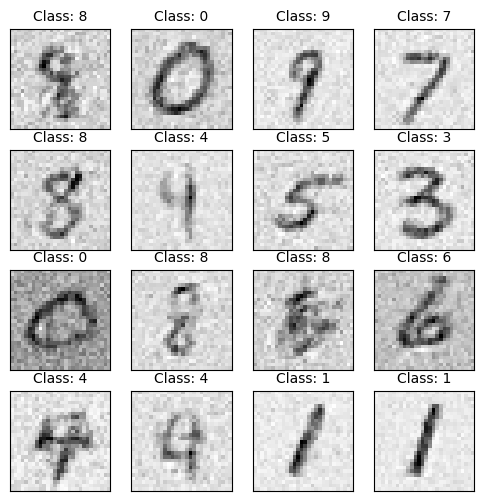

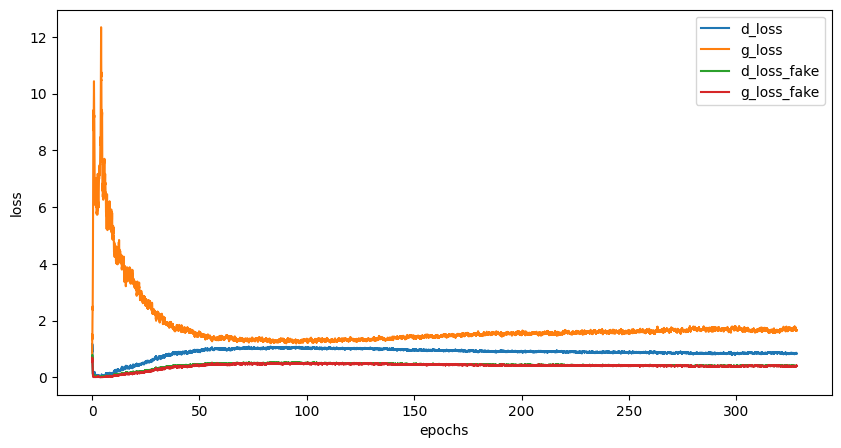

Epoch [329/500], Step[100/469], d_loss: 0.9570, d_loss_fake: 0.4797, g_loss: 1.7021, g_loss_fake: 0.4411, D(x): 0.71, D(G(z)): 0.29
Epoch [329/500], Step[200/469], d_loss: 0.8300, d_loss_fake: 0.4245, g_loss: 1.5647, g_loss_fake: 0.4576, D(x): 0.74, D(G(z)): 0.30
Epoch [329/500], Step[300/469], d_loss: 0.8322, d_loss_fake: 0.4508, g_loss: 1.5286, g_loss_fake: 0.4345, D(x): 0.76, D(G(z)): 0.31
Epoch [329/500], Step[400/469], d_loss: 0.8805, d_loss_fake: 0.3201, g_loss: 1.6825, g_loss_fake: 0.4952, D(x): 0.67, D(G(z)): 0.23


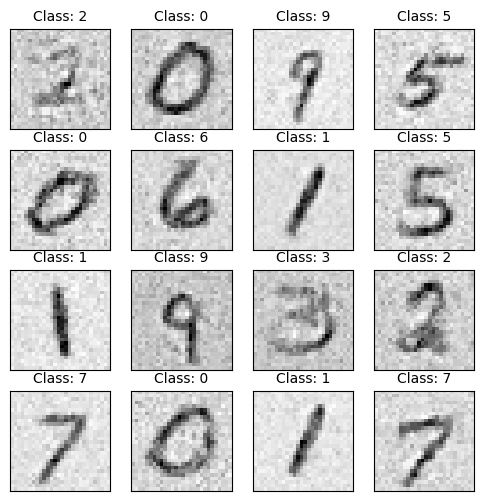

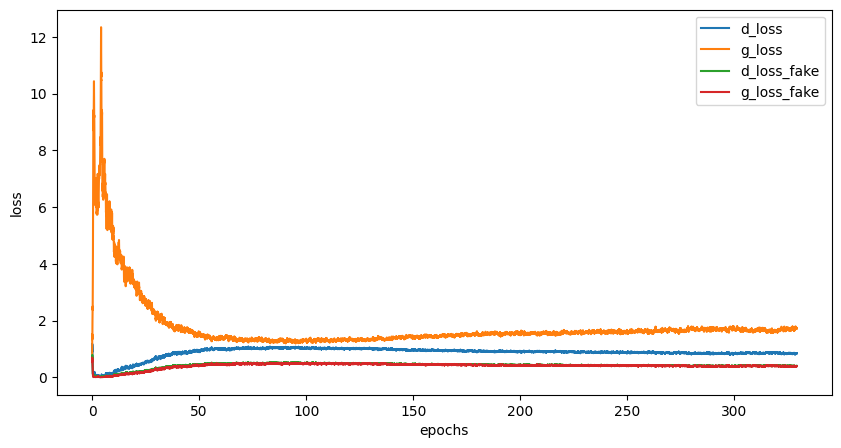

Epoch [330/500], Step[100/469], d_loss: 0.8244, d_loss_fake: 0.4449, g_loss: 1.7141, g_loss_fake: 0.3713, D(x): 0.75, D(G(z)): 0.30
Epoch [330/500], Step[200/469], d_loss: 0.8934, d_loss_fake: 0.4216, g_loss: 1.7252, g_loss_fake: 0.4167, D(x): 0.71, D(G(z)): 0.28
Epoch [330/500], Step[300/469], d_loss: 0.8877, d_loss_fake: 0.4306, g_loss: 1.8706, g_loss_fake: 0.3461, D(x): 0.72, D(G(z)): 0.27
Epoch [330/500], Step[400/469], d_loss: 0.9152, d_loss_fake: 0.3970, g_loss: 1.5804, g_loss_fake: 0.4230, D(x): 0.68, D(G(z)): 0.28


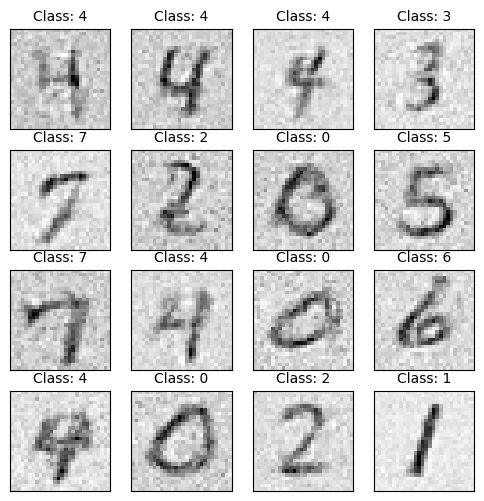

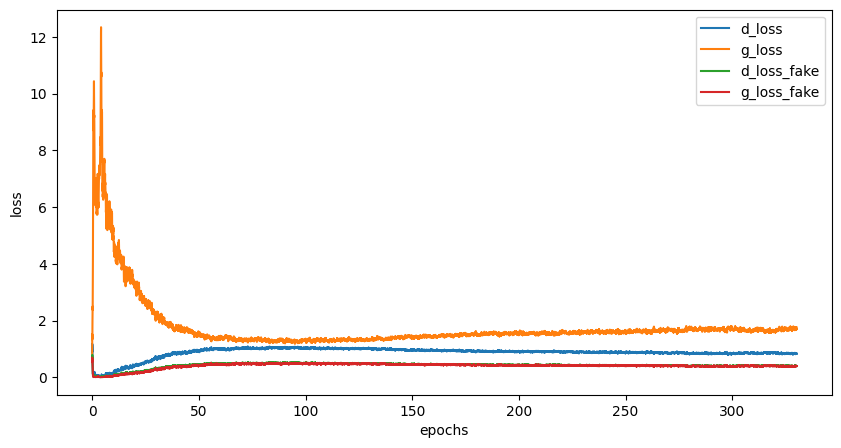

Epoch [331/500], Step[100/469], d_loss: 0.8471, d_loss_fake: 0.4494, g_loss: 1.6837, g_loss_fake: 0.3675, D(x): 0.75, D(G(z)): 0.29
Epoch [331/500], Step[200/469], d_loss: 0.8571, d_loss_fake: 0.3018, g_loss: 2.0098, g_loss_fake: 0.2643, D(x): 0.68, D(G(z)): 0.22
Epoch [331/500], Step[300/469], d_loss: 0.8715, d_loss_fake: 0.5425, g_loss: 1.5686, g_loss_fake: 0.4905, D(x): 0.80, D(G(z)): 0.33
Epoch [331/500], Step[400/469], d_loss: 0.8640, d_loss_fake: 0.3835, g_loss: 1.8091, g_loss_fake: 0.4014, D(x): 0.72, D(G(z)): 0.26


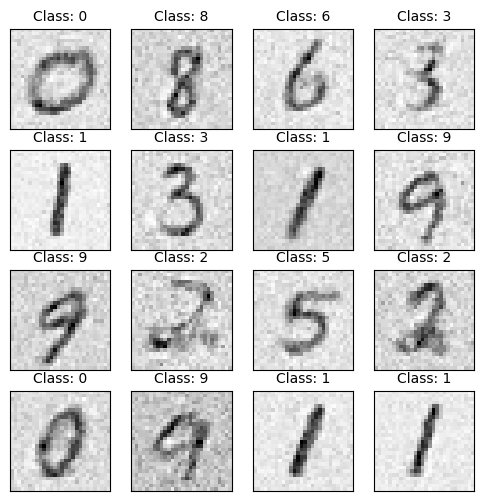

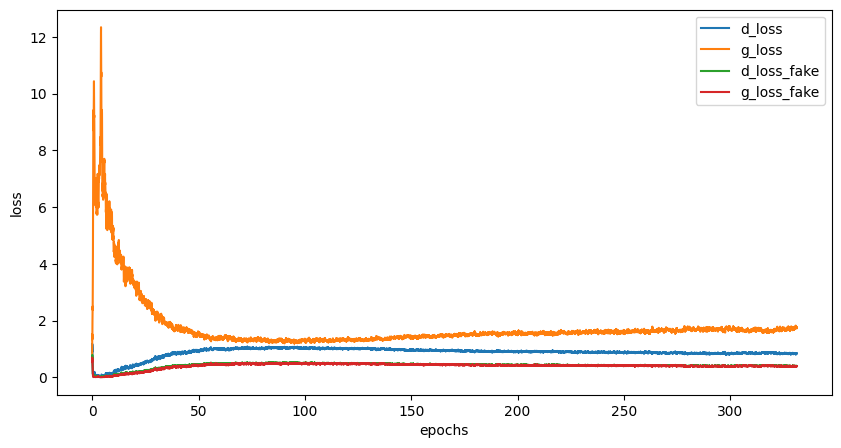

Epoch [332/500], Step[100/469], d_loss: 0.9093, d_loss_fake: 0.4000, g_loss: 1.6563, g_loss_fake: 0.3728, D(x): 0.68, D(G(z)): 0.27
Epoch [332/500], Step[200/469], d_loss: 0.7610, d_loss_fake: 0.4065, g_loss: 1.6822, g_loss_fake: 0.4085, D(x): 0.77, D(G(z)): 0.28
Epoch [332/500], Step[300/469], d_loss: 1.0251, d_loss_fake: 0.3400, g_loss: 1.8173, g_loss_fake: 0.3464, D(x): 0.62, D(G(z)): 0.25
Epoch [332/500], Step[400/469], d_loss: 0.9406, d_loss_fake: 0.4092, g_loss: 1.9181, g_loss_fake: 0.3906, D(x): 0.70, D(G(z)): 0.28


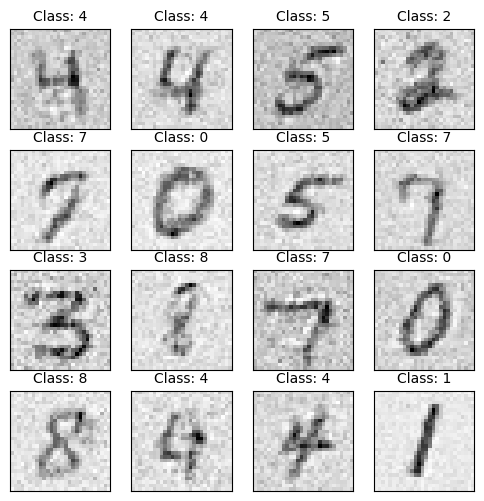

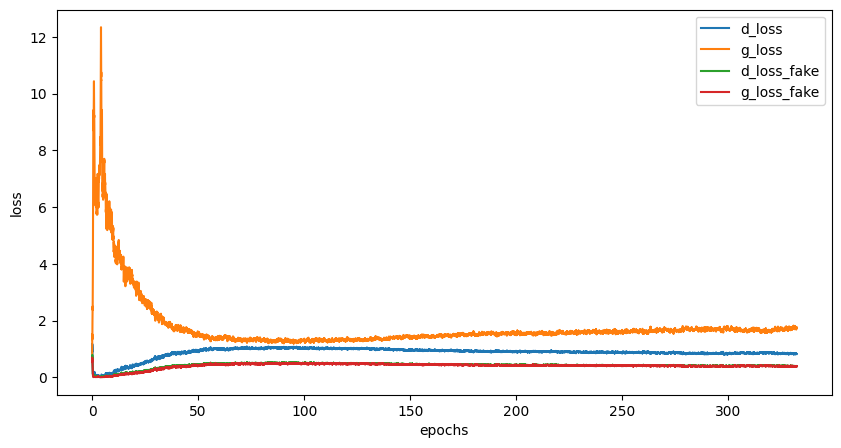

Epoch [333/500], Step[100/469], d_loss: 0.8832, d_loss_fake: 0.4142, g_loss: 2.2342, g_loss_fake: 0.3289, D(x): 0.73, D(G(z)): 0.26
Epoch [333/500], Step[200/469], d_loss: 0.8954, d_loss_fake: 0.4179, g_loss: 1.8774, g_loss_fake: 0.3306, D(x): 0.71, D(G(z)): 0.29
Epoch [333/500], Step[300/469], d_loss: 0.7914, d_loss_fake: 0.3014, g_loss: 1.8111, g_loss_fake: 0.4070, D(x): 0.71, D(G(z)): 0.22
Epoch [333/500], Step[400/469], d_loss: 0.7875, d_loss_fake: 0.3635, g_loss: 1.8049, g_loss_fake: 0.3503, D(x): 0.72, D(G(z)): 0.25


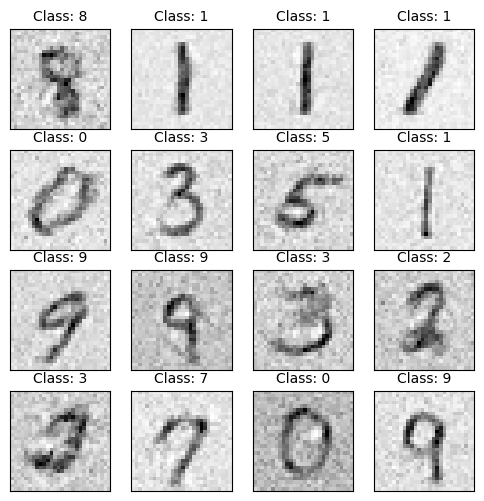

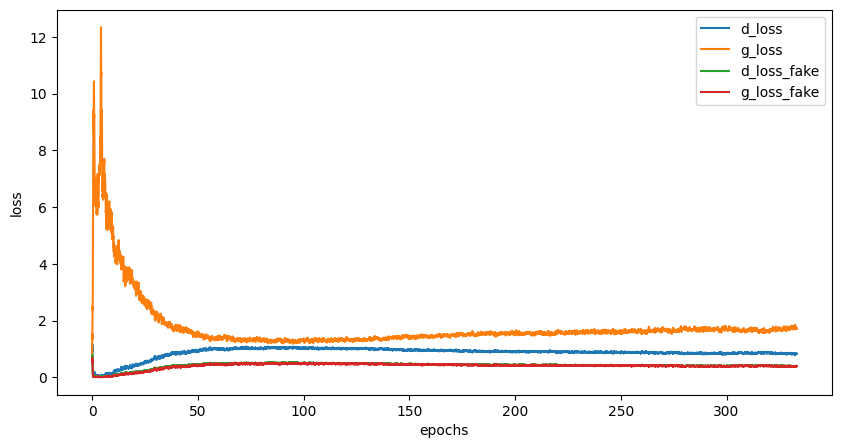

Epoch [334/500], Step[100/469], d_loss: 0.8681, d_loss_fake: 0.4108, g_loss: 1.7750, g_loss_fake: 0.3557, D(x): 0.72, D(G(z)): 0.27
Epoch [334/500], Step[200/469], d_loss: 0.8653, d_loss_fake: 0.4122, g_loss: 1.6473, g_loss_fake: 0.3684, D(x): 0.73, D(G(z)): 0.28
Epoch [334/500], Step[300/469], d_loss: 0.8489, d_loss_fake: 0.3960, g_loss: 1.6784, g_loss_fake: 0.3401, D(x): 0.72, D(G(z)): 0.28
Epoch [334/500], Step[400/469], d_loss: 0.9806, d_loss_fake: 0.4376, g_loss: 1.8153, g_loss_fake: 0.4368, D(x): 0.68, D(G(z)): 0.28


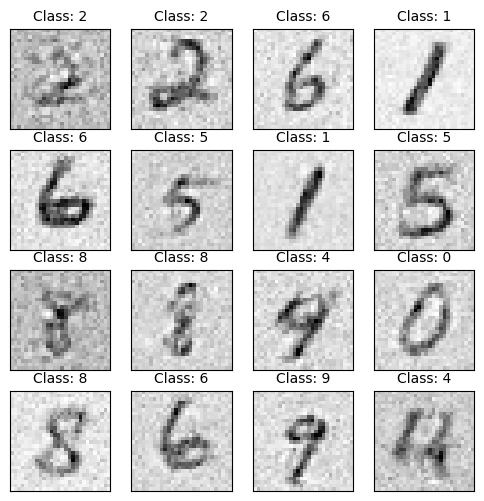

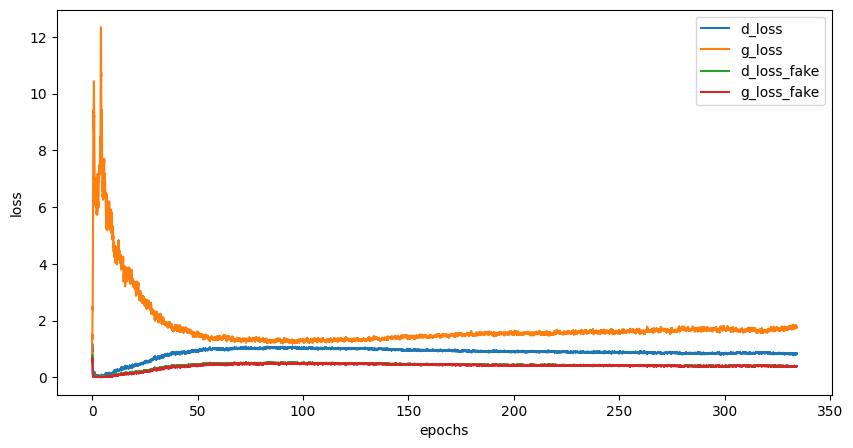

Epoch [335/500], Step[100/469], d_loss: 0.7759, d_loss_fake: 0.3413, g_loss: 1.7115, g_loss_fake: 0.3429, D(x): 0.73, D(G(z)): 0.25
Epoch [335/500], Step[200/469], d_loss: 0.8237, d_loss_fake: 0.4407, g_loss: 1.6509, g_loss_fake: 0.5315, D(x): 0.77, D(G(z)): 0.29
Epoch [335/500], Step[300/469], d_loss: 0.7832, d_loss_fake: 0.3431, g_loss: 1.8903, g_loss_fake: 0.3696, D(x): 0.72, D(G(z)): 0.25
Epoch [335/500], Step[400/469], d_loss: 0.8482, d_loss_fake: 0.3822, g_loss: 1.7819, g_loss_fake: 0.3810, D(x): 0.72, D(G(z)): 0.27


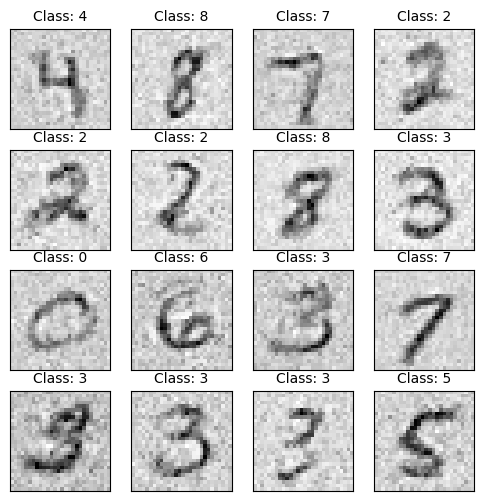

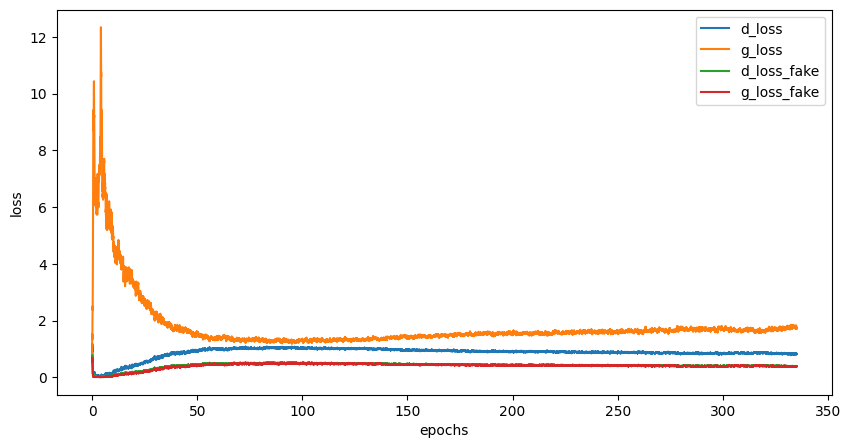

Epoch [336/500], Step[100/469], d_loss: 0.8227, d_loss_fake: 0.4800, g_loss: 1.8829, g_loss_fake: 0.4090, D(x): 0.77, D(G(z)): 0.28
Epoch [336/500], Step[200/469], d_loss: 0.9515, d_loss_fake: 0.3738, g_loss: 1.7850, g_loss_fake: 0.3718, D(x): 0.66, D(G(z)): 0.26
Epoch [336/500], Step[300/469], d_loss: 0.7586, d_loss_fake: 0.3406, g_loss: 1.7612, g_loss_fake: 0.4151, D(x): 0.74, D(G(z)): 0.25
Epoch [336/500], Step[400/469], d_loss: 0.7932, d_loss_fake: 0.3255, g_loss: 1.7566, g_loss_fake: 0.3381, D(x): 0.71, D(G(z)): 0.25


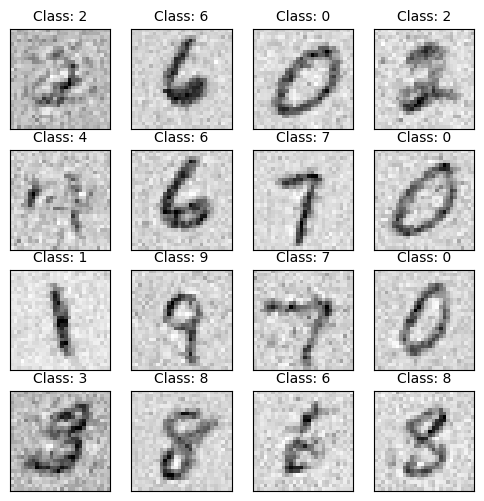

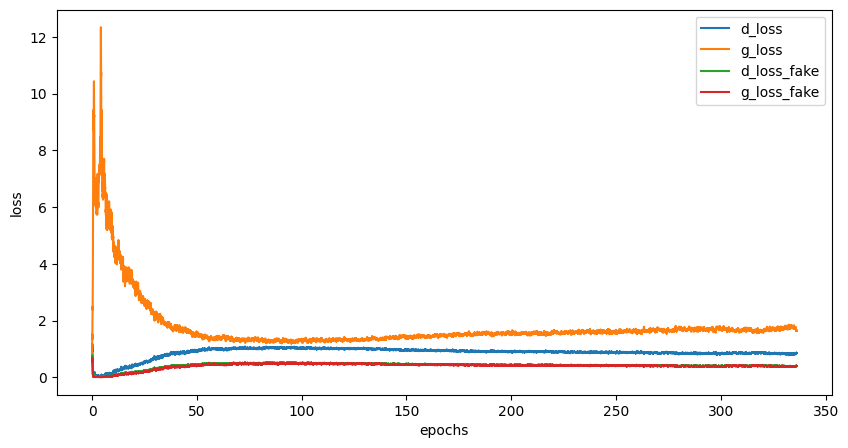

Epoch [337/500], Step[100/469], d_loss: 0.6784, d_loss_fake: 0.3794, g_loss: 1.9388, g_loss_fake: 0.3145, D(x): 0.79, D(G(z)): 0.27
Epoch [337/500], Step[200/469], d_loss: 0.7096, d_loss_fake: 0.2640, g_loss: 1.6744, g_loss_fake: 0.3534, D(x): 0.72, D(G(z)): 0.21
Epoch [337/500], Step[300/469], d_loss: 0.7769, d_loss_fake: 0.2997, g_loss: 1.7829, g_loss_fake: 0.3308, D(x): 0.70, D(G(z)): 0.23
Epoch [337/500], Step[400/469], d_loss: 0.7960, d_loss_fake: 0.3729, g_loss: 1.6871, g_loss_fake: 0.4296, D(x): 0.75, D(G(z)): 0.25


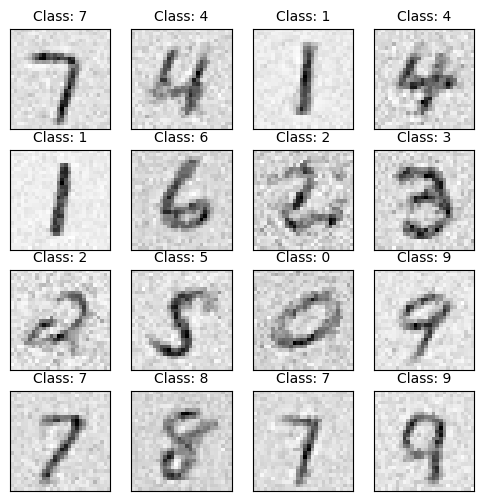

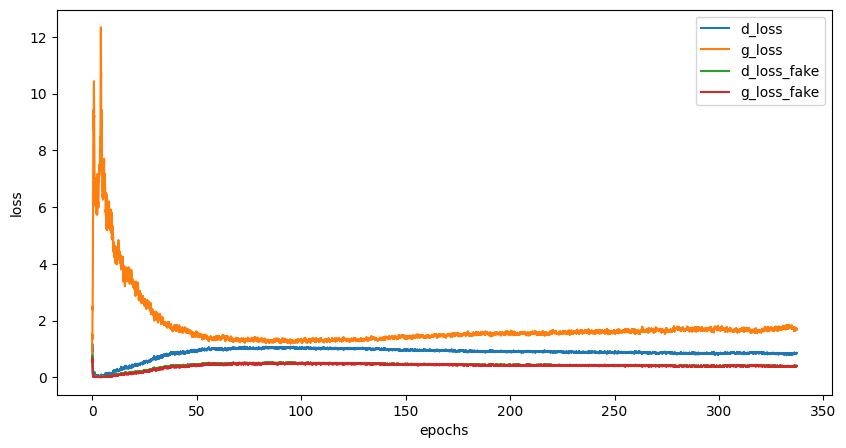

Epoch [338/500], Step[100/469], d_loss: 0.7749, d_loss_fake: 0.3472, g_loss: 1.6536, g_loss_fake: 0.3613, D(x): 0.74, D(G(z)): 0.26
Epoch [338/500], Step[200/469], d_loss: 0.6977, d_loss_fake: 0.2755, g_loss: 1.8230, g_loss_fake: 0.3840, D(x): 0.74, D(G(z)): 0.21
Epoch [338/500], Step[300/469], d_loss: 0.7537, d_loss_fake: 0.3793, g_loss: 1.6000, g_loss_fake: 0.3962, D(x): 0.77, D(G(z)): 0.26
Epoch [338/500], Step[400/469], d_loss: 0.8572, d_loss_fake: 0.3413, g_loss: 1.9107, g_loss_fake: 0.3621, D(x): 0.70, D(G(z)): 0.24


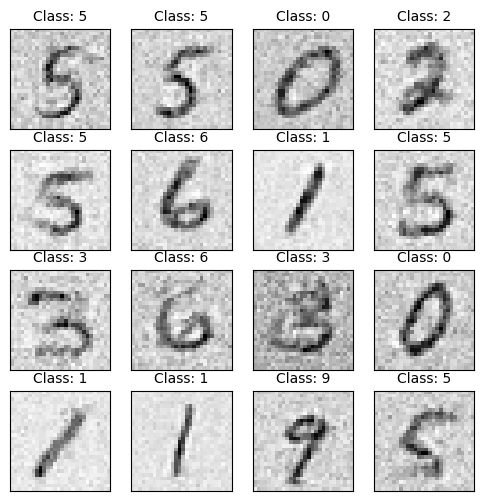

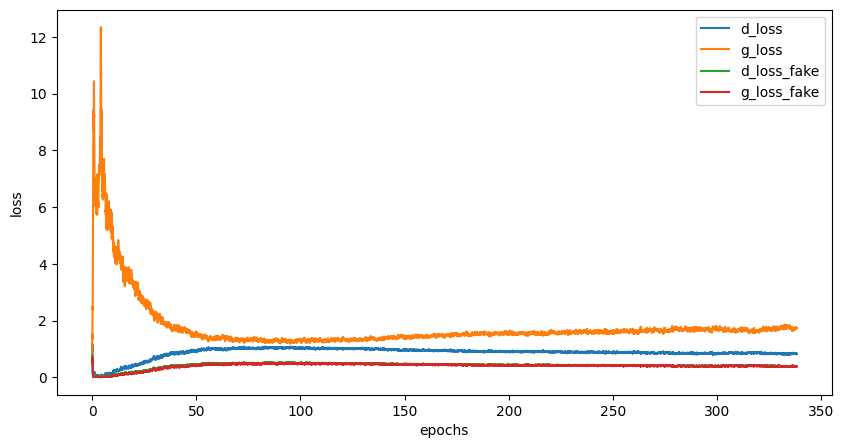

Epoch [339/500], Step[100/469], d_loss: 0.7564, d_loss_fake: 0.3398, g_loss: 1.8719, g_loss_fake: 0.3447, D(x): 0.75, D(G(z)): 0.26
Epoch [339/500], Step[200/469], d_loss: 0.7732, d_loss_fake: 0.4014, g_loss: 1.6672, g_loss_fake: 0.3550, D(x): 0.75, D(G(z)): 0.28
Epoch [339/500], Step[300/469], d_loss: 0.9356, d_loss_fake: 0.4462, g_loss: 1.7372, g_loss_fake: 0.4062, D(x): 0.70, D(G(z)): 0.27
Epoch [339/500], Step[400/469], d_loss: 0.8637, d_loss_fake: 0.3398, g_loss: 1.9870, g_loss_fake: 0.2848, D(x): 0.70, D(G(z)): 0.24


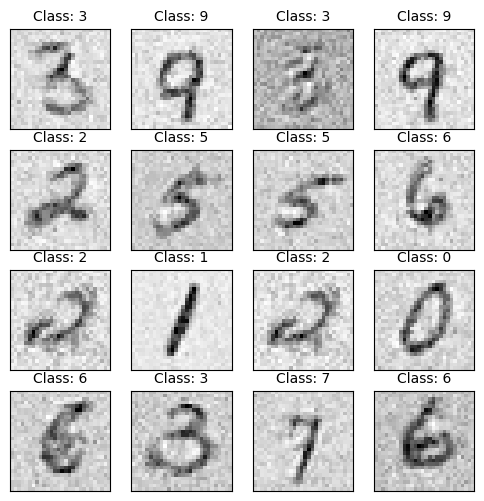

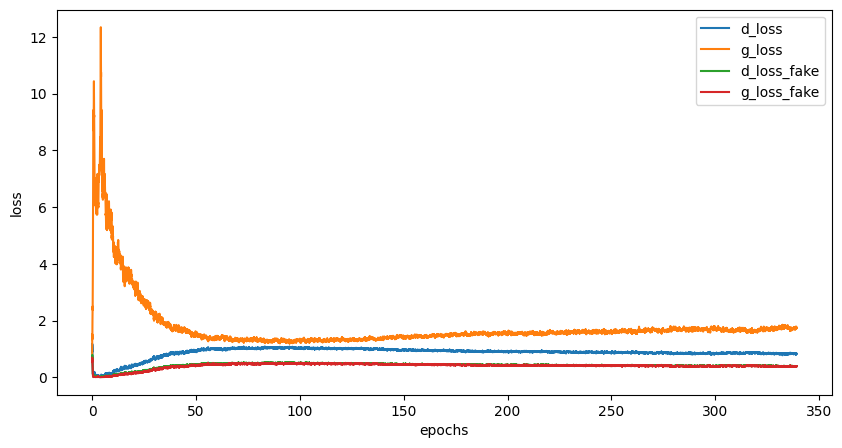

Epoch [340/500], Step[100/469], d_loss: 0.7572, d_loss_fake: 0.2795, g_loss: 1.6601, g_loss_fake: 0.4182, D(x): 0.70, D(G(z)): 0.20
Epoch [340/500], Step[200/469], d_loss: 0.8064, d_loss_fake: 0.4502, g_loss: 1.7901, g_loss_fake: 0.3285, D(x): 0.78, D(G(z)): 0.31
Epoch [340/500], Step[300/469], d_loss: 0.9887, d_loss_fake: 0.4535, g_loss: 1.6305, g_loss_fake: 0.3554, D(x): 0.68, D(G(z)): 0.28
Epoch [340/500], Step[400/469], d_loss: 0.8156, d_loss_fake: 0.3523, g_loss: 1.5926, g_loss_fake: 0.3795, D(x): 0.71, D(G(z)): 0.25


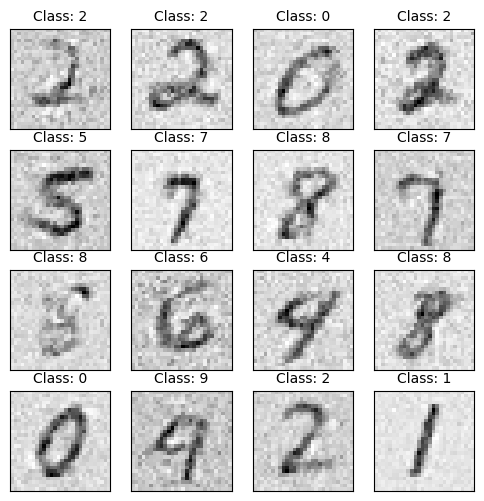

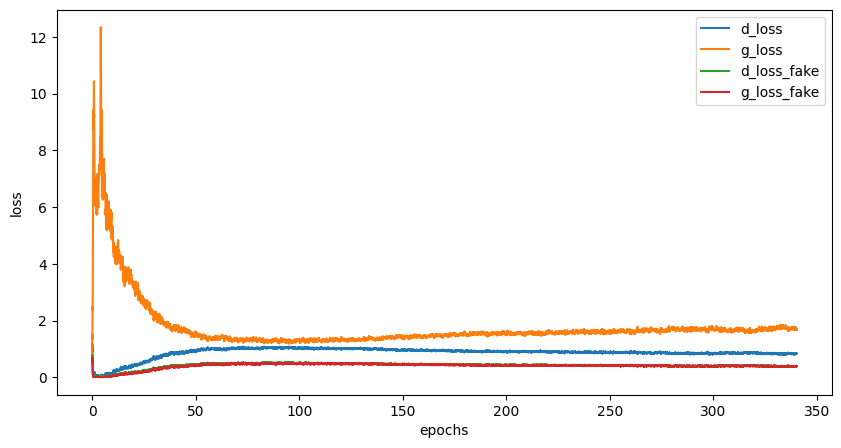

Epoch [341/500], Step[100/469], d_loss: 0.7641, d_loss_fake: 0.3965, g_loss: 1.7197, g_loss_fake: 0.3596, D(x): 0.77, D(G(z)): 0.28
Epoch [341/500], Step[200/469], d_loss: 0.7348, d_loss_fake: 0.3630, g_loss: 1.7555, g_loss_fake: 0.3520, D(x): 0.76, D(G(z)): 0.25
Epoch [341/500], Step[300/469], d_loss: 0.7820, d_loss_fake: 0.3709, g_loss: 1.7681, g_loss_fake: 0.3737, D(x): 0.74, D(G(z)): 0.27
Epoch [341/500], Step[400/469], d_loss: 0.8988, d_loss_fake: 0.4120, g_loss: 1.4874, g_loss_fake: 0.4454, D(x): 0.70, D(G(z)): 0.30


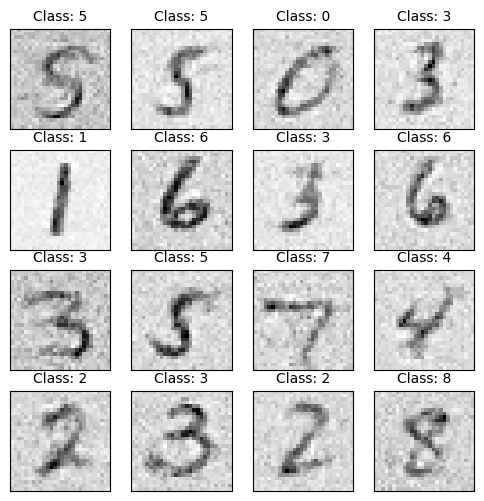

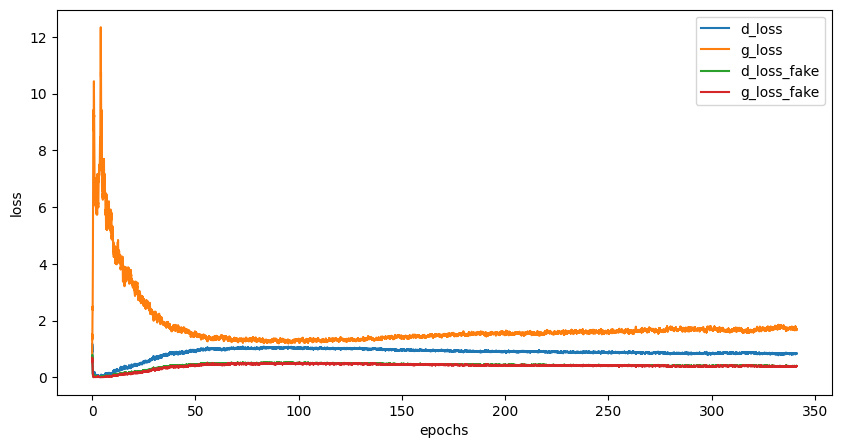

Epoch [342/500], Step[100/469], d_loss: 0.8759, d_loss_fake: 0.4694, g_loss: 1.4206, g_loss_fake: 0.5673, D(x): 0.75, D(G(z)): 0.32
Epoch [342/500], Step[200/469], d_loss: 0.8176, d_loss_fake: 0.4479, g_loss: 1.5571, g_loss_fake: 0.4081, D(x): 0.75, D(G(z)): 0.30
Epoch [342/500], Step[300/469], d_loss: 0.8876, d_loss_fake: 0.4332, g_loss: 1.8250, g_loss_fake: 0.3565, D(x): 0.72, D(G(z)): 0.28
Epoch [342/500], Step[400/469], d_loss: 0.5661, d_loss_fake: 0.2977, g_loss: 1.7182, g_loss_fake: 0.3676, D(x): 0.81, D(G(z)): 0.23


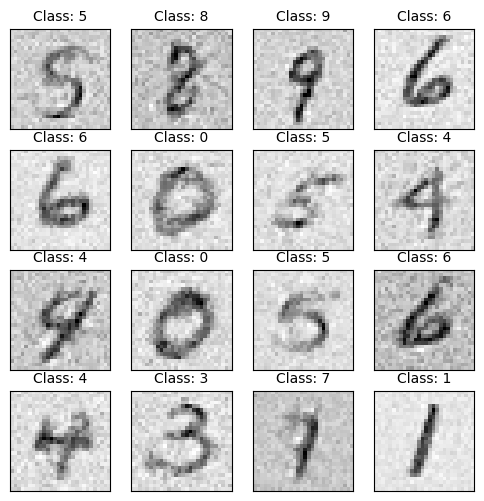

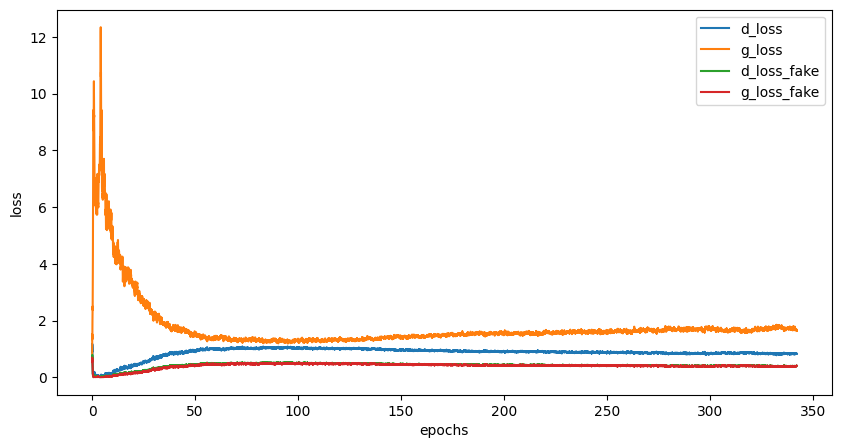

Epoch [343/500], Step[100/469], d_loss: 0.7401, d_loss_fake: 0.4477, g_loss: 1.4562, g_loss_fake: 0.4135, D(x): 0.81, D(G(z)): 0.30
Epoch [343/500], Step[200/469], d_loss: 0.8152, d_loss_fake: 0.4079, g_loss: 1.5230, g_loss_fake: 0.4257, D(x): 0.74, D(G(z)): 0.28
Epoch [343/500], Step[300/469], d_loss: 0.9285, d_loss_fake: 0.3907, g_loss: 1.6472, g_loss_fake: 0.3433, D(x): 0.67, D(G(z)): 0.27
Epoch [343/500], Step[400/469], d_loss: 0.9025, d_loss_fake: 0.3455, g_loss: 1.9490, g_loss_fake: 0.3185, D(x): 0.67, D(G(z)): 0.25


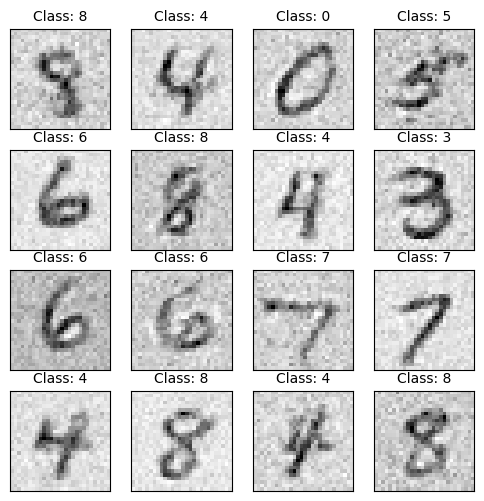

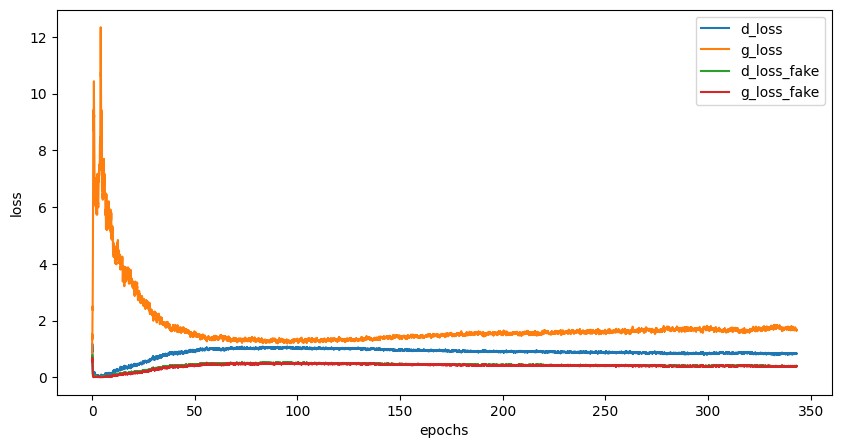

Epoch [344/500], Step[100/469], d_loss: 0.7612, d_loss_fake: 0.4046, g_loss: 1.8163, g_loss_fake: 0.3472, D(x): 0.76, D(G(z)): 0.27
Epoch [344/500], Step[200/469], d_loss: 0.7827, d_loss_fake: 0.3222, g_loss: 1.5335, g_loss_fake: 0.4788, D(x): 0.70, D(G(z)): 0.23
Epoch [344/500], Step[300/469], d_loss: 0.7398, d_loss_fake: 0.3262, g_loss: 1.7730, g_loss_fake: 0.3192, D(x): 0.74, D(G(z)): 0.24
Epoch [344/500], Step[400/469], d_loss: 0.9469, d_loss_fake: 0.4984, g_loss: 1.6164, g_loss_fake: 0.4496, D(x): 0.73, D(G(z)): 0.32


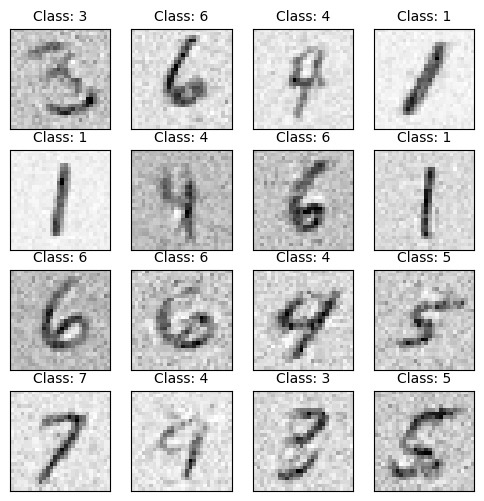

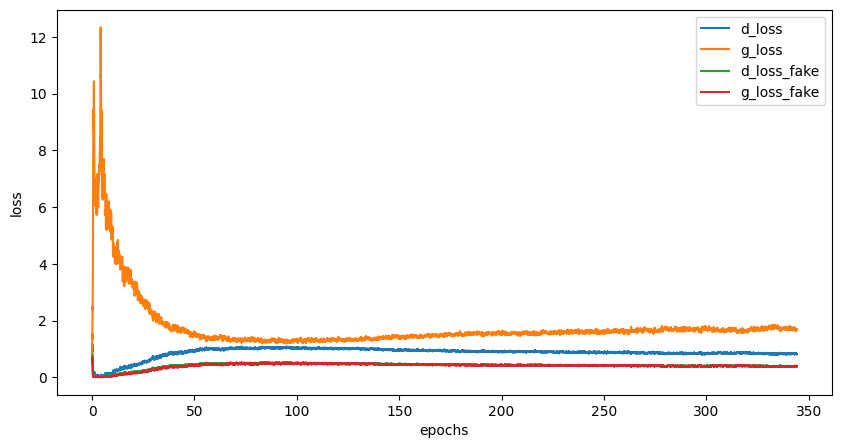

Epoch [345/500], Step[100/469], d_loss: 0.7704, d_loss_fake: 0.3866, g_loss: 1.8322, g_loss_fake: 0.3303, D(x): 0.75, D(G(z)): 0.25
Epoch [345/500], Step[200/469], d_loss: 0.7168, d_loss_fake: 0.4124, g_loss: 1.6620, g_loss_fake: 0.3367, D(x): 0.79, D(G(z)): 0.29
Epoch [345/500], Step[300/469], d_loss: 0.9127, d_loss_fake: 0.4280, g_loss: 1.5041, g_loss_fake: 0.4433, D(x): 0.71, D(G(z)): 0.29
Epoch [345/500], Step[400/469], d_loss: 0.8624, d_loss_fake: 0.3955, g_loss: 1.6294, g_loss_fake: 0.3890, D(x): 0.71, D(G(z)): 0.29


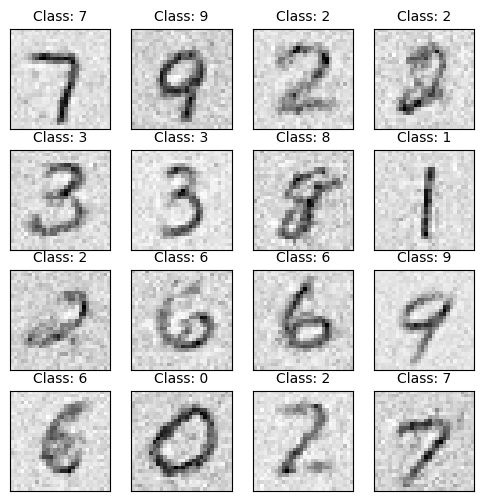

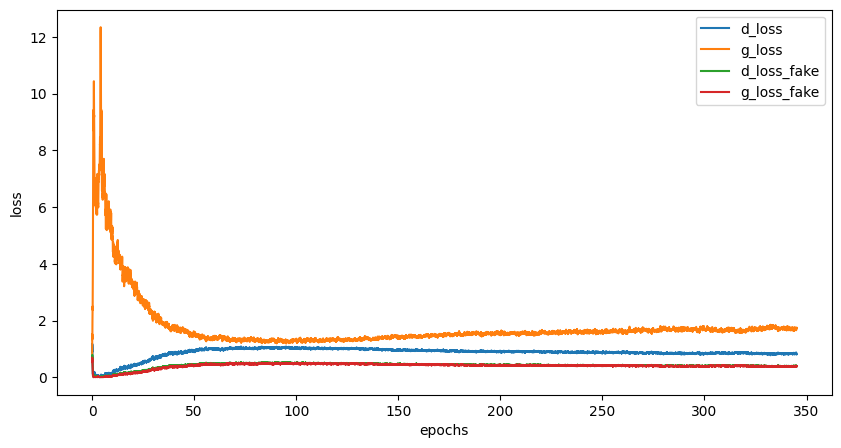

Epoch [346/500], Step[100/469], d_loss: 0.9080, d_loss_fake: 0.4939, g_loss: 1.5904, g_loss_fake: 0.5086, D(x): 0.73, D(G(z)): 0.32
Epoch [346/500], Step[200/469], d_loss: 0.8824, d_loss_fake: 0.3812, g_loss: 1.6153, g_loss_fake: 0.3781, D(x): 0.70, D(G(z)): 0.28
Epoch [346/500], Step[300/469], d_loss: 0.8751, d_loss_fake: 0.4116, g_loss: 1.7760, g_loss_fake: 0.3560, D(x): 0.73, D(G(z)): 0.28
Epoch [346/500], Step[400/469], d_loss: 0.9845, d_loss_fake: 0.5158, g_loss: 1.7068, g_loss_fake: 0.3357, D(x): 0.71, D(G(z)): 0.31


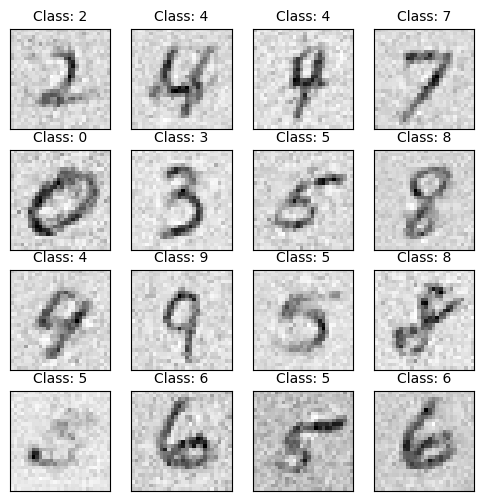

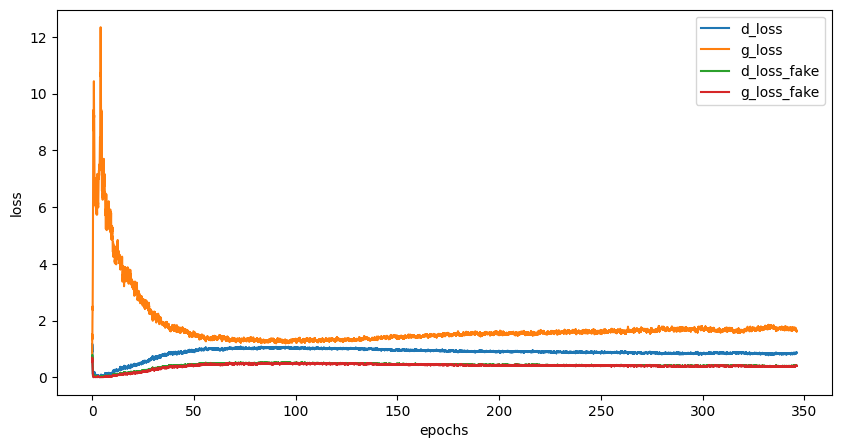

Epoch [347/500], Step[100/469], d_loss: 0.7841, d_loss_fake: 0.3214, g_loss: 1.6642, g_loss_fake: 0.4104, D(x): 0.70, D(G(z)): 0.24
Epoch [347/500], Step[200/469], d_loss: 0.7995, d_loss_fake: 0.4487, g_loss: 1.5102, g_loss_fake: 0.4372, D(x): 0.78, D(G(z)): 0.30
Epoch [347/500], Step[300/469], d_loss: 0.8291, d_loss_fake: 0.3371, g_loss: 1.7395, g_loss_fake: 0.3282, D(x): 0.71, D(G(z)): 0.25
Epoch [347/500], Step[400/469], d_loss: 0.7852, d_loss_fake: 0.3360, g_loss: 1.7665, g_loss_fake: 0.3396, D(x): 0.70, D(G(z)): 0.25


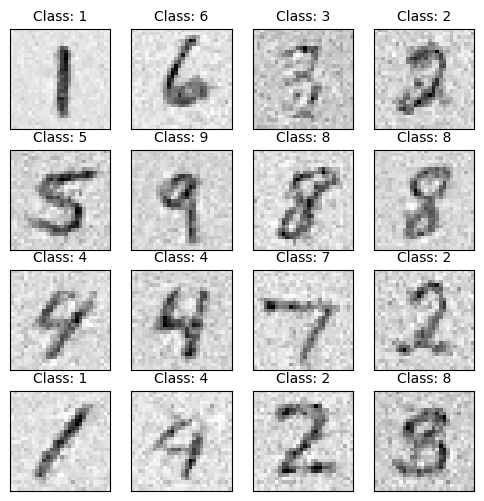

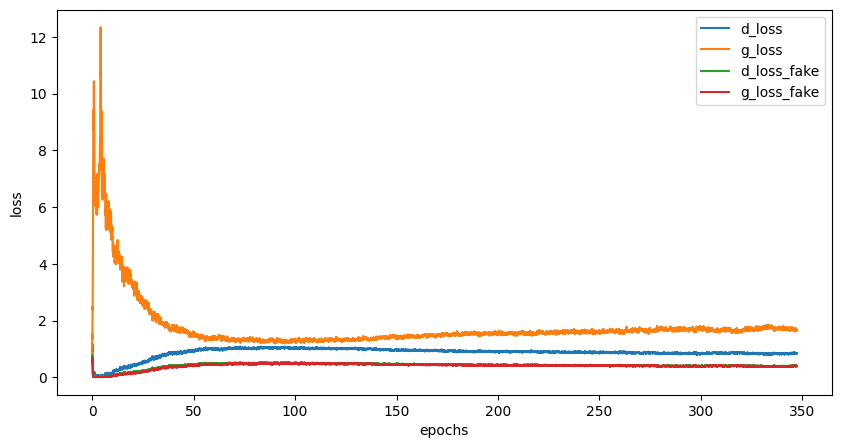

Epoch [348/500], Step[100/469], d_loss: 0.8757, d_loss_fake: 0.4439, g_loss: 1.6181, g_loss_fake: 0.4097, D(x): 0.72, D(G(z)): 0.31
Epoch [348/500], Step[200/469], d_loss: 0.8718, d_loss_fake: 0.4644, g_loss: 1.4449, g_loss_fake: 0.4345, D(x): 0.73, D(G(z)): 0.30
Epoch [348/500], Step[300/469], d_loss: 0.7786, d_loss_fake: 0.3697, g_loss: 1.4925, g_loss_fake: 0.4323, D(x): 0.74, D(G(z)): 0.27
Epoch [348/500], Step[400/469], d_loss: 0.9708, d_loss_fake: 0.4100, g_loss: 2.1091, g_loss_fake: 0.3489, D(x): 0.67, D(G(z)): 0.27


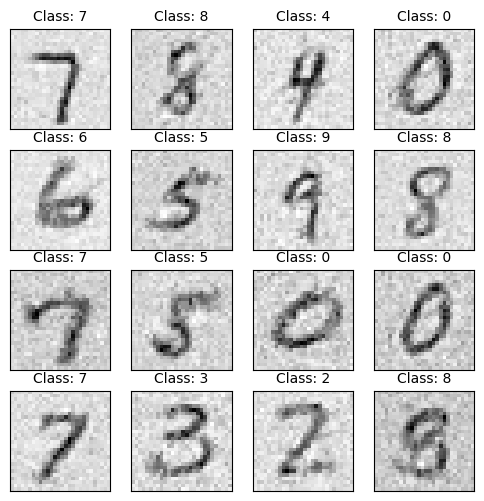

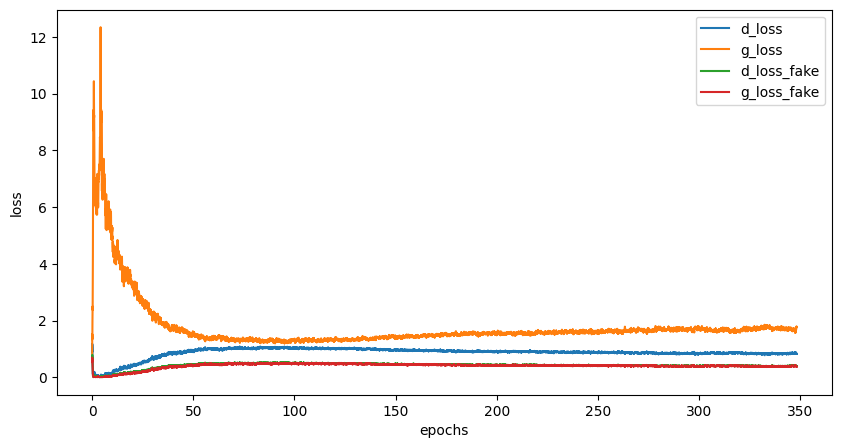

Epoch [349/500], Step[100/469], d_loss: 0.8907, d_loss_fake: 0.4305, g_loss: 1.8284, g_loss_fake: 0.3077, D(x): 0.71, D(G(z)): 0.28
Epoch [349/500], Step[200/469], d_loss: 0.8396, d_loss_fake: 0.3906, g_loss: 1.6186, g_loss_fake: 0.3696, D(x): 0.73, D(G(z)): 0.28
Epoch [349/500], Step[300/469], d_loss: 0.7322, d_loss_fake: 0.3739, g_loss: 1.5808, g_loss_fake: 0.4481, D(x): 0.77, D(G(z)): 0.27
Epoch [349/500], Step[400/469], d_loss: 0.8862, d_loss_fake: 0.4018, g_loss: 2.1997, g_loss_fake: 0.3182, D(x): 0.72, D(G(z)): 0.25


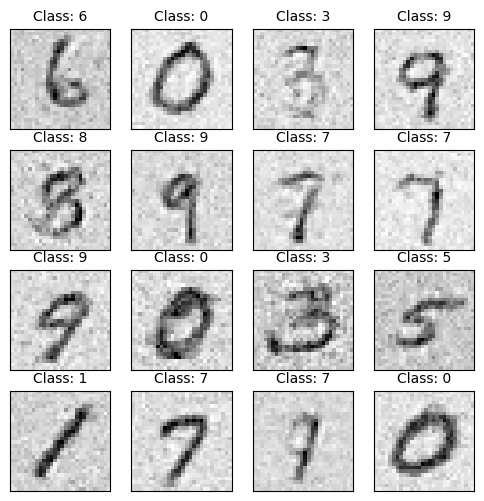

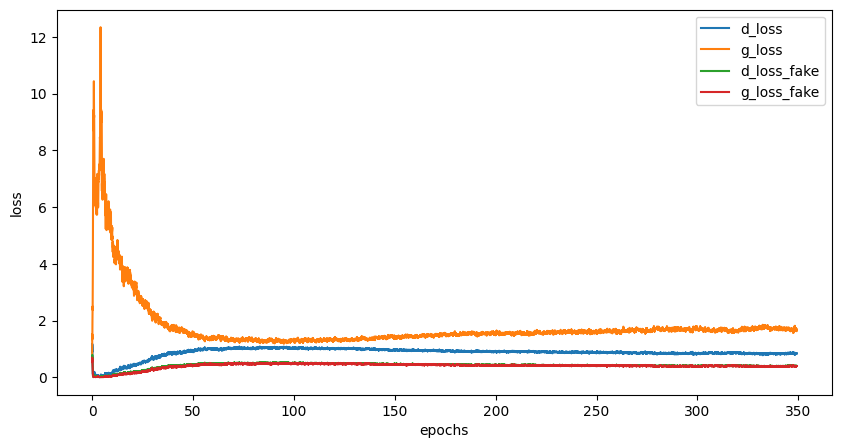

Epoch [350/500], Step[100/469], d_loss: 0.7972, d_loss_fake: 0.3306, g_loss: 1.8883, g_loss_fake: 0.4160, D(x): 0.72, D(G(z)): 0.24
Epoch [350/500], Step[200/469], d_loss: 0.7970, d_loss_fake: 0.4136, g_loss: 1.6107, g_loss_fake: 0.4449, D(x): 0.77, D(G(z)): 0.28
Epoch [350/500], Step[300/469], d_loss: 0.7742, d_loss_fake: 0.3671, g_loss: 1.7329, g_loss_fake: 0.3861, D(x): 0.74, D(G(z)): 0.27
Epoch [350/500], Step[400/469], d_loss: 0.8608, d_loss_fake: 0.4476, g_loss: 1.7299, g_loss_fake: 0.3528, D(x): 0.73, D(G(z)): 0.29


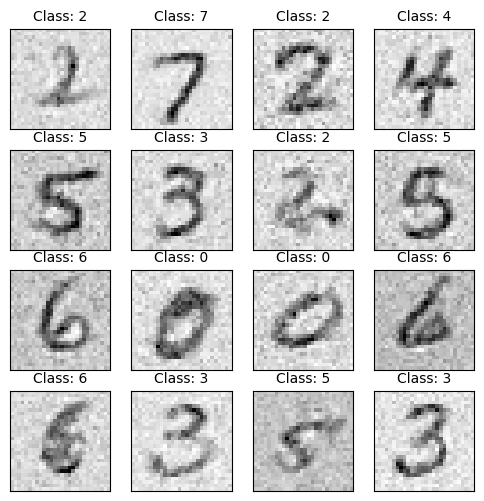

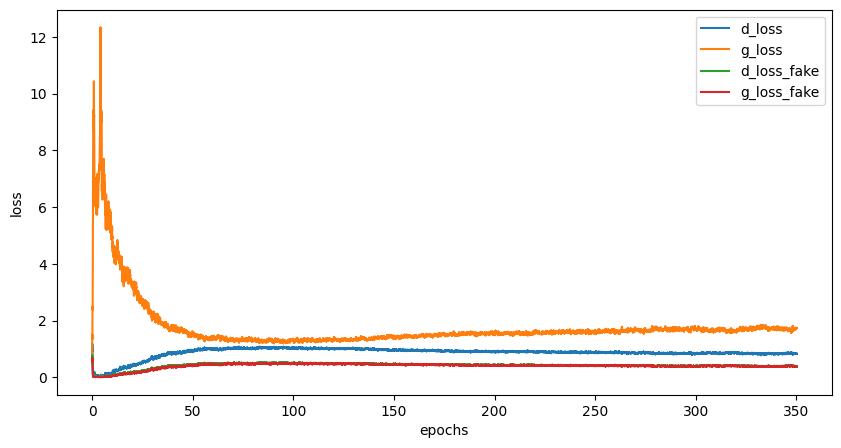

Epoch [351/500], Step[100/469], d_loss: 0.7568, d_loss_fake: 0.2633, g_loss: 1.8586, g_loss_fake: 0.3122, D(x): 0.69, D(G(z)): 0.20
Epoch [351/500], Step[200/469], d_loss: 0.7970, d_loss_fake: 0.4201, g_loss: 1.4880, g_loss_fake: 0.5426, D(x): 0.76, D(G(z)): 0.28
Epoch [351/500], Step[300/469], d_loss: 0.8655, d_loss_fake: 0.3750, g_loss: 1.6277, g_loss_fake: 0.3614, D(x): 0.70, D(G(z)): 0.25
Epoch [351/500], Step[400/469], d_loss: 0.8768, d_loss_fake: 0.4605, g_loss: 1.4054, g_loss_fake: 0.4469, D(x): 0.74, D(G(z)): 0.30


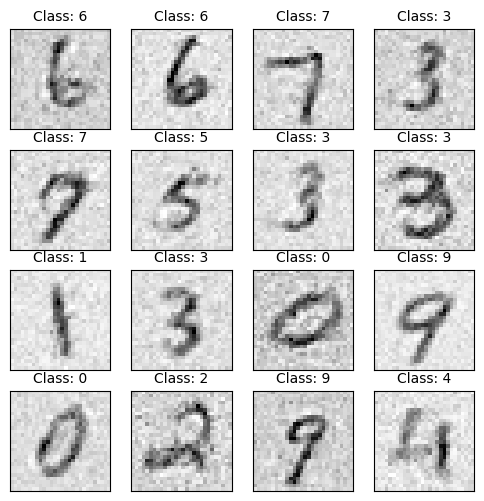

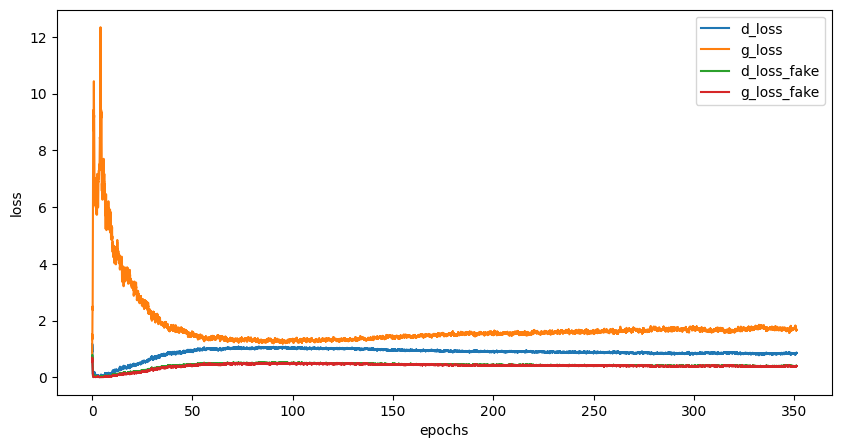

Epoch [352/500], Step[100/469], d_loss: 0.8294, d_loss_fake: 0.3473, g_loss: 1.7728, g_loss_fake: 0.3836, D(x): 0.71, D(G(z)): 0.25
Epoch [352/500], Step[200/469], d_loss: 0.8513, d_loss_fake: 0.3826, g_loss: 1.6941, g_loss_fake: 0.3245, D(x): 0.73, D(G(z)): 0.28
Epoch [352/500], Step[300/469], d_loss: 0.8744, d_loss_fake: 0.4348, g_loss: 1.5319, g_loss_fake: 0.4037, D(x): 0.73, D(G(z)): 0.30
Epoch [352/500], Step[400/469], d_loss: 0.8350, d_loss_fake: 0.3838, g_loss: 1.7745, g_loss_fake: 0.3716, D(x): 0.72, D(G(z)): 0.26


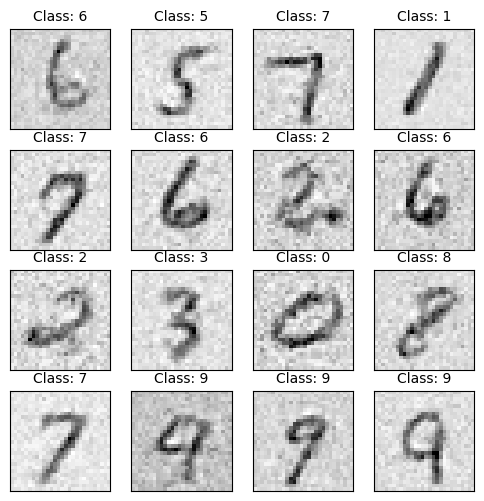

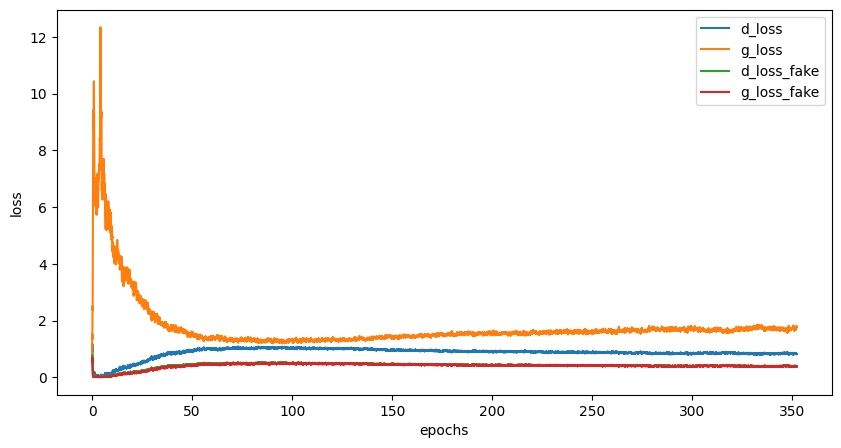

Epoch [353/500], Step[100/469], d_loss: 1.0211, d_loss_fake: 0.4532, g_loss: 1.7451, g_loss_fake: 0.3858, D(x): 0.68, D(G(z)): 0.29
Epoch [353/500], Step[200/469], d_loss: 0.8506, d_loss_fake: 0.3463, g_loss: 1.8554, g_loss_fake: 0.3480, D(x): 0.70, D(G(z)): 0.23
Epoch [353/500], Step[300/469], d_loss: 0.8960, d_loss_fake: 0.4445, g_loss: 1.8122, g_loss_fake: 0.3188, D(x): 0.72, D(G(z)): 0.30
Epoch [353/500], Step[400/469], d_loss: 0.8955, d_loss_fake: 0.4998, g_loss: 1.6131, g_loss_fake: 0.4189, D(x): 0.74, D(G(z)): 0.31


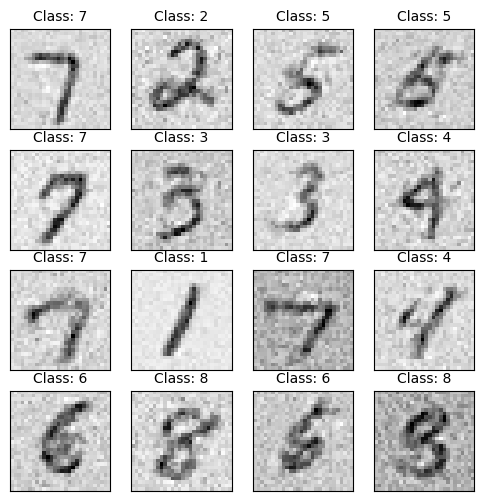

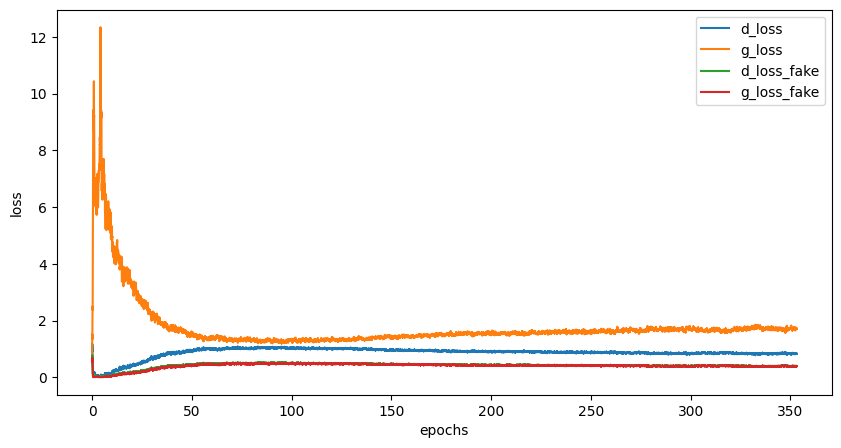

Epoch [354/500], Step[100/469], d_loss: 0.9257, d_loss_fake: 0.4370, g_loss: 1.5428, g_loss_fake: 0.4450, D(x): 0.71, D(G(z)): 0.30
Epoch [354/500], Step[200/469], d_loss: 0.9385, d_loss_fake: 0.4097, g_loss: 1.7206, g_loss_fake: 0.3885, D(x): 0.67, D(G(z)): 0.27
Epoch [354/500], Step[300/469], d_loss: 0.7494, d_loss_fake: 0.3627, g_loss: 1.5891, g_loss_fake: 0.4125, D(x): 0.75, D(G(z)): 0.27
Epoch [354/500], Step[400/469], d_loss: 0.7813, d_loss_fake: 0.3943, g_loss: 1.8513, g_loss_fake: 0.3417, D(x): 0.74, D(G(z)): 0.26


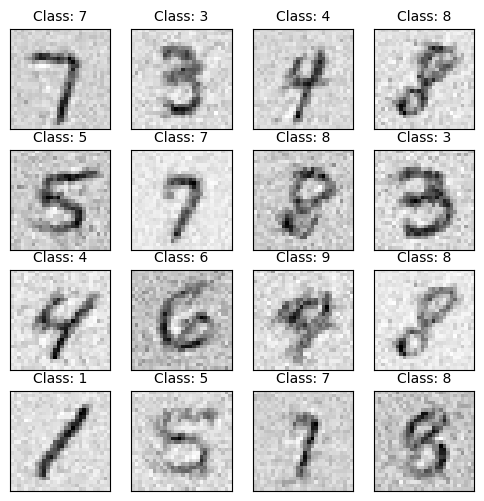

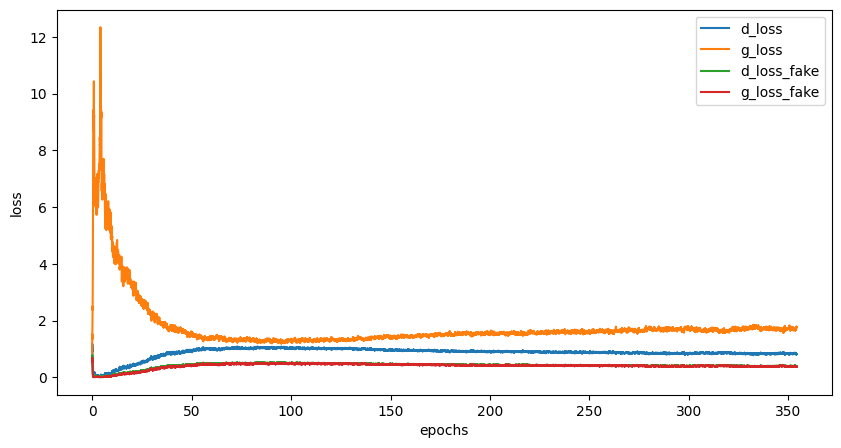

Epoch [355/500], Step[100/469], d_loss: 0.8390, d_loss_fake: 0.3749, g_loss: 1.9745, g_loss_fake: 0.3121, D(x): 0.72, D(G(z)): 0.26
Epoch [355/500], Step[200/469], d_loss: 0.8595, d_loss_fake: 0.3915, g_loss: 1.6675, g_loss_fake: 0.4099, D(x): 0.72, D(G(z)): 0.27
Epoch [355/500], Step[300/469], d_loss: 0.9108, d_loss_fake: 0.4111, g_loss: 1.8631, g_loss_fake: 0.3599, D(x): 0.70, D(G(z)): 0.27
Epoch [355/500], Step[400/469], d_loss: 0.8868, d_loss_fake: 0.3623, g_loss: 1.6059, g_loss_fake: 0.3995, D(x): 0.69, D(G(z)): 0.26


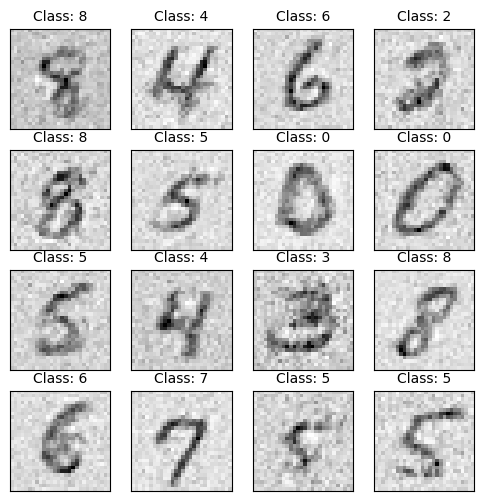

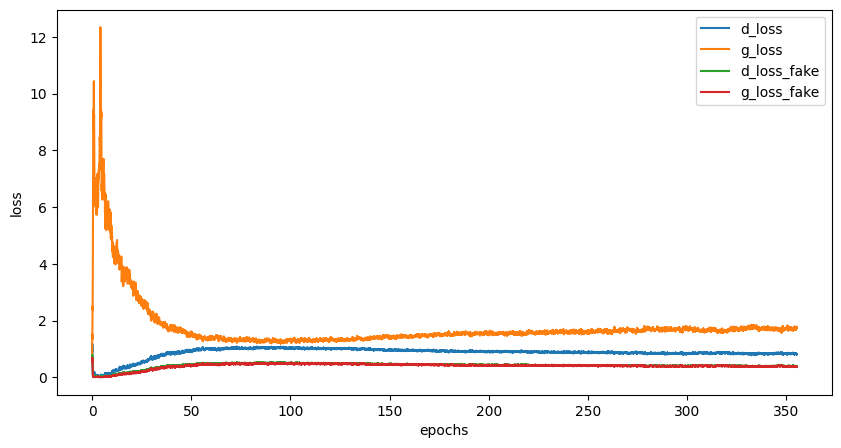

Epoch [356/500], Step[100/469], d_loss: 0.8505, d_loss_fake: 0.4381, g_loss: 1.5981, g_loss_fake: 0.4602, D(x): 0.75, D(G(z)): 0.29
Epoch [356/500], Step[200/469], d_loss: 0.8640, d_loss_fake: 0.4344, g_loss: 1.8615, g_loss_fake: 0.3626, D(x): 0.73, D(G(z)): 0.27
Epoch [356/500], Step[300/469], d_loss: 0.8869, d_loss_fake: 0.3726, g_loss: 1.8386, g_loss_fake: 0.3159, D(x): 0.70, D(G(z)): 0.26
Epoch [356/500], Step[400/469], d_loss: 0.9950, d_loss_fake: 0.4627, g_loss: 1.4673, g_loss_fake: 0.5094, D(x): 0.70, D(G(z)): 0.29


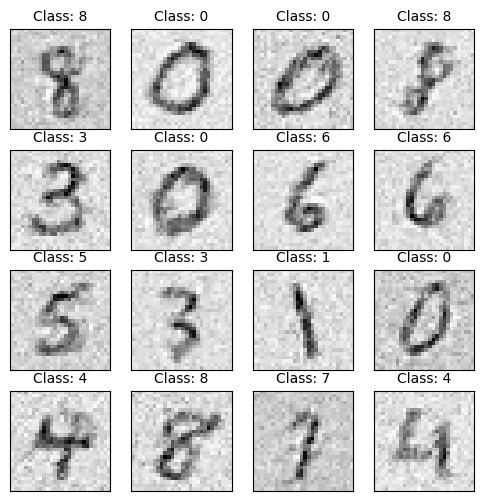

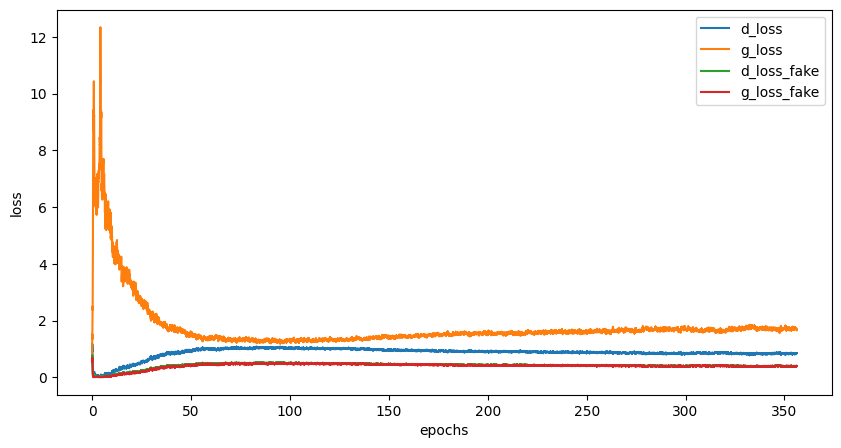

Epoch [357/500], Step[100/469], d_loss: 0.8738, d_loss_fake: 0.4664, g_loss: 1.6635, g_loss_fake: 0.3589, D(x): 0.74, D(G(z)): 0.30
Epoch [357/500], Step[200/469], d_loss: 0.8501, d_loss_fake: 0.4435, g_loss: 1.4105, g_loss_fake: 0.4946, D(x): 0.74, D(G(z)): 0.29
Epoch [357/500], Step[300/469], d_loss: 0.7282, d_loss_fake: 0.3857, g_loss: 1.6993, g_loss_fake: 0.3944, D(x): 0.77, D(G(z)): 0.26
Epoch [357/500], Step[400/469], d_loss: 0.9917, d_loss_fake: 0.4966, g_loss: 1.8377, g_loss_fake: 0.3066, D(x): 0.71, D(G(z)): 0.30


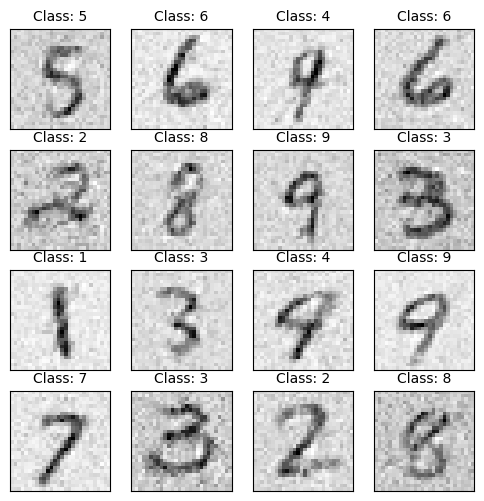

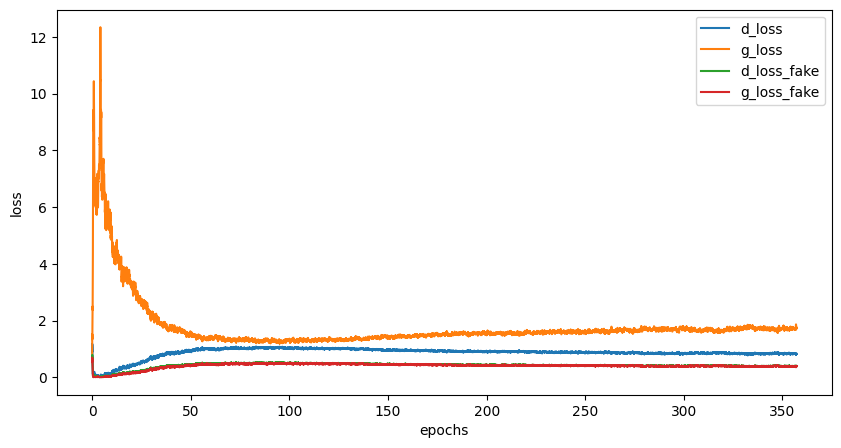

Epoch [358/500], Step[100/469], d_loss: 0.7893, d_loss_fake: 0.4462, g_loss: 1.5740, g_loss_fake: 0.4347, D(x): 0.79, D(G(z)): 0.29
Epoch [358/500], Step[200/469], d_loss: 0.8998, d_loss_fake: 0.3411, g_loss: 2.0276, g_loss_fake: 0.2670, D(x): 0.69, D(G(z)): 0.23
Epoch [358/500], Step[300/469], d_loss: 0.8848, d_loss_fake: 0.4374, g_loss: 1.8876, g_loss_fake: 0.2978, D(x): 0.72, D(G(z)): 0.28
Epoch [358/500], Step[400/469], d_loss: 0.8539, d_loss_fake: 0.4720, g_loss: 1.5075, g_loss_fake: 0.4383, D(x): 0.75, D(G(z)): 0.30


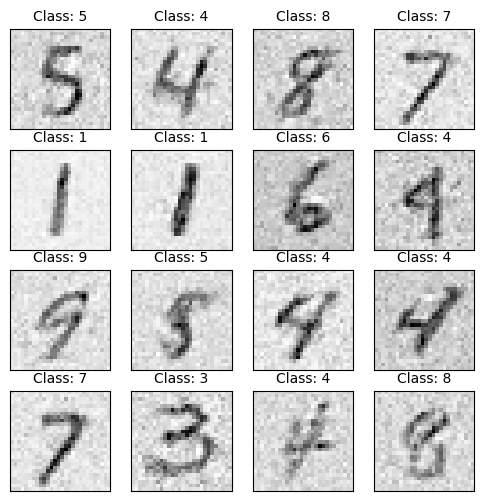

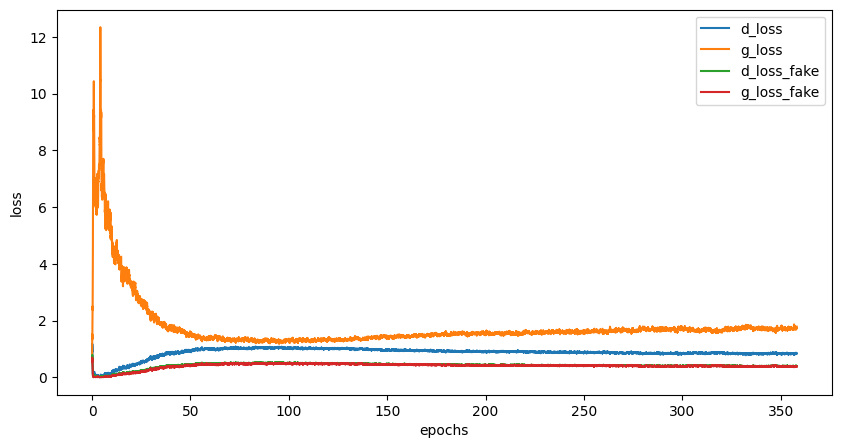

Epoch [359/500], Step[100/469], d_loss: 0.7480, d_loss_fake: 0.4129, g_loss: 1.6199, g_loss_fake: 0.4199, D(x): 0.79, D(G(z)): 0.29
Epoch [359/500], Step[200/469], d_loss: 0.8437, d_loss_fake: 0.3834, g_loss: 1.7963, g_loss_fake: 0.4320, D(x): 0.73, D(G(z)): 0.26
Epoch [359/500], Step[300/469], d_loss: 0.8820, d_loss_fake: 0.3914, g_loss: 1.7979, g_loss_fake: 0.3372, D(x): 0.69, D(G(z)): 0.28
Epoch [359/500], Step[400/469], d_loss: 0.8543, d_loss_fake: 0.4727, g_loss: 1.6167, g_loss_fake: 0.4339, D(x): 0.76, D(G(z)): 0.30


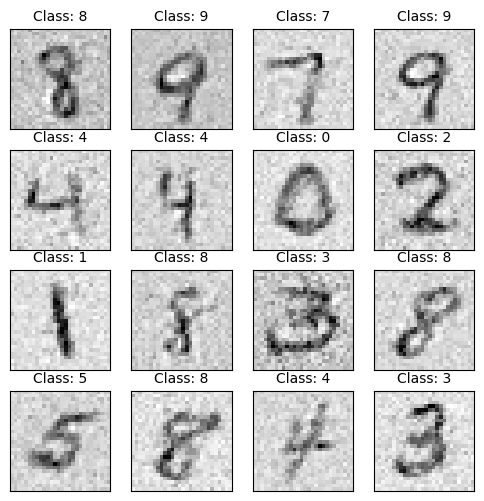

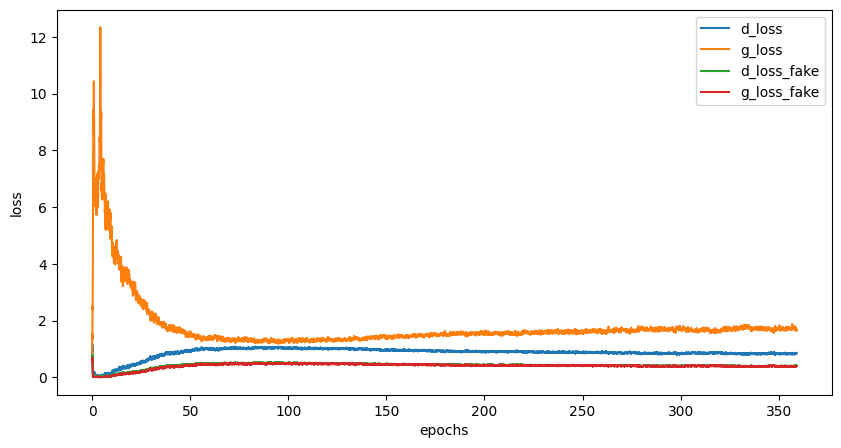

Epoch [360/500], Step[100/469], d_loss: 0.6623, d_loss_fake: 0.2971, g_loss: 1.8780, g_loss_fake: 0.3610, D(x): 0.75, D(G(z)): 0.23
Epoch [360/500], Step[200/469], d_loss: 0.8571, d_loss_fake: 0.3246, g_loss: 1.7372, g_loss_fake: 0.3606, D(x): 0.68, D(G(z)): 0.24
Epoch [360/500], Step[300/469], d_loss: 0.8571, d_loss_fake: 0.3057, g_loss: 1.9230, g_loss_fake: 0.3698, D(x): 0.67, D(G(z)): 0.23
Epoch [360/500], Step[400/469], d_loss: 0.8847, d_loss_fake: 0.4254, g_loss: 1.7045, g_loss_fake: 0.3884, D(x): 0.71, D(G(z)): 0.29


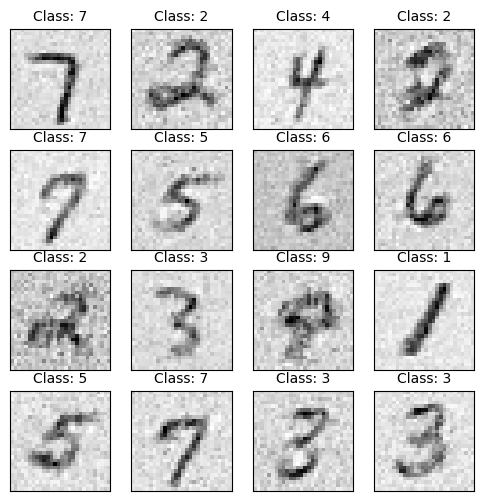

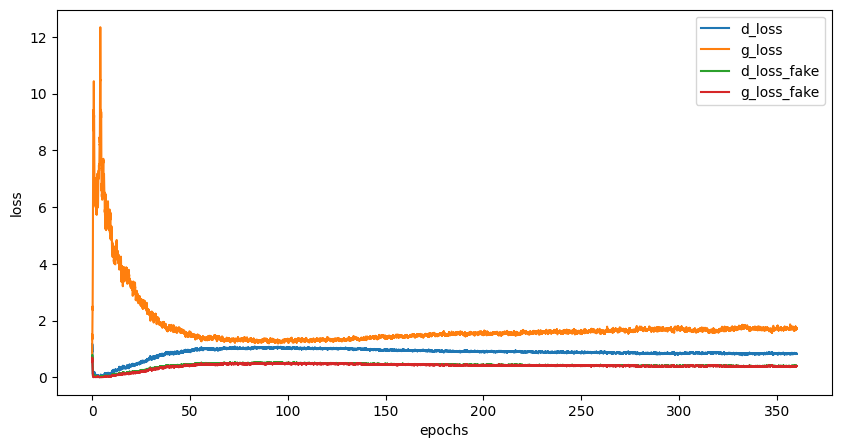

Epoch [361/500], Step[100/469], d_loss: 0.8077, d_loss_fake: 0.4194, g_loss: 1.7028, g_loss_fake: 0.4175, D(x): 0.76, D(G(z)): 0.29
Epoch [361/500], Step[200/469], d_loss: 0.8312, d_loss_fake: 0.3738, g_loss: 1.5997, g_loss_fake: 0.4362, D(x): 0.72, D(G(z)): 0.27
Epoch [361/500], Step[300/469], d_loss: 0.7331, d_loss_fake: 0.3547, g_loss: 2.0039, g_loss_fake: 0.3132, D(x): 0.74, D(G(z)): 0.23
Epoch [361/500], Step[400/469], d_loss: 0.8039, d_loss_fake: 0.3749, g_loss: 1.7115, g_loss_fake: 0.3844, D(x): 0.73, D(G(z)): 0.26


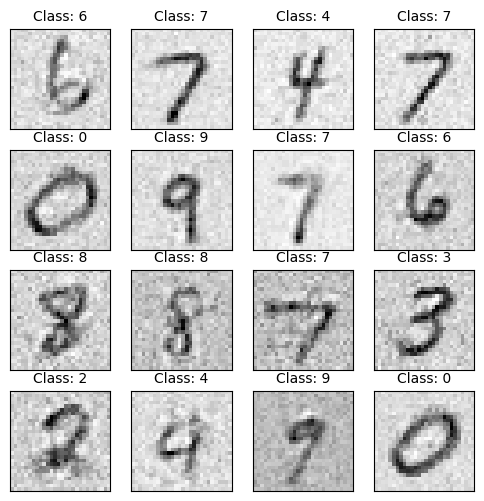

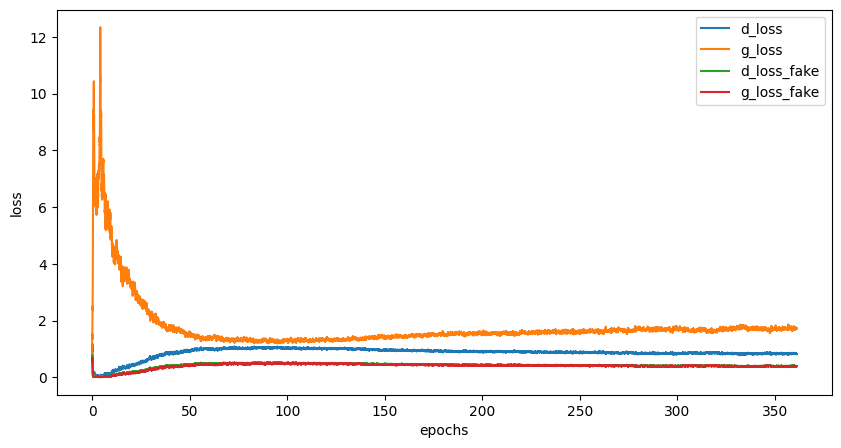

Epoch [362/500], Step[100/469], d_loss: 0.8569, d_loss_fake: 0.4692, g_loss: 1.4909, g_loss_fake: 0.4863, D(x): 0.75, D(G(z)): 0.31
Epoch [362/500], Step[200/469], d_loss: 0.8233, d_loss_fake: 0.4122, g_loss: 1.7841, g_loss_fake: 0.4404, D(x): 0.73, D(G(z)): 0.28
Epoch [362/500], Step[300/469], d_loss: 0.8231, d_loss_fake: 0.4498, g_loss: 1.7447, g_loss_fake: 0.3759, D(x): 0.76, D(G(z)): 0.28
Epoch [362/500], Step[400/469], d_loss: 0.8127, d_loss_fake: 0.3927, g_loss: 1.8376, g_loss_fake: 0.2968, D(x): 0.73, D(G(z)): 0.26


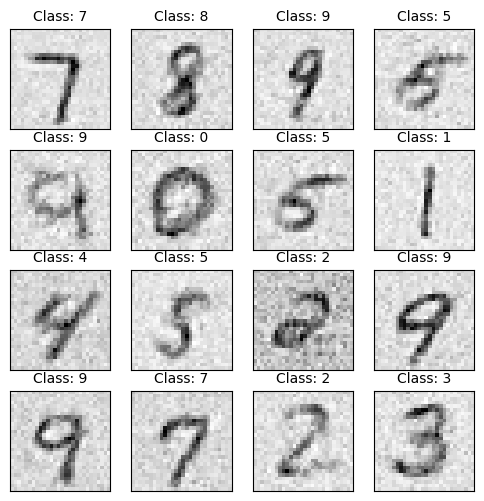

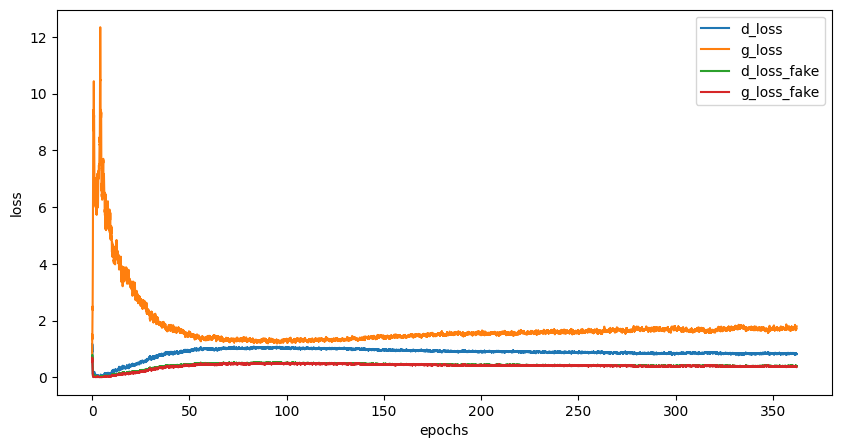

Epoch [363/500], Step[100/469], d_loss: 0.8096, d_loss_fake: 0.3429, g_loss: 1.9156, g_loss_fake: 0.3882, D(x): 0.73, D(G(z)): 0.24
Epoch [363/500], Step[200/469], d_loss: 0.7380, d_loss_fake: 0.3388, g_loss: 1.7968, g_loss_fake: 0.3621, D(x): 0.74, D(G(z)): 0.24
Epoch [363/500], Step[300/469], d_loss: 0.8571, d_loss_fake: 0.4382, g_loss: 1.7716, g_loss_fake: 0.3172, D(x): 0.73, D(G(z)): 0.29
Epoch [363/500], Step[400/469], d_loss: 0.7880, d_loss_fake: 0.4397, g_loss: 1.6994, g_loss_fake: 0.3785, D(x): 0.77, D(G(z)): 0.28


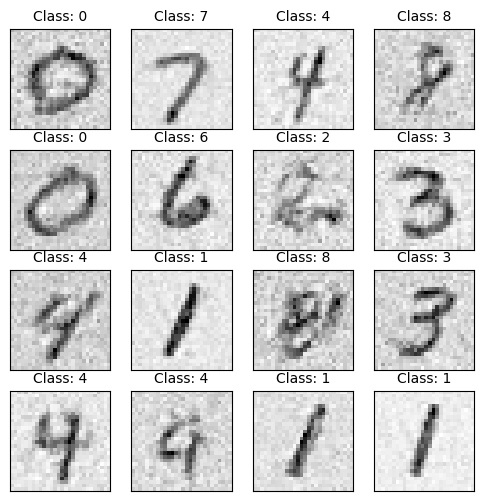

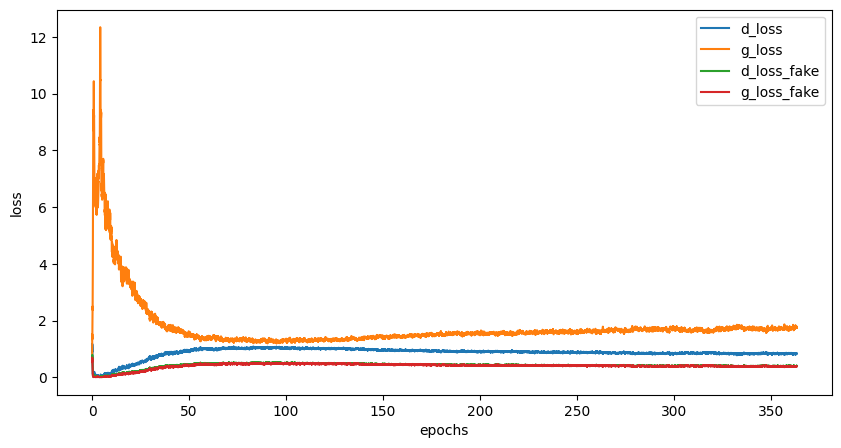

Epoch [364/500], Step[100/469], d_loss: 0.8486, d_loss_fake: 0.3542, g_loss: 1.5412, g_loss_fake: 0.4050, D(x): 0.71, D(G(z)): 0.25
Epoch [364/500], Step[200/469], d_loss: 0.8809, d_loss_fake: 0.3761, g_loss: 1.7841, g_loss_fake: 0.3277, D(x): 0.70, D(G(z)): 0.25
Epoch [364/500], Step[300/469], d_loss: 0.9136, d_loss_fake: 0.4969, g_loss: 1.7678, g_loss_fake: 0.3986, D(x): 0.75, D(G(z)): 0.30
Epoch [364/500], Step[400/469], d_loss: 0.8931, d_loss_fake: 0.4188, g_loss: 1.6187, g_loss_fake: 0.3736, D(x): 0.72, D(G(z)): 0.29


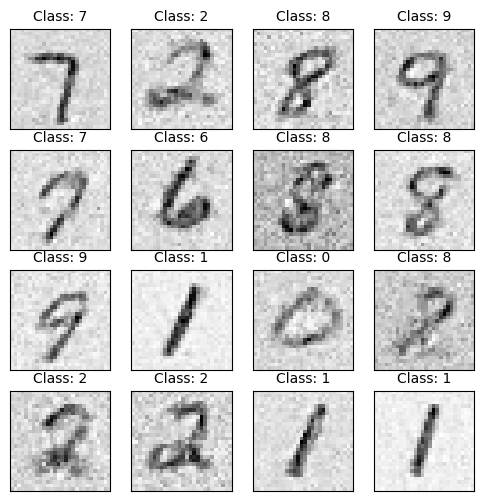

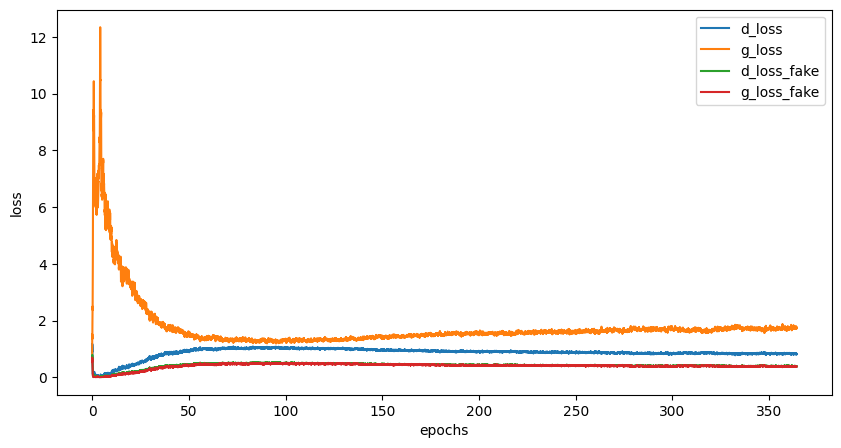

Epoch [365/500], Step[100/469], d_loss: 0.8072, d_loss_fake: 0.3763, g_loss: 1.5415, g_loss_fake: 0.4702, D(x): 0.73, D(G(z)): 0.27
Epoch [365/500], Step[200/469], d_loss: 0.7966, d_loss_fake: 0.4571, g_loss: 1.7514, g_loss_fake: 0.3756, D(x): 0.77, D(G(z)): 0.28
Epoch [365/500], Step[300/469], d_loss: 0.7986, d_loss_fake: 0.3902, g_loss: 1.6671, g_loss_fake: 0.3704, D(x): 0.74, D(G(z)): 0.26
Epoch [365/500], Step[400/469], d_loss: 0.7774, d_loss_fake: 0.3633, g_loss: 1.8544, g_loss_fake: 0.4318, D(x): 0.75, D(G(z)): 0.25


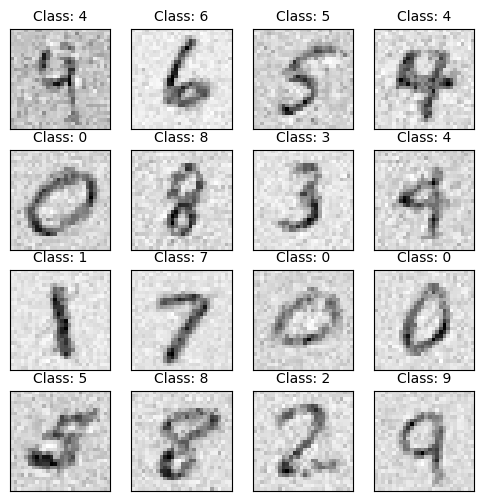

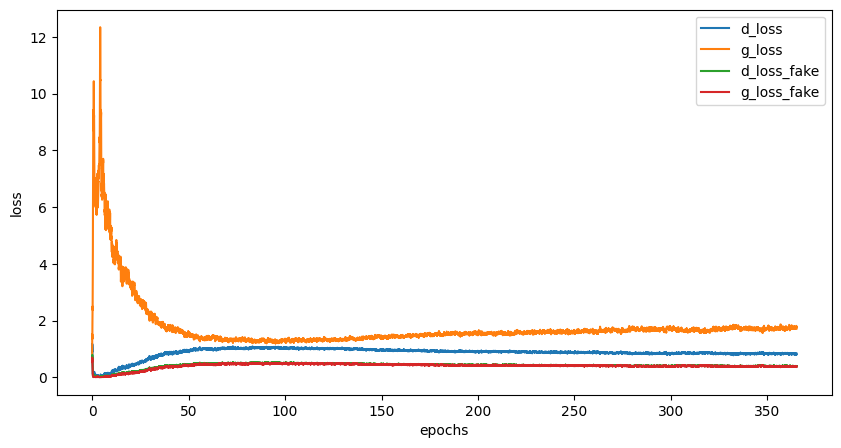

Epoch [366/500], Step[100/469], d_loss: 0.7897, d_loss_fake: 0.3889, g_loss: 1.6362, g_loss_fake: 0.4152, D(x): 0.73, D(G(z)): 0.27
Epoch [366/500], Step[200/469], d_loss: 0.7188, d_loss_fake: 0.2916, g_loss: 1.6952, g_loss_fake: 0.4417, D(x): 0.75, D(G(z)): 0.22
Epoch [366/500], Step[300/469], d_loss: 0.7530, d_loss_fake: 0.3589, g_loss: 1.7143, g_loss_fake: 0.3445, D(x): 0.75, D(G(z)): 0.25
Epoch [366/500], Step[400/469], d_loss: 0.8007, d_loss_fake: 0.4044, g_loss: 1.8057, g_loss_fake: 0.3629, D(x): 0.74, D(G(z)): 0.28


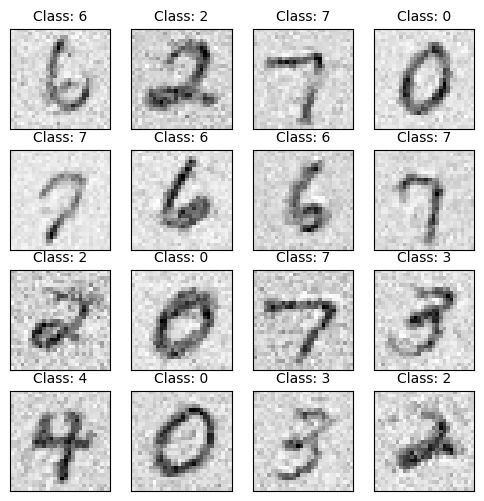

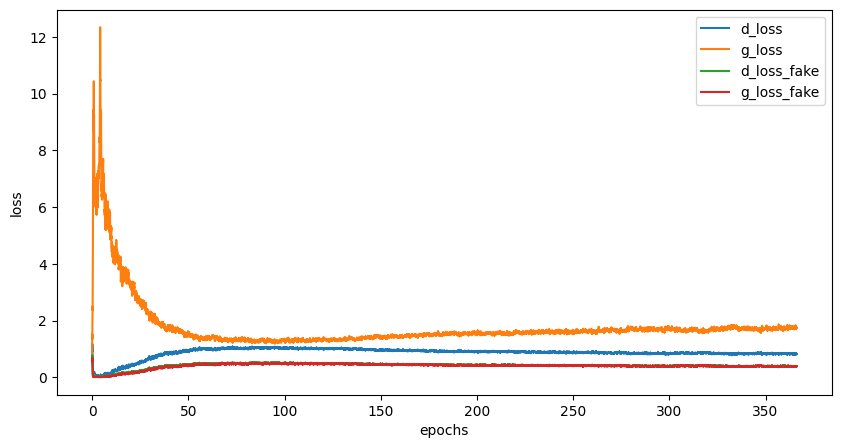

Epoch [367/500], Step[100/469], d_loss: 0.6379, d_loss_fake: 0.3120, g_loss: 1.7804, g_loss_fake: 0.4233, D(x): 0.80, D(G(z)): 0.23
Epoch [367/500], Step[200/469], d_loss: 0.7102, d_loss_fake: 0.3185, g_loss: 1.8549, g_loss_fake: 0.3542, D(x): 0.74, D(G(z)): 0.22
Epoch [367/500], Step[300/469], d_loss: 0.8689, d_loss_fake: 0.4575, g_loss: 1.8085, g_loss_fake: 0.3139, D(x): 0.73, D(G(z)): 0.29
Epoch [367/500], Step[400/469], d_loss: 0.8544, d_loss_fake: 0.3472, g_loss: 1.8166, g_loss_fake: 0.3187, D(x): 0.69, D(G(z)): 0.26


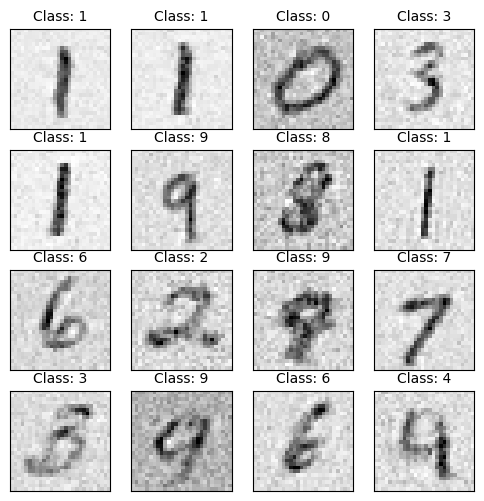

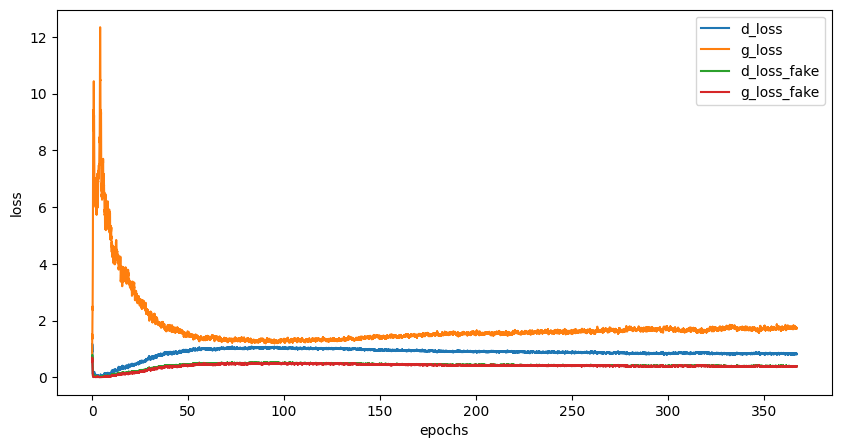

Epoch [368/500], Step[100/469], d_loss: 0.7152, d_loss_fake: 0.3319, g_loss: 1.6130, g_loss_fake: 0.4367, D(x): 0.76, D(G(z)): 0.24
Epoch [368/500], Step[200/469], d_loss: 0.7903, d_loss_fake: 0.3680, g_loss: 1.7271, g_loss_fake: 0.3578, D(x): 0.73, D(G(z)): 0.27
Epoch [368/500], Step[300/469], d_loss: 0.8158, d_loss_fake: 0.3908, g_loss: 1.6390, g_loss_fake: 0.4251, D(x): 0.73, D(G(z)): 0.26
Epoch [368/500], Step[400/469], d_loss: 0.8458, d_loss_fake: 0.3791, g_loss: 1.7021, g_loss_fake: 0.4078, D(x): 0.72, D(G(z)): 0.27


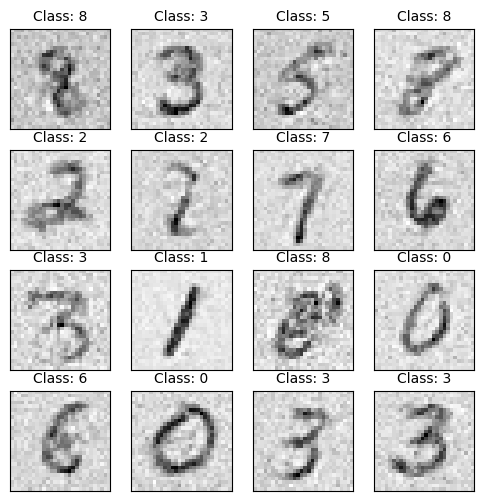

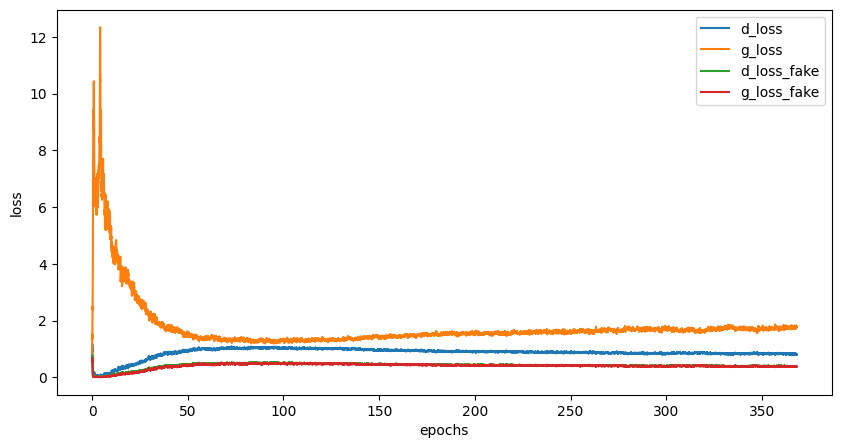

Epoch [369/500], Step[100/469], d_loss: 1.0015, d_loss_fake: 0.5404, g_loss: 1.8197, g_loss_fake: 0.3769, D(x): 0.73, D(G(z)): 0.30
Epoch [369/500], Step[200/469], d_loss: 0.8041, d_loss_fake: 0.3531, g_loss: 1.7894, g_loss_fake: 0.4256, D(x): 0.72, D(G(z)): 0.25
Epoch [369/500], Step[300/469], d_loss: 0.8038, d_loss_fake: 0.2149, g_loss: 2.0775, g_loss_fake: 0.3181, D(x): 0.68, D(G(z)): 0.17
Epoch [369/500], Step[400/469], d_loss: 0.9209, d_loss_fake: 0.5097, g_loss: 1.6046, g_loss_fake: 0.4489, D(x): 0.75, D(G(z)): 0.30


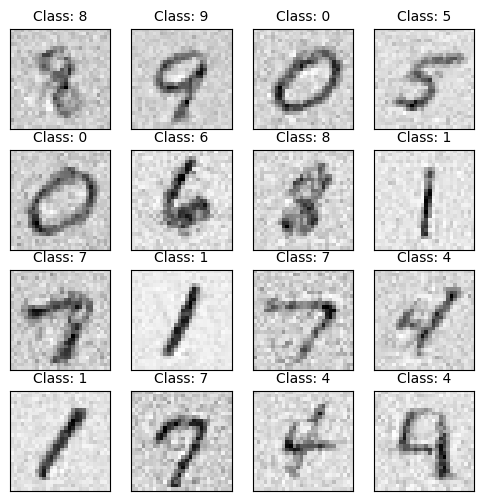

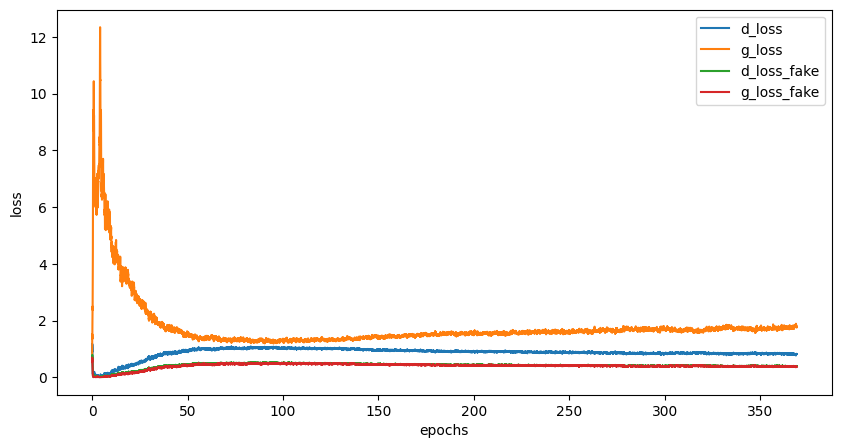

Epoch [370/500], Step[100/469], d_loss: 0.8458, d_loss_fake: 0.4666, g_loss: 1.5155, g_loss_fake: 0.4337, D(x): 0.75, D(G(z)): 0.30
Epoch [370/500], Step[200/469], d_loss: 0.8184, d_loss_fake: 0.3564, g_loss: 1.7323, g_loss_fake: 0.3696, D(x): 0.71, D(G(z)): 0.24
Epoch [370/500], Step[300/469], d_loss: 0.9155, d_loss_fake: 0.4387, g_loss: 1.7675, g_loss_fake: 0.3167, D(x): 0.71, D(G(z)): 0.28
Epoch [370/500], Step[400/469], d_loss: 0.7074, d_loss_fake: 0.3766, g_loss: 1.6998, g_loss_fake: 0.3518, D(x): 0.79, D(G(z)): 0.27


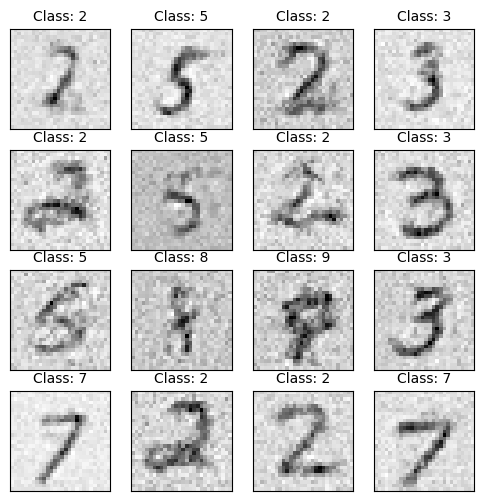

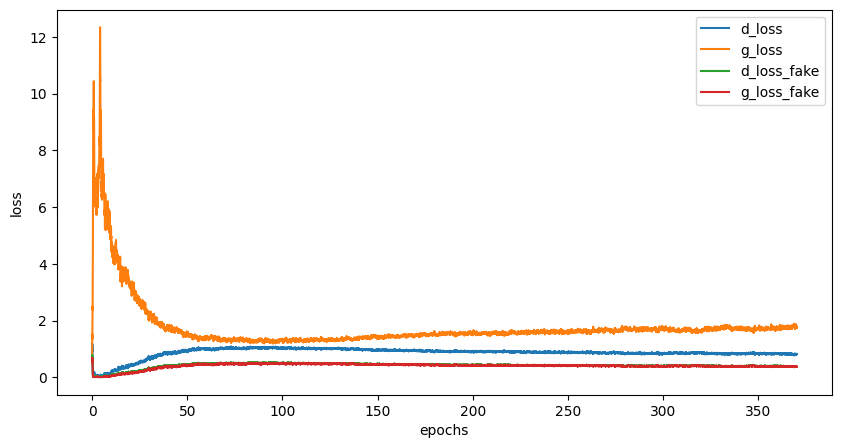

Epoch [371/500], Step[100/469], d_loss: 0.8405, d_loss_fake: 0.3714, g_loss: 1.7384, g_loss_fake: 0.3703, D(x): 0.72, D(G(z)): 0.27
Epoch [371/500], Step[200/469], d_loss: 0.8995, d_loss_fake: 0.4721, g_loss: 1.8028, g_loss_fake: 0.3969, D(x): 0.75, D(G(z)): 0.31
Epoch [371/500], Step[300/469], d_loss: 0.7179, d_loss_fake: 0.3765, g_loss: 1.7572, g_loss_fake: 0.3798, D(x): 0.78, D(G(z)): 0.26
Epoch [371/500], Step[400/469], d_loss: 0.8233, d_loss_fake: 0.4759, g_loss: 1.7515, g_loss_fake: 0.3324, D(x): 0.77, D(G(z)): 0.29


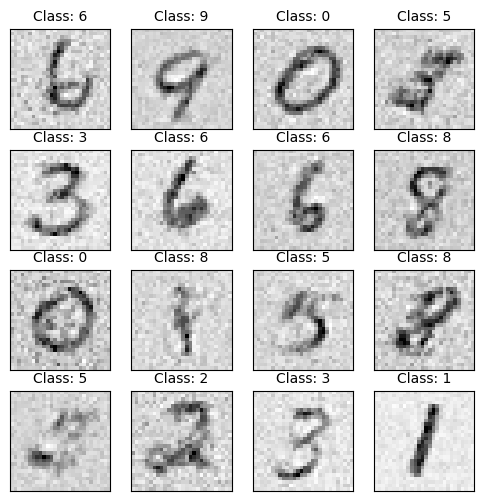

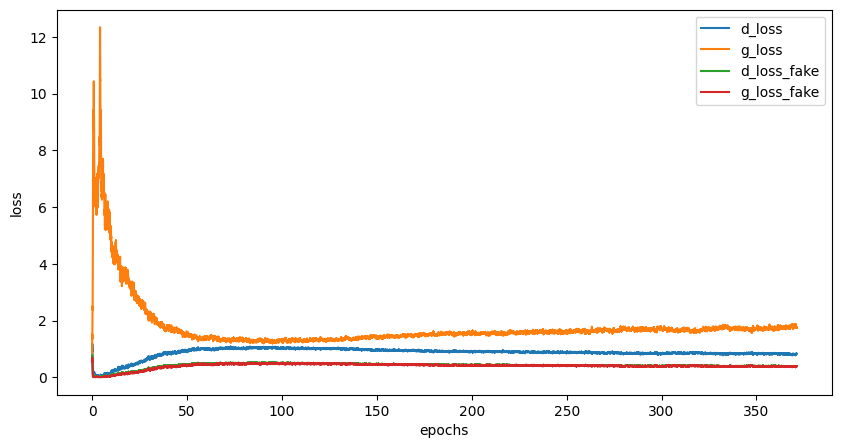

Epoch [372/500], Step[100/469], d_loss: 0.7786, d_loss_fake: 0.4310, g_loss: 1.7138, g_loss_fake: 0.3243, D(x): 0.78, D(G(z)): 0.29
Epoch [372/500], Step[200/469], d_loss: 0.8036, d_loss_fake: 0.4211, g_loss: 1.5531, g_loss_fake: 0.5046, D(x): 0.76, D(G(z)): 0.27
Epoch [372/500], Step[300/469], d_loss: 0.7672, d_loss_fake: 0.3703, g_loss: 1.5923, g_loss_fake: 0.4274, D(x): 0.75, D(G(z)): 0.24
Epoch [372/500], Step[400/469], d_loss: 0.7353, d_loss_fake: 0.3391, g_loss: 1.8410, g_loss_fake: 0.3360, D(x): 0.76, D(G(z)): 0.25


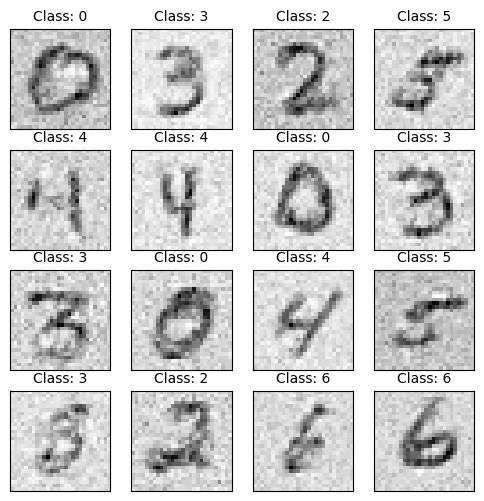

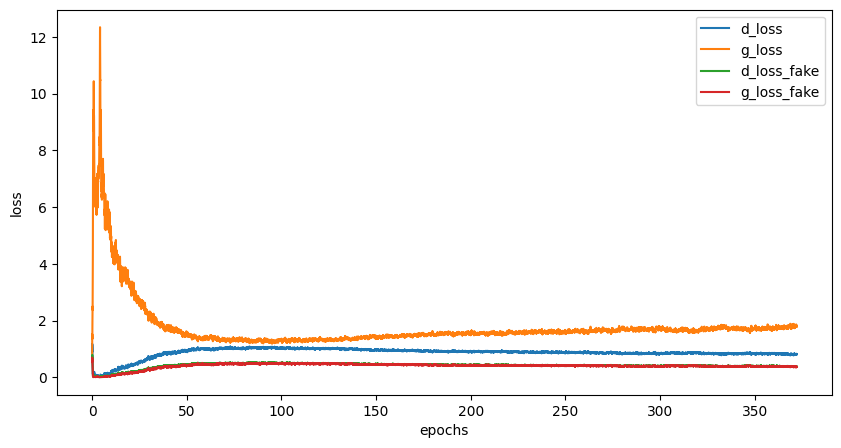

Epoch [373/500], Step[100/469], d_loss: 0.8358, d_loss_fake: 0.4172, g_loss: 1.6165, g_loss_fake: 0.4430, D(x): 0.76, D(G(z)): 0.28
Epoch [373/500], Step[200/469], d_loss: 0.6592, d_loss_fake: 0.3192, g_loss: 1.7650, g_loss_fake: 0.3845, D(x): 0.79, D(G(z)): 0.23
Epoch [373/500], Step[300/469], d_loss: 0.8198, d_loss_fake: 0.3517, g_loss: 1.7654, g_loss_fake: 0.3612, D(x): 0.73, D(G(z)): 0.24
Epoch [373/500], Step[400/469], d_loss: 0.9296, d_loss_fake: 0.4052, g_loss: 1.7428, g_loss_fake: 0.4056, D(x): 0.69, D(G(z)): 0.26


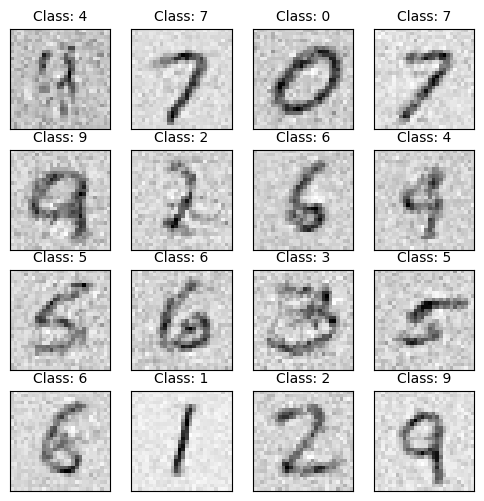

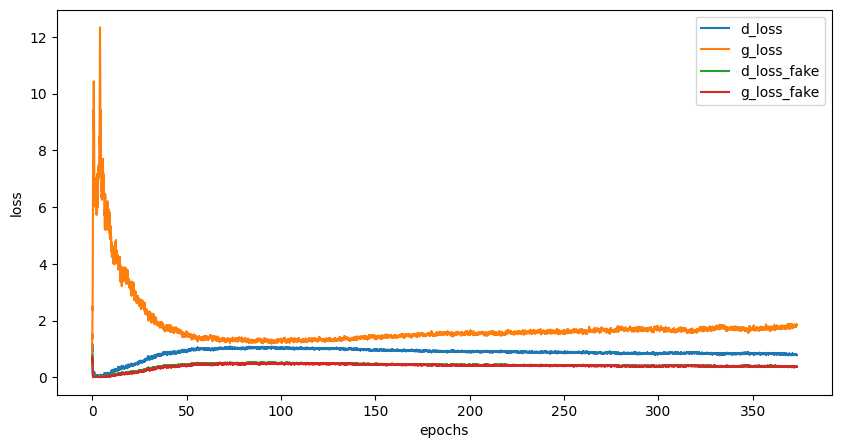

Epoch [374/500], Step[100/469], d_loss: 0.7374, d_loss_fake: 0.2823, g_loss: 2.0096, g_loss_fake: 0.3234, D(x): 0.73, D(G(z)): 0.21
Epoch [374/500], Step[200/469], d_loss: 0.6738, d_loss_fake: 0.3764, g_loss: 1.6724, g_loss_fake: 0.3271, D(x): 0.80, D(G(z)): 0.27
Epoch [374/500], Step[300/469], d_loss: 0.8086, d_loss_fake: 0.4151, g_loss: 1.8901, g_loss_fake: 0.4016, D(x): 0.75, D(G(z)): 0.28
Epoch [374/500], Step[400/469], d_loss: 0.8191, d_loss_fake: 0.3409, g_loss: 1.7851, g_loss_fake: 0.2975, D(x): 0.72, D(G(z)): 0.24


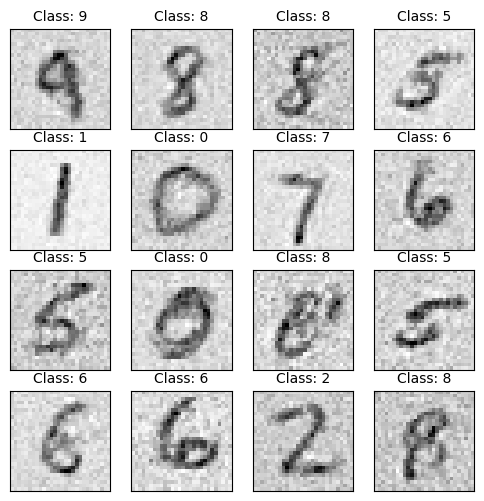

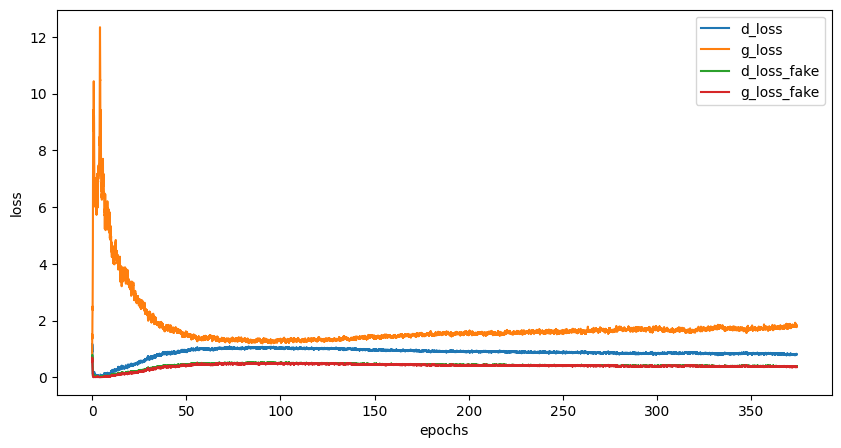

Epoch [375/500], Step[100/469], d_loss: 0.7918, d_loss_fake: 0.3457, g_loss: 1.9004, g_loss_fake: 0.3263, D(x): 0.73, D(G(z)): 0.25
Epoch [375/500], Step[200/469], d_loss: 0.8540, d_loss_fake: 0.4603, g_loss: 1.6529, g_loss_fake: 0.4183, D(x): 0.74, D(G(z)): 0.25
Epoch [375/500], Step[300/469], d_loss: 0.8106, d_loss_fake: 0.3274, g_loss: 1.8741, g_loss_fake: 0.3334, D(x): 0.71, D(G(z)): 0.24
Epoch [375/500], Step[400/469], d_loss: 0.8744, d_loss_fake: 0.3901, g_loss: 1.7205, g_loss_fake: 0.3729, D(x): 0.71, D(G(z)): 0.27


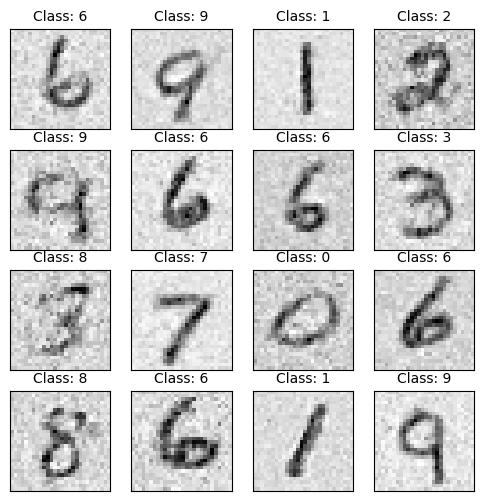

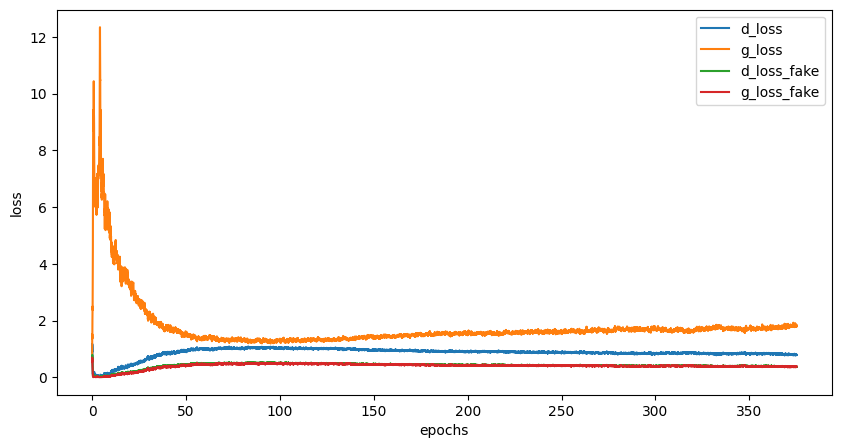

Epoch [376/500], Step[100/469], d_loss: 0.6895, d_loss_fake: 0.2923, g_loss: 1.9386, g_loss_fake: 0.3731, D(x): 0.75, D(G(z)): 0.21
Epoch [376/500], Step[200/469], d_loss: 0.7710, d_loss_fake: 0.3105, g_loss: 1.9908, g_loss_fake: 0.3304, D(x): 0.72, D(G(z)): 0.22
Epoch [376/500], Step[300/469], d_loss: 0.9231, d_loss_fake: 0.4549, g_loss: 1.7551, g_loss_fake: 0.4684, D(x): 0.72, D(G(z)): 0.27
Epoch [376/500], Step[400/469], d_loss: 0.7474, d_loss_fake: 0.3748, g_loss: 1.6173, g_loss_fake: 0.4542, D(x): 0.76, D(G(z)): 0.27


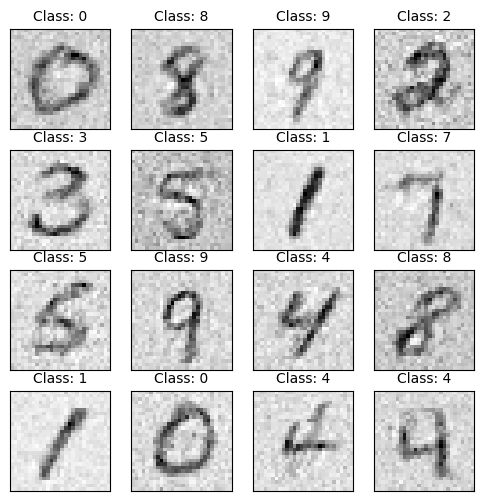

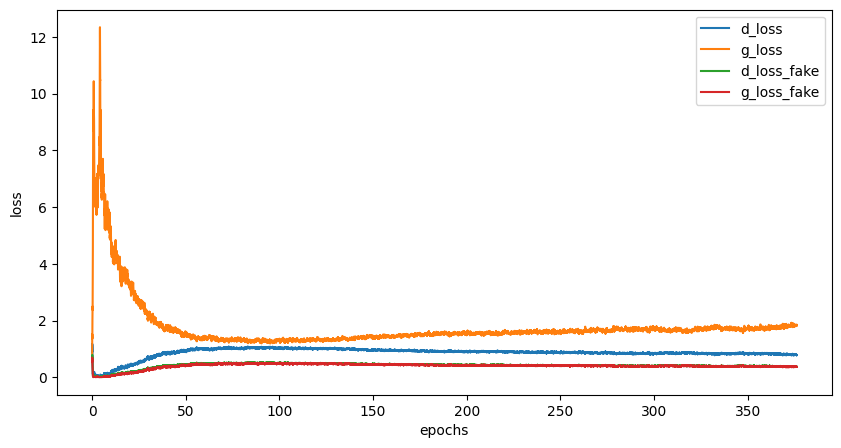

Epoch [377/500], Step[100/469], d_loss: 0.7622, d_loss_fake: 0.3965, g_loss: 1.5936, g_loss_fake: 0.4370, D(x): 0.77, D(G(z)): 0.27
Epoch [377/500], Step[200/469], d_loss: 0.6978, d_loss_fake: 0.3243, g_loss: 1.7270, g_loss_fake: 0.3892, D(x): 0.78, D(G(z)): 0.23
Epoch [377/500], Step[300/469], d_loss: 0.8030, d_loss_fake: 0.3683, g_loss: 1.8976, g_loss_fake: 0.3348, D(x): 0.74, D(G(z)): 0.25
Epoch [377/500], Step[400/469], d_loss: 0.8730, d_loss_fake: 0.3412, g_loss: 2.1050, g_loss_fake: 0.2752, D(x): 0.70, D(G(z)): 0.24


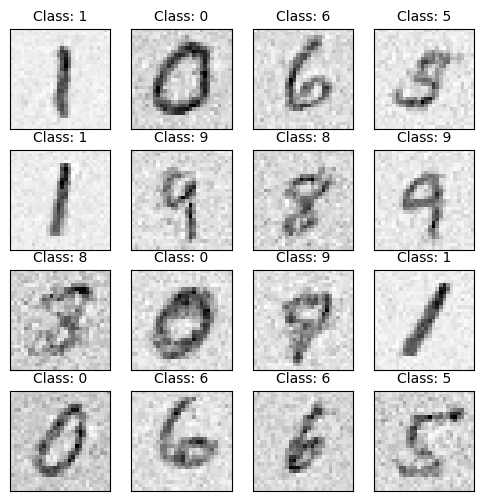

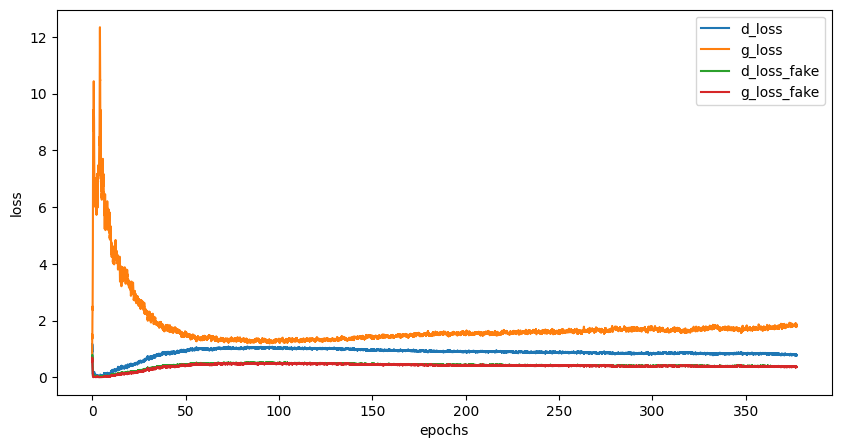

Epoch [378/500], Step[100/469], d_loss: 0.8457, d_loss_fake: 0.4289, g_loss: 2.1096, g_loss_fake: 0.2706, D(x): 0.73, D(G(z)): 0.28
Epoch [378/500], Step[200/469], d_loss: 0.7041, d_loss_fake: 0.3107, g_loss: 1.8210, g_loss_fake: 0.3384, D(x): 0.75, D(G(z)): 0.23
Epoch [378/500], Step[300/469], d_loss: 0.8476, d_loss_fake: 0.3929, g_loss: 1.8420, g_loss_fake: 0.3543, D(x): 0.73, D(G(z)): 0.25
Epoch [378/500], Step[400/469], d_loss: 0.7732, d_loss_fake: 0.3967, g_loss: 1.7484, g_loss_fake: 0.3707, D(x): 0.76, D(G(z)): 0.27


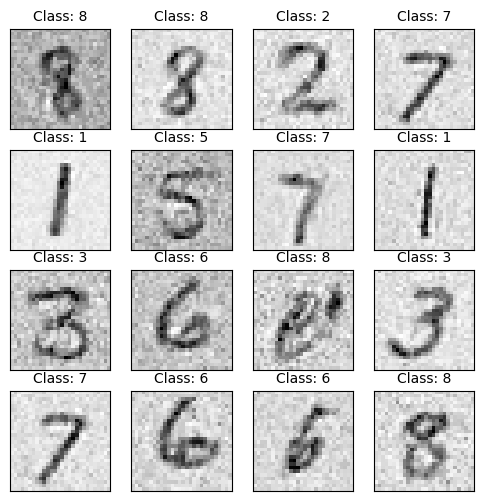

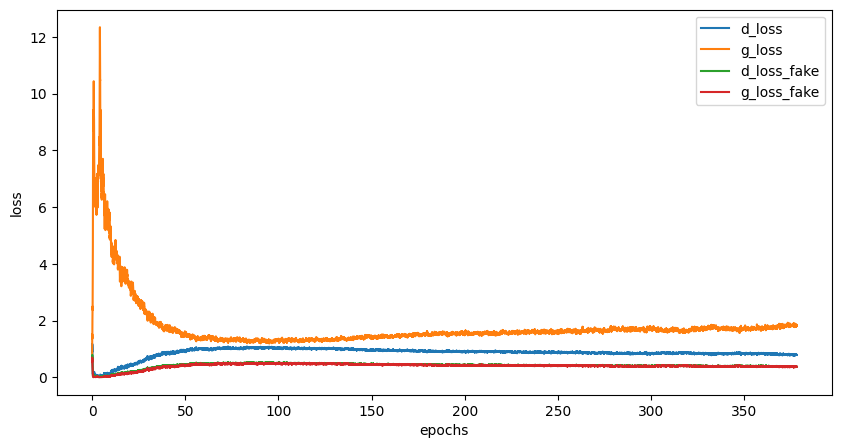

Epoch [379/500], Step[100/469], d_loss: 1.0217, d_loss_fake: 0.4252, g_loss: 1.8659, g_loss_fake: 0.3547, D(x): 0.68, D(G(z)): 0.28
Epoch [379/500], Step[200/469], d_loss: 0.7255, d_loss_fake: 0.3606, g_loss: 1.6085, g_loss_fake: 0.4825, D(x): 0.76, D(G(z)): 0.25
Epoch [379/500], Step[300/469], d_loss: 0.7478, d_loss_fake: 0.2327, g_loss: 2.0656, g_loss_fake: 0.3969, D(x): 0.72, D(G(z)): 0.18
Epoch [379/500], Step[400/469], d_loss: 0.6647, d_loss_fake: 0.2581, g_loss: 2.2510, g_loss_fake: 0.2970, D(x): 0.75, D(G(z)): 0.19


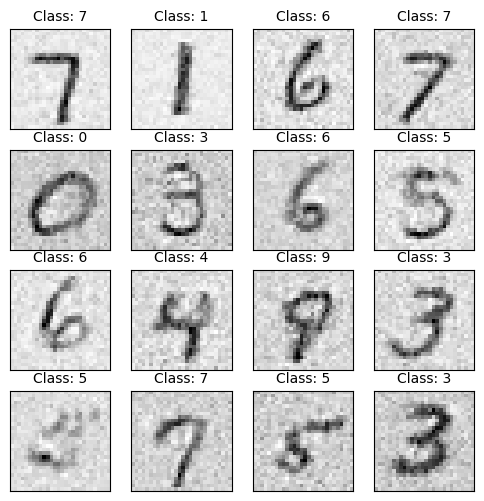

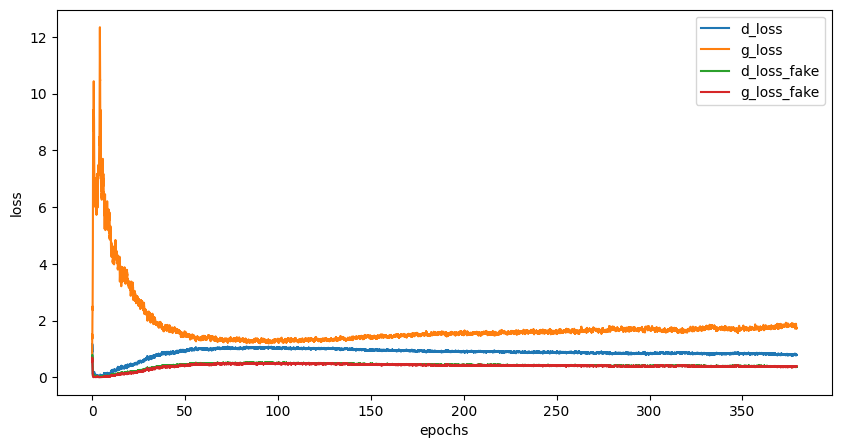

Epoch [380/500], Step[100/469], d_loss: 0.7398, d_loss_fake: 0.4027, g_loss: 1.7745, g_loss_fake: 0.3610, D(x): 0.77, D(G(z)): 0.26
Epoch [380/500], Step[200/469], d_loss: 0.9353, d_loss_fake: 0.4493, g_loss: 1.9194, g_loss_fake: 0.3569, D(x): 0.71, D(G(z)): 0.28
Epoch [380/500], Step[300/469], d_loss: 0.8250, d_loss_fake: 0.4206, g_loss: 1.6220, g_loss_fake: 0.4525, D(x): 0.75, D(G(z)): 0.29
Epoch [380/500], Step[400/469], d_loss: 0.7963, d_loss_fake: 0.3757, g_loss: 1.7387, g_loss_fake: 0.3498, D(x): 0.74, D(G(z)): 0.25


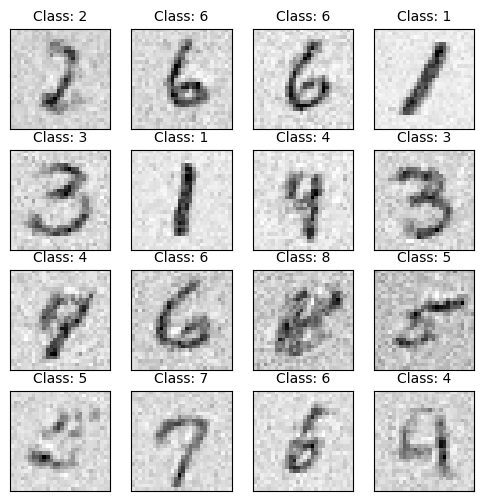

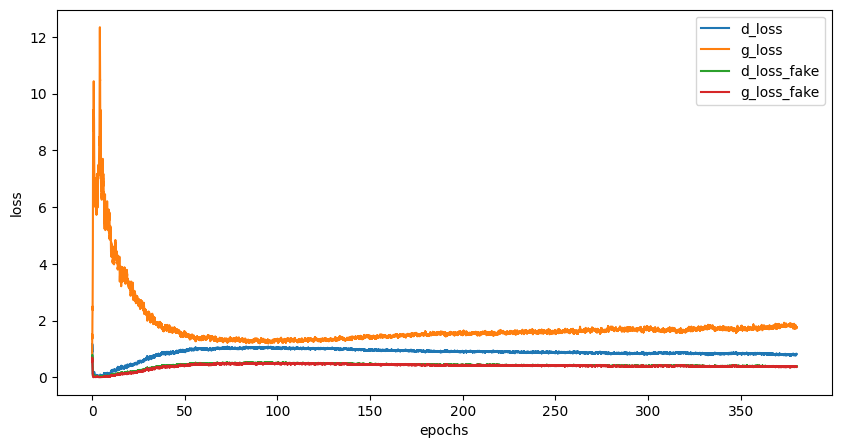

Epoch [381/500], Step[100/469], d_loss: 0.8136, d_loss_fake: 0.4066, g_loss: 1.6840, g_loss_fake: 0.3906, D(x): 0.76, D(G(z)): 0.26
Epoch [381/500], Step[200/469], d_loss: 0.7718, d_loss_fake: 0.3545, g_loss: 1.7004, g_loss_fake: 0.3465, D(x): 0.74, D(G(z)): 0.25
Epoch [381/500], Step[300/469], d_loss: 0.8177, d_loss_fake: 0.3766, g_loss: 1.7502, g_loss_fake: 0.3583, D(x): 0.73, D(G(z)): 0.26
Epoch [381/500], Step[400/469], d_loss: 0.8448, d_loss_fake: 0.4510, g_loss: 1.8353, g_loss_fake: 0.2871, D(x): 0.75, D(G(z)): 0.30


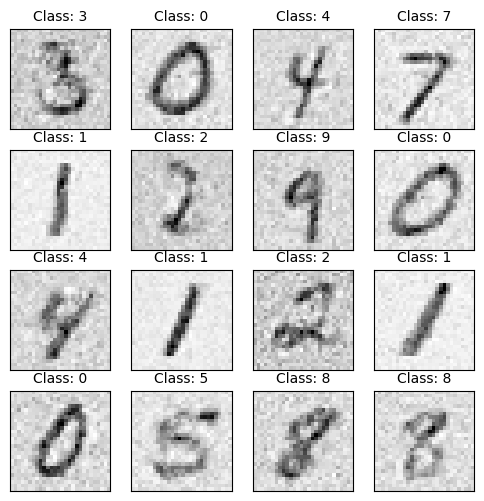

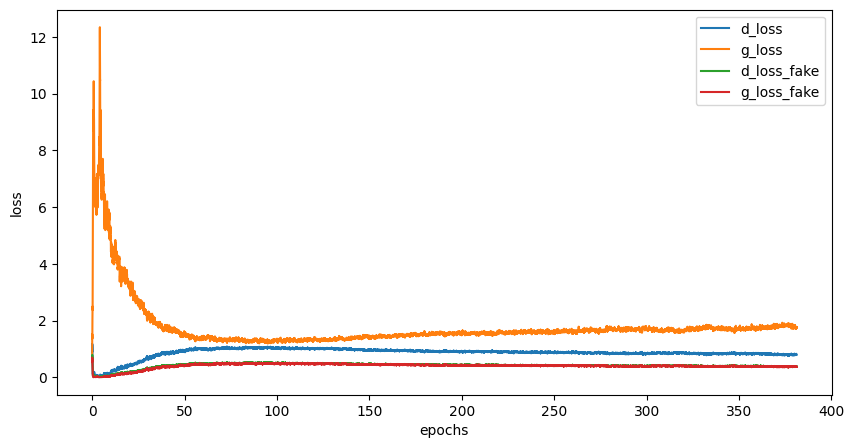

Epoch [382/500], Step[100/469], d_loss: 0.6973, d_loss_fake: 0.2520, g_loss: 1.7381, g_loss_fake: 0.3577, D(x): 0.74, D(G(z)): 0.20
Epoch [382/500], Step[200/469], d_loss: 0.7936, d_loss_fake: 0.3261, g_loss: 1.9138, g_loss_fake: 0.3191, D(x): 0.71, D(G(z)): 0.23
Epoch [382/500], Step[300/469], d_loss: 0.7507, d_loss_fake: 0.3660, g_loss: 1.8504, g_loss_fake: 0.3314, D(x): 0.77, D(G(z)): 0.26
Epoch [382/500], Step[400/469], d_loss: 0.8943, d_loss_fake: 0.3913, g_loss: 2.1368, g_loss_fake: 0.2525, D(x): 0.71, D(G(z)): 0.27


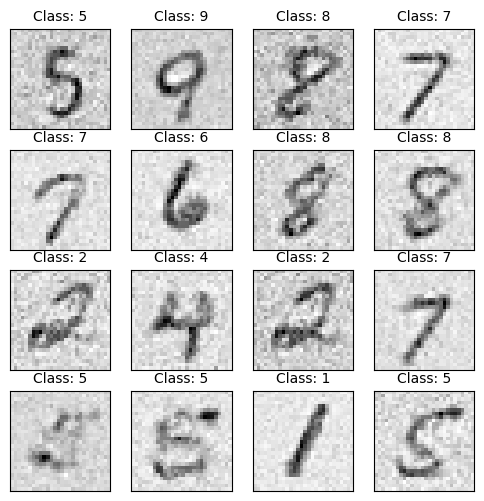

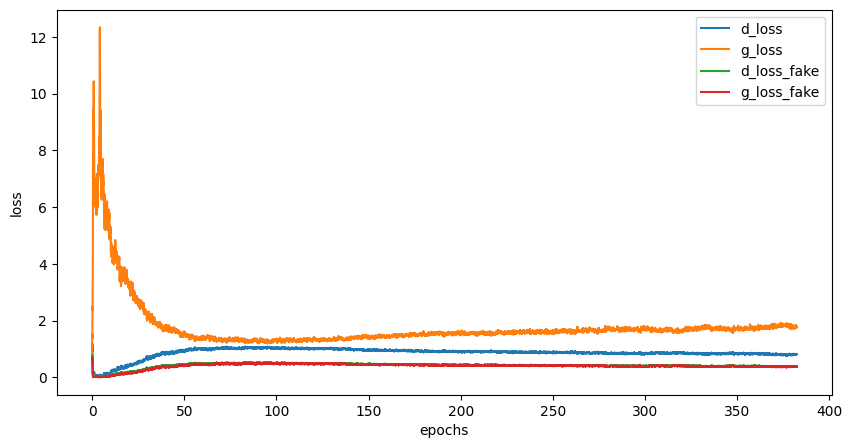

Epoch [383/500], Step[100/469], d_loss: 0.8727, d_loss_fake: 0.3519, g_loss: 1.8641, g_loss_fake: 0.3433, D(x): 0.69, D(G(z)): 0.24
Epoch [383/500], Step[200/469], d_loss: 0.8540, d_loss_fake: 0.4536, g_loss: 1.8074, g_loss_fake: 0.3703, D(x): 0.75, D(G(z)): 0.26
Epoch [383/500], Step[300/469], d_loss: 0.8869, d_loss_fake: 0.4305, g_loss: 1.8620, g_loss_fake: 0.4257, D(x): 0.72, D(G(z)): 0.30
Epoch [383/500], Step[400/469], d_loss: 0.9030, d_loss_fake: 0.4049, g_loss: 1.7374, g_loss_fake: 0.3297, D(x): 0.71, D(G(z)): 0.29


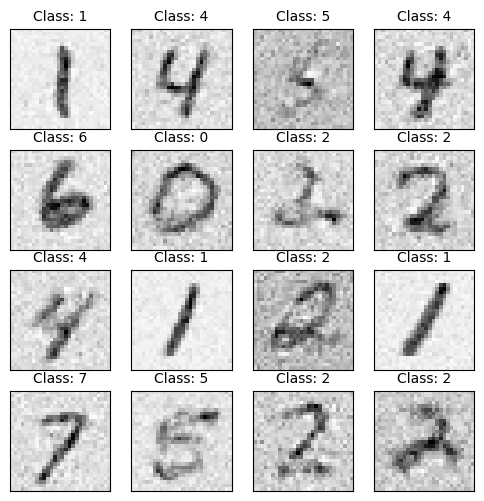

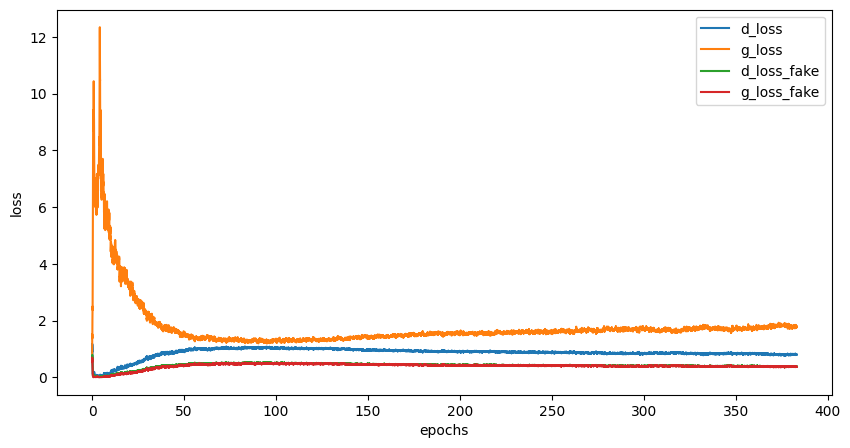

Epoch [384/500], Step[100/469], d_loss: 0.6913, d_loss_fake: 0.3363, g_loss: 1.7810, g_loss_fake: 0.3819, D(x): 0.78, D(G(z)): 0.24
Epoch [384/500], Step[200/469], d_loss: 0.8342, d_loss_fake: 0.4201, g_loss: 1.6105, g_loss_fake: 0.4439, D(x): 0.73, D(G(z)): 0.28
Epoch [384/500], Step[300/469], d_loss: 0.9741, d_loss_fake: 0.4425, g_loss: 1.6965, g_loss_fake: 0.4176, D(x): 0.69, D(G(z)): 0.29
Epoch [384/500], Step[400/469], d_loss: 0.7816, d_loss_fake: 0.3566, g_loss: 1.7869, g_loss_fake: 0.2781, D(x): 0.73, D(G(z)): 0.26


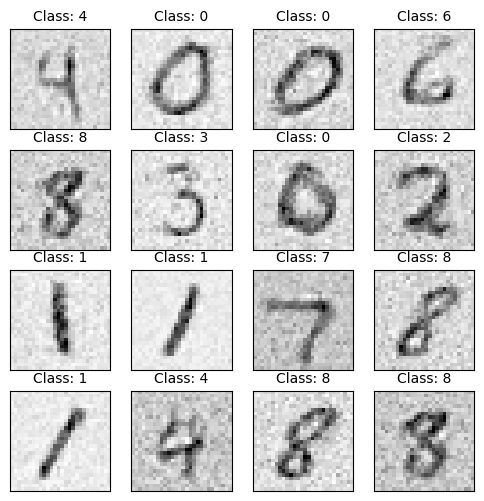

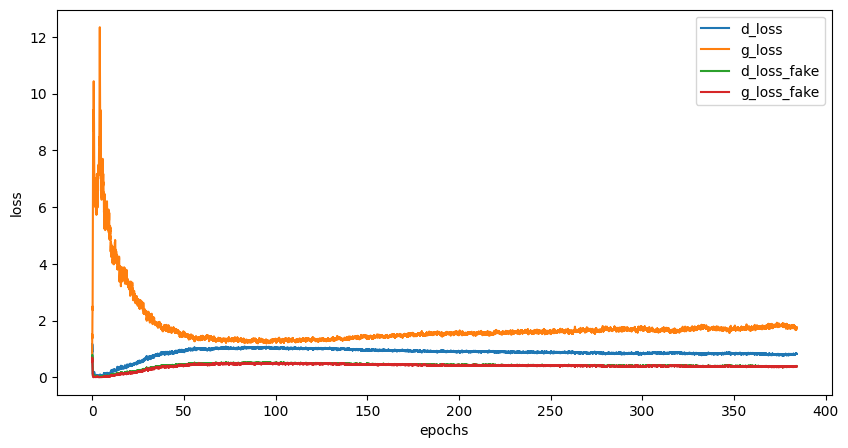

Epoch [385/500], Step[100/469], d_loss: 0.7100, d_loss_fake: 0.3869, g_loss: 1.6857, g_loss_fake: 0.4002, D(x): 0.78, D(G(z)): 0.27
Epoch [385/500], Step[200/469], d_loss: 0.7769, d_loss_fake: 0.4251, g_loss: 1.7269, g_loss_fake: 0.3329, D(x): 0.77, D(G(z)): 0.29
Epoch [385/500], Step[300/469], d_loss: 0.7914, d_loss_fake: 0.4260, g_loss: 1.5700, g_loss_fake: 0.3839, D(x): 0.77, D(G(z)): 0.28
Epoch [385/500], Step[400/469], d_loss: 0.8631, d_loss_fake: 0.3593, g_loss: 2.0276, g_loss_fake: 0.2364, D(x): 0.71, D(G(z)): 0.24


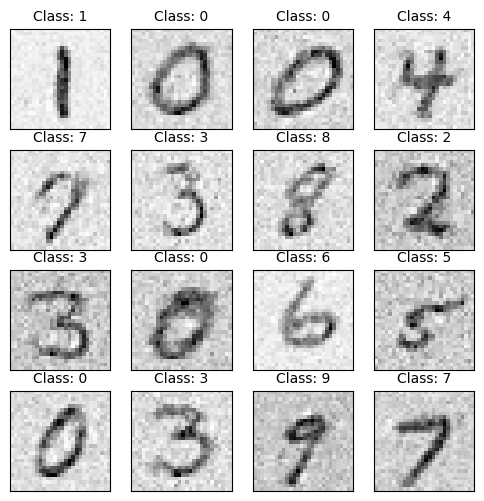

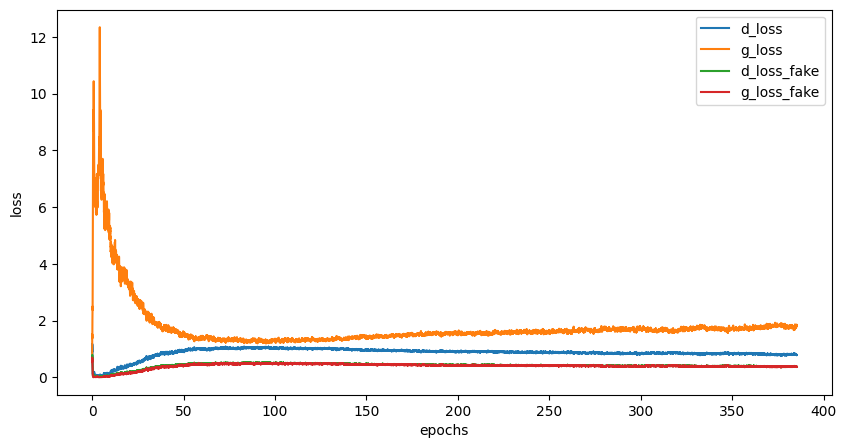

Epoch [386/500], Step[100/469], d_loss: 0.7564, d_loss_fake: 0.3479, g_loss: 1.7803, g_loss_fake: 0.3553, D(x): 0.74, D(G(z)): 0.26
Epoch [386/500], Step[200/469], d_loss: 0.8321, d_loss_fake: 0.3870, g_loss: 1.7845, g_loss_fake: 0.2918, D(x): 0.72, D(G(z)): 0.26
Epoch [386/500], Step[300/469], d_loss: 0.7667, d_loss_fake: 0.3983, g_loss: 1.6621, g_loss_fake: 0.3779, D(x): 0.77, D(G(z)): 0.28
Epoch [386/500], Step[400/469], d_loss: 0.7939, d_loss_fake: 0.3946, g_loss: 1.8107, g_loss_fake: 0.3772, D(x): 0.75, D(G(z)): 0.28


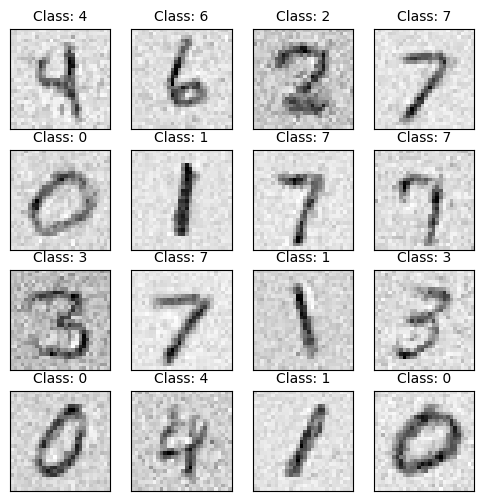

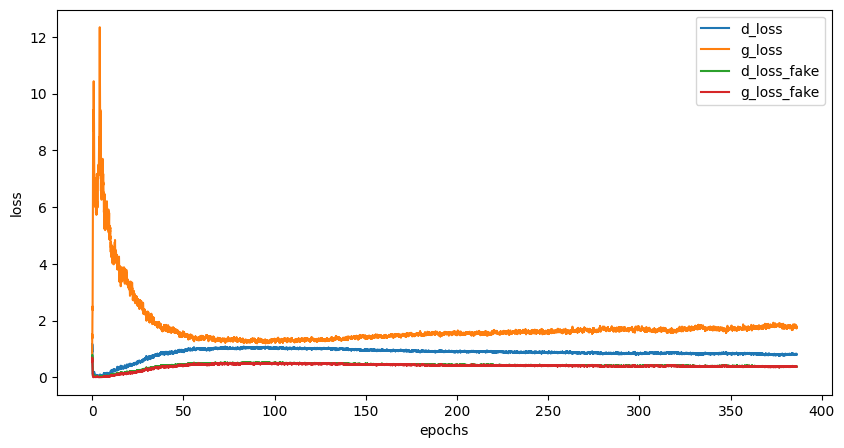

Epoch [387/500], Step[100/469], d_loss: 0.7843, d_loss_fake: 0.3631, g_loss: 1.8369, g_loss_fake: 0.2981, D(x): 0.74, D(G(z)): 0.26
Epoch [387/500], Step[200/469], d_loss: 0.9484, d_loss_fake: 0.4139, g_loss: 1.9146, g_loss_fake: 0.2859, D(x): 0.68, D(G(z)): 0.28
Epoch [387/500], Step[300/469], d_loss: 0.9534, d_loss_fake: 0.3802, g_loss: 1.6748, g_loss_fake: 0.3568, D(x): 0.66, D(G(z)): 0.27
Epoch [387/500], Step[400/469], d_loss: 0.8926, d_loss_fake: 0.3434, g_loss: 1.9726, g_loss_fake: 0.3316, D(x): 0.67, D(G(z)): 0.25


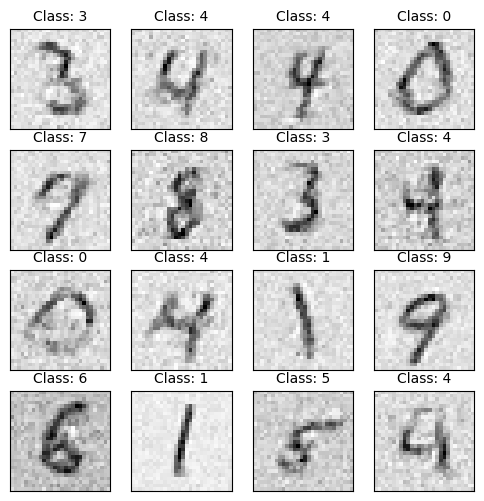

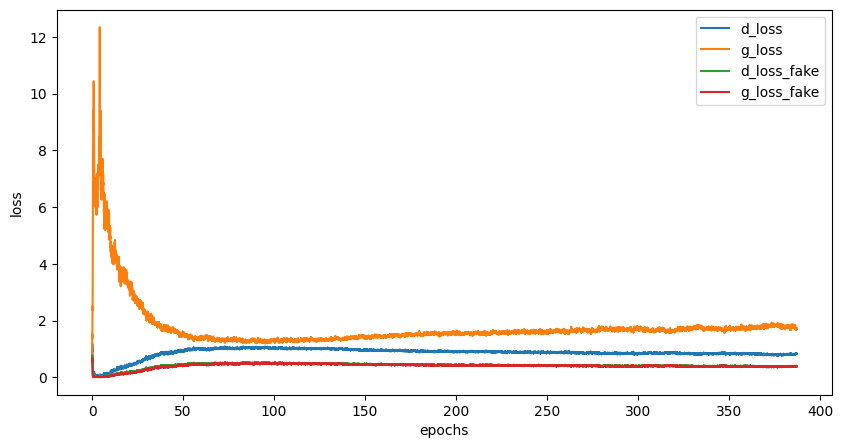

Epoch [388/500], Step[100/469], d_loss: 0.7742, d_loss_fake: 0.3859, g_loss: 1.7409, g_loss_fake: 0.3659, D(x): 0.76, D(G(z)): 0.26
Epoch [388/500], Step[200/469], d_loss: 0.7398, d_loss_fake: 0.3372, g_loss: 1.7371, g_loss_fake: 0.3783, D(x): 0.75, D(G(z)): 0.25
Epoch [388/500], Step[300/469], d_loss: 0.8258, d_loss_fake: 0.4353, g_loss: 1.7805, g_loss_fake: 0.3461, D(x): 0.76, D(G(z)): 0.29
Epoch [388/500], Step[400/469], d_loss: 0.9385, d_loss_fake: 0.4481, g_loss: 1.4135, g_loss_fake: 0.5085, D(x): 0.70, D(G(z)): 0.31


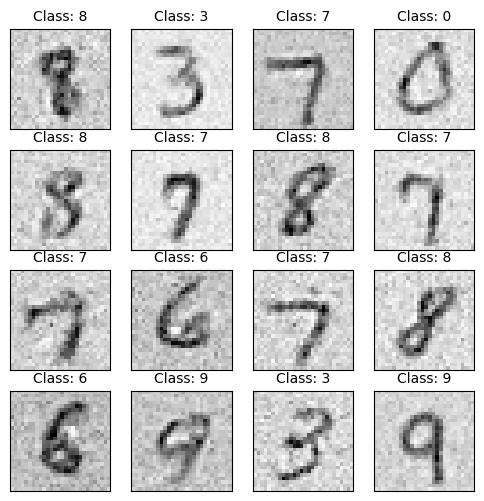

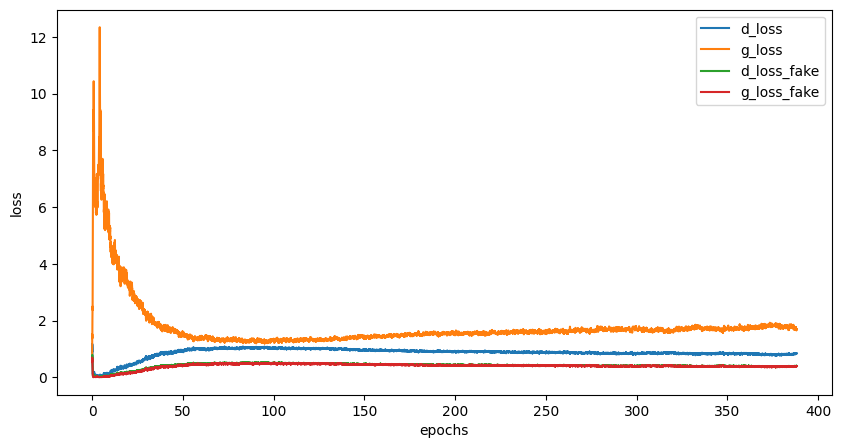

Epoch [389/500], Step[100/469], d_loss: 0.8579, d_loss_fake: 0.3816, g_loss: 1.7245, g_loss_fake: 0.3776, D(x): 0.72, D(G(z)): 0.27
Epoch [389/500], Step[200/469], d_loss: 0.7863, d_loss_fake: 0.4079, g_loss: 1.9588, g_loss_fake: 0.2900, D(x): 0.77, D(G(z)): 0.27
Epoch [389/500], Step[300/469], d_loss: 0.9138, d_loss_fake: 0.4240, g_loss: 1.6074, g_loss_fake: 0.4047, D(x): 0.70, D(G(z)): 0.29
Epoch [389/500], Step[400/469], d_loss: 0.9181, d_loss_fake: 0.4182, g_loss: 1.9411, g_loss_fake: 0.3422, D(x): 0.69, D(G(z)): 0.27


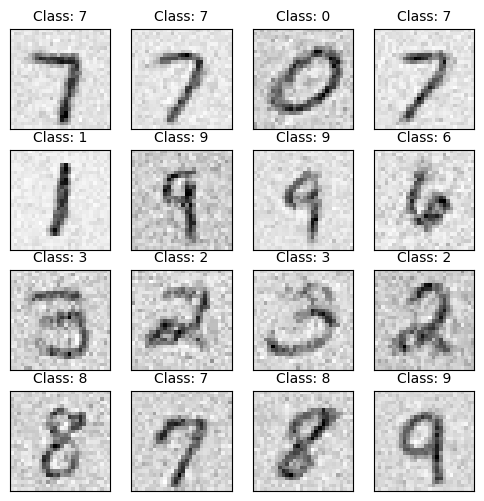

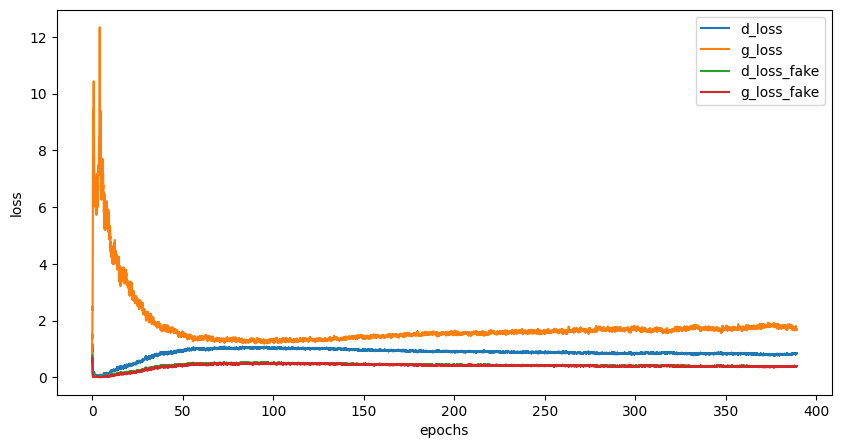

Epoch [390/500], Step[100/469], d_loss: 0.7891, d_loss_fake: 0.3479, g_loss: 1.8459, g_loss_fake: 0.4079, D(x): 0.71, D(G(z)): 0.25
Epoch [390/500], Step[200/469], d_loss: 0.9763, d_loss_fake: 0.3623, g_loss: 2.0284, g_loss_fake: 0.3041, D(x): 0.67, D(G(z)): 0.22
Epoch [390/500], Step[300/469], d_loss: 0.8229, d_loss_fake: 0.4495, g_loss: 1.7421, g_loss_fake: 0.3557, D(x): 0.75, D(G(z)): 0.27
Epoch [390/500], Step[400/469], d_loss: 0.8247, d_loss_fake: 0.3972, g_loss: 1.6602, g_loss_fake: 0.4099, D(x): 0.74, D(G(z)): 0.27


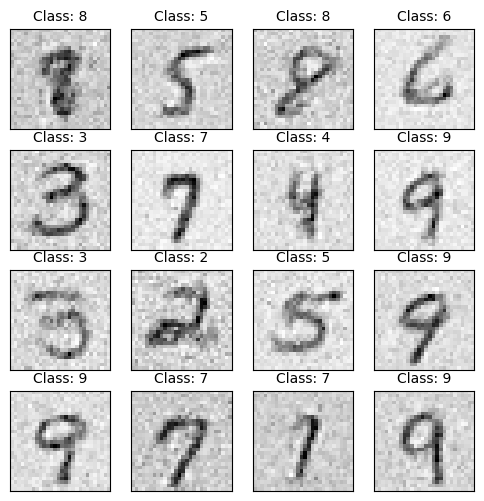

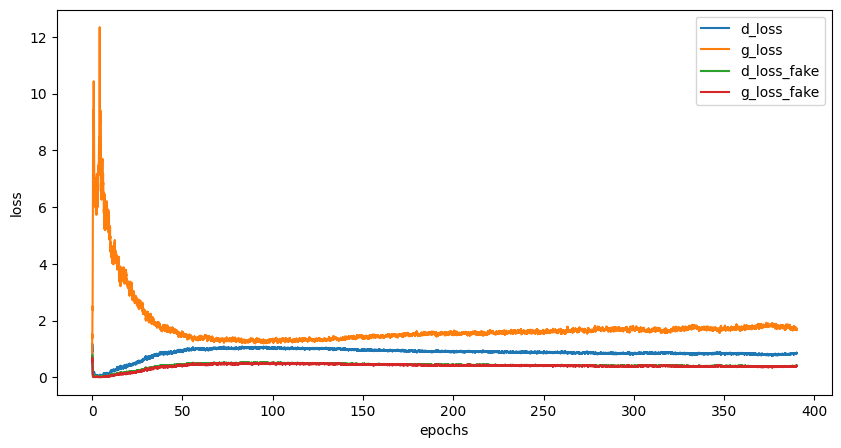

Epoch [391/500], Step[100/469], d_loss: 0.7694, d_loss_fake: 0.3848, g_loss: 1.6250, g_loss_fake: 0.3828, D(x): 0.75, D(G(z)): 0.26
Epoch [391/500], Step[200/469], d_loss: 0.8132, d_loss_fake: 0.4128, g_loss: 1.5847, g_loss_fake: 0.3748, D(x): 0.74, D(G(z)): 0.28
Epoch [391/500], Step[300/469], d_loss: 0.8274, d_loss_fake: 0.3846, g_loss: 1.7641, g_loss_fake: 0.3222, D(x): 0.71, D(G(z)): 0.27
Epoch [391/500], Step[400/469], d_loss: 0.8394, d_loss_fake: 0.3890, g_loss: 1.6205, g_loss_fake: 0.3970, D(x): 0.71, D(G(z)): 0.27


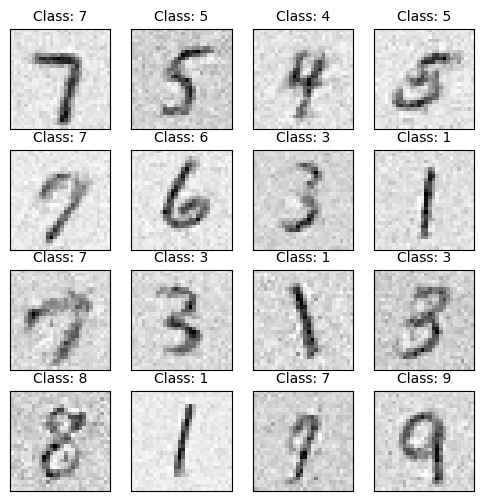

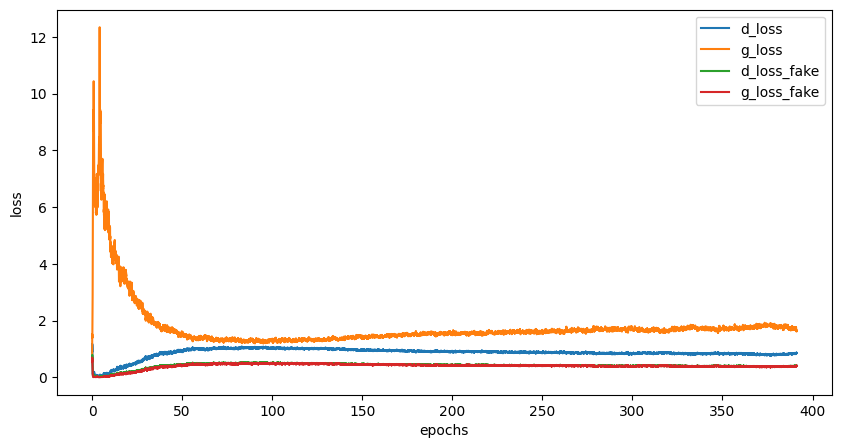

Epoch [392/500], Step[100/469], d_loss: 0.9280, d_loss_fake: 0.3990, g_loss: 1.5988, g_loss_fake: 0.4650, D(x): 0.68, D(G(z)): 0.27
Epoch [392/500], Step[200/469], d_loss: 0.8559, d_loss_fake: 0.4193, g_loss: 1.6952, g_loss_fake: 0.3717, D(x): 0.74, D(G(z)): 0.29
Epoch [392/500], Step[300/469], d_loss: 0.7868, d_loss_fake: 0.3357, g_loss: 1.8217, g_loss_fake: 0.3655, D(x): 0.72, D(G(z)): 0.23
Epoch [392/500], Step[400/469], d_loss: 0.7847, d_loss_fake: 0.3999, g_loss: 1.6066, g_loss_fake: 0.4230, D(x): 0.76, D(G(z)): 0.28


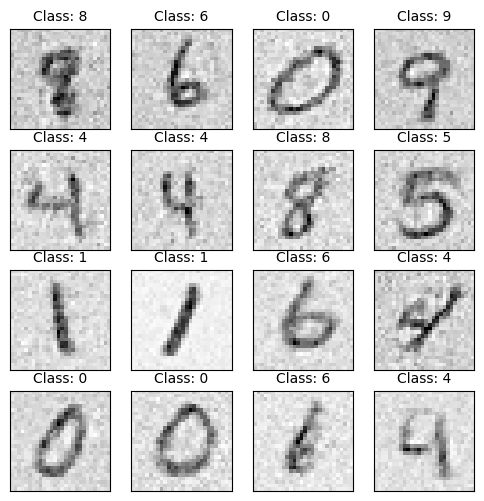

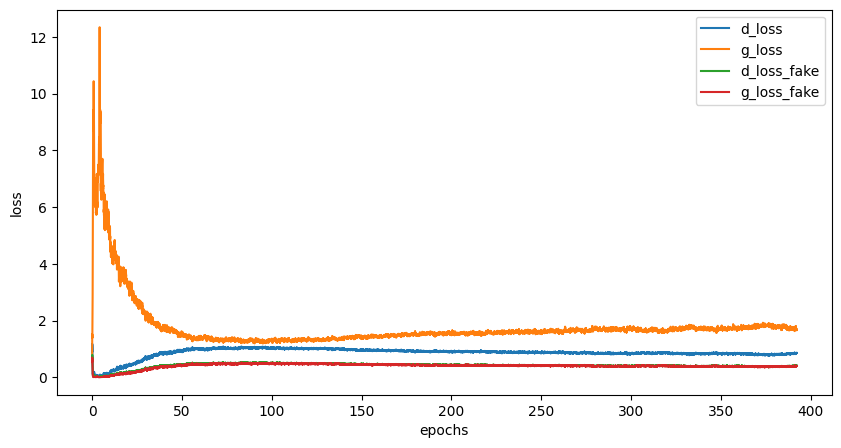

Epoch [393/500], Step[100/469], d_loss: 0.8413, d_loss_fake: 0.4012, g_loss: 1.8353, g_loss_fake: 0.3497, D(x): 0.72, D(G(z)): 0.27
Epoch [393/500], Step[200/469], d_loss: 0.8304, d_loss_fake: 0.3776, g_loss: 1.8934, g_loss_fake: 0.3349, D(x): 0.73, D(G(z)): 0.24
Epoch [393/500], Step[300/469], d_loss: 0.8118, d_loss_fake: 0.3072, g_loss: 1.9609, g_loss_fake: 0.3038, D(x): 0.69, D(G(z)): 0.23
Epoch [393/500], Step[400/469], d_loss: 0.7461, d_loss_fake: 0.3769, g_loss: 1.7698, g_loss_fake: 0.3720, D(x): 0.75, D(G(z)): 0.27


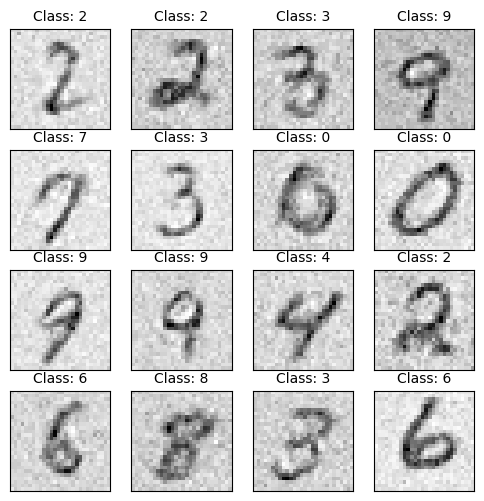

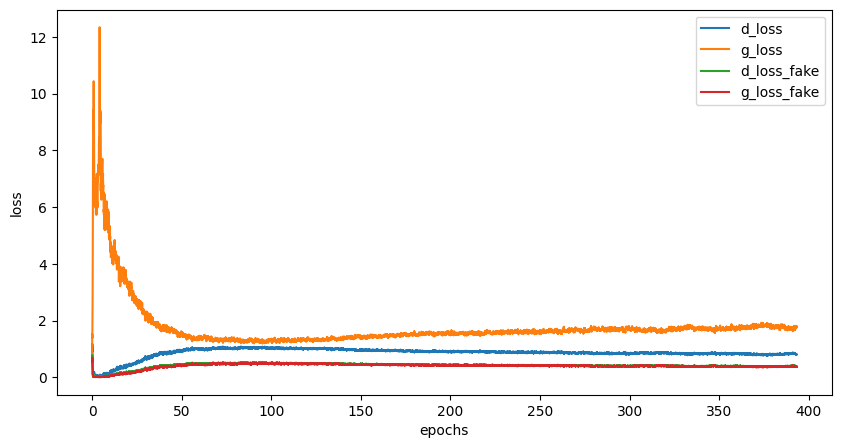

Epoch [394/500], Step[100/469], d_loss: 0.8915, d_loss_fake: 0.3591, g_loss: 1.8114, g_loss_fake: 0.2940, D(x): 0.67, D(G(z)): 0.25
Epoch [394/500], Step[200/469], d_loss: 0.8588, d_loss_fake: 0.4730, g_loss: 1.4697, g_loss_fake: 0.4775, D(x): 0.76, D(G(z)): 0.32
Epoch [394/500], Step[300/469], d_loss: 0.7911, d_loss_fake: 0.3802, g_loss: 2.0580, g_loss_fake: 0.2765, D(x): 0.75, D(G(z)): 0.25
Epoch [394/500], Step[400/469], d_loss: 0.8443, d_loss_fake: 0.2673, g_loss: 2.0407, g_loss_fake: 0.2379, D(x): 0.68, D(G(z)): 0.21


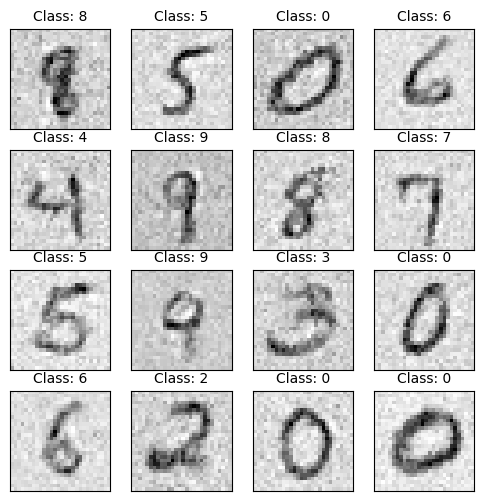

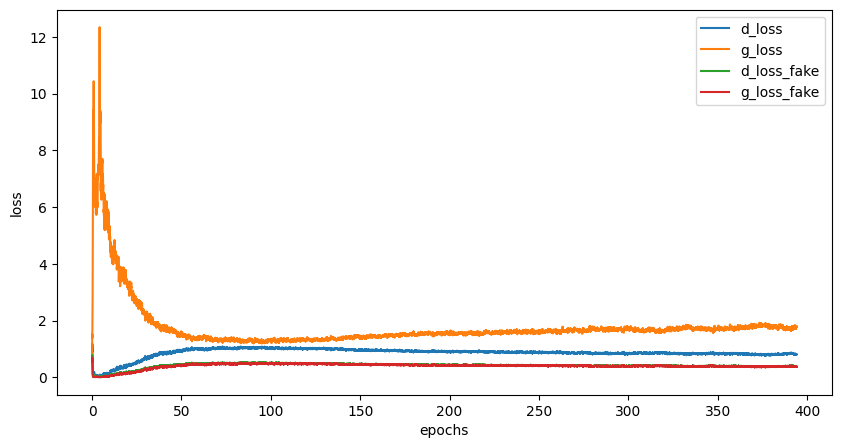

Epoch [395/500], Step[100/469], d_loss: 0.7698, d_loss_fake: 0.3477, g_loss: 1.7635, g_loss_fake: 0.2959, D(x): 0.73, D(G(z)): 0.25
Epoch [395/500], Step[200/469], d_loss: 0.7490, d_loss_fake: 0.3307, g_loss: 1.8163, g_loss_fake: 0.3208, D(x): 0.74, D(G(z)): 0.24
Epoch [395/500], Step[300/469], d_loss: 0.7454, d_loss_fake: 0.2455, g_loss: 1.9680, g_loss_fake: 0.3270, D(x): 0.71, D(G(z)): 0.19
Epoch [395/500], Step[400/469], d_loss: 0.7974, d_loss_fake: 0.3373, g_loss: 2.0629, g_loss_fake: 0.3413, D(x): 0.73, D(G(z)): 0.25


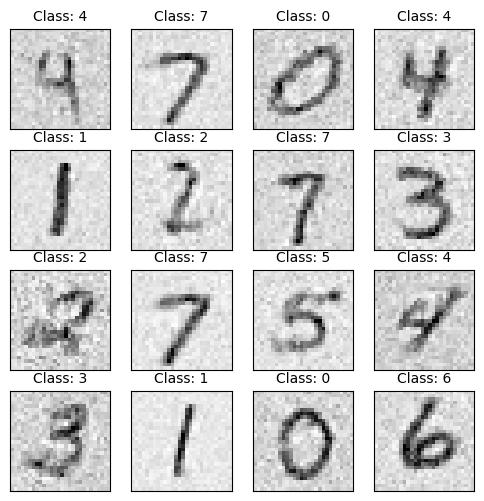

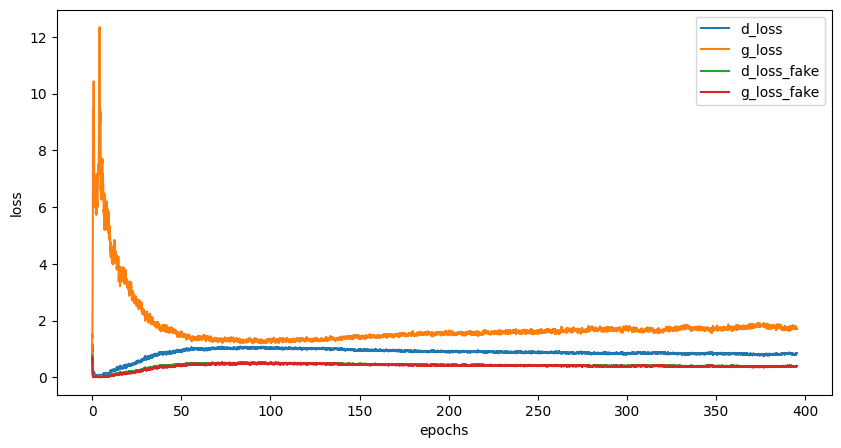

Epoch [396/500], Step[100/469], d_loss: 0.6501, d_loss_fake: 0.3776, g_loss: 1.9801, g_loss_fake: 0.3470, D(x): 0.82, D(G(z)): 0.25
Epoch [396/500], Step[200/469], d_loss: 0.9606, d_loss_fake: 0.3788, g_loss: 1.9230, g_loss_fake: 0.3226, D(x): 0.66, D(G(z)): 0.26
Epoch [396/500], Step[300/469], d_loss: 0.9697, d_loss_fake: 0.3791, g_loss: 1.7965, g_loss_fake: 0.3226, D(x): 0.67, D(G(z)): 0.27
Epoch [396/500], Step[400/469], d_loss: 0.8235, d_loss_fake: 0.3292, g_loss: 2.0815, g_loss_fake: 0.3449, D(x): 0.69, D(G(z)): 0.24


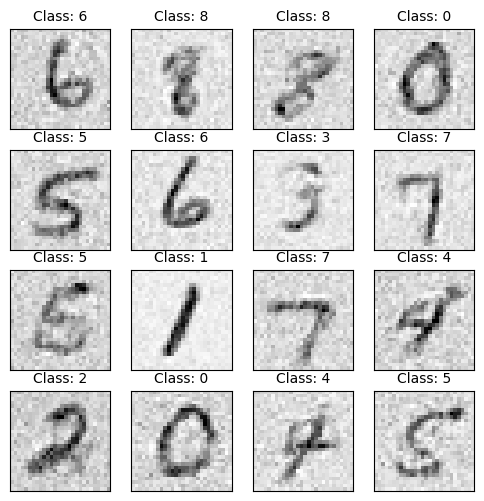

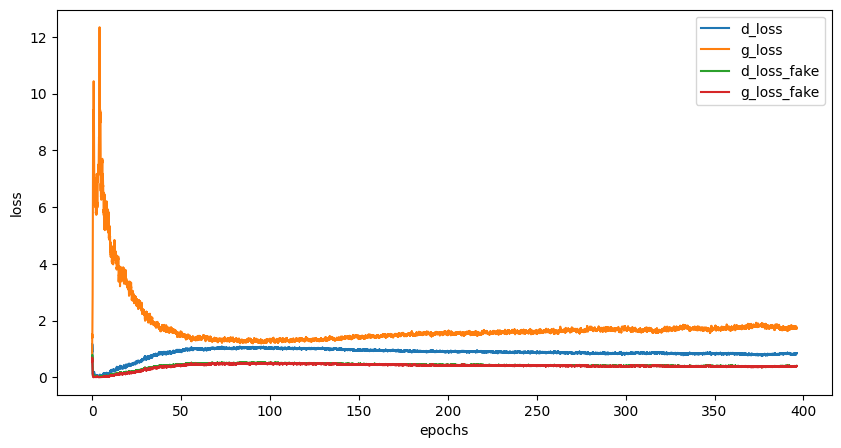

Epoch [397/500], Step[100/469], d_loss: 0.7755, d_loss_fake: 0.4186, g_loss: 1.7080, g_loss_fake: 0.4267, D(x): 0.77, D(G(z)): 0.29
Epoch [397/500], Step[200/469], d_loss: 0.8343, d_loss_fake: 0.4774, g_loss: 1.5398, g_loss_fake: 0.4350, D(x): 0.78, D(G(z)): 0.31
Epoch [397/500], Step[300/469], d_loss: 0.6643, d_loss_fake: 0.3036, g_loss: 2.1674, g_loss_fake: 0.4379, D(x): 0.76, D(G(z)): 0.23
Epoch [397/500], Step[400/469], d_loss: 0.8458, d_loss_fake: 0.3448, g_loss: 1.8861, g_loss_fake: 0.2780, D(x): 0.70, D(G(z)): 0.23


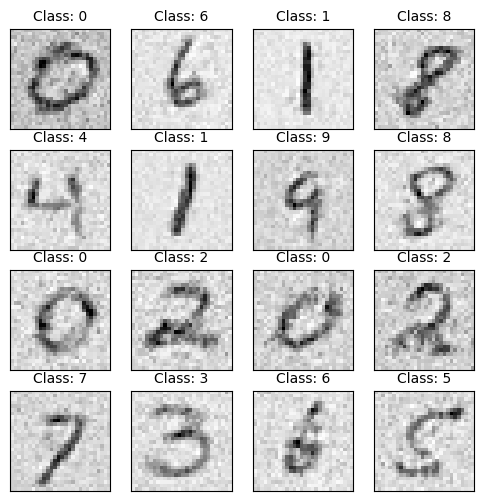

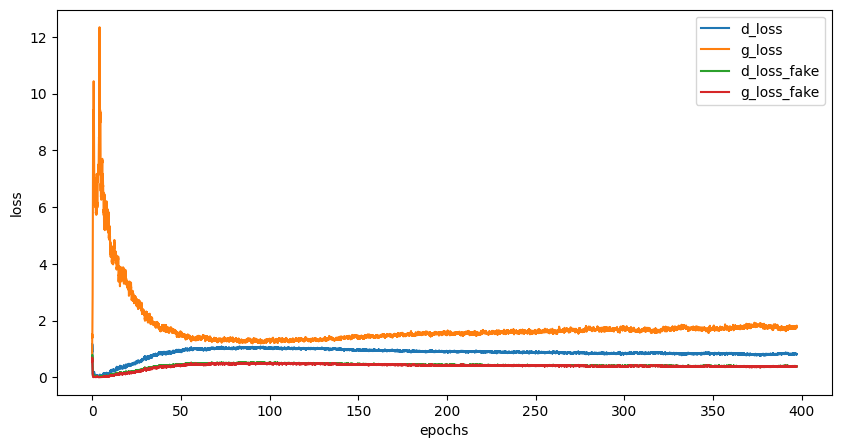

Epoch [398/500], Step[100/469], d_loss: 0.9056, d_loss_fake: 0.3652, g_loss: 1.8290, g_loss_fake: 0.3344, D(x): 0.69, D(G(z)): 0.24
Epoch [398/500], Step[200/469], d_loss: 0.8236, d_loss_fake: 0.3963, g_loss: 1.8497, g_loss_fake: 0.3084, D(x): 0.73, D(G(z)): 0.28
Epoch [398/500], Step[300/469], d_loss: 0.7494, d_loss_fake: 0.3911, g_loss: 1.7927, g_loss_fake: 0.3628, D(x): 0.78, D(G(z)): 0.28
Epoch [398/500], Step[400/469], d_loss: 0.9087, d_loss_fake: 0.2949, g_loss: 1.6159, g_loss_fake: 0.4067, D(x): 0.66, D(G(z)): 0.21


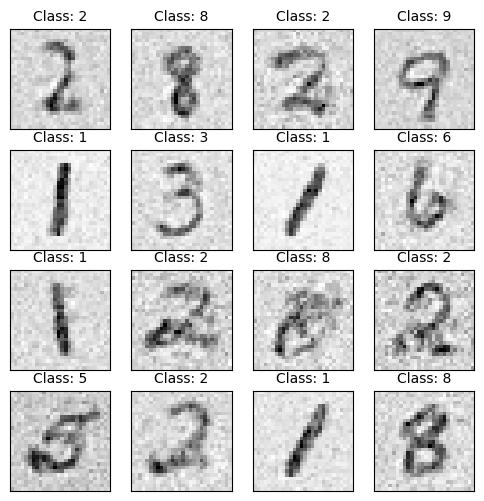

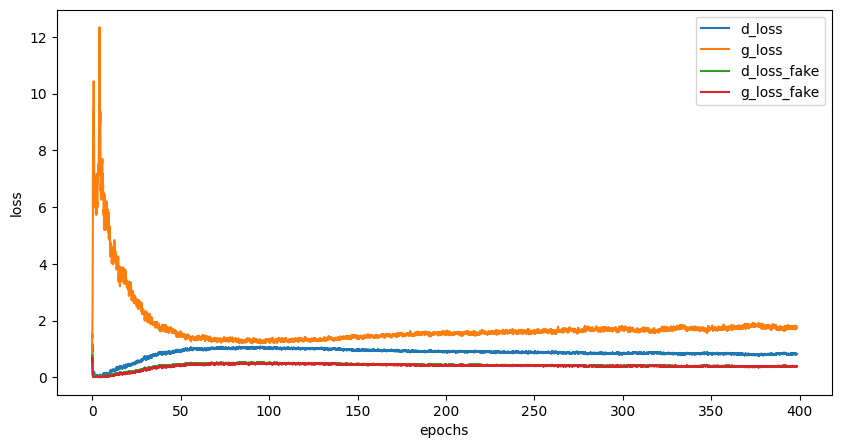

Epoch [399/500], Step[100/469], d_loss: 0.7142, d_loss_fake: 0.3778, g_loss: 1.7977, g_loss_fake: 0.3958, D(x): 0.77, D(G(z)): 0.25
Epoch [399/500], Step[200/469], d_loss: 0.8083, d_loss_fake: 0.4720, g_loss: 1.7170, g_loss_fake: 0.3526, D(x): 0.77, D(G(z)): 0.31
Epoch [399/500], Step[300/469], d_loss: 0.9421, d_loss_fake: 0.3874, g_loss: 1.7145, g_loss_fake: 0.3798, D(x): 0.68, D(G(z)): 0.26
Epoch [399/500], Step[400/469], d_loss: 0.7776, d_loss_fake: 0.3984, g_loss: 2.0469, g_loss_fake: 0.2865, D(x): 0.76, D(G(z)): 0.26


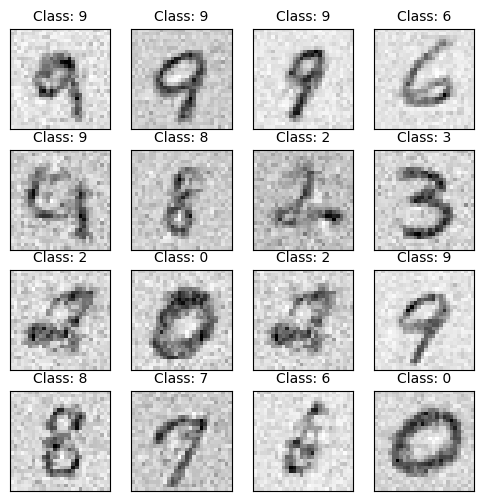

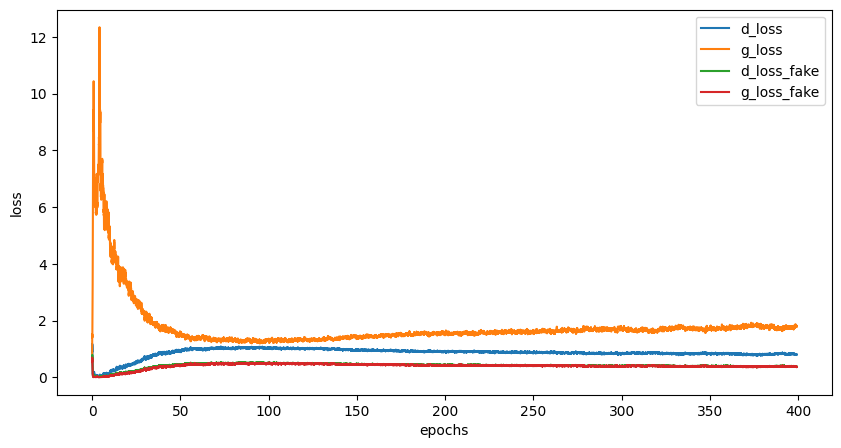

Epoch [400/500], Step[100/469], d_loss: 0.7844, d_loss_fake: 0.3556, g_loss: 1.9171, g_loss_fake: 0.2808, D(x): 0.73, D(G(z)): 0.27
Epoch [400/500], Step[200/469], d_loss: 0.7423, d_loss_fake: 0.3466, g_loss: 1.9288, g_loss_fake: 0.3774, D(x): 0.76, D(G(z)): 0.25
Epoch [400/500], Step[300/469], d_loss: 0.9696, d_loss_fake: 0.4479, g_loss: 1.8299, g_loss_fake: 0.3671, D(x): 0.70, D(G(z)): 0.30
Epoch [400/500], Step[400/469], d_loss: 0.6807, d_loss_fake: 0.3221, g_loss: 1.8879, g_loss_fake: 0.4016, D(x): 0.76, D(G(z)): 0.23


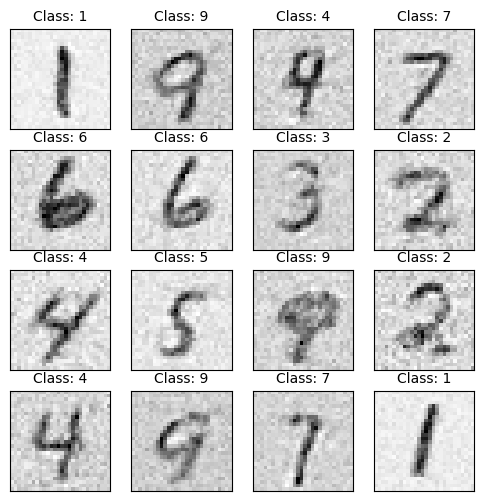

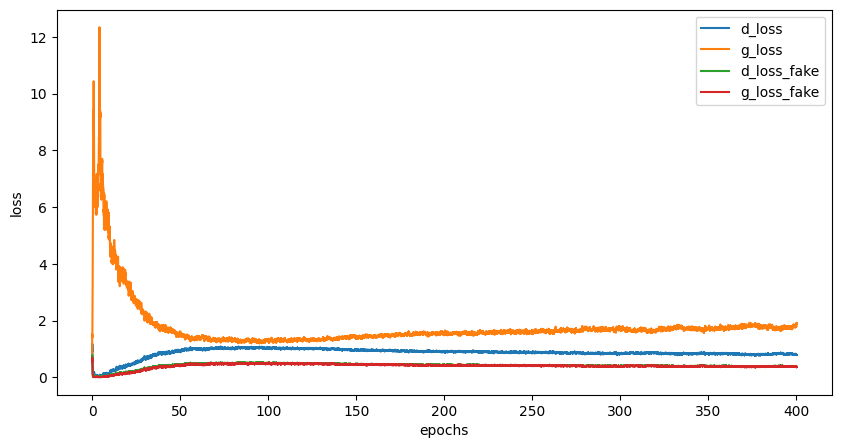

Epoch [401/500], Step[100/469], d_loss: 0.7495, d_loss_fake: 0.3758, g_loss: 1.6209, g_loss_fake: 0.4355, D(x): 0.76, D(G(z)): 0.26
Epoch [401/500], Step[200/469], d_loss: 0.7711, d_loss_fake: 0.3489, g_loss: 2.0507, g_loss_fake: 0.3113, D(x): 0.74, D(G(z)): 0.24
Epoch [401/500], Step[300/469], d_loss: 0.7441, d_loss_fake: 0.3917, g_loss: 1.5774, g_loss_fake: 0.4223, D(x): 0.79, D(G(z)): 0.27
Epoch [401/500], Step[400/469], d_loss: 0.8057, d_loss_fake: 0.3754, g_loss: 1.5558, g_loss_fake: 0.3959, D(x): 0.75, D(G(z)): 0.28


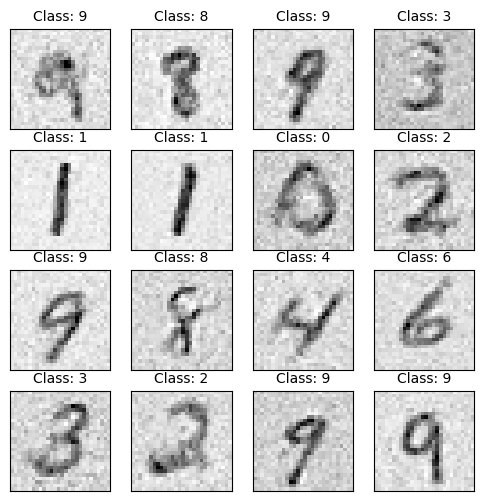

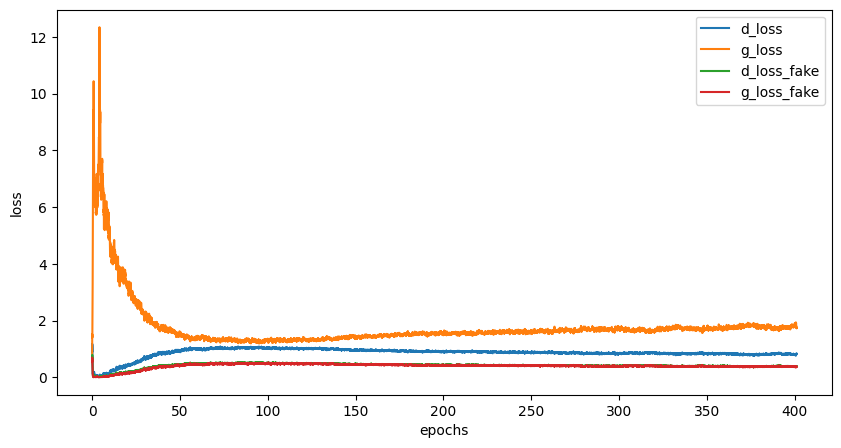

Epoch [402/500], Step[100/469], d_loss: 0.8694, d_loss_fake: 0.4290, g_loss: 2.1631, g_loss_fake: 0.2973, D(x): 0.73, D(G(z)): 0.26
Epoch [402/500], Step[200/469], d_loss: 0.7552, d_loss_fake: 0.3205, g_loss: 1.8270, g_loss_fake: 0.3312, D(x): 0.74, D(G(z)): 0.22
Epoch [402/500], Step[300/469], d_loss: 0.8942, d_loss_fake: 0.3429, g_loss: 2.0771, g_loss_fake: 0.3039, D(x): 0.68, D(G(z)): 0.24
Epoch [402/500], Step[400/469], d_loss: 0.7199, d_loss_fake: 0.3401, g_loss: 1.9093, g_loss_fake: 0.4349, D(x): 0.77, D(G(z)): 0.23


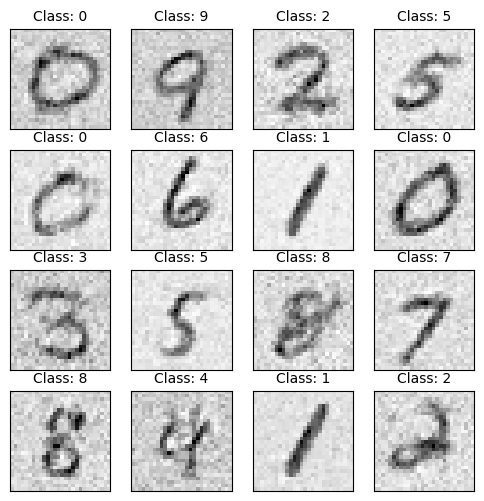

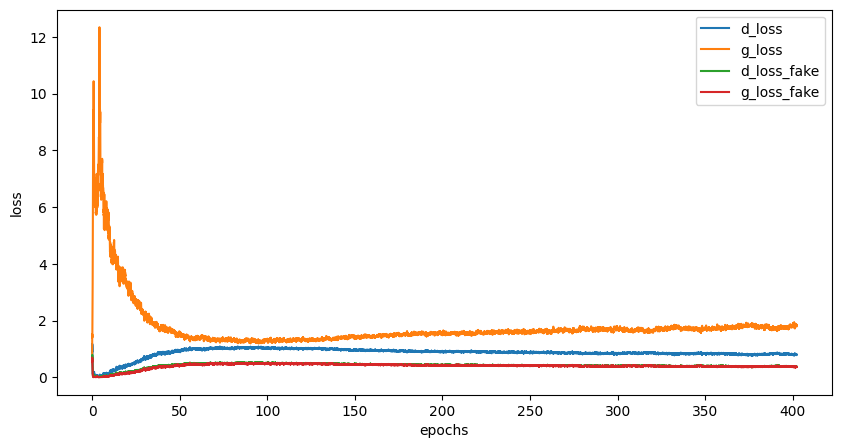

Epoch [403/500], Step[100/469], d_loss: 0.7275, d_loss_fake: 0.3082, g_loss: 2.0945, g_loss_fake: 0.2941, D(x): 0.75, D(G(z)): 0.22
Epoch [403/500], Step[200/469], d_loss: 0.8063, d_loss_fake: 0.3376, g_loss: 1.8069, g_loss_fake: 0.3672, D(x): 0.72, D(G(z)): 0.24
Epoch [403/500], Step[300/469], d_loss: 0.8363, d_loss_fake: 0.3308, g_loss: 1.8608, g_loss_fake: 0.3373, D(x): 0.70, D(G(z)): 0.24
Epoch [403/500], Step[400/469], d_loss: 0.9756, d_loss_fake: 0.3870, g_loss: 1.8404, g_loss_fake: 0.3311, D(x): 0.65, D(G(z)): 0.26


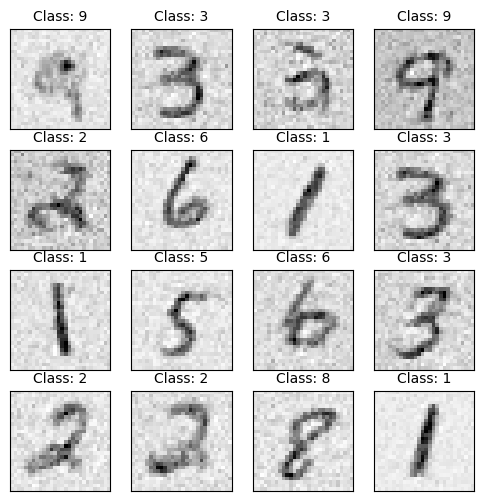

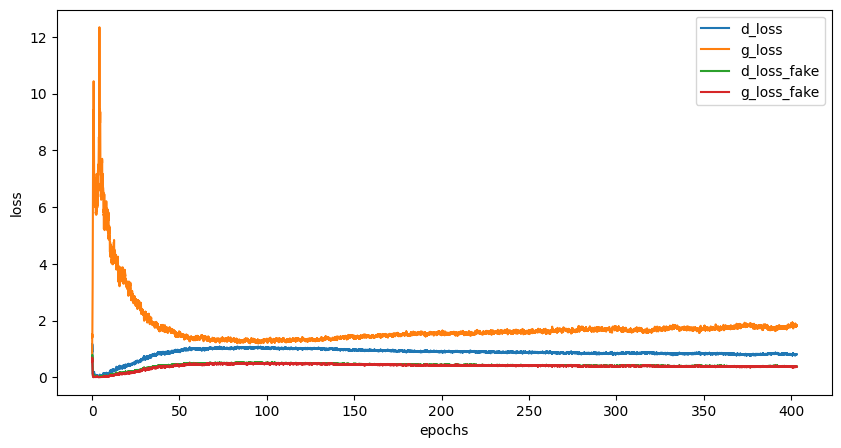

Epoch [404/500], Step[100/469], d_loss: 0.7715, d_loss_fake: 0.3552, g_loss: 1.8632, g_loss_fake: 0.2778, D(x): 0.73, D(G(z)): 0.25
Epoch [404/500], Step[200/469], d_loss: 0.9036, d_loss_fake: 0.4867, g_loss: 1.6724, g_loss_fake: 0.3760, D(x): 0.75, D(G(z)): 0.31
Epoch [404/500], Step[300/469], d_loss: 0.8415, d_loss_fake: 0.4173, g_loss: 1.8945, g_loss_fake: 0.3949, D(x): 0.73, D(G(z)): 0.27
Epoch [404/500], Step[400/469], d_loss: 0.7873, d_loss_fake: 0.3302, g_loss: 1.6501, g_loss_fake: 0.4010, D(x): 0.74, D(G(z)): 0.24


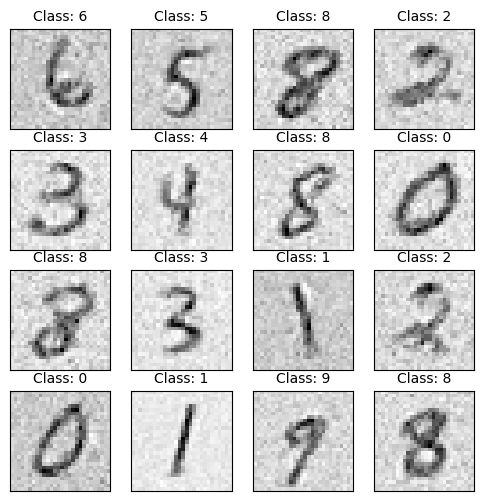

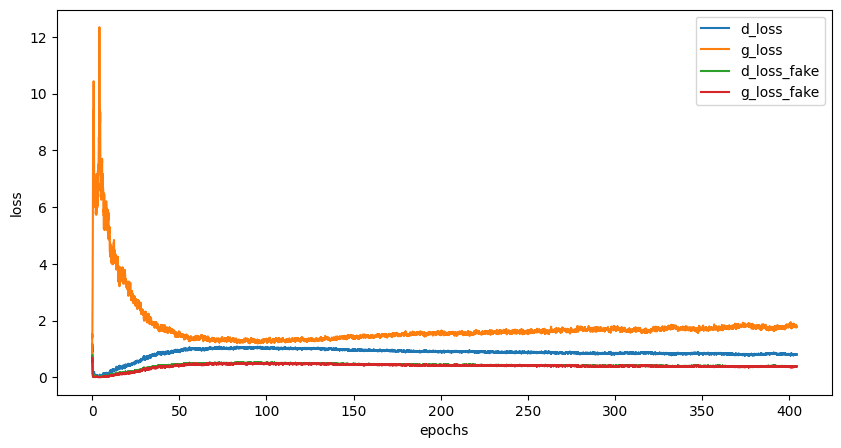

Epoch [405/500], Step[100/469], d_loss: 0.8184, d_loss_fake: 0.4440, g_loss: 1.8817, g_loss_fake: 0.3230, D(x): 0.77, D(G(z)): 0.28
Epoch [405/500], Step[200/469], d_loss: 0.7898, d_loss_fake: 0.3179, g_loss: 1.8159, g_loss_fake: 0.3278, D(x): 0.71, D(G(z)): 0.23
Epoch [405/500], Step[300/469], d_loss: 0.7913, d_loss_fake: 0.3975, g_loss: 1.7994, g_loss_fake: 0.3177, D(x): 0.75, D(G(z)): 0.26
Epoch [405/500], Step[400/469], d_loss: 0.7241, d_loss_fake: 0.3540, g_loss: 1.6404, g_loss_fake: 0.4176, D(x): 0.77, D(G(z)): 0.24


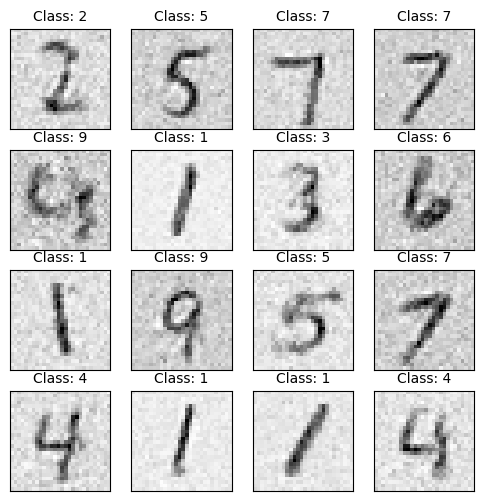

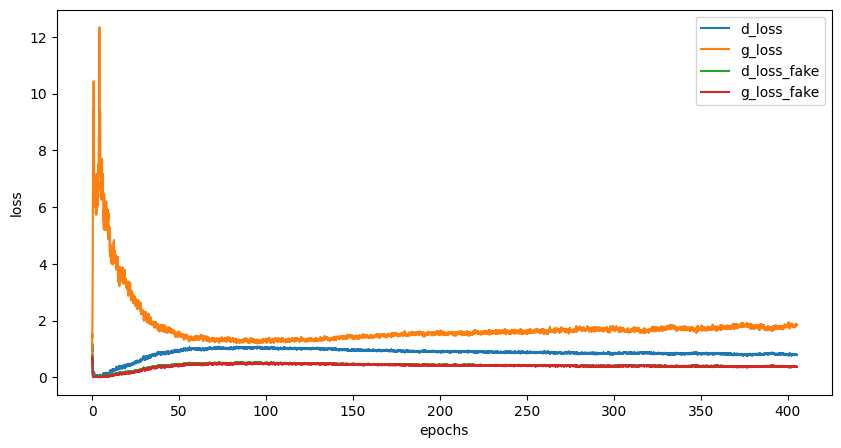

Epoch [406/500], Step[100/469], d_loss: 0.8132, d_loss_fake: 0.4514, g_loss: 1.6751, g_loss_fake: 0.4738, D(x): 0.77, D(G(z)): 0.28
Epoch [406/500], Step[200/469], d_loss: 0.8561, d_loss_fake: 0.3848, g_loss: 1.7859, g_loss_fake: 0.4152, D(x): 0.72, D(G(z)): 0.25
Epoch [406/500], Step[300/469], d_loss: 0.8432, d_loss_fake: 0.4037, g_loss: 1.6581, g_loss_fake: 0.4165, D(x): 0.74, D(G(z)): 0.27
Epoch [406/500], Step[400/469], d_loss: 0.7722, d_loss_fake: 0.2955, g_loss: 2.0940, g_loss_fake: 0.3031, D(x): 0.72, D(G(z)): 0.22


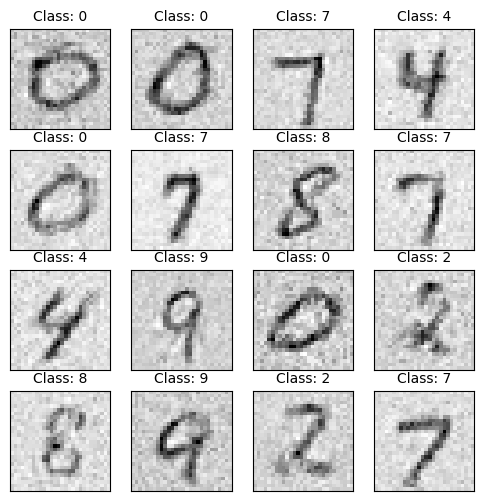

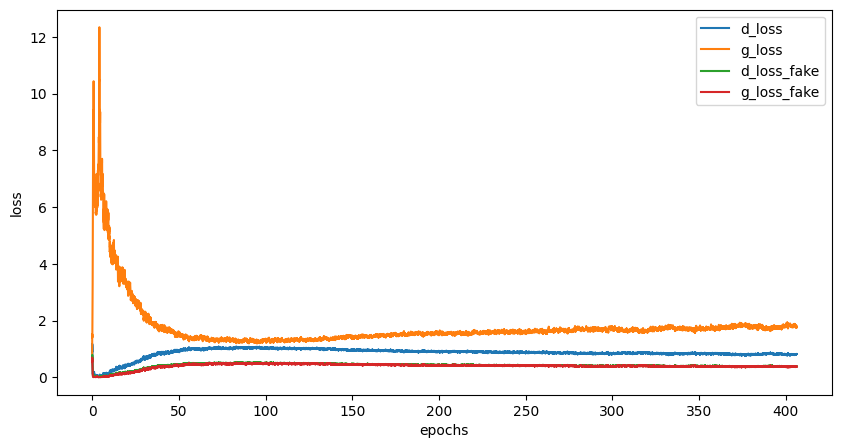

Epoch [407/500], Step[100/469], d_loss: 0.9640, d_loss_fake: 0.4696, g_loss: 1.9066, g_loss_fake: 0.3351, D(x): 0.70, D(G(z)): 0.28
Epoch [407/500], Step[200/469], d_loss: 0.8206, d_loss_fake: 0.4661, g_loss: 1.7437, g_loss_fake: 0.4230, D(x): 0.78, D(G(z)): 0.29
Epoch [407/500], Step[300/469], d_loss: 0.7644, d_loss_fake: 0.3648, g_loss: 1.8546, g_loss_fake: 0.3325, D(x): 0.76, D(G(z)): 0.25
Epoch [407/500], Step[400/469], d_loss: 0.7922, d_loss_fake: 0.3569, g_loss: 1.8054, g_loss_fake: 0.3724, D(x): 0.73, D(G(z)): 0.26


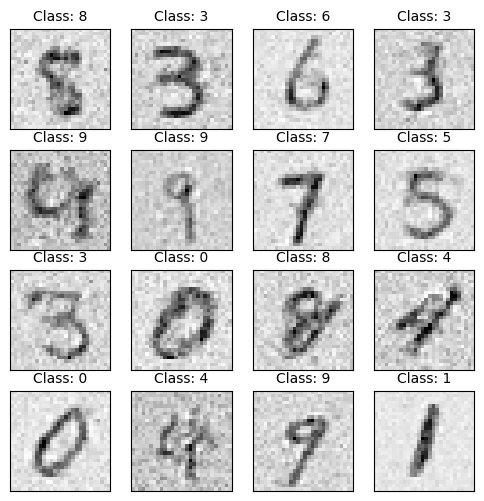

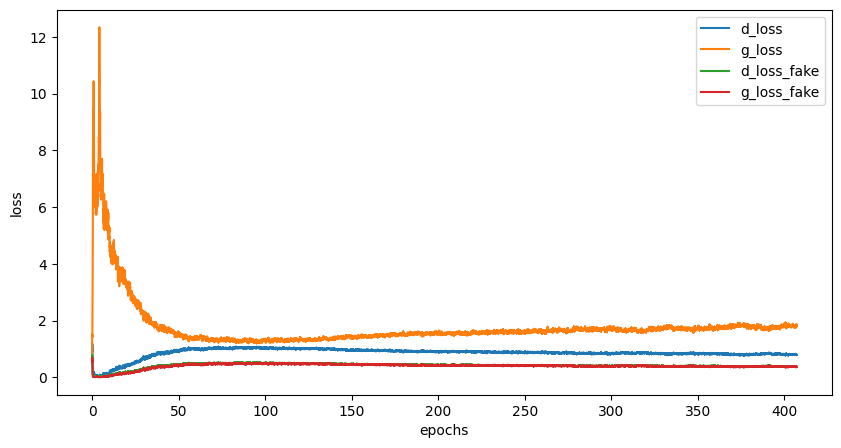

Epoch [408/500], Step[100/469], d_loss: 0.6421, d_loss_fake: 0.2807, g_loss: 1.8112, g_loss_fake: 0.3804, D(x): 0.77, D(G(z)): 0.22
Epoch [408/500], Step[200/469], d_loss: 0.8856, d_loss_fake: 0.3174, g_loss: 2.0036, g_loss_fake: 0.3148, D(x): 0.66, D(G(z)): 0.21
Epoch [408/500], Step[300/469], d_loss: 0.8116, d_loss_fake: 0.4295, g_loss: 1.7178, g_loss_fake: 0.3924, D(x): 0.77, D(G(z)): 0.28
Epoch [408/500], Step[400/469], d_loss: 0.7839, d_loss_fake: 0.3787, g_loss: 1.7092, g_loss_fake: 0.3796, D(x): 0.73, D(G(z)): 0.26


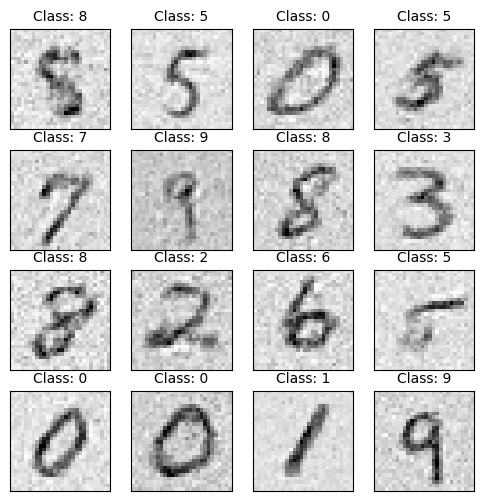

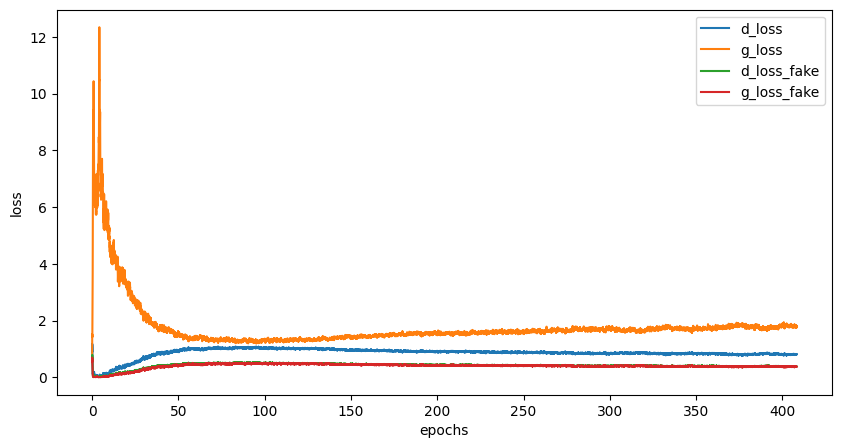

Epoch [409/500], Step[100/469], d_loss: 0.7646, d_loss_fake: 0.3812, g_loss: 1.6186, g_loss_fake: 0.4614, D(x): 0.77, D(G(z)): 0.26
Epoch [409/500], Step[200/469], d_loss: 0.9393, d_loss_fake: 0.4274, g_loss: 1.7153, g_loss_fake: 0.3800, D(x): 0.70, D(G(z)): 0.29
Epoch [409/500], Step[300/469], d_loss: 0.8251, d_loss_fake: 0.4546, g_loss: 1.7447, g_loss_fake: 0.3717, D(x): 0.76, D(G(z)): 0.30
Epoch [409/500], Step[400/469], d_loss: 0.7539, d_loss_fake: 0.3345, g_loss: 1.8085, g_loss_fake: 0.3319, D(x): 0.74, D(G(z)): 0.24


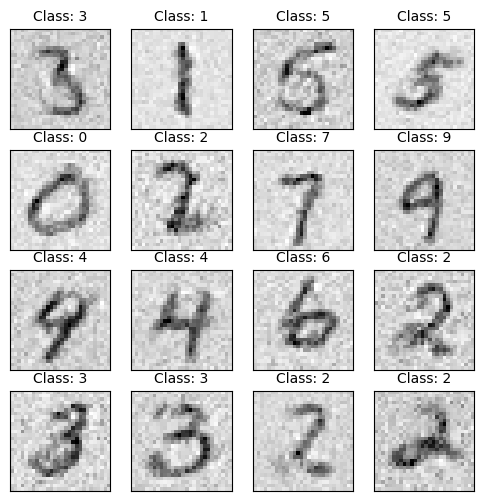

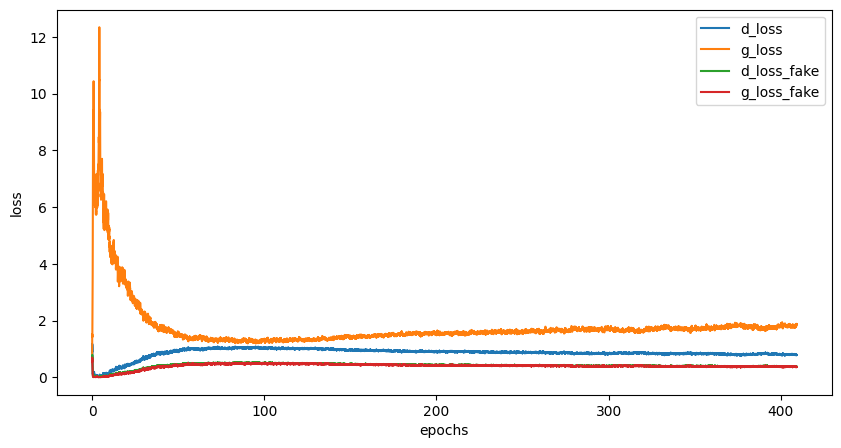

Epoch [410/500], Step[100/469], d_loss: 0.8036, d_loss_fake: 0.4514, g_loss: 1.8548, g_loss_fake: 0.3481, D(x): 0.78, D(G(z)): 0.29
Epoch [410/500], Step[200/469], d_loss: 0.7335, d_loss_fake: 0.3117, g_loss: 1.8777, g_loss_fake: 0.4068, D(x): 0.72, D(G(z)): 0.24
Epoch [410/500], Step[300/469], d_loss: 0.8599, d_loss_fake: 0.5064, g_loss: 1.6776, g_loss_fake: 0.3676, D(x): 0.78, D(G(z)): 0.31
Epoch [410/500], Step[400/469], d_loss: 0.7929, d_loss_fake: 0.3914, g_loss: 1.5844, g_loss_fake: 0.4013, D(x): 0.75, D(G(z)): 0.27


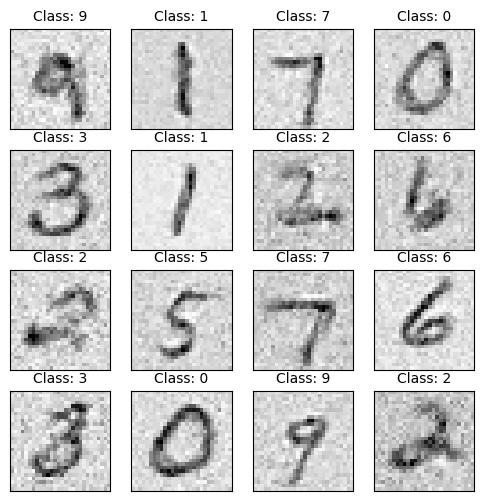

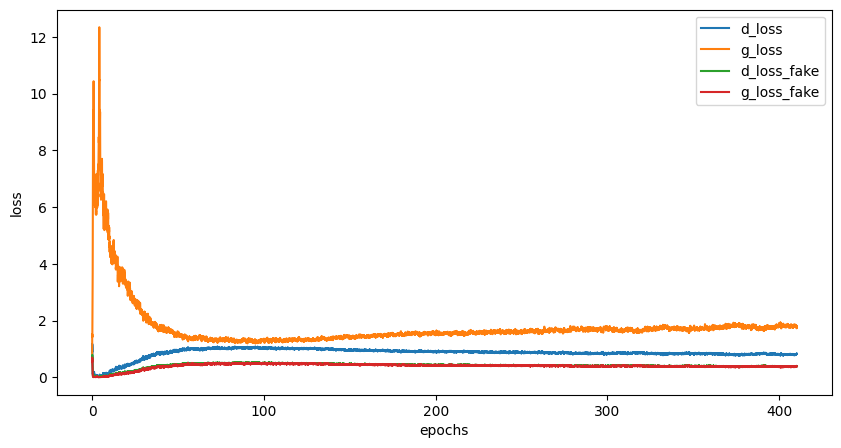

Epoch [411/500], Step[100/469], d_loss: 0.7948, d_loss_fake: 0.4463, g_loss: 1.6423, g_loss_fake: 0.4484, D(x): 0.79, D(G(z)): 0.30
Epoch [411/500], Step[200/469], d_loss: 0.8438, d_loss_fake: 0.3780, g_loss: 1.7365, g_loss_fake: 0.3984, D(x): 0.71, D(G(z)): 0.27
Epoch [411/500], Step[300/469], d_loss: 0.6833, d_loss_fake: 0.2767, g_loss: 1.8059, g_loss_fake: 0.3344, D(x): 0.75, D(G(z)): 0.22
Epoch [411/500], Step[400/469], d_loss: 0.6428, d_loss_fake: 0.3004, g_loss: 1.8121, g_loss_fake: 0.3887, D(x): 0.79, D(G(z)): 0.23


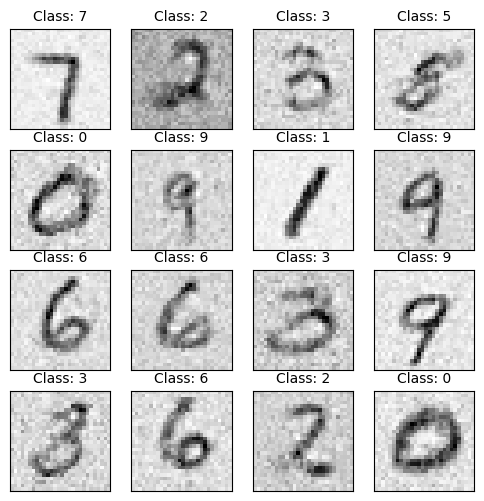

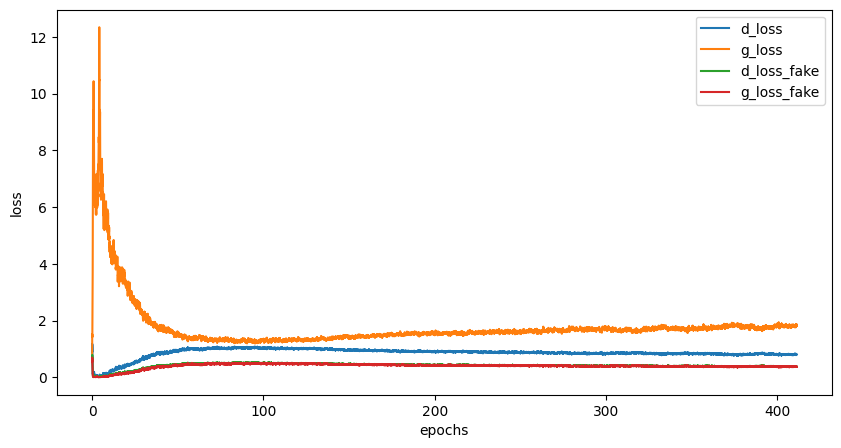

Epoch [412/500], Step[100/469], d_loss: 0.8546, d_loss_fake: 0.4182, g_loss: 1.6788, g_loss_fake: 0.4161, D(x): 0.73, D(G(z)): 0.27
Epoch [412/500], Step[200/469], d_loss: 0.7690, d_loss_fake: 0.3775, g_loss: 1.6427, g_loss_fake: 0.3970, D(x): 0.75, D(G(z)): 0.27
Epoch [412/500], Step[300/469], d_loss: 0.8078, d_loss_fake: 0.3747, g_loss: 1.8082, g_loss_fake: 0.3837, D(x): 0.73, D(G(z)): 0.26
Epoch [412/500], Step[400/469], d_loss: 0.8290, d_loss_fake: 0.3294, g_loss: 1.6476, g_loss_fake: 0.3855, D(x): 0.71, D(G(z)): 0.25


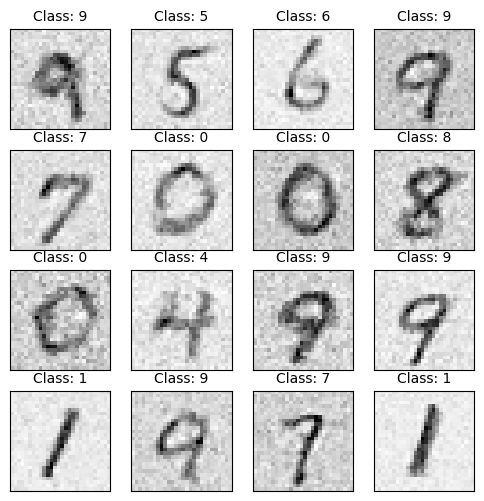

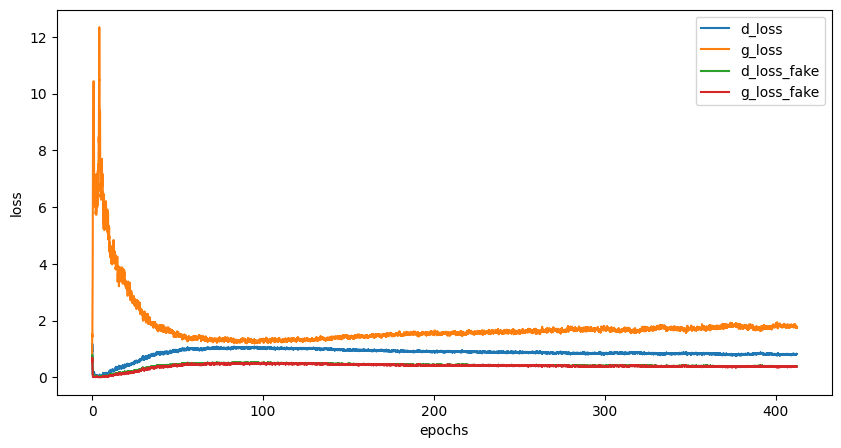

Epoch [413/500], Step[100/469], d_loss: 0.8099, d_loss_fake: 0.4439, g_loss: 1.6834, g_loss_fake: 0.3955, D(x): 0.77, D(G(z)): 0.30
Epoch [413/500], Step[200/469], d_loss: 0.7690, d_loss_fake: 0.3726, g_loss: 1.7956, g_loss_fake: 0.3577, D(x): 0.75, D(G(z)): 0.26
Epoch [413/500], Step[300/469], d_loss: 0.9955, d_loss_fake: 0.3572, g_loss: 1.8754, g_loss_fake: 0.3686, D(x): 0.65, D(G(z)): 0.23
Epoch [413/500], Step[400/469], d_loss: 0.7994, d_loss_fake: 0.3765, g_loss: 1.8403, g_loss_fake: 0.3343, D(x): 0.74, D(G(z)): 0.26


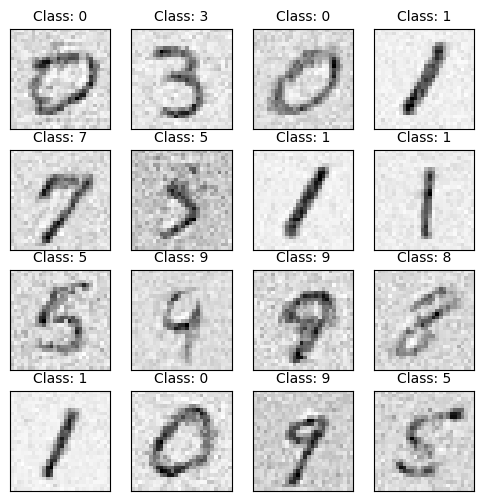

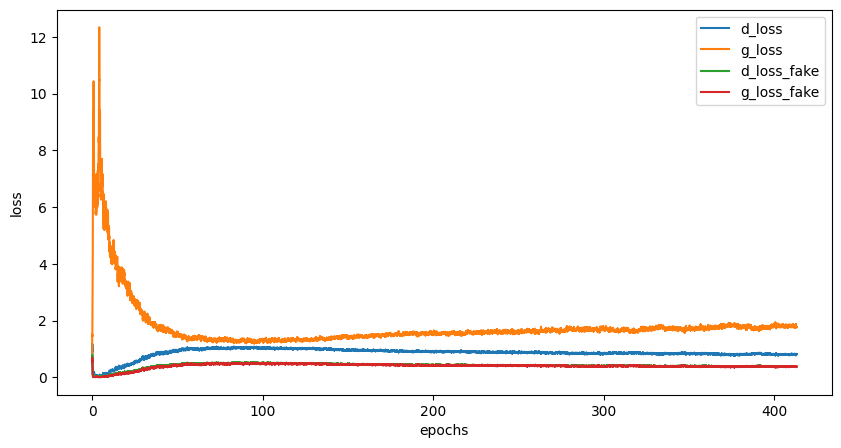

Epoch [414/500], Step[100/469], d_loss: 0.7773, d_loss_fake: 0.3757, g_loss: 1.7655, g_loss_fake: 0.4371, D(x): 0.74, D(G(z)): 0.25
Epoch [414/500], Step[200/469], d_loss: 0.7689, d_loss_fake: 0.3670, g_loss: 1.7295, g_loss_fake: 0.4014, D(x): 0.75, D(G(z)): 0.27
Epoch [414/500], Step[300/469], d_loss: 0.6993, d_loss_fake: 0.2964, g_loss: 1.7268, g_loss_fake: 0.3544, D(x): 0.75, D(G(z)): 0.21
Epoch [414/500], Step[400/469], d_loss: 0.6574, d_loss_fake: 0.2743, g_loss: 1.9275, g_loss_fake: 0.3384, D(x): 0.76, D(G(z)): 0.21


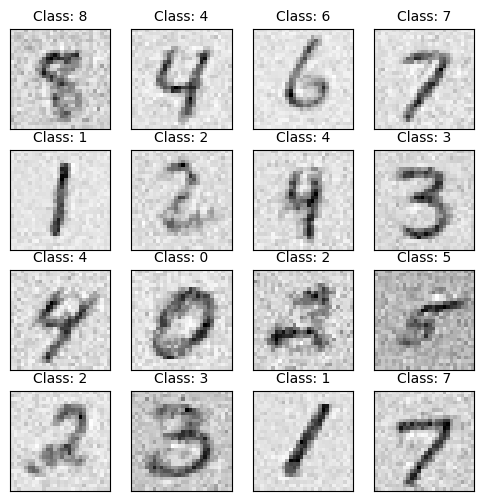

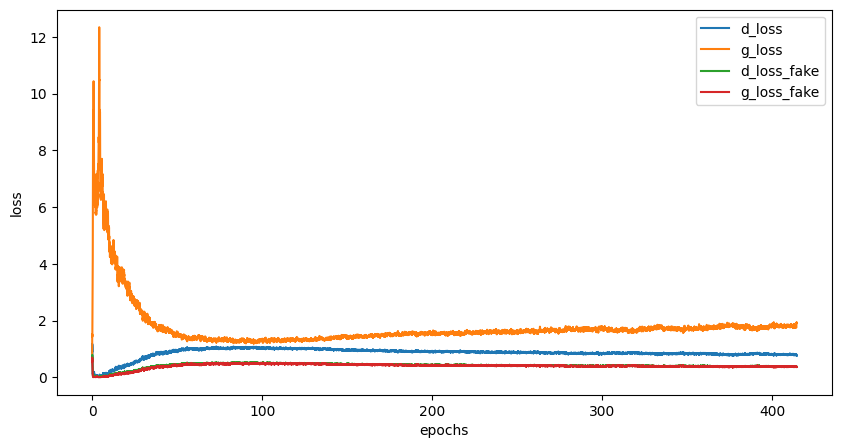

Epoch [415/500], Step[100/469], d_loss: 0.7929, d_loss_fake: 0.3453, g_loss: 1.9389, g_loss_fake: 0.3521, D(x): 0.74, D(G(z)): 0.25
Epoch [415/500], Step[200/469], d_loss: 0.7223, d_loss_fake: 0.4187, g_loss: 1.6165, g_loss_fake: 0.4495, D(x): 0.79, D(G(z)): 0.28
Epoch [415/500], Step[300/469], d_loss: 0.7283, d_loss_fake: 0.3761, g_loss: 1.5692, g_loss_fake: 0.4573, D(x): 0.78, D(G(z)): 0.26
Epoch [415/500], Step[400/469], d_loss: 0.8541, d_loss_fake: 0.4757, g_loss: 1.7133, g_loss_fake: 0.4613, D(x): 0.77, D(G(z)): 0.30


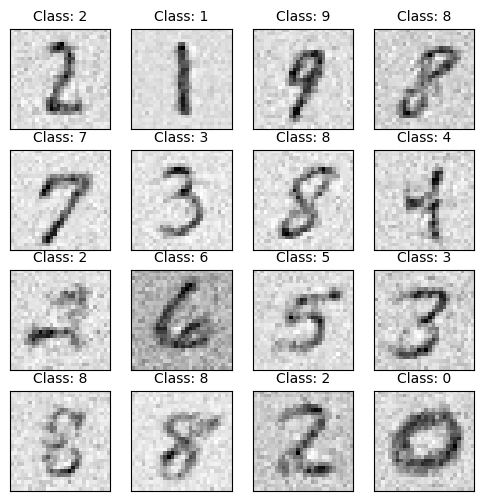

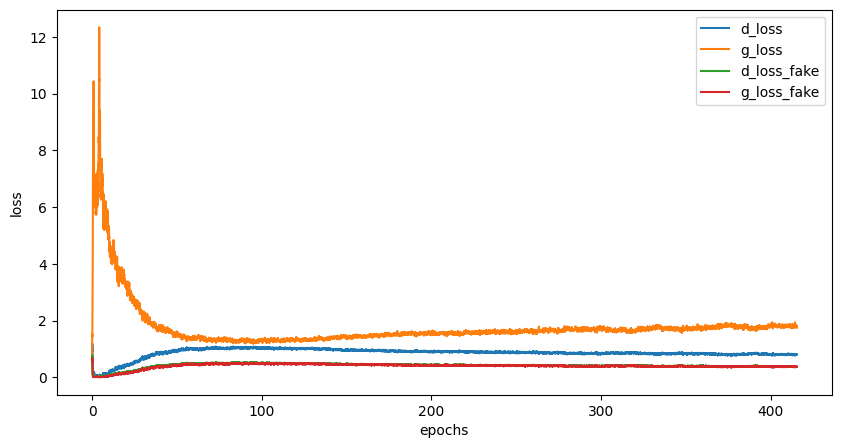

Epoch [416/500], Step[100/469], d_loss: 0.8318, d_loss_fake: 0.3070, g_loss: 2.0883, g_loss_fake: 0.3188, D(x): 0.70, D(G(z)): 0.22
Epoch [416/500], Step[200/469], d_loss: 0.8820, d_loss_fake: 0.3651, g_loss: 1.9828, g_loss_fake: 0.3236, D(x): 0.70, D(G(z)): 0.25
Epoch [416/500], Step[300/469], d_loss: 0.8324, d_loss_fake: 0.4599, g_loss: 1.7449, g_loss_fake: 0.3807, D(x): 0.77, D(G(z)): 0.30
Epoch [416/500], Step[400/469], d_loss: 0.8603, d_loss_fake: 0.4466, g_loss: 1.6183, g_loss_fake: 0.4023, D(x): 0.74, D(G(z)): 0.28


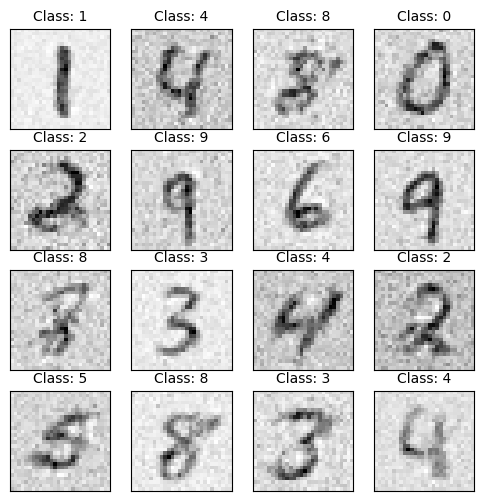

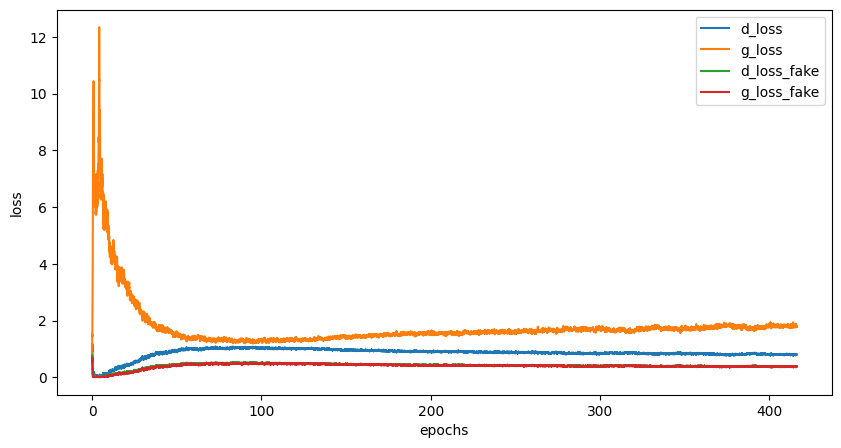

Epoch [417/500], Step[100/469], d_loss: 0.8704, d_loss_fake: 0.4239, g_loss: 1.8365, g_loss_fake: 0.4706, D(x): 0.73, D(G(z)): 0.28
Epoch [417/500], Step[200/469], d_loss: 0.6916, d_loss_fake: 0.3445, g_loss: 1.7103, g_loss_fake: 0.4239, D(x): 0.78, D(G(z)): 0.25
Epoch [417/500], Step[300/469], d_loss: 0.7951, d_loss_fake: 0.3617, g_loss: 1.7876, g_loss_fake: 0.3269, D(x): 0.73, D(G(z)): 0.26
Epoch [417/500], Step[400/469], d_loss: 0.7634, d_loss_fake: 0.4119, g_loss: 1.7504, g_loss_fake: 0.3626, D(x): 0.77, D(G(z)): 0.28


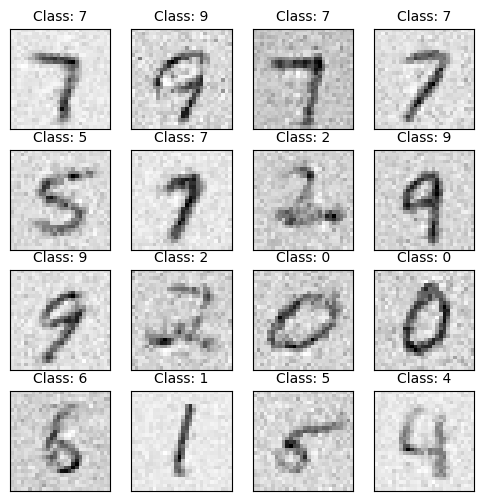

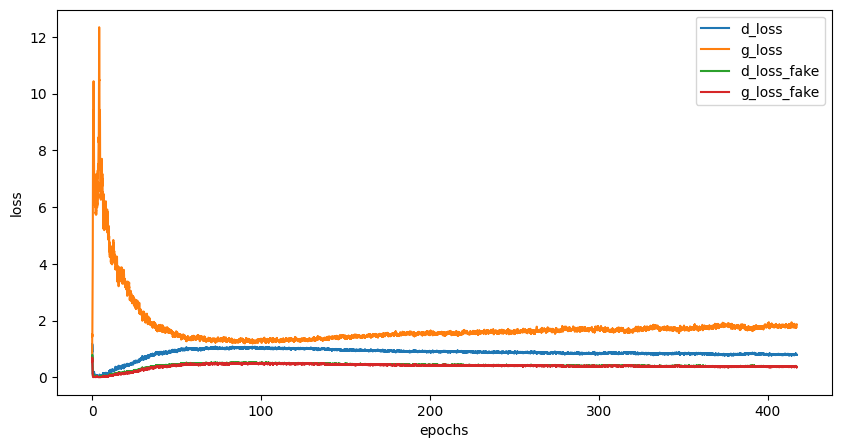

Epoch [418/500], Step[100/469], d_loss: 0.7890, d_loss_fake: 0.3708, g_loss: 1.7515, g_loss_fake: 0.3732, D(x): 0.74, D(G(z)): 0.25
Epoch [418/500], Step[200/469], d_loss: 0.7577, d_loss_fake: 0.3430, g_loss: 1.6687, g_loss_fake: 0.4292, D(x): 0.76, D(G(z)): 0.25
Epoch [418/500], Step[300/469], d_loss: 0.7086, d_loss_fake: 0.4666, g_loss: 1.6993, g_loss_fake: 0.4010, D(x): 0.83, D(G(z)): 0.28
Epoch [418/500], Step[400/469], d_loss: 0.8451, d_loss_fake: 0.3744, g_loss: 1.9836, g_loss_fake: 0.3551, D(x): 0.72, D(G(z)): 0.25


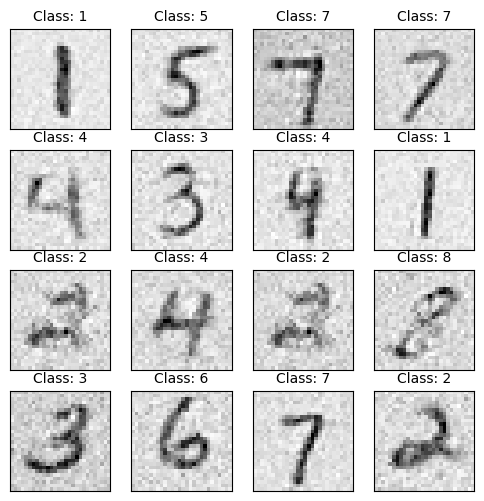

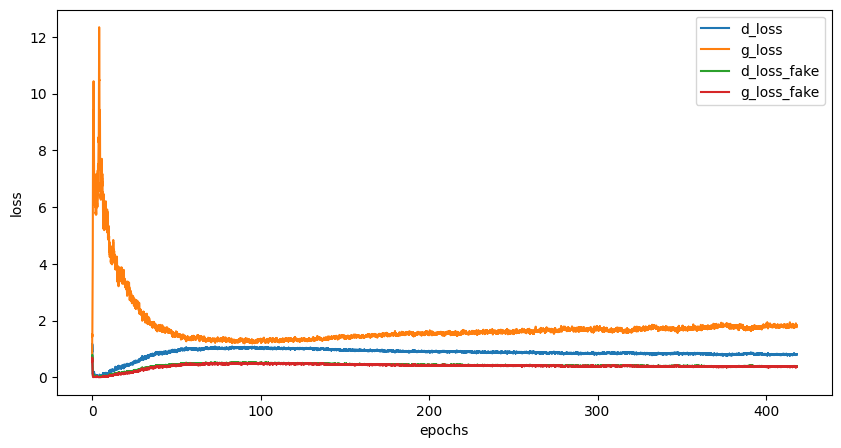

Epoch [419/500], Step[100/469], d_loss: 0.7542, d_loss_fake: 0.3891, g_loss: 1.8163, g_loss_fake: 0.4330, D(x): 0.79, D(G(z)): 0.26
Epoch [419/500], Step[200/469], d_loss: 0.6413, d_loss_fake: 0.3067, g_loss: 2.0001, g_loss_fake: 0.3311, D(x): 0.78, D(G(z)): 0.23
Epoch [419/500], Step[300/469], d_loss: 0.8128, d_loss_fake: 0.2971, g_loss: 1.7319, g_loss_fake: 0.3489, D(x): 0.70, D(G(z)): 0.24
Epoch [419/500], Step[400/469], d_loss: 0.8123, d_loss_fake: 0.3591, g_loss: 1.9778, g_loss_fake: 0.3806, D(x): 0.73, D(G(z)): 0.24


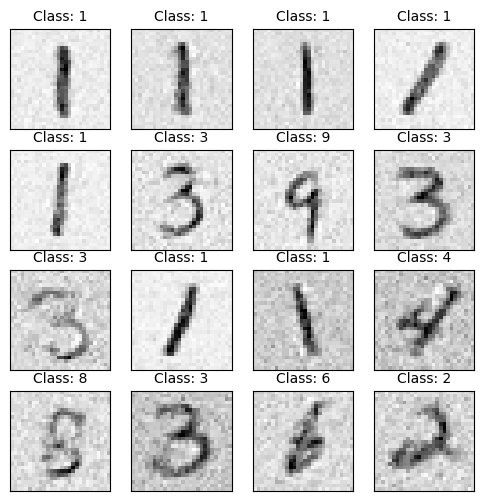

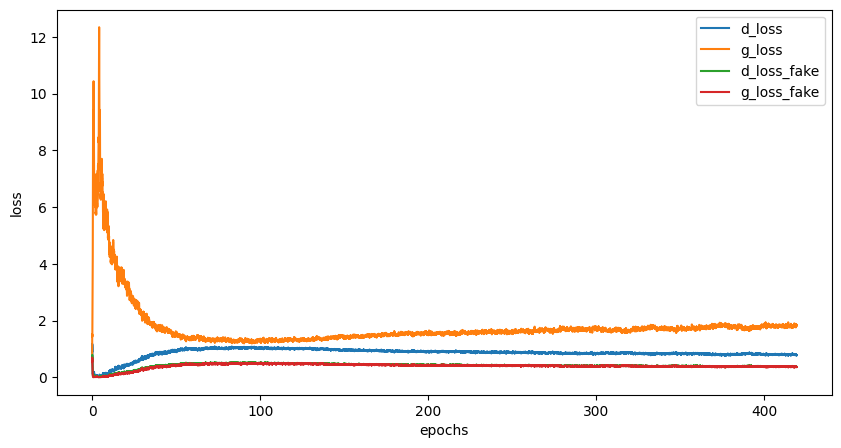

Epoch [420/500], Step[100/469], d_loss: 0.8424, d_loss_fake: 0.3153, g_loss: 1.6618, g_loss_fake: 0.4890, D(x): 0.71, D(G(z)): 0.22
Epoch [420/500], Step[200/469], d_loss: 0.7606, d_loss_fake: 0.4382, g_loss: 1.7030, g_loss_fake: 0.4993, D(x): 0.79, D(G(z)): 0.28
Epoch [420/500], Step[300/469], d_loss: 0.8820, d_loss_fake: 0.4561, g_loss: 1.6665, g_loss_fake: 0.3877, D(x): 0.74, D(G(z)): 0.28
Epoch [420/500], Step[400/469], d_loss: 0.9234, d_loss_fake: 0.4711, g_loss: 1.5625, g_loss_fake: 0.4638, D(x): 0.71, D(G(z)): 0.30


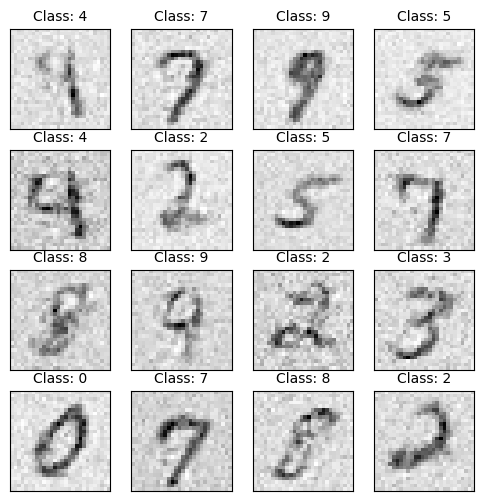

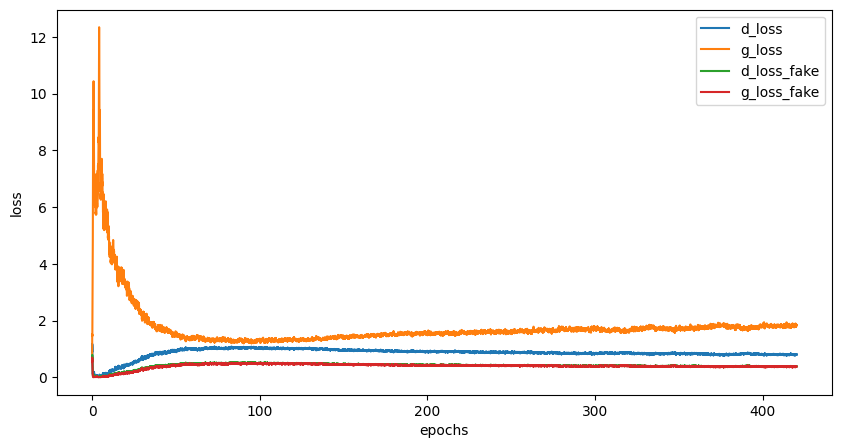

Epoch [421/500], Step[100/469], d_loss: 0.8055, d_loss_fake: 0.3124, g_loss: 2.0125, g_loss_fake: 0.3354, D(x): 0.72, D(G(z)): 0.23
Epoch [421/500], Step[200/469], d_loss: 0.7001, d_loss_fake: 0.3506, g_loss: 1.9199, g_loss_fake: 0.3532, D(x): 0.79, D(G(z)): 0.24
Epoch [421/500], Step[300/469], d_loss: 0.7262, d_loss_fake: 0.4020, g_loss: 1.7784, g_loss_fake: 0.4210, D(x): 0.79, D(G(z)): 0.27
Epoch [421/500], Step[400/469], d_loss: 0.7886, d_loss_fake: 0.3653, g_loss: 2.6137, g_loss_fake: 0.2636, D(x): 0.74, D(G(z)): 0.23


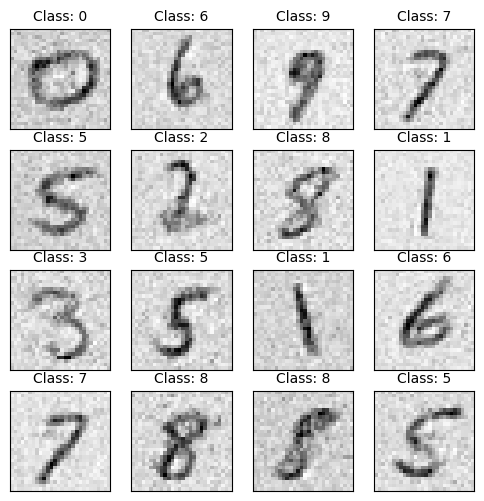

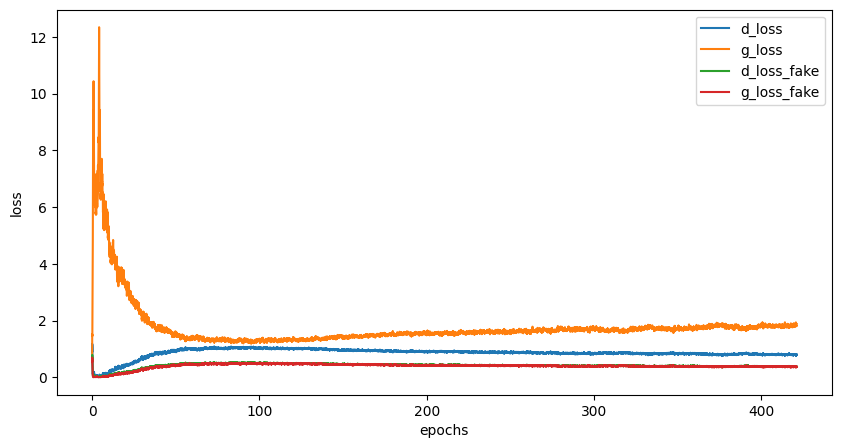

Epoch [422/500], Step[100/469], d_loss: 0.6980, d_loss_fake: 0.3063, g_loss: 1.6988, g_loss_fake: 0.3473, D(x): 0.76, D(G(z)): 0.23
Epoch [422/500], Step[200/469], d_loss: 0.8107, d_loss_fake: 0.3097, g_loss: 2.0807, g_loss_fake: 0.3083, D(x): 0.70, D(G(z)): 0.23
Epoch [422/500], Step[300/469], d_loss: 0.8941, d_loss_fake: 0.4418, g_loss: 1.7141, g_loss_fake: 0.3549, D(x): 0.74, D(G(z)): 0.30
Epoch [422/500], Step[400/469], d_loss: 0.8603, d_loss_fake: 0.4155, g_loss: 1.7358, g_loss_fake: 0.3563, D(x): 0.72, D(G(z)): 0.27


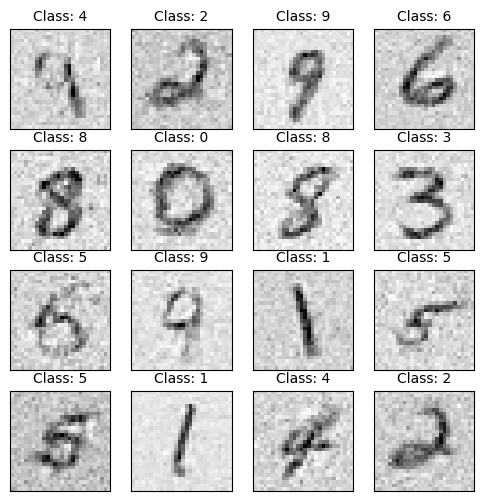

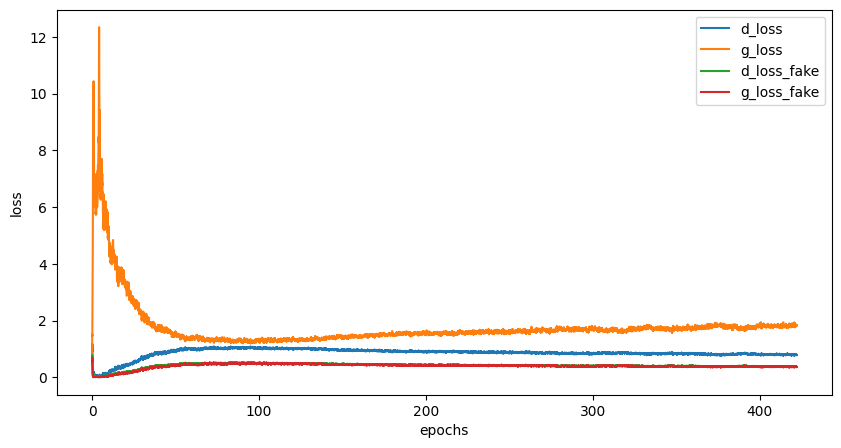

Epoch [423/500], Step[100/469], d_loss: 0.7255, d_loss_fake: 0.3894, g_loss: 1.8141, g_loss_fake: 0.3215, D(x): 0.78, D(G(z)): 0.24
Epoch [423/500], Step[200/469], d_loss: 0.8590, d_loss_fake: 0.3541, g_loss: 1.6951, g_loss_fake: 0.4143, D(x): 0.70, D(G(z)): 0.25
Epoch [423/500], Step[300/469], d_loss: 0.9112, d_loss_fake: 0.3309, g_loss: 1.7840, g_loss_fake: 0.3244, D(x): 0.69, D(G(z)): 0.23
Epoch [423/500], Step[400/469], d_loss: 0.7489, d_loss_fake: 0.3306, g_loss: 1.9664, g_loss_fake: 0.4325, D(x): 0.76, D(G(z)): 0.21


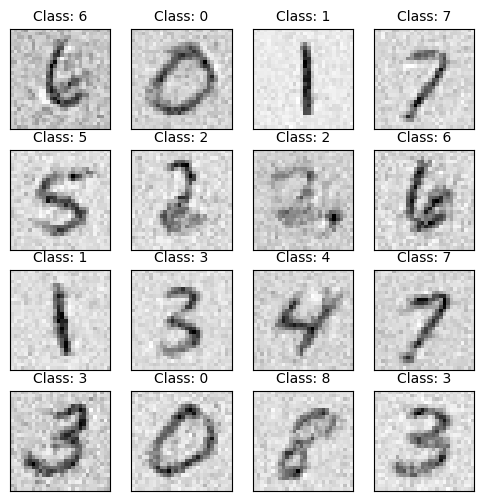

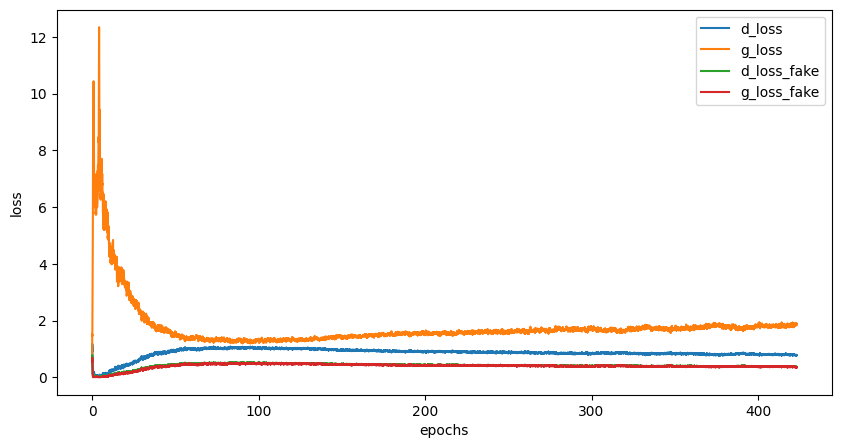

Epoch [424/500], Step[100/469], d_loss: 0.8421, d_loss_fake: 0.3548, g_loss: 1.9895, g_loss_fake: 0.4140, D(x): 0.73, D(G(z)): 0.24
Epoch [424/500], Step[200/469], d_loss: 0.8299, d_loss_fake: 0.3854, g_loss: 1.6213, g_loss_fake: 0.4391, D(x): 0.73, D(G(z)): 0.27
Epoch [424/500], Step[300/469], d_loss: 0.8330, d_loss_fake: 0.3726, g_loss: 1.8164, g_loss_fake: 0.3732, D(x): 0.70, D(G(z)): 0.25
Epoch [424/500], Step[400/469], d_loss: 0.7201, d_loss_fake: 0.2698, g_loss: 1.7852, g_loss_fake: 0.3290, D(x): 0.73, D(G(z)): 0.21


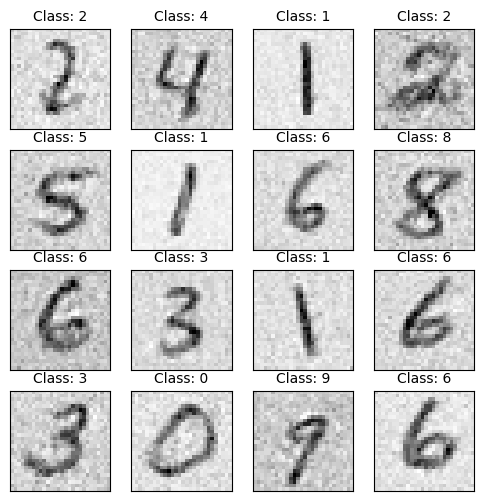

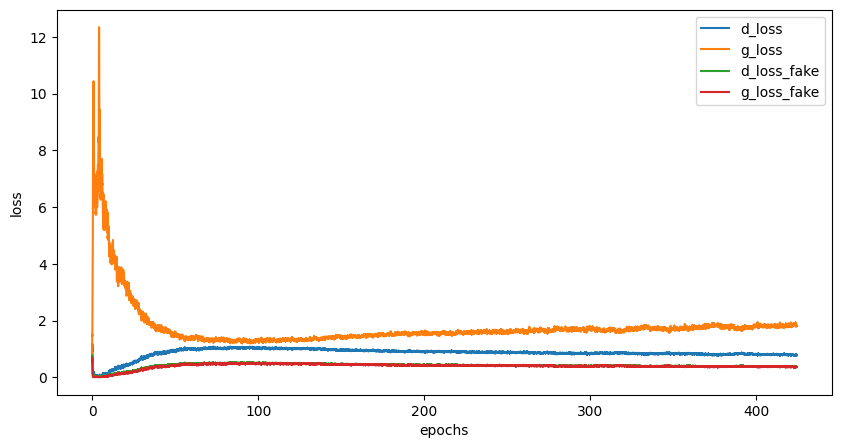

Epoch [425/500], Step[100/469], d_loss: 0.7043, d_loss_fake: 0.3779, g_loss: 1.8307, g_loss_fake: 0.3209, D(x): 0.80, D(G(z)): 0.26
Epoch [425/500], Step[200/469], d_loss: 0.9056, d_loss_fake: 0.3817, g_loss: 1.7047, g_loss_fake: 0.4158, D(x): 0.69, D(G(z)): 0.27
Epoch [425/500], Step[300/469], d_loss: 0.8155, d_loss_fake: 0.4139, g_loss: 1.6034, g_loss_fake: 0.4570, D(x): 0.76, D(G(z)): 0.29
Epoch [425/500], Step[400/469], d_loss: 0.7644, d_loss_fake: 0.3601, g_loss: 1.7747, g_loss_fake: 0.3594, D(x): 0.74, D(G(z)): 0.26


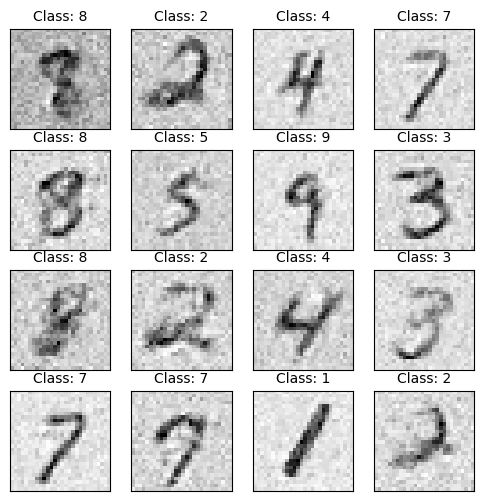

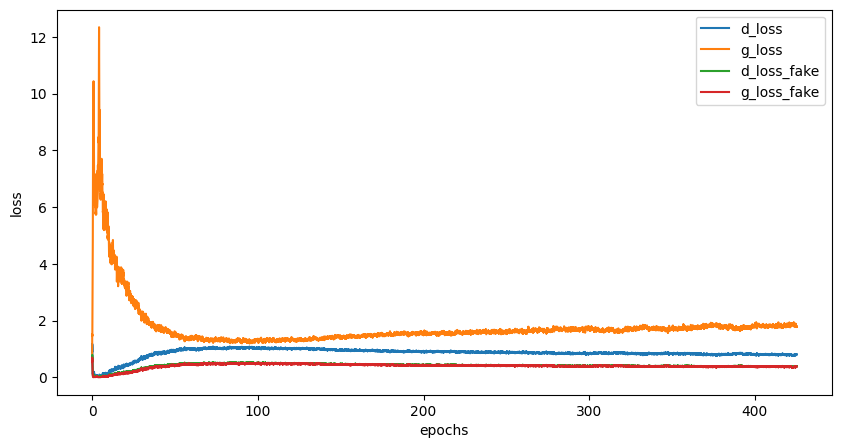

Epoch [426/500], Step[100/469], d_loss: 0.8474, d_loss_fake: 0.3788, g_loss: 1.7317, g_loss_fake: 0.4446, D(x): 0.73, D(G(z)): 0.26
Epoch [426/500], Step[200/469], d_loss: 0.7684, d_loss_fake: 0.3573, g_loss: 1.8518, g_loss_fake: 0.3265, D(x): 0.74, D(G(z)): 0.26
Epoch [426/500], Step[300/469], d_loss: 0.7284, d_loss_fake: 0.4450, g_loss: 1.7267, g_loss_fake: 0.4325, D(x): 0.81, D(G(z)): 0.28
Epoch [426/500], Step[400/469], d_loss: 0.8132, d_loss_fake: 0.3333, g_loss: 2.0055, g_loss_fake: 0.2942, D(x): 0.72, D(G(z)): 0.24


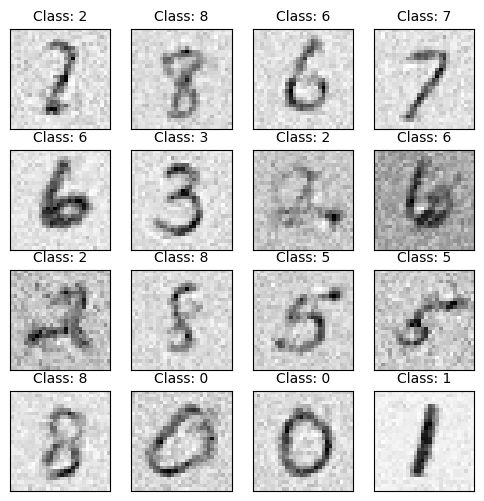

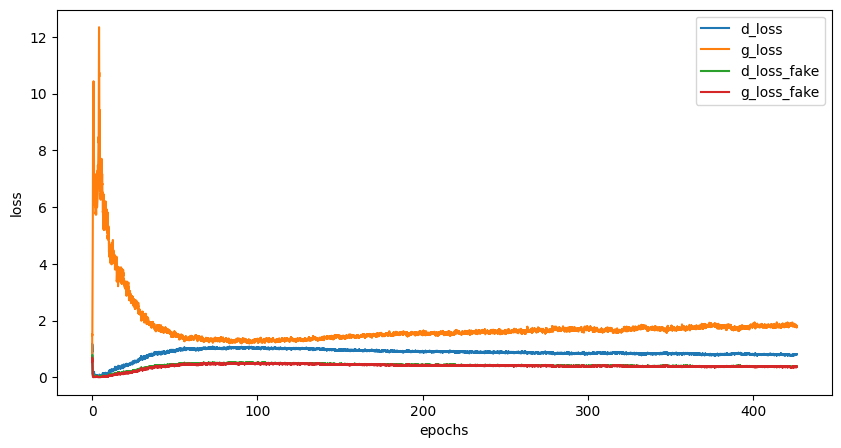

Epoch [427/500], Step[100/469], d_loss: 0.8469, d_loss_fake: 0.4124, g_loss: 1.9301, g_loss_fake: 0.3090, D(x): 0.73, D(G(z)): 0.27
Epoch [427/500], Step[200/469], d_loss: 0.7503, d_loss_fake: 0.3110, g_loss: 1.7768, g_loss_fake: 0.4227, D(x): 0.72, D(G(z)): 0.23
Epoch [427/500], Step[300/469], d_loss: 0.8208, d_loss_fake: 0.3958, g_loss: 1.8525, g_loss_fake: 0.4001, D(x): 0.73, D(G(z)): 0.27
Epoch [427/500], Step[400/469], d_loss: 0.7624, d_loss_fake: 0.3760, g_loss: 2.3639, g_loss_fake: 0.2479, D(x): 0.76, D(G(z)): 0.25


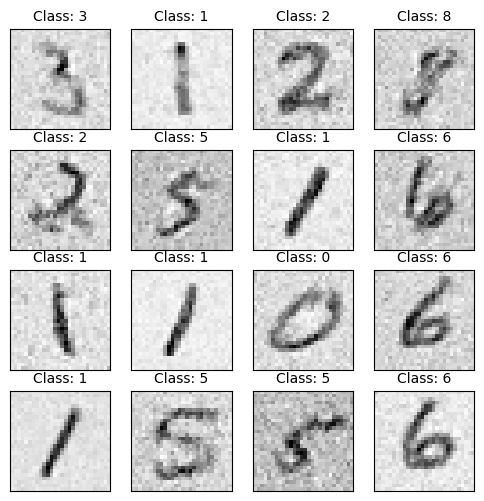

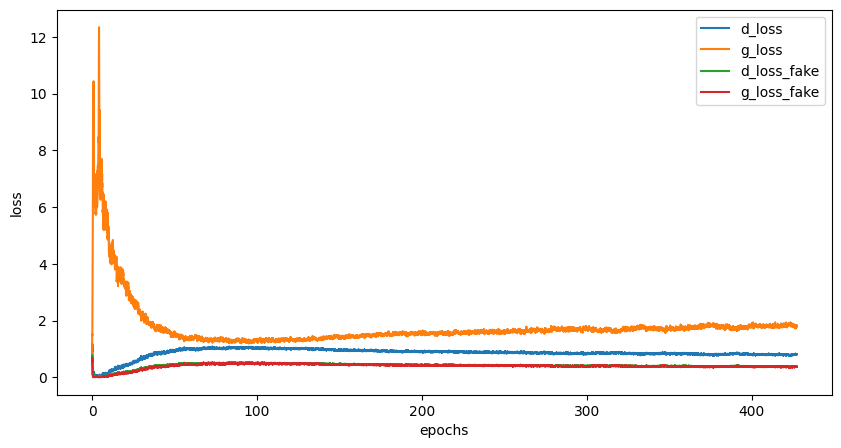

Epoch [428/500], Step[100/469], d_loss: 0.7826, d_loss_fake: 0.3969, g_loss: 1.6334, g_loss_fake: 0.3951, D(x): 0.76, D(G(z)): 0.28
Epoch [428/500], Step[200/469], d_loss: 0.7384, d_loss_fake: 0.2963, g_loss: 1.6769, g_loss_fake: 0.4278, D(x): 0.74, D(G(z)): 0.22
Epoch [428/500], Step[300/469], d_loss: 0.8365, d_loss_fake: 0.3798, g_loss: 1.6705, g_loss_fake: 0.4239, D(x): 0.72, D(G(z)): 0.27
Epoch [428/500], Step[400/469], d_loss: 0.7876, d_loss_fake: 0.4528, g_loss: 1.6365, g_loss_fake: 0.4134, D(x): 0.79, D(G(z)): 0.28


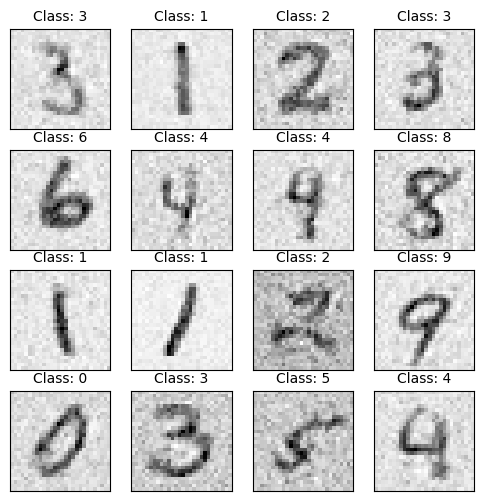

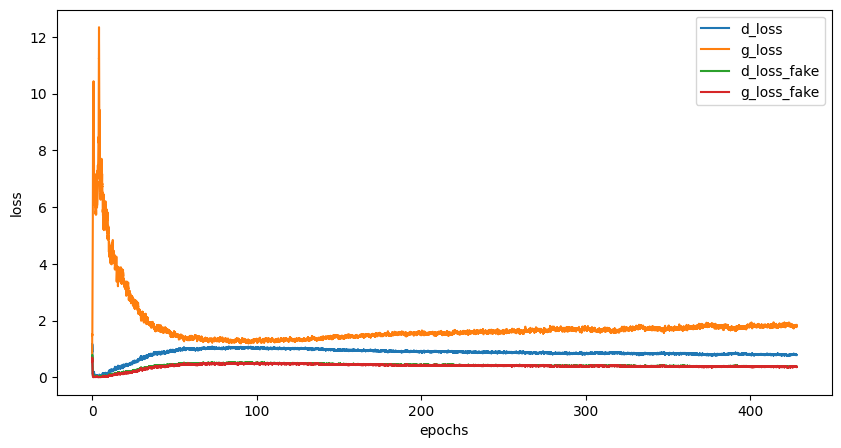

Epoch [429/500], Step[100/469], d_loss: 0.6945, d_loss_fake: 0.3382, g_loss: 2.0646, g_loss_fake: 0.2739, D(x): 0.80, D(G(z)): 0.23
Epoch [429/500], Step[200/469], d_loss: 0.8012, d_loss_fake: 0.3072, g_loss: 2.1110, g_loss_fake: 0.2569, D(x): 0.72, D(G(z)): 0.23
Epoch [429/500], Step[300/469], d_loss: 0.8647, d_loss_fake: 0.4262, g_loss: 1.6819, g_loss_fake: 0.4129, D(x): 0.73, D(G(z)): 0.29
Epoch [429/500], Step[400/469], d_loss: 0.8065, d_loss_fake: 0.3524, g_loss: 1.7142, g_loss_fake: 0.3760, D(x): 0.73, D(G(z)): 0.25


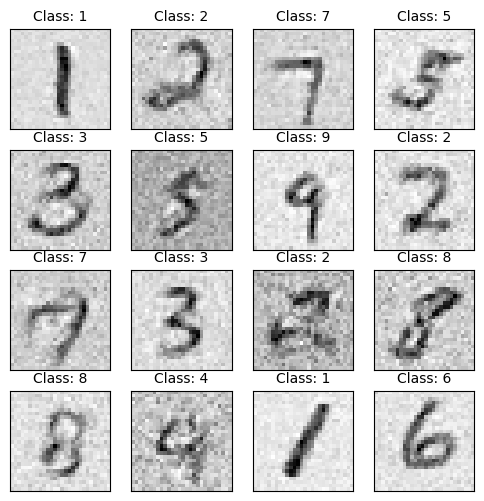

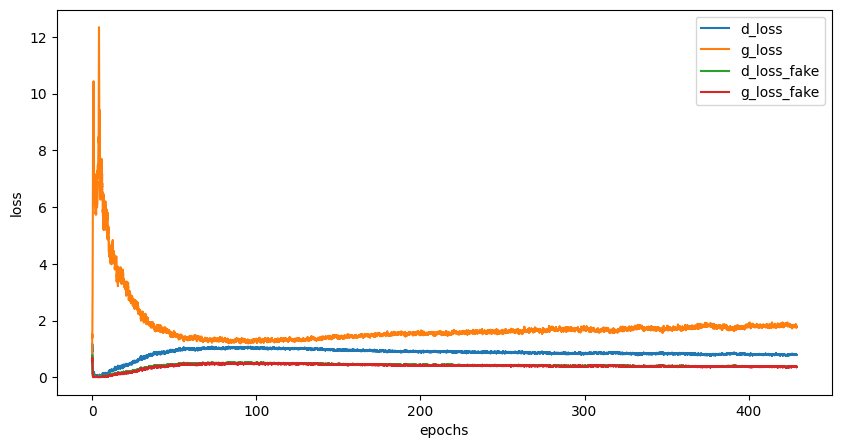

Epoch [430/500], Step[100/469], d_loss: 0.8396, d_loss_fake: 0.3655, g_loss: 1.7980, g_loss_fake: 0.3768, D(x): 0.71, D(G(z)): 0.23
Epoch [430/500], Step[200/469], d_loss: 0.9072, d_loss_fake: 0.3706, g_loss: 1.6320, g_loss_fake: 0.4494, D(x): 0.71, D(G(z)): 0.26
Epoch [430/500], Step[300/469], d_loss: 0.7528, d_loss_fake: 0.4093, g_loss: 1.5528, g_loss_fake: 0.4753, D(x): 0.77, D(G(z)): 0.27
Epoch [430/500], Step[400/469], d_loss: 0.7655, d_loss_fake: 0.3820, g_loss: 1.9281, g_loss_fake: 0.2732, D(x): 0.76, D(G(z)): 0.24


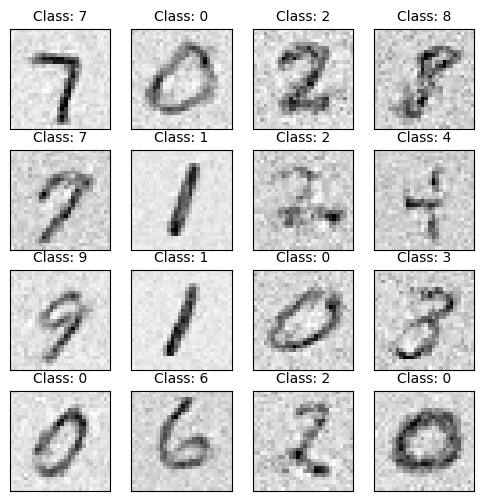

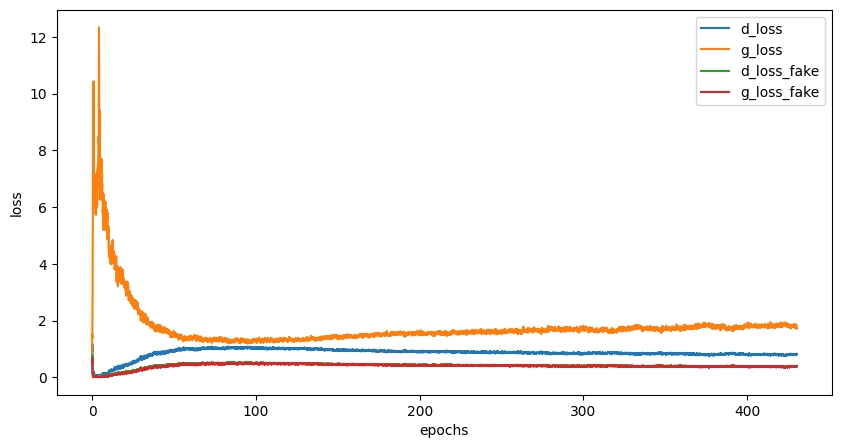

Epoch [431/500], Step[100/469], d_loss: 0.7490, d_loss_fake: 0.4350, g_loss: 1.6248, g_loss_fake: 0.4229, D(x): 0.79, D(G(z)): 0.29
Epoch [431/500], Step[200/469], d_loss: 0.7502, d_loss_fake: 0.3390, g_loss: 1.7305, g_loss_fake: 0.3263, D(x): 0.73, D(G(z)): 0.25
Epoch [431/500], Step[300/469], d_loss: 0.8098, d_loss_fake: 0.3318, g_loss: 1.8119, g_loss_fake: 0.3587, D(x): 0.72, D(G(z)): 0.24
Epoch [431/500], Step[400/469], d_loss: 0.9334, d_loss_fake: 0.4228, g_loss: 2.0985, g_loss_fake: 0.3705, D(x): 0.69, D(G(z)): 0.28


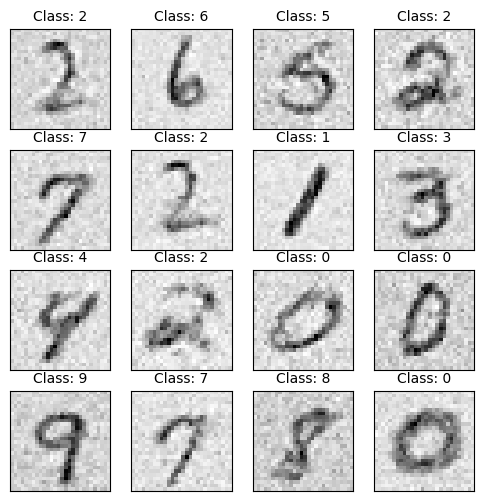

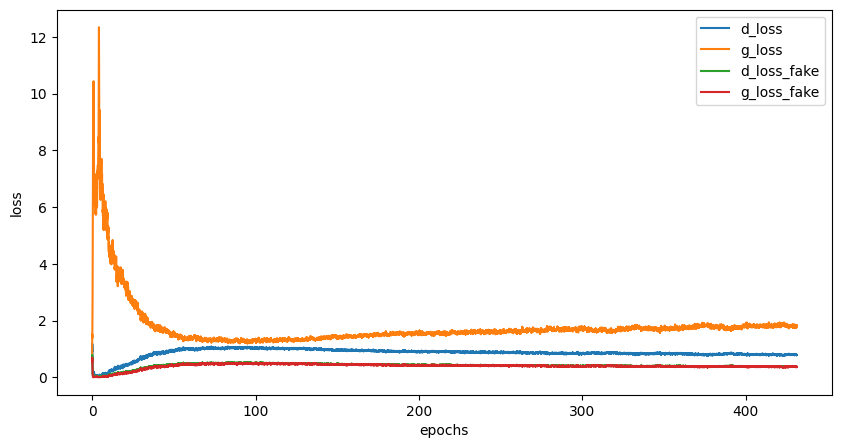

Epoch [432/500], Step[100/469], d_loss: 0.7524, d_loss_fake: 0.3455, g_loss: 2.1683, g_loss_fake: 0.3501, D(x): 0.75, D(G(z)): 0.23
Epoch [432/500], Step[200/469], d_loss: 0.7537, d_loss_fake: 0.2962, g_loss: 1.8873, g_loss_fake: 0.3260, D(x): 0.72, D(G(z)): 0.22
Epoch [432/500], Step[300/469], d_loss: 0.8059, d_loss_fake: 0.3776, g_loss: 1.7600, g_loss_fake: 0.3747, D(x): 0.74, D(G(z)): 0.27
Epoch [432/500], Step[400/469], d_loss: 0.7057, d_loss_fake: 0.3209, g_loss: 1.8607, g_loss_fake: 0.4004, D(x): 0.76, D(G(z)): 0.23


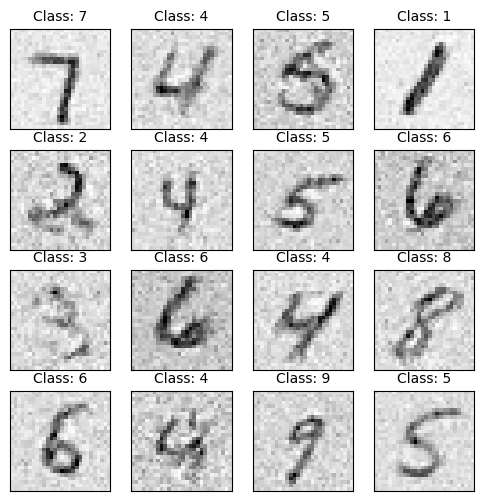

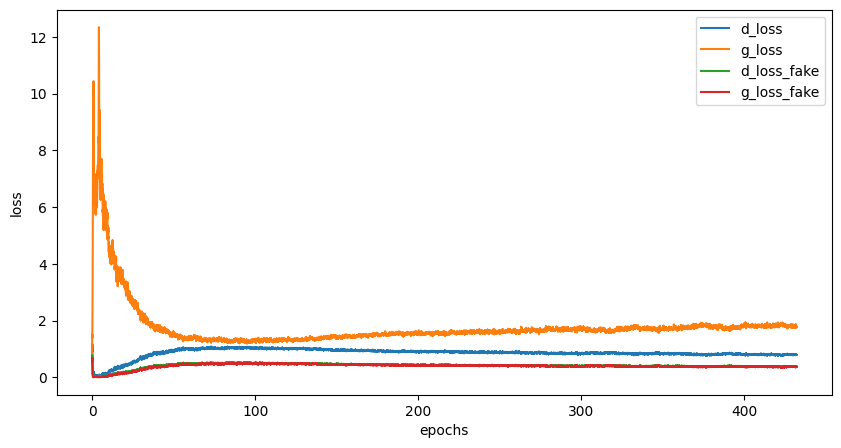

Epoch [433/500], Step[100/469], d_loss: 0.7657, d_loss_fake: 0.3670, g_loss: 1.5810, g_loss_fake: 0.3866, D(x): 0.75, D(G(z)): 0.25
Epoch [433/500], Step[200/469], d_loss: 0.8222, d_loss_fake: 0.4420, g_loss: 1.7121, g_loss_fake: 0.3603, D(x): 0.76, D(G(z)): 0.29
Epoch [433/500], Step[300/469], d_loss: 0.7605, d_loss_fake: 0.3033, g_loss: 2.2511, g_loss_fake: 0.3622, D(x): 0.73, D(G(z)): 0.21
Epoch [433/500], Step[400/469], d_loss: 0.8679, d_loss_fake: 0.3708, g_loss: 1.9862, g_loss_fake: 0.3523, D(x): 0.71, D(G(z)): 0.25


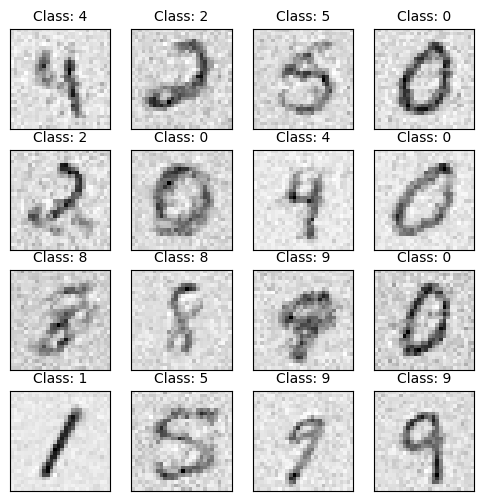

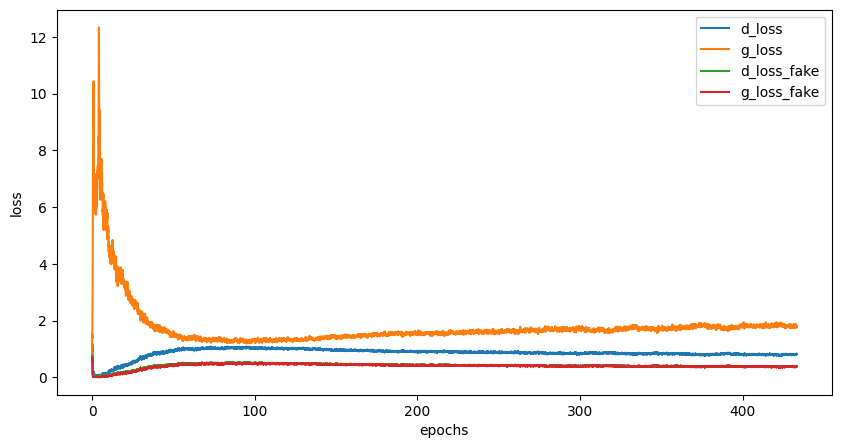

Epoch [434/500], Step[100/469], d_loss: 0.8759, d_loss_fake: 0.4253, g_loss: 1.9923, g_loss_fake: 0.2692, D(x): 0.72, D(G(z)): 0.27
Epoch [434/500], Step[200/469], d_loss: 0.7127, d_loss_fake: 0.3617, g_loss: 1.7013, g_loss_fake: 0.3778, D(x): 0.76, D(G(z)): 0.26
Epoch [434/500], Step[300/469], d_loss: 0.8237, d_loss_fake: 0.4366, g_loss: 1.6083, g_loss_fake: 0.4339, D(x): 0.76, D(G(z)): 0.29
Epoch [434/500], Step[400/469], d_loss: 0.7259, d_loss_fake: 0.3944, g_loss: 1.6155, g_loss_fake: 0.3996, D(x): 0.78, D(G(z)): 0.27


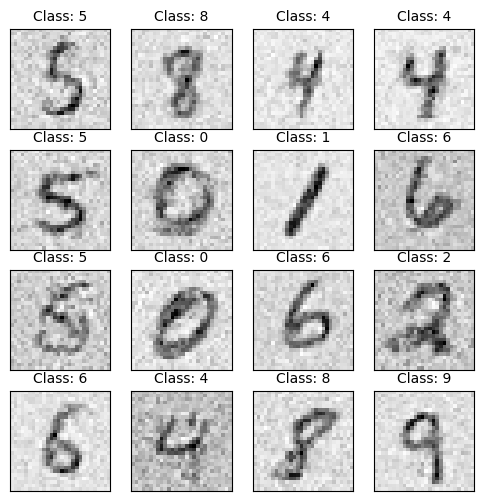

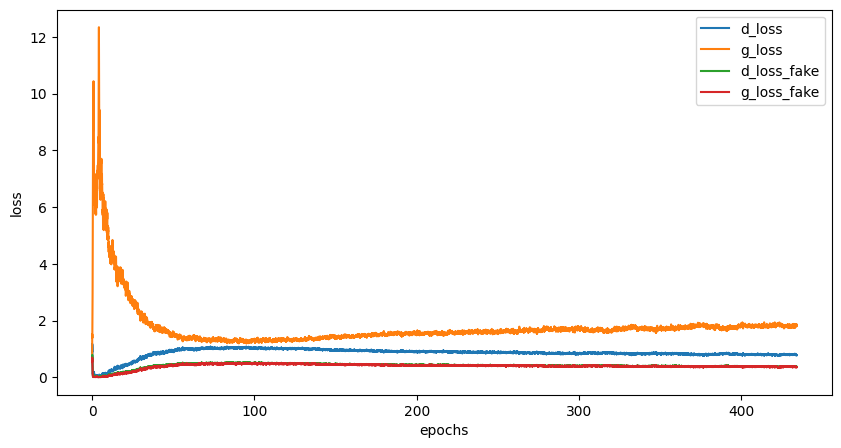

Epoch [435/500], Step[100/469], d_loss: 0.8099, d_loss_fake: 0.4248, g_loss: 1.7616, g_loss_fake: 0.3914, D(x): 0.76, D(G(z)): 0.27
Epoch [435/500], Step[200/469], d_loss: 0.8613, d_loss_fake: 0.3839, g_loss: 1.9411, g_loss_fake: 0.3393, D(x): 0.72, D(G(z)): 0.26
Epoch [435/500], Step[300/469], d_loss: 0.7472, d_loss_fake: 0.4131, g_loss: 1.9344, g_loss_fake: 0.2744, D(x): 0.78, D(G(z)): 0.27
Epoch [435/500], Step[400/469], d_loss: 0.8076, d_loss_fake: 0.3031, g_loss: 1.7824, g_loss_fake: 0.3604, D(x): 0.69, D(G(z)): 0.22


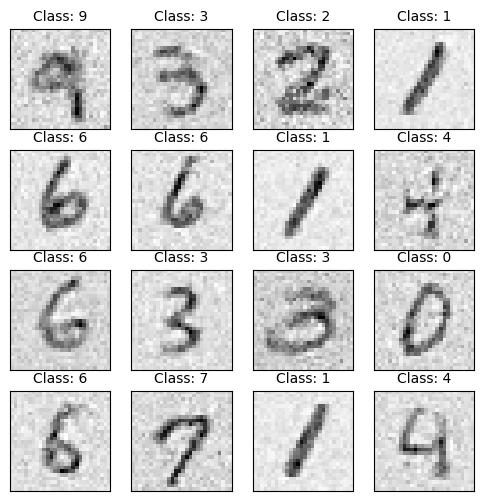

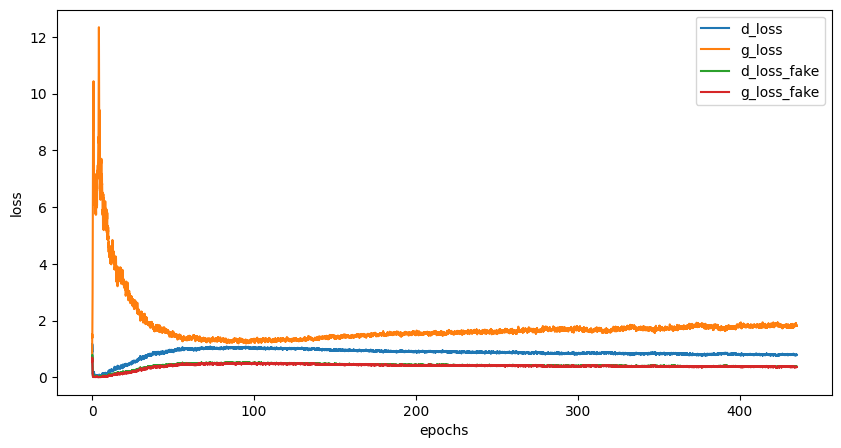

Epoch [436/500], Step[100/469], d_loss: 0.8095, d_loss_fake: 0.3545, g_loss: 2.0360, g_loss_fake: 0.3199, D(x): 0.73, D(G(z)): 0.24
Epoch [436/500], Step[200/469], d_loss: 0.8949, d_loss_fake: 0.4579, g_loss: 1.6689, g_loss_fake: 0.4290, D(x): 0.72, D(G(z)): 0.29
Epoch [436/500], Step[300/469], d_loss: 0.8253, d_loss_fake: 0.3637, g_loss: 1.7452, g_loss_fake: 0.3883, D(x): 0.73, D(G(z)): 0.25
Epoch [436/500], Step[400/469], d_loss: 0.7900, d_loss_fake: 0.3612, g_loss: 1.7875, g_loss_fake: 0.4132, D(x): 0.73, D(G(z)): 0.27


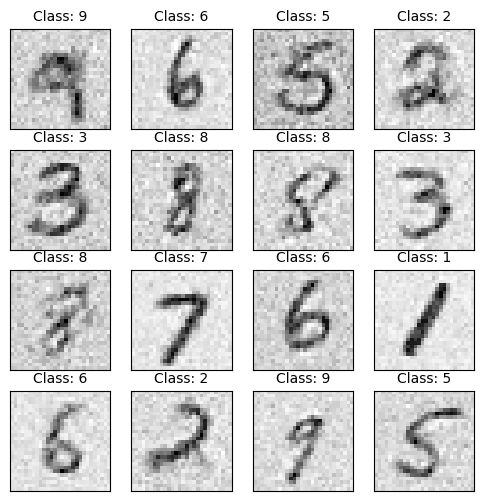

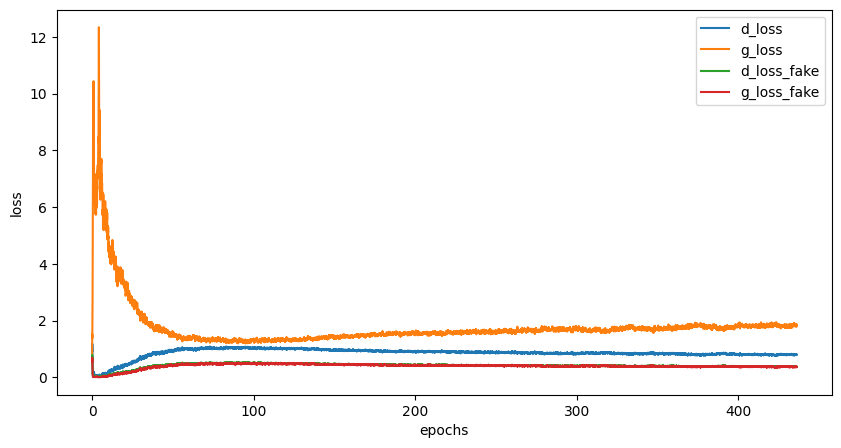

Epoch [437/500], Step[100/469], d_loss: 0.7691, d_loss_fake: 0.3064, g_loss: 1.9099, g_loss_fake: 0.3150, D(x): 0.72, D(G(z)): 0.23
Epoch [437/500], Step[200/469], d_loss: 0.8208, d_loss_fake: 0.3815, g_loss: 1.8774, g_loss_fake: 0.3105, D(x): 0.73, D(G(z)): 0.25
Epoch [437/500], Step[300/469], d_loss: 0.8036, d_loss_fake: 0.3452, g_loss: 1.9265, g_loss_fake: 0.3453, D(x): 0.73, D(G(z)): 0.24
Epoch [437/500], Step[400/469], d_loss: 0.8723, d_loss_fake: 0.4104, g_loss: 1.8044, g_loss_fake: 0.3233, D(x): 0.71, D(G(z)): 0.27


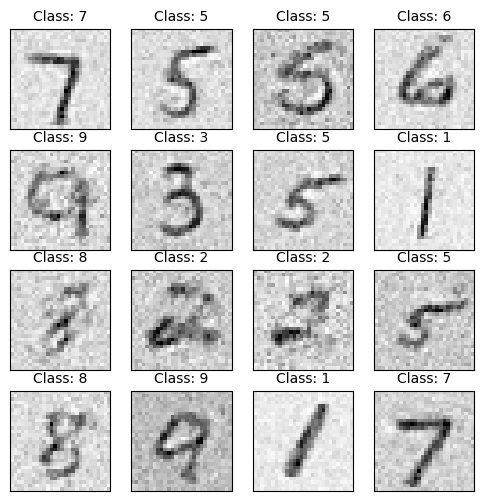

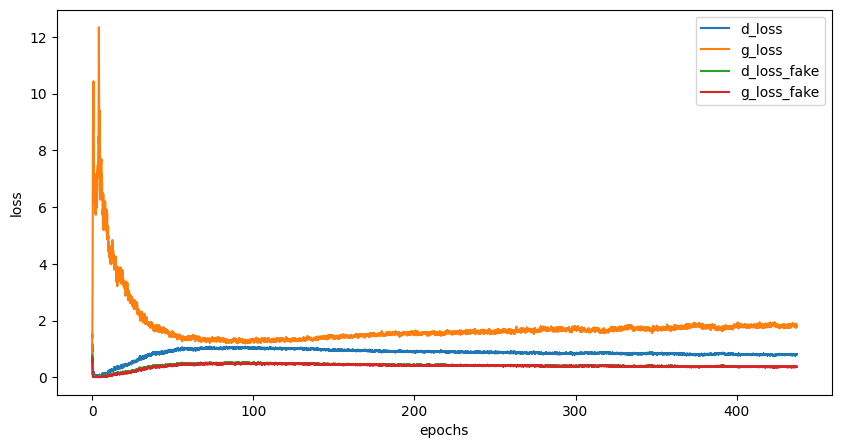

Epoch [438/500], Step[100/469], d_loss: 0.8031, d_loss_fake: 0.3715, g_loss: 2.0103, g_loss_fake: 0.2528, D(x): 0.73, D(G(z)): 0.25
Epoch [438/500], Step[200/469], d_loss: 0.8581, d_loss_fake: 0.4608, g_loss: 1.6899, g_loss_fake: 0.4656, D(x): 0.75, D(G(z)): 0.30
Epoch [438/500], Step[300/469], d_loss: 0.8705, d_loss_fake: 0.5010, g_loss: 1.7491, g_loss_fake: 0.4420, D(x): 0.76, D(G(z)): 0.33
Epoch [438/500], Step[400/469], d_loss: 0.8995, d_loss_fake: 0.4449, g_loss: 1.6682, g_loss_fake: 0.3371, D(x): 0.71, D(G(z)): 0.29


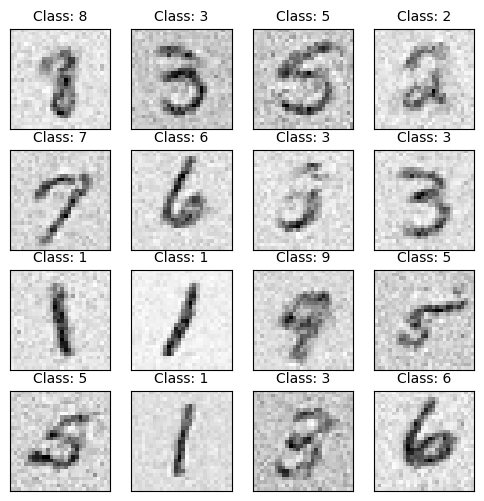

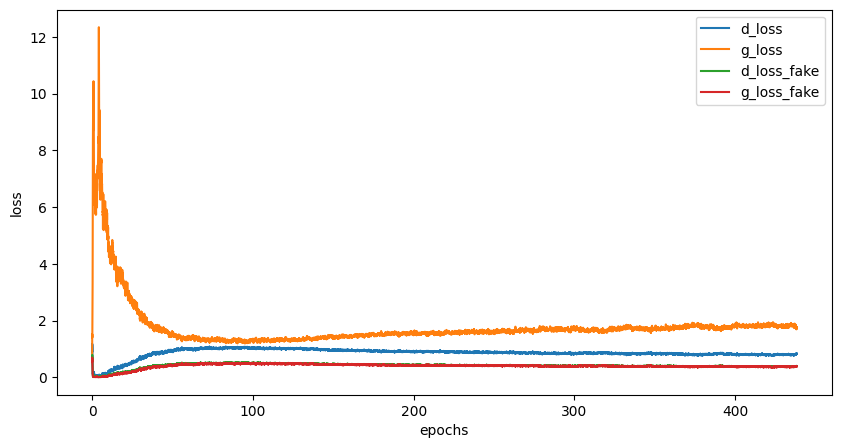

Epoch [439/500], Step[100/469], d_loss: 0.7985, d_loss_fake: 0.4201, g_loss: 1.8275, g_loss_fake: 0.3877, D(x): 0.75, D(G(z)): 0.29
Epoch [439/500], Step[200/469], d_loss: 0.7847, d_loss_fake: 0.3552, g_loss: 1.7427, g_loss_fake: 0.3476, D(x): 0.73, D(G(z)): 0.26
Epoch [439/500], Step[300/469], d_loss: 0.8054, d_loss_fake: 0.3821, g_loss: 1.7996, g_loss_fake: 0.4821, D(x): 0.75, D(G(z)): 0.25
Epoch [439/500], Step[400/469], d_loss: 0.8016, d_loss_fake: 0.3798, g_loss: 1.8341, g_loss_fake: 0.3541, D(x): 0.76, D(G(z)): 0.27


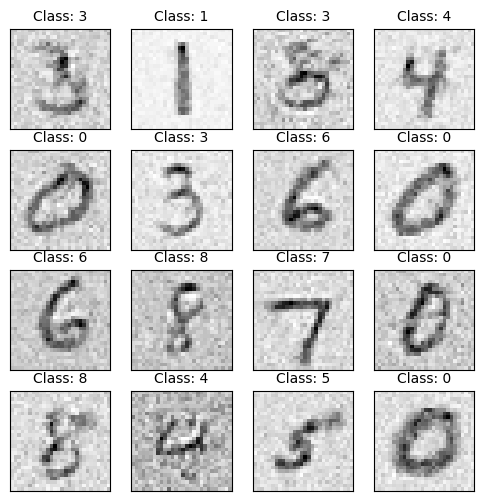

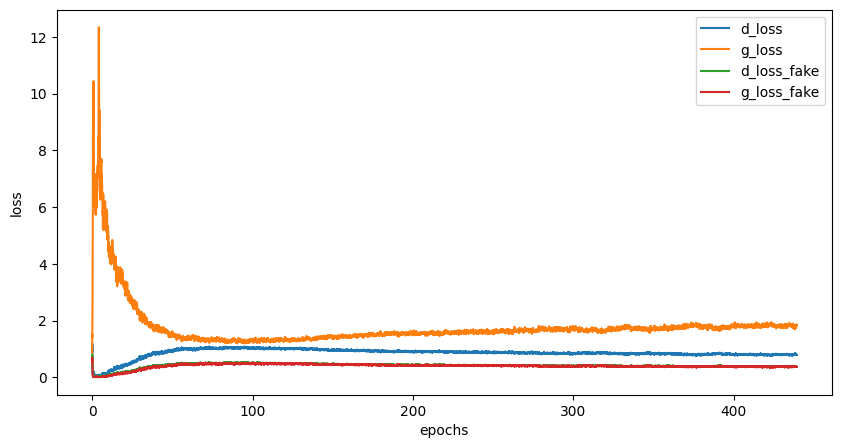

Epoch [440/500], Step[100/469], d_loss: 0.7687, d_loss_fake: 0.3712, g_loss: 1.7233, g_loss_fake: 0.3904, D(x): 0.75, D(G(z)): 0.26
Epoch [440/500], Step[200/469], d_loss: 0.8019, d_loss_fake: 0.4024, g_loss: 1.9485, g_loss_fake: 0.2915, D(x): 0.75, D(G(z)): 0.27
Epoch [440/500], Step[300/469], d_loss: 0.8209, d_loss_fake: 0.4002, g_loss: 1.6965, g_loss_fake: 0.4441, D(x): 0.73, D(G(z)): 0.26
Epoch [440/500], Step[400/469], d_loss: 0.8801, d_loss_fake: 0.3876, g_loss: 1.7383, g_loss_fake: 0.4218, D(x): 0.71, D(G(z)): 0.26


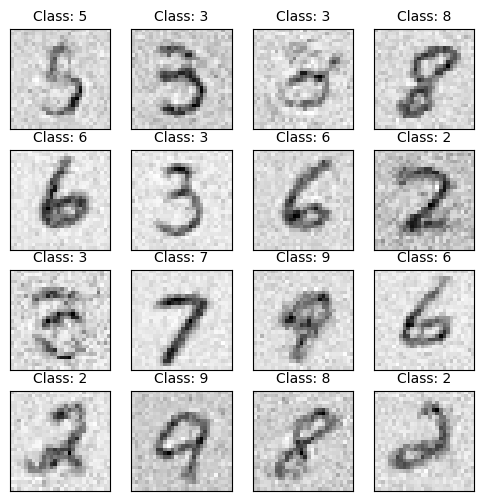

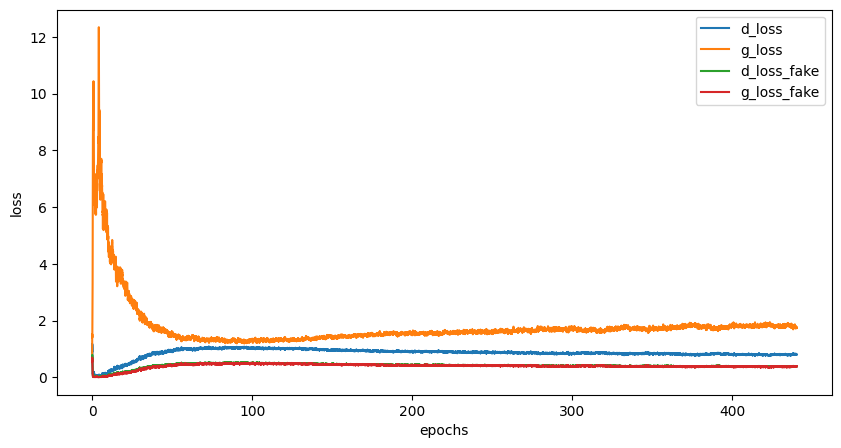

Epoch [441/500], Step[100/469], d_loss: 0.8189, d_loss_fake: 0.4234, g_loss: 1.7506, g_loss_fake: 0.3796, D(x): 0.77, D(G(z)): 0.28
Epoch [441/500], Step[200/469], d_loss: 0.8067, d_loss_fake: 0.3442, g_loss: 1.8426, g_loss_fake: 0.3625, D(x): 0.73, D(G(z)): 0.24
Epoch [441/500], Step[300/469], d_loss: 0.6476, d_loss_fake: 0.3689, g_loss: 1.7093, g_loss_fake: 0.4384, D(x): 0.81, D(G(z)): 0.25
Epoch [441/500], Step[400/469], d_loss: 0.7978, d_loss_fake: 0.3292, g_loss: 1.8730, g_loss_fake: 0.3319, D(x): 0.72, D(G(z)): 0.24


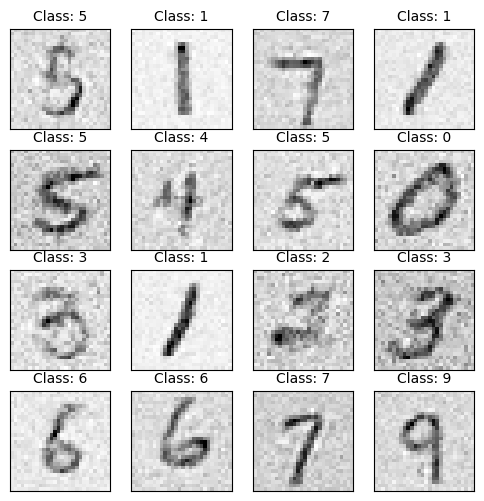

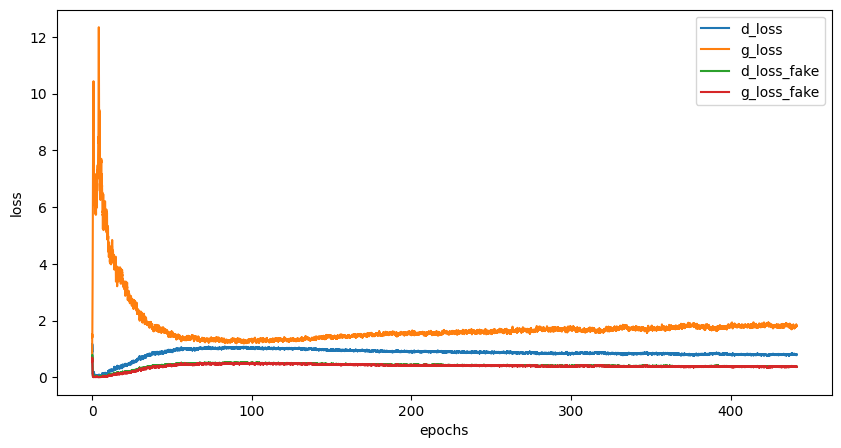

Epoch [442/500], Step[100/469], d_loss: 0.8829, d_loss_fake: 0.3616, g_loss: 1.7632, g_loss_fake: 0.3311, D(x): 0.70, D(G(z)): 0.25
Epoch [442/500], Step[200/469], d_loss: 0.8538, d_loss_fake: 0.4725, g_loss: 2.0776, g_loss_fake: 0.3551, D(x): 0.78, D(G(z)): 0.31
Epoch [442/500], Step[300/469], d_loss: 0.8516, d_loss_fake: 0.3813, g_loss: 1.7553, g_loss_fake: 0.4037, D(x): 0.71, D(G(z)): 0.25
Epoch [442/500], Step[400/469], d_loss: 0.7603, d_loss_fake: 0.3130, g_loss: 2.3369, g_loss_fake: 0.2539, D(x): 0.71, D(G(z)): 0.22


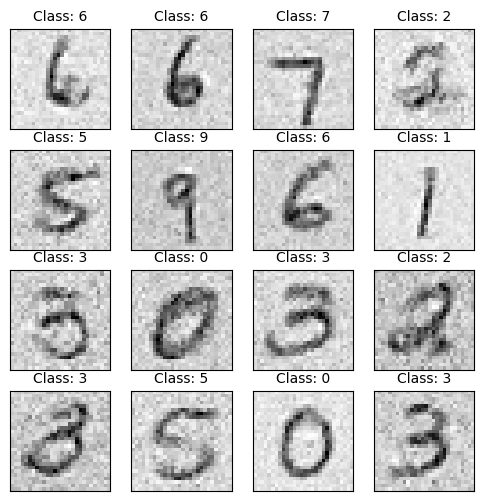

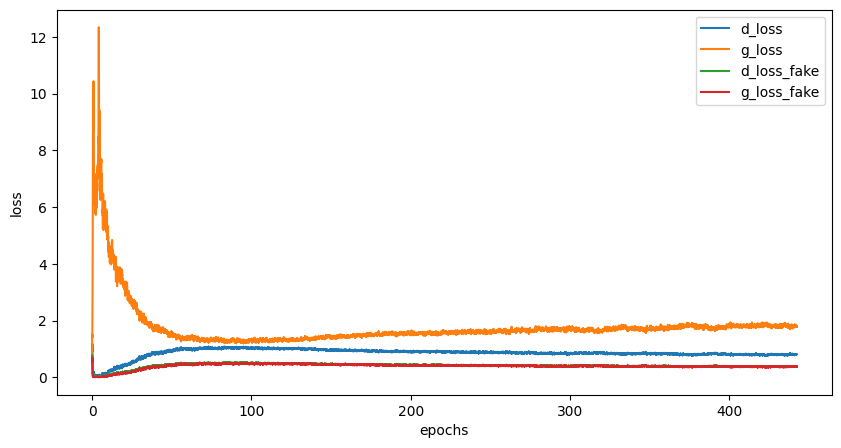

Epoch [443/500], Step[100/469], d_loss: 0.8249, d_loss_fake: 0.3848, g_loss: 1.7240, g_loss_fake: 0.3544, D(x): 0.73, D(G(z)): 0.28
Epoch [443/500], Step[200/469], d_loss: 0.8527, d_loss_fake: 0.3828, g_loss: 1.7573, g_loss_fake: 0.4032, D(x): 0.71, D(G(z)): 0.26
Epoch [443/500], Step[300/469], d_loss: 0.8987, d_loss_fake: 0.4192, g_loss: 1.7685, g_loss_fake: 0.3880, D(x): 0.74, D(G(z)): 0.26
Epoch [443/500], Step[400/469], d_loss: 0.8346, d_loss_fake: 0.3383, g_loss: 1.8344, g_loss_fake: 0.3601, D(x): 0.71, D(G(z)): 0.24


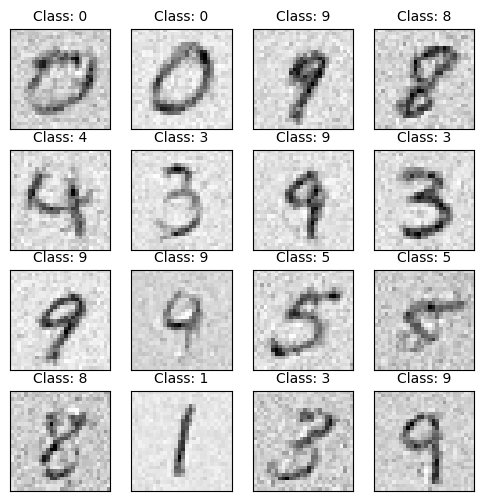

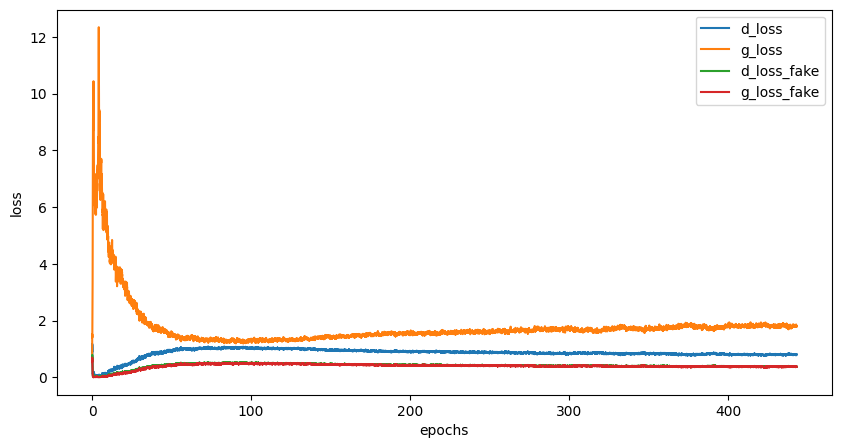

Epoch [444/500], Step[100/469], d_loss: 0.8498, d_loss_fake: 0.4280, g_loss: 1.7273, g_loss_fake: 0.3781, D(x): 0.73, D(G(z)): 0.29
Epoch [444/500], Step[200/469], d_loss: 0.7966, d_loss_fake: 0.4089, g_loss: 1.9322, g_loss_fake: 0.3249, D(x): 0.77, D(G(z)): 0.27
Epoch [444/500], Step[300/469], d_loss: 0.8411, d_loss_fake: 0.2927, g_loss: 2.2203, g_loss_fake: 0.2635, D(x): 0.70, D(G(z)): 0.20
Epoch [444/500], Step[400/469], d_loss: 0.7650, d_loss_fake: 0.2963, g_loss: 1.8322, g_loss_fake: 0.4245, D(x): 0.73, D(G(z)): 0.23


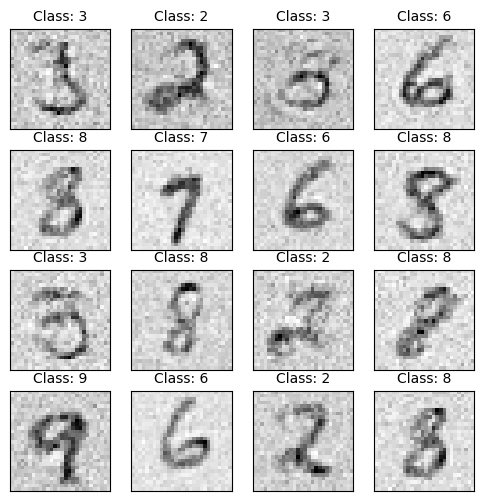

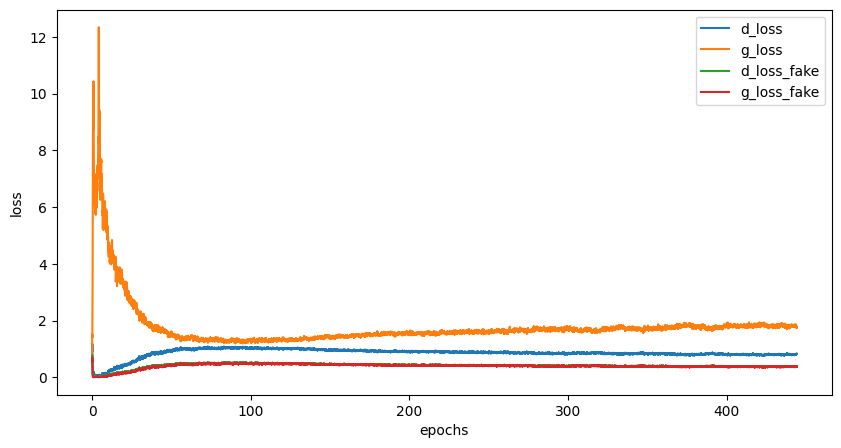

Epoch [445/500], Step[100/469], d_loss: 0.8239, d_loss_fake: 0.4072, g_loss: 1.7758, g_loss_fake: 0.3402, D(x): 0.74, D(G(z)): 0.27
Epoch [445/500], Step[200/469], d_loss: 0.8147, d_loss_fake: 0.3973, g_loss: 1.7232, g_loss_fake: 0.3740, D(x): 0.75, D(G(z)): 0.27
Epoch [445/500], Step[300/469], d_loss: 0.8242, d_loss_fake: 0.4246, g_loss: 1.5417, g_loss_fake: 0.4125, D(x): 0.74, D(G(z)): 0.29
Epoch [445/500], Step[400/469], d_loss: 0.8694, d_loss_fake: 0.4357, g_loss: 1.8035, g_loss_fake: 0.3818, D(x): 0.72, D(G(z)): 0.29


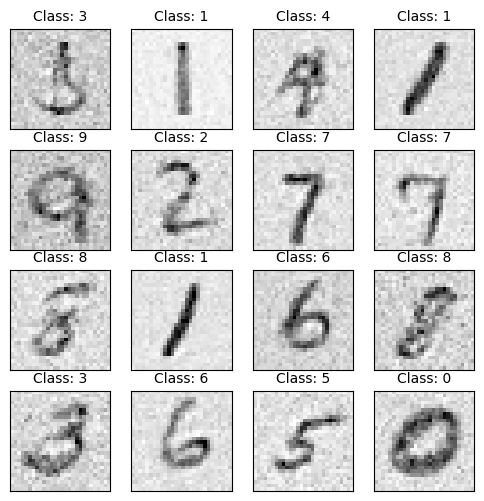

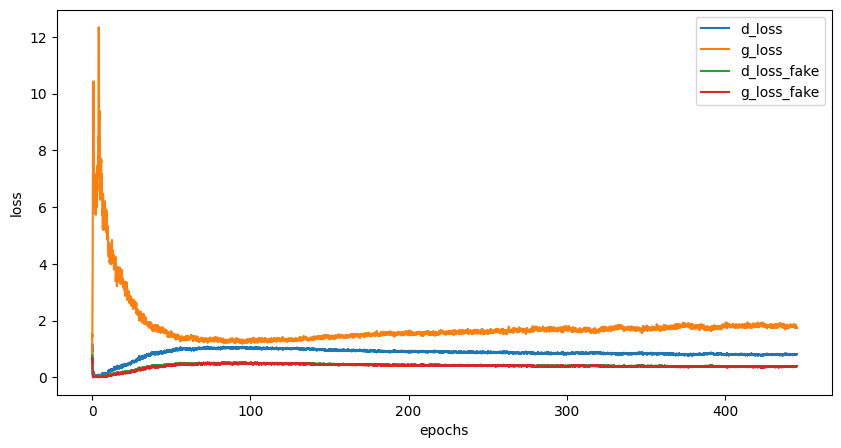

Epoch [446/500], Step[100/469], d_loss: 0.9216, d_loss_fake: 0.3685, g_loss: 1.9775, g_loss_fake: 0.3289, D(x): 0.69, D(G(z)): 0.24
Epoch [446/500], Step[200/469], d_loss: 0.8292, d_loss_fake: 0.3584, g_loss: 1.6751, g_loss_fake: 0.4695, D(x): 0.72, D(G(z)): 0.25
Epoch [446/500], Step[300/469], d_loss: 0.7465, d_loss_fake: 0.3749, g_loss: 1.7438, g_loss_fake: 0.3814, D(x): 0.78, D(G(z)): 0.25
Epoch [446/500], Step[400/469], d_loss: 0.9164, d_loss_fake: 0.4821, g_loss: 1.8981, g_loss_fake: 0.2899, D(x): 0.75, D(G(z)): 0.31


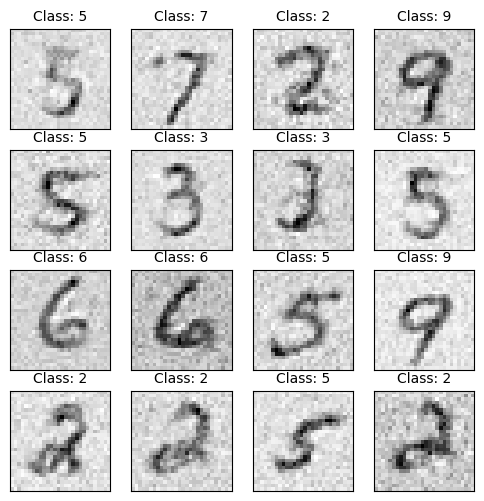

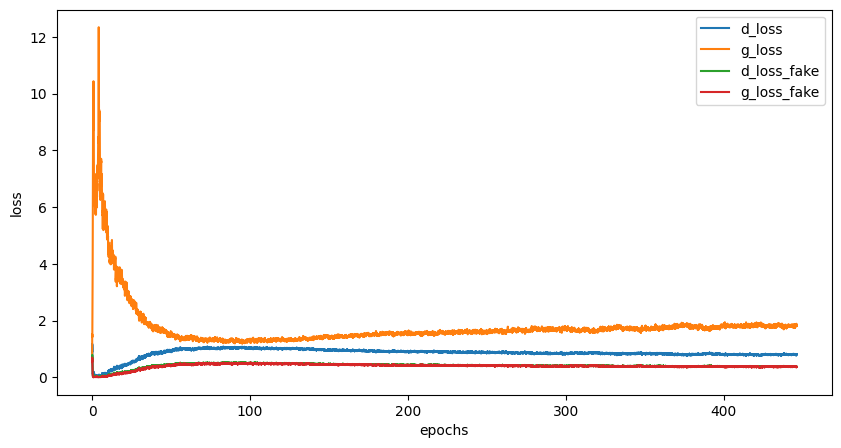

Epoch [447/500], Step[100/469], d_loss: 0.7734, d_loss_fake: 0.3623, g_loss: 1.7553, g_loss_fake: 0.3793, D(x): 0.74, D(G(z)): 0.26
Epoch [447/500], Step[200/469], d_loss: 0.7136, d_loss_fake: 0.3476, g_loss: 1.6223, g_loss_fake: 0.4243, D(x): 0.76, D(G(z)): 0.26
Epoch [447/500], Step[300/469], d_loss: 0.6895, d_loss_fake: 0.2981, g_loss: 2.0508, g_loss_fake: 0.2984, D(x): 0.77, D(G(z)): 0.22
Epoch [447/500], Step[400/469], d_loss: 0.7999, d_loss_fake: 0.3587, g_loss: 2.0263, g_loss_fake: 0.2846, D(x): 0.73, D(G(z)): 0.25


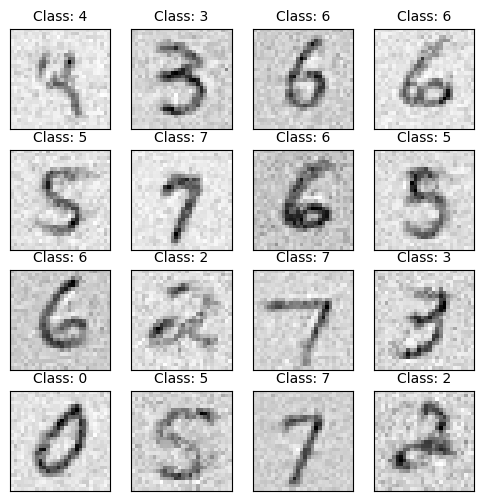

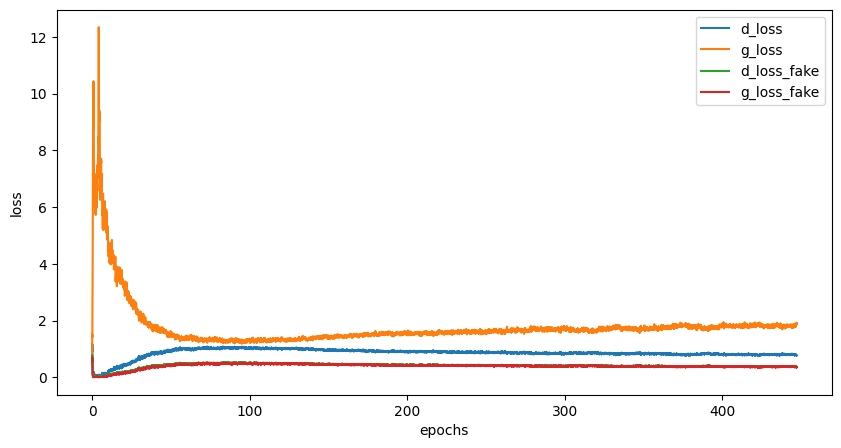

Epoch [448/500], Step[100/469], d_loss: 0.9185, d_loss_fake: 0.3730, g_loss: 1.8630, g_loss_fake: 0.3948, D(x): 0.70, D(G(z)): 0.27
Epoch [448/500], Step[200/469], d_loss: 0.7775, d_loss_fake: 0.3621, g_loss: 1.5250, g_loss_fake: 0.4647, D(x): 0.75, D(G(z)): 0.25
Epoch [448/500], Step[300/469], d_loss: 0.8691, d_loss_fake: 0.4102, g_loss: 1.6581, g_loss_fake: 0.4252, D(x): 0.74, D(G(z)): 0.28
Epoch [448/500], Step[400/469], d_loss: 0.7967, d_loss_fake: 0.2975, g_loss: 1.9674, g_loss_fake: 0.3787, D(x): 0.71, D(G(z)): 0.23


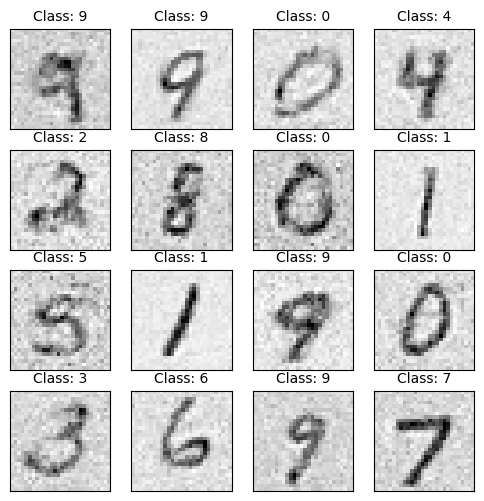

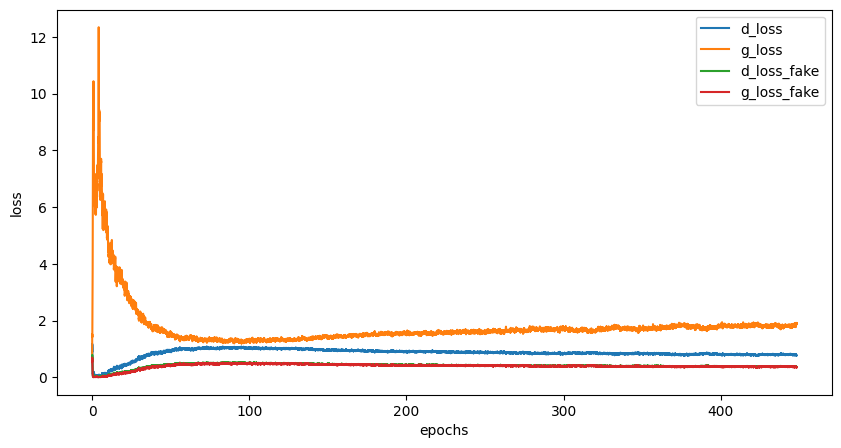

Epoch [449/500], Step[100/469], d_loss: 0.8533, d_loss_fake: 0.3292, g_loss: 1.9355, g_loss_fake: 0.3536, D(x): 0.71, D(G(z)): 0.23
Epoch [449/500], Step[200/469], d_loss: 0.7232, d_loss_fake: 0.3422, g_loss: 1.9385, g_loss_fake: 0.3881, D(x): 0.75, D(G(z)): 0.23
Epoch [449/500], Step[300/469], d_loss: 0.7462, d_loss_fake: 0.4269, g_loss: 1.6823, g_loss_fake: 0.4217, D(x): 0.78, D(G(z)): 0.28
Epoch [449/500], Step[400/469], d_loss: 0.8179, d_loss_fake: 0.3825, g_loss: 1.7763, g_loss_fake: 0.3337, D(x): 0.74, D(G(z)): 0.27


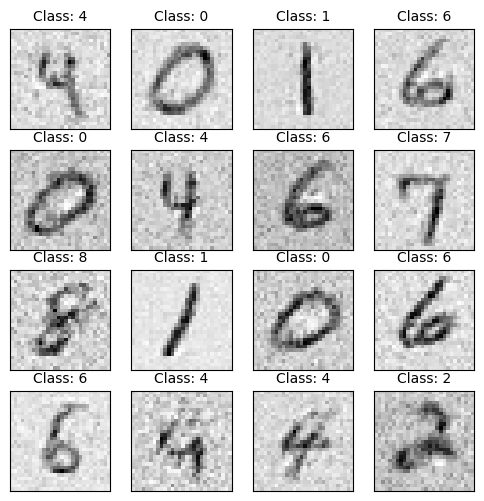

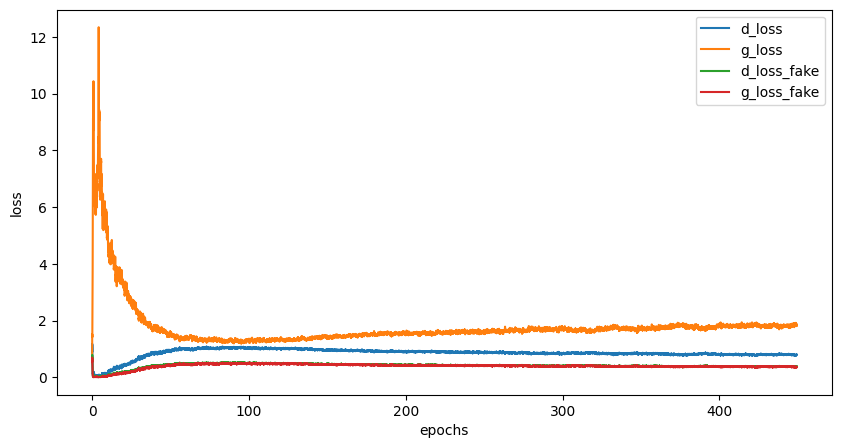

Epoch [450/500], Step[100/469], d_loss: 0.7947, d_loss_fake: 0.3403, g_loss: 1.8858, g_loss_fake: 0.3219, D(x): 0.73, D(G(z)): 0.24
Epoch [450/500], Step[200/469], d_loss: 0.7423, d_loss_fake: 0.2756, g_loss: 2.0204, g_loss_fake: 0.2839, D(x): 0.71, D(G(z)): 0.21
Epoch [450/500], Step[300/469], d_loss: 0.6897, d_loss_fake: 0.3300, g_loss: 1.7144, g_loss_fake: 0.4102, D(x): 0.79, D(G(z)): 0.24
Epoch [450/500], Step[400/469], d_loss: 0.8637, d_loss_fake: 0.4486, g_loss: 1.7872, g_loss_fake: 0.3422, D(x): 0.74, D(G(z)): 0.29


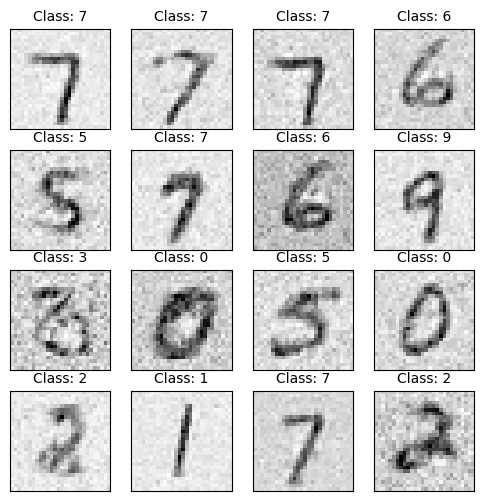

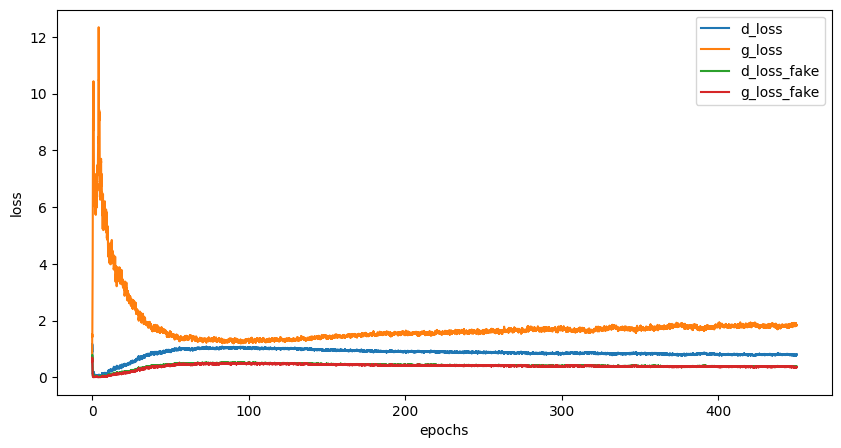

Epoch [451/500], Step[100/469], d_loss: 0.8437, d_loss_fake: 0.3914, g_loss: 2.1765, g_loss_fake: 0.3166, D(x): 0.73, D(G(z)): 0.27
Epoch [451/500], Step[200/469], d_loss: 0.7682, d_loss_fake: 0.3612, g_loss: 1.7742, g_loss_fake: 0.3742, D(x): 0.75, D(G(z)): 0.25
Epoch [451/500], Step[300/469], d_loss: 0.9032, d_loss_fake: 0.4414, g_loss: 1.6027, g_loss_fake: 0.3736, D(x): 0.73, D(G(z)): 0.28
Epoch [451/500], Step[400/469], d_loss: 0.7326, d_loss_fake: 0.3315, g_loss: 2.1061, g_loss_fake: 0.2337, D(x): 0.77, D(G(z)): 0.24


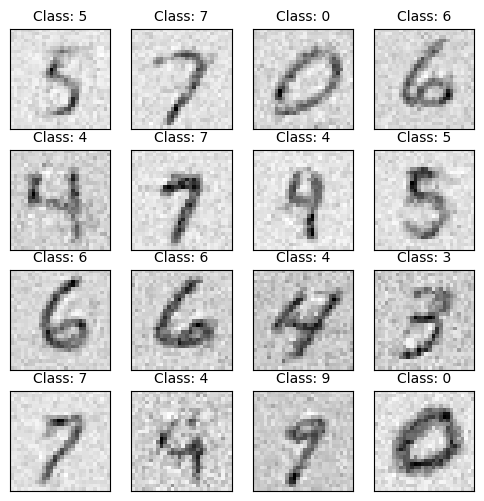

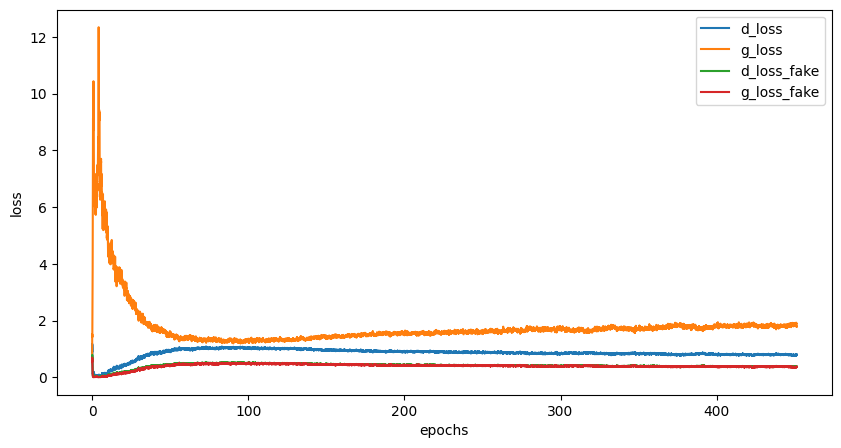

Epoch [452/500], Step[100/469], d_loss: 0.8290, d_loss_fake: 0.3933, g_loss: 1.8948, g_loss_fake: 0.3116, D(x): 0.75, D(G(z)): 0.25
Epoch [452/500], Step[200/469], d_loss: 0.8780, d_loss_fake: 0.4927, g_loss: 1.6952, g_loss_fake: 0.5031, D(x): 0.75, D(G(z)): 0.29
Epoch [452/500], Step[300/469], d_loss: 1.0253, d_loss_fake: 0.4974, g_loss: 2.0715, g_loss_fake: 0.3462, D(x): 0.70, D(G(z)): 0.31
Epoch [452/500], Step[400/469], d_loss: 0.7137, d_loss_fake: 0.4027, g_loss: 1.6817, g_loss_fake: 0.4254, D(x): 0.79, D(G(z)): 0.27


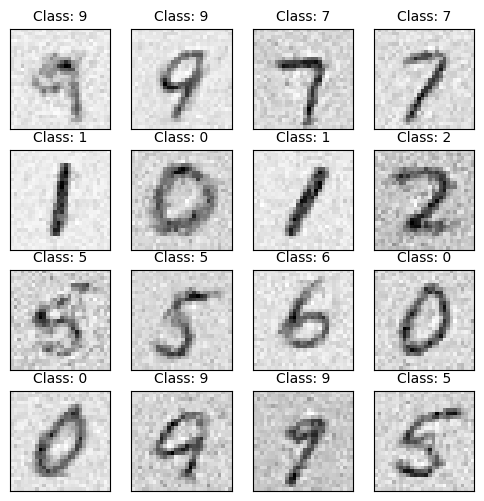

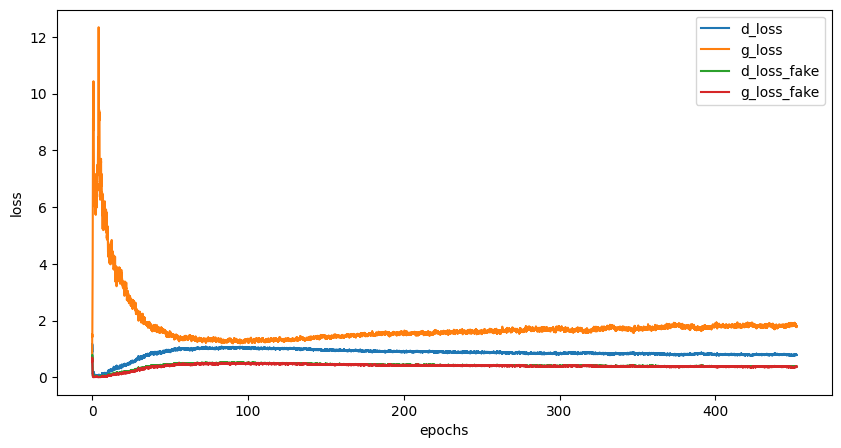

Epoch [453/500], Step[100/469], d_loss: 0.7496, d_loss_fake: 0.3134, g_loss: 1.8421, g_loss_fake: 0.3157, D(x): 0.75, D(G(z)): 0.22
Epoch [453/500], Step[200/469], d_loss: 0.7461, d_loss_fake: 0.3803, g_loss: 1.7895, g_loss_fake: 0.4011, D(x): 0.76, D(G(z)): 0.26
Epoch [453/500], Step[300/469], d_loss: 0.8069, d_loss_fake: 0.4020, g_loss: 1.8790, g_loss_fake: 0.3294, D(x): 0.77, D(G(z)): 0.26
Epoch [453/500], Step[400/469], d_loss: 0.8328, d_loss_fake: 0.3273, g_loss: 2.5403, g_loss_fake: 0.2247, D(x): 0.72, D(G(z)): 0.24


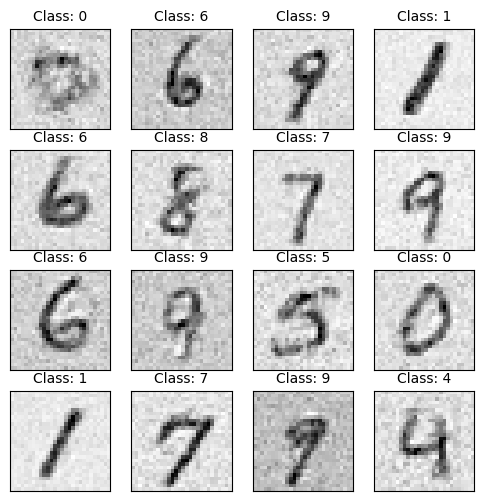

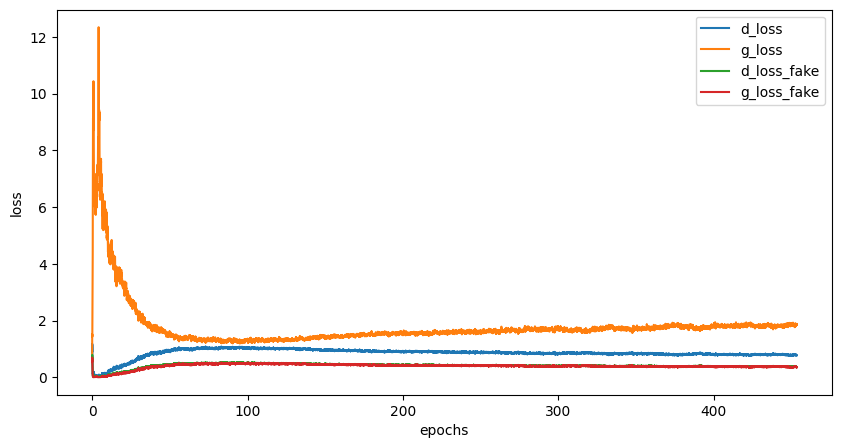

Epoch [454/500], Step[100/469], d_loss: 0.6817, d_loss_fake: 0.3856, g_loss: 1.9780, g_loss_fake: 0.3221, D(x): 0.80, D(G(z)): 0.26
Epoch [454/500], Step[200/469], d_loss: 0.9015, d_loss_fake: 0.3729, g_loss: 1.6371, g_loss_fake: 0.4902, D(x): 0.70, D(G(z)): 0.25
Epoch [454/500], Step[300/469], d_loss: 0.8472, d_loss_fake: 0.4956, g_loss: 1.9065, g_loss_fake: 0.3844, D(x): 0.79, D(G(z)): 0.32
Epoch [454/500], Step[400/469], d_loss: 0.6721, d_loss_fake: 0.3057, g_loss: 1.7773, g_loss_fake: 0.3649, D(x): 0.77, D(G(z)): 0.23


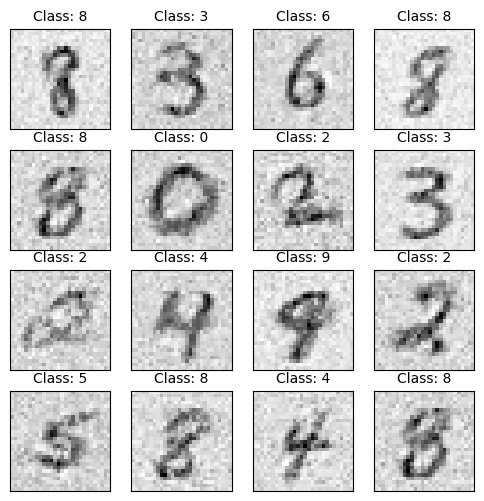

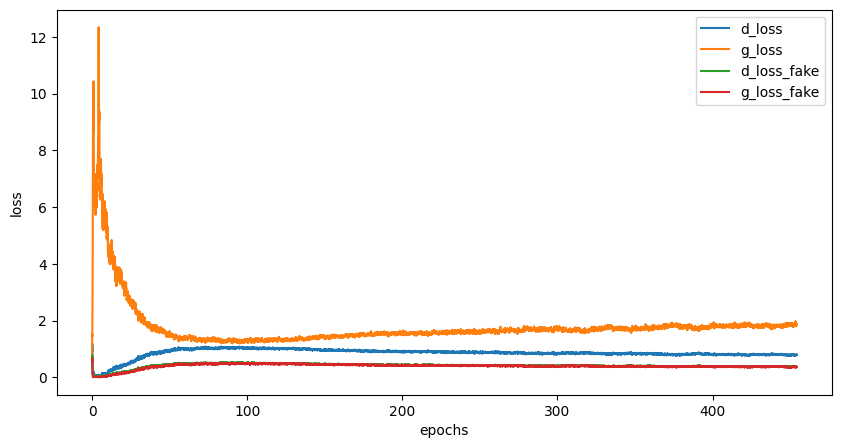

Epoch [455/500], Step[100/469], d_loss: 0.6499, d_loss_fake: 0.2744, g_loss: 1.9071, g_loss_fake: 0.3485, D(x): 0.76, D(G(z)): 0.20
Epoch [455/500], Step[200/469], d_loss: 0.7622, d_loss_fake: 0.4537, g_loss: 1.9550, g_loss_fake: 0.4191, D(x): 0.79, D(G(z)): 0.30
Epoch [455/500], Step[300/469], d_loss: 0.8140, d_loss_fake: 0.3872, g_loss: 1.8763, g_loss_fake: 0.3768, D(x): 0.74, D(G(z)): 0.27
Epoch [455/500], Step[400/469], d_loss: 0.8193, d_loss_fake: 0.3913, g_loss: 1.8017, g_loss_fake: 0.3300, D(x): 0.74, D(G(z)): 0.28


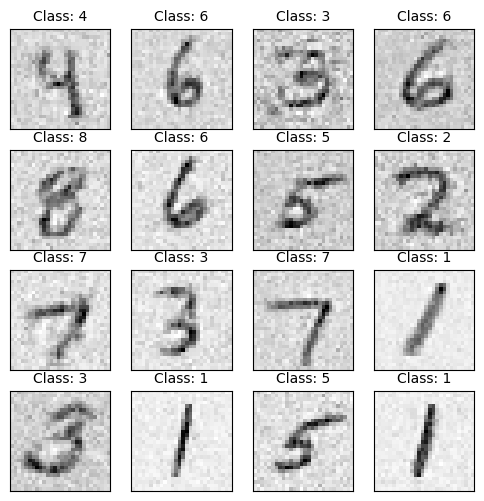

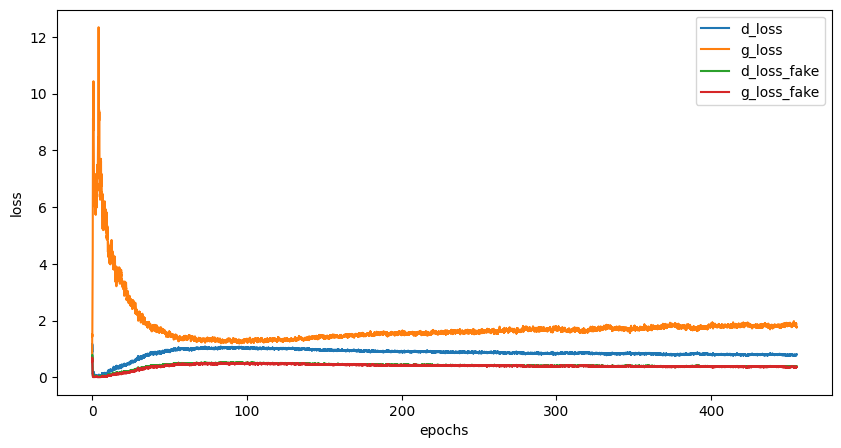

Epoch [456/500], Step[100/469], d_loss: 0.8195, d_loss_fake: 0.3434, g_loss: 1.7724, g_loss_fake: 0.3833, D(x): 0.71, D(G(z)): 0.25
Epoch [456/500], Step[200/469], d_loss: 0.7999, d_loss_fake: 0.4456, g_loss: 1.5150, g_loss_fake: 0.4288, D(x): 0.77, D(G(z)): 0.29
Epoch [456/500], Step[300/469], d_loss: 0.8802, d_loss_fake: 0.4184, g_loss: 1.9176, g_loss_fake: 0.3991, D(x): 0.72, D(G(z)): 0.27
Epoch [456/500], Step[400/469], d_loss: 0.7022, d_loss_fake: 0.2207, g_loss: 2.6182, g_loss_fake: 0.2900, D(x): 0.72, D(G(z)): 0.17


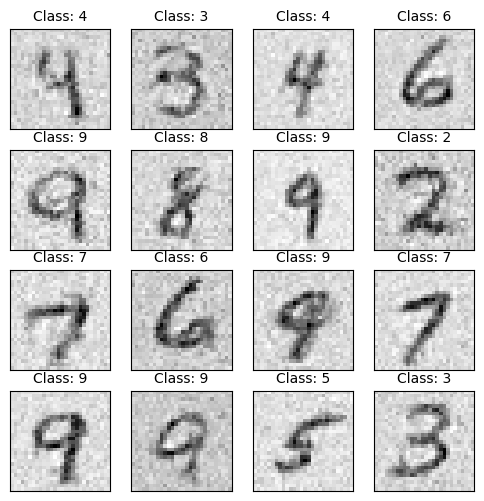

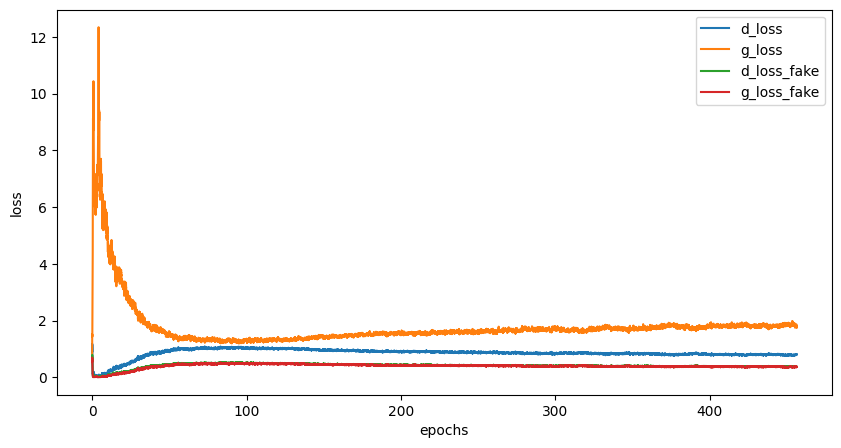

Epoch [457/500], Step[100/469], d_loss: 0.7908, d_loss_fake: 0.3741, g_loss: 1.6886, g_loss_fake: 0.3839, D(x): 0.74, D(G(z)): 0.27
Epoch [457/500], Step[200/469], d_loss: 0.8905, d_loss_fake: 0.4539, g_loss: 1.7889, g_loss_fake: 0.3725, D(x): 0.74, D(G(z)): 0.30
Epoch [457/500], Step[300/469], d_loss: 0.9300, d_loss_fake: 0.4597, g_loss: 1.8850, g_loss_fake: 0.2943, D(x): 0.71, D(G(z)): 0.27
Epoch [457/500], Step[400/469], d_loss: 0.9336, d_loss_fake: 0.4379, g_loss: 1.9745, g_loss_fake: 0.3426, D(x): 0.71, D(G(z)): 0.26


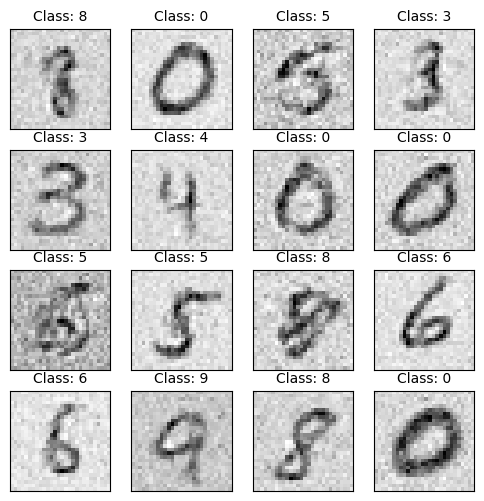

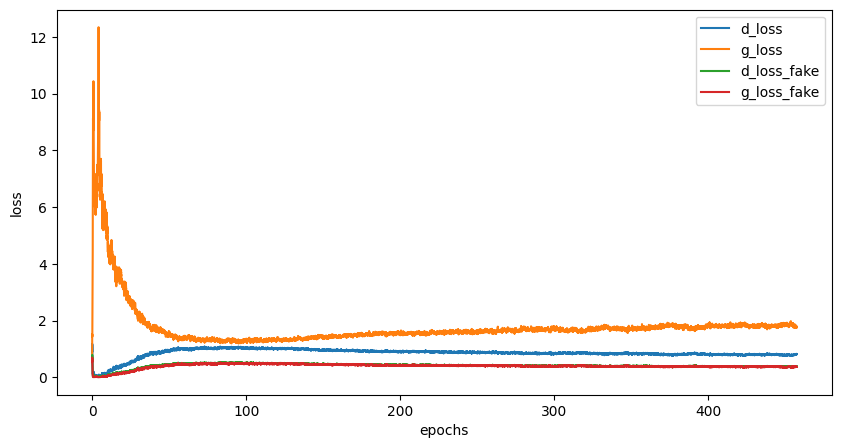

Epoch [458/500], Step[100/469], d_loss: 0.8389, d_loss_fake: 0.5044, g_loss: 1.7221, g_loss_fake: 0.4177, D(x): 0.79, D(G(z)): 0.29
Epoch [458/500], Step[200/469], d_loss: 0.8413, d_loss_fake: 0.4448, g_loss: 1.6558, g_loss_fake: 0.4049, D(x): 0.75, D(G(z)): 0.28
Epoch [458/500], Step[300/469], d_loss: 0.6584, d_loss_fake: 0.3647, g_loss: 1.9277, g_loss_fake: 0.3753, D(x): 0.81, D(G(z)): 0.24
Epoch [458/500], Step[400/469], d_loss: 0.7112, d_loss_fake: 0.3463, g_loss: 1.7927, g_loss_fake: 0.3414, D(x): 0.78, D(G(z)): 0.24


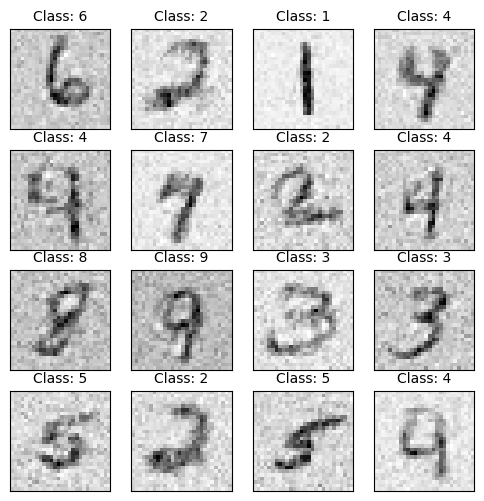

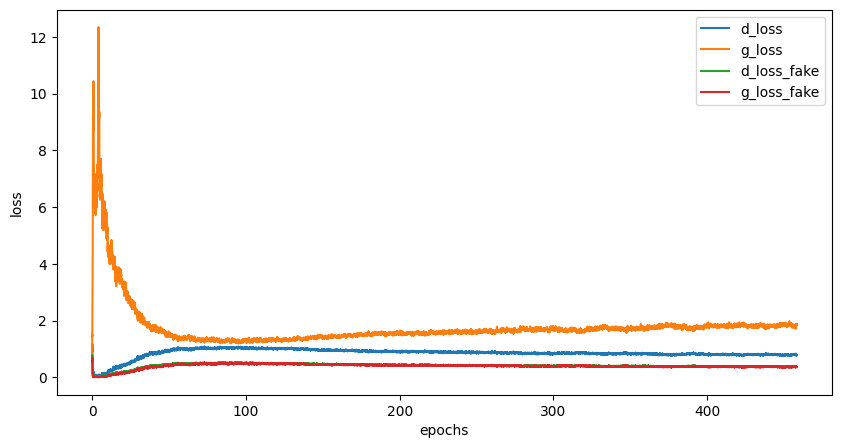

Epoch [459/500], Step[100/469], d_loss: 0.9204, d_loss_fake: 0.4817, g_loss: 1.8221, g_loss_fake: 0.3389, D(x): 0.74, D(G(z)): 0.32
Epoch [459/500], Step[200/469], d_loss: 0.8889, d_loss_fake: 0.4250, g_loss: 1.7203, g_loss_fake: 0.3619, D(x): 0.73, D(G(z)): 0.26
Epoch [459/500], Step[300/469], d_loss: 0.7911, d_loss_fake: 0.4133, g_loss: 1.6882, g_loss_fake: 0.4005, D(x): 0.77, D(G(z)): 0.28
Epoch [459/500], Step[400/469], d_loss: 0.8032, d_loss_fake: 0.3581, g_loss: 1.6502, g_loss_fake: 0.4212, D(x): 0.73, D(G(z)): 0.25


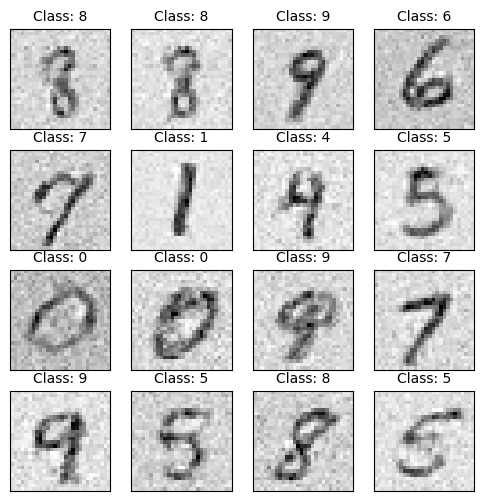

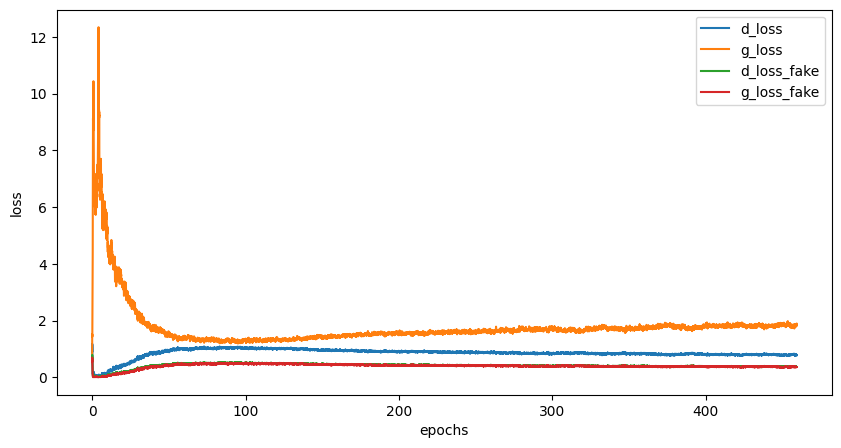

Epoch [460/500], Step[100/469], d_loss: 0.7292, d_loss_fake: 0.3906, g_loss: 1.5961, g_loss_fake: 0.4084, D(x): 0.77, D(G(z)): 0.28
Epoch [460/500], Step[200/469], d_loss: 0.7247, d_loss_fake: 0.4183, g_loss: 1.7878, g_loss_fake: 0.3751, D(x): 0.79, D(G(z)): 0.27
Epoch [460/500], Step[300/469], d_loss: 0.7484, d_loss_fake: 0.3684, g_loss: 1.6444, g_loss_fake: 0.4352, D(x): 0.77, D(G(z)): 0.24
Epoch [460/500], Step[400/469], d_loss: 0.8745, d_loss_fake: 0.4136, g_loss: 1.7432, g_loss_fake: 0.3976, D(x): 0.70, D(G(z)): 0.26


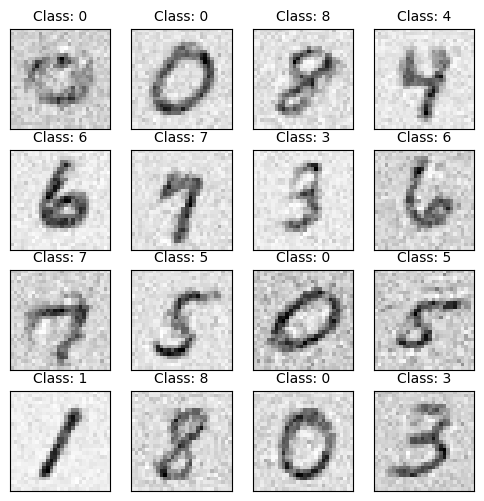

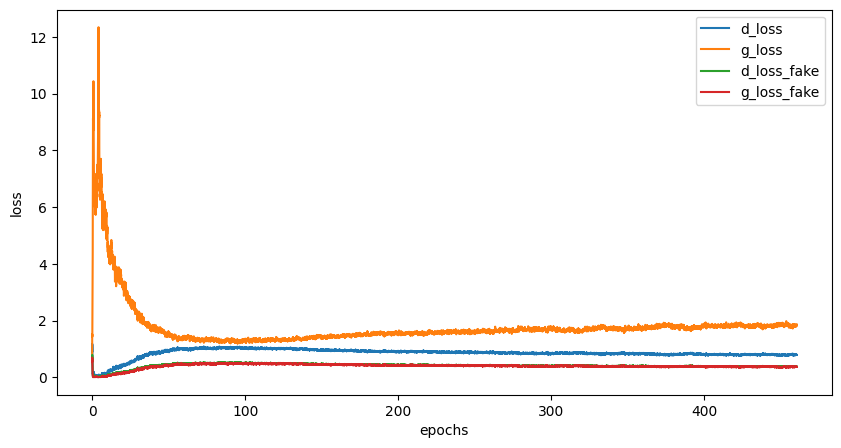

Epoch [461/500], Step[100/469], d_loss: 0.8598, d_loss_fake: 0.3274, g_loss: 1.8256, g_loss_fake: 0.3265, D(x): 0.69, D(G(z)): 0.23
Epoch [461/500], Step[200/469], d_loss: 0.7750, d_loss_fake: 0.3522, g_loss: 1.8447, g_loss_fake: 0.3669, D(x): 0.74, D(G(z)): 0.26
Epoch [461/500], Step[300/469], d_loss: 0.7583, d_loss_fake: 0.3533, g_loss: 2.0467, g_loss_fake: 0.3563, D(x): 0.76, D(G(z)): 0.24
Epoch [461/500], Step[400/469], d_loss: 0.8164, d_loss_fake: 0.4290, g_loss: 1.7998, g_loss_fake: 0.3754, D(x): 0.75, D(G(z)): 0.28


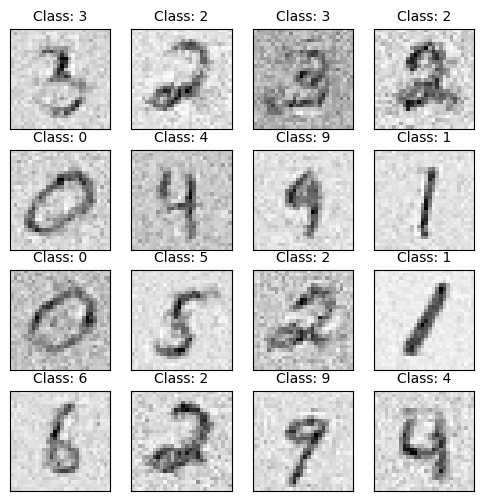

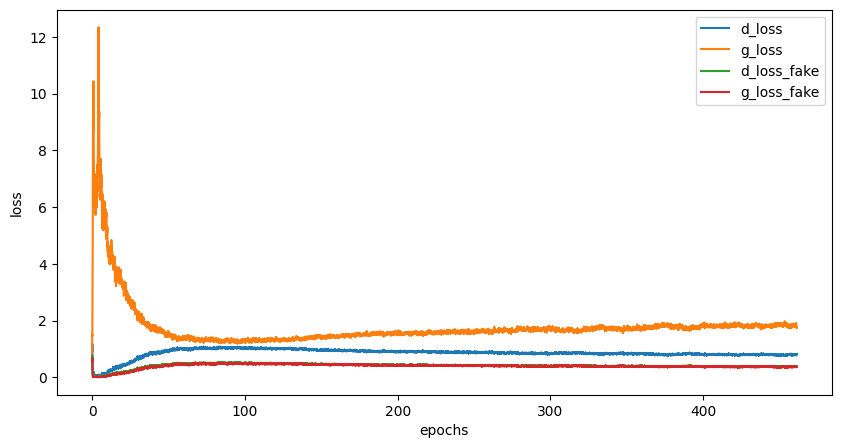

Epoch [462/500], Step[100/469], d_loss: 0.7626, d_loss_fake: 0.3649, g_loss: 1.8503, g_loss_fake: 0.3479, D(x): 0.75, D(G(z)): 0.25
Epoch [462/500], Step[200/469], d_loss: 0.7277, d_loss_fake: 0.3238, g_loss: 1.7354, g_loss_fake: 0.3359, D(x): 0.74, D(G(z)): 0.23
Epoch [462/500], Step[300/469], d_loss: 0.7996, d_loss_fake: 0.3487, g_loss: 1.6683, g_loss_fake: 0.3812, D(x): 0.74, D(G(z)): 0.25
Epoch [462/500], Step[400/469], d_loss: 0.7208, d_loss_fake: 0.4270, g_loss: 1.7729, g_loss_fake: 0.4165, D(x): 0.80, D(G(z)): 0.28


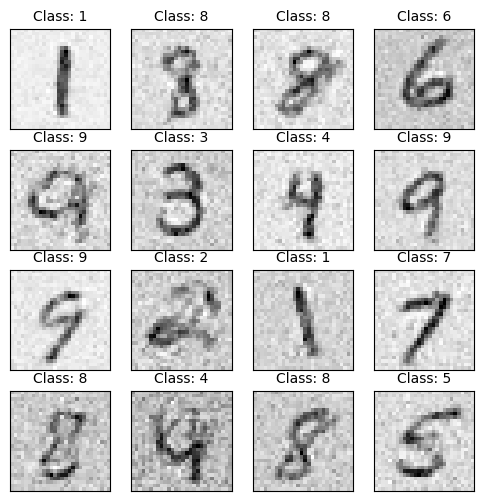

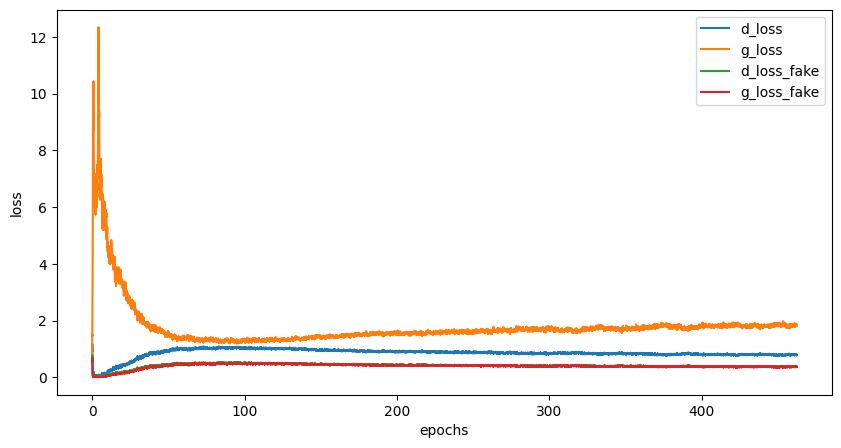

Epoch [463/500], Step[100/469], d_loss: 0.7043, d_loss_fake: 0.3371, g_loss: 1.8642, g_loss_fake: 0.4019, D(x): 0.77, D(G(z)): 0.24
Epoch [463/500], Step[200/469], d_loss: 0.8007, d_loss_fake: 0.3460, g_loss: 1.7882, g_loss_fake: 0.3665, D(x): 0.73, D(G(z)): 0.24
Epoch [463/500], Step[300/469], d_loss: 0.7836, d_loss_fake: 0.3738, g_loss: 1.9969, g_loss_fake: 0.2905, D(x): 0.75, D(G(z)): 0.26
Epoch [463/500], Step[400/469], d_loss: 0.7553, d_loss_fake: 0.3284, g_loss: 1.9102, g_loss_fake: 0.3226, D(x): 0.74, D(G(z)): 0.21


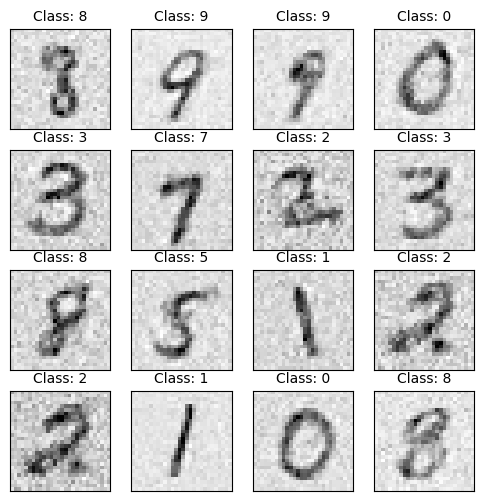

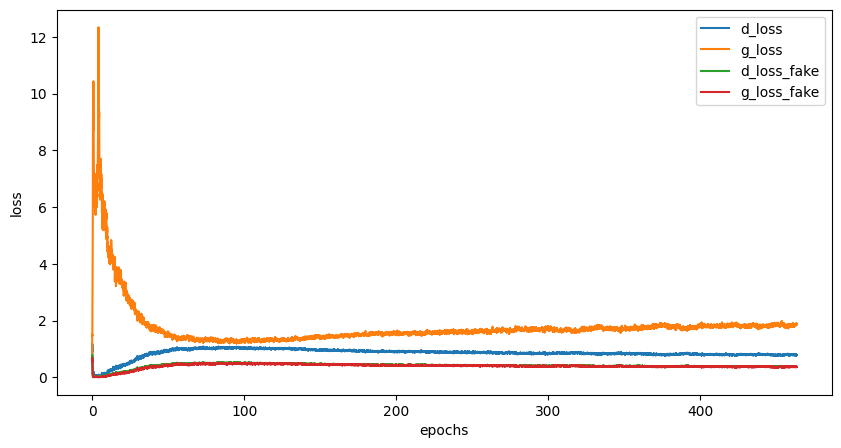

Epoch [464/500], Step[100/469], d_loss: 0.8020, d_loss_fake: 0.4279, g_loss: 1.6035, g_loss_fake: 0.4525, D(x): 0.76, D(G(z)): 0.30
Epoch [464/500], Step[200/469], d_loss: 0.9018, d_loss_fake: 0.4817, g_loss: 1.7579, g_loss_fake: 0.4039, D(x): 0.74, D(G(z)): 0.31
Epoch [464/500], Step[300/469], d_loss: 0.7945, d_loss_fake: 0.4037, g_loss: 1.7759, g_loss_fake: 0.3300, D(x): 0.76, D(G(z)): 0.27
Epoch [464/500], Step[400/469], d_loss: 0.8216, d_loss_fake: 0.3147, g_loss: 1.8576, g_loss_fake: 0.3494, D(x): 0.71, D(G(z)): 0.23


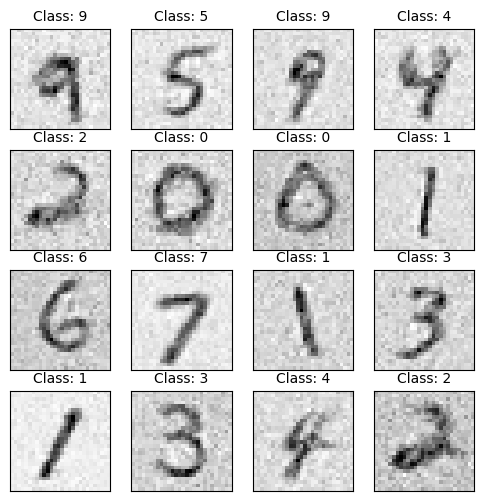

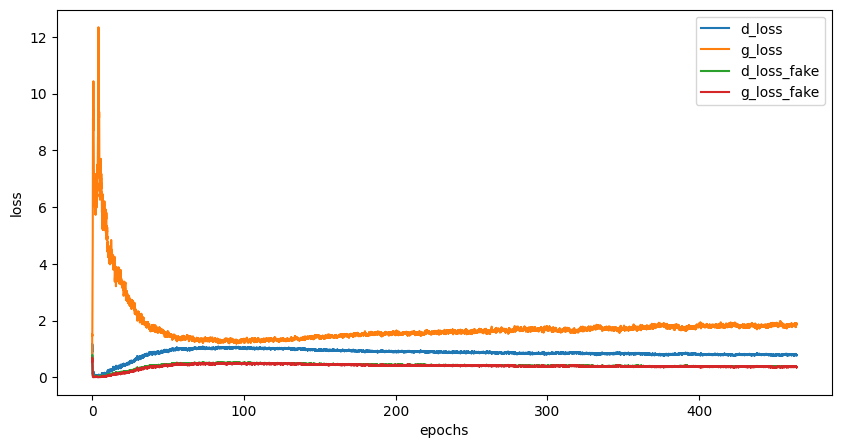

Epoch [465/500], Step[100/469], d_loss: 0.7411, d_loss_fake: 0.2916, g_loss: 1.8933, g_loss_fake: 0.3484, D(x): 0.75, D(G(z)): 0.22
Epoch [465/500], Step[200/469], d_loss: 0.9059, d_loss_fake: 0.4299, g_loss: 1.6925, g_loss_fake: 0.4199, D(x): 0.72, D(G(z)): 0.28
Epoch [465/500], Step[300/469], d_loss: 0.9082, d_loss_fake: 0.3491, g_loss: 1.5570, g_loss_fake: 0.4651, D(x): 0.69, D(G(z)): 0.23
Epoch [465/500], Step[400/469], d_loss: 0.7713, d_loss_fake: 0.3263, g_loss: 1.8838, g_loss_fake: 0.2978, D(x): 0.72, D(G(z)): 0.23


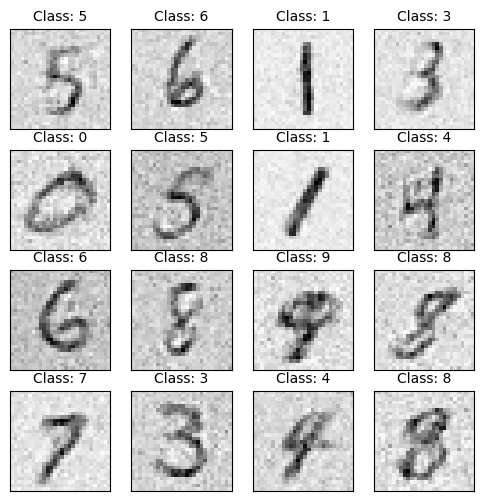

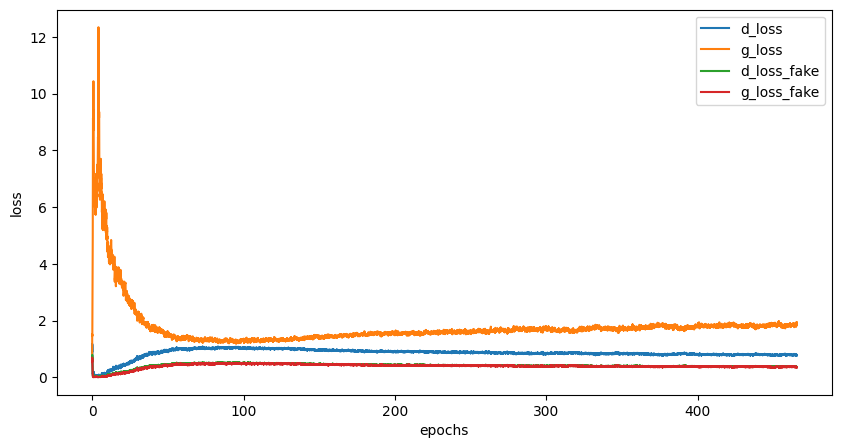

Epoch [466/500], Step[100/469], d_loss: 0.7479, d_loss_fake: 0.3480, g_loss: 1.8682, g_loss_fake: 0.3495, D(x): 0.75, D(G(z)): 0.24
Epoch [466/500], Step[200/469], d_loss: 0.9411, d_loss_fake: 0.4872, g_loss: 1.7217, g_loss_fake: 0.4020, D(x): 0.74, D(G(z)): 0.31
Epoch [466/500], Step[300/469], d_loss: 0.9833, d_loss_fake: 0.4742, g_loss: 1.7666, g_loss_fake: 0.3511, D(x): 0.71, D(G(z)): 0.30
Epoch [466/500], Step[400/469], d_loss: 0.8364, d_loss_fake: 0.3947, g_loss: 2.0028, g_loss_fake: 0.3811, D(x): 0.74, D(G(z)): 0.26


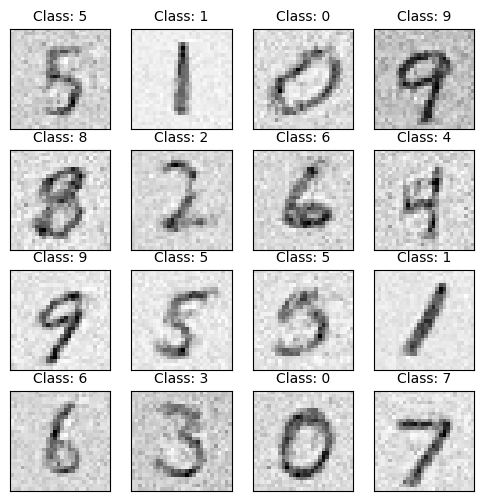

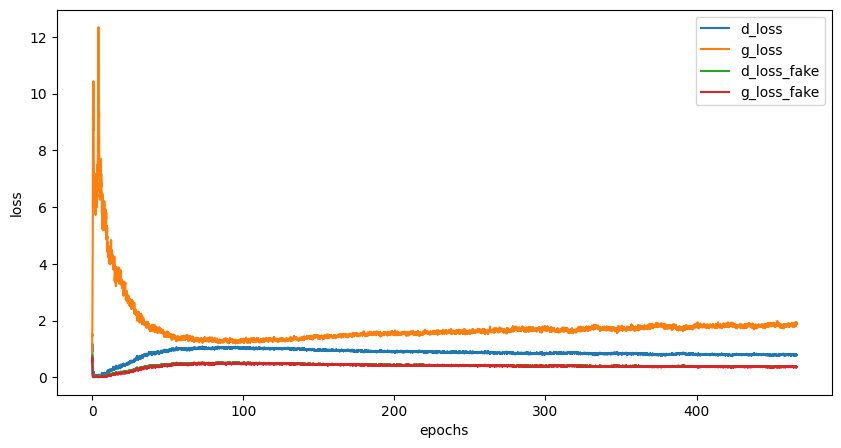

Epoch [467/500], Step[100/469], d_loss: 0.7368, d_loss_fake: 0.3384, g_loss: 1.8511, g_loss_fake: 0.3501, D(x): 0.74, D(G(z)): 0.24
Epoch [467/500], Step[200/469], d_loss: 0.7825, d_loss_fake: 0.3314, g_loss: 1.7303, g_loss_fake: 0.3732, D(x): 0.73, D(G(z)): 0.24
Epoch [467/500], Step[300/469], d_loss: 0.8650, d_loss_fake: 0.3850, g_loss: 1.9214, g_loss_fake: 0.3546, D(x): 0.72, D(G(z)): 0.27
Epoch [467/500], Step[400/469], d_loss: 0.7766, d_loss_fake: 0.3457, g_loss: 2.1155, g_loss_fake: 0.2771, D(x): 0.74, D(G(z)): 0.24


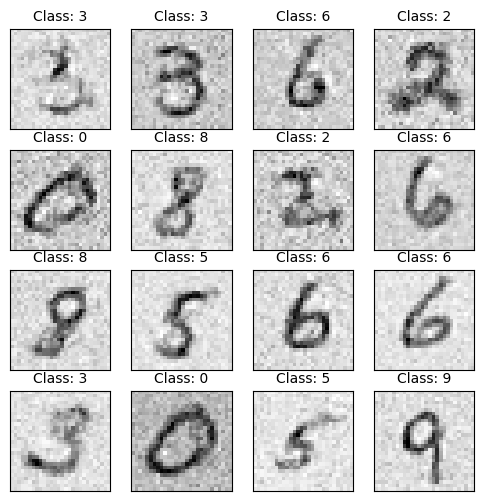

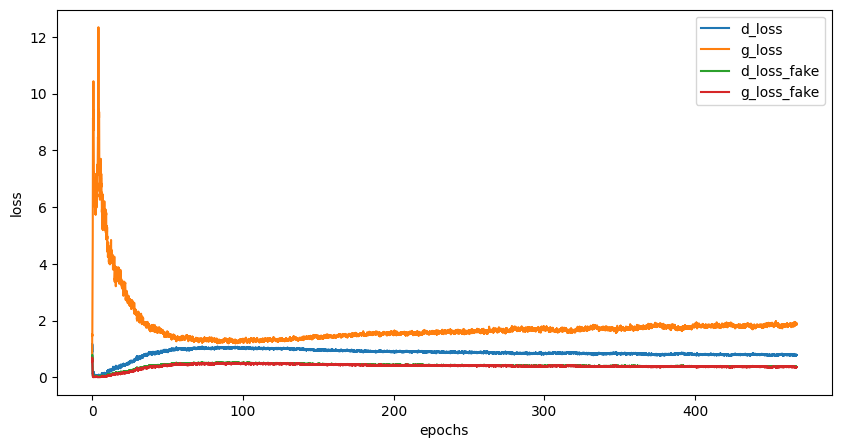

Epoch [468/500], Step[100/469], d_loss: 0.6947, d_loss_fake: 0.3329, g_loss: 2.0720, g_loss_fake: 0.2799, D(x): 0.76, D(G(z)): 0.22
Epoch [468/500], Step[200/469], d_loss: 0.7752, d_loss_fake: 0.2867, g_loss: 2.2294, g_loss_fake: 0.2752, D(x): 0.71, D(G(z)): 0.21
Epoch [468/500], Step[300/469], d_loss: 0.6554, d_loss_fake: 0.3242, g_loss: 1.9363, g_loss_fake: 0.3443, D(x): 0.79, D(G(z)): 0.23
Epoch [468/500], Step[400/469], d_loss: 0.7719, d_loss_fake: 0.4090, g_loss: 1.7044, g_loss_fake: 0.3255, D(x): 0.78, D(G(z)): 0.26


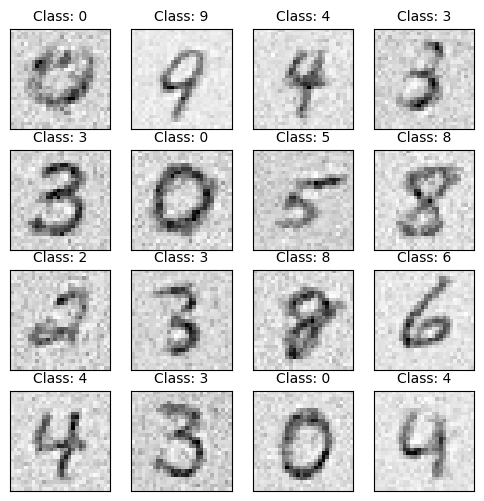

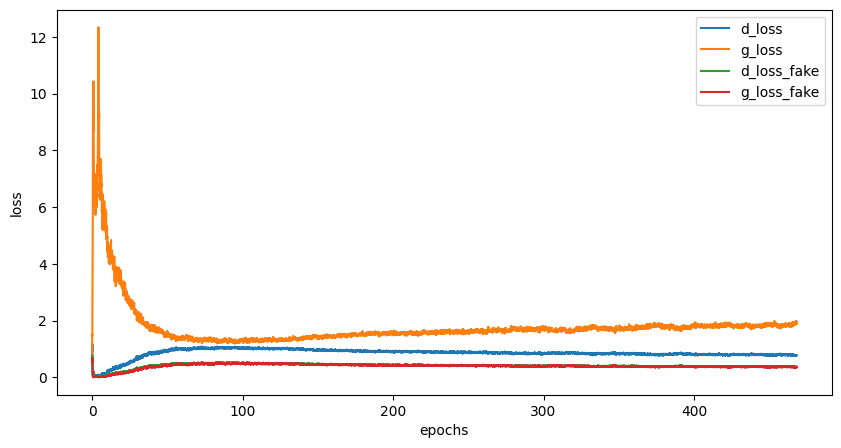

Epoch [469/500], Step[100/469], d_loss: 0.7260, d_loss_fake: 0.3506, g_loss: 1.8799, g_loss_fake: 0.3331, D(x): 0.77, D(G(z)): 0.24
Epoch [469/500], Step[200/469], d_loss: 0.8550, d_loss_fake: 0.3908, g_loss: 1.6598, g_loss_fake: 0.4494, D(x): 0.73, D(G(z)): 0.27
Epoch [469/500], Step[300/469], d_loss: 0.8003, d_loss_fake: 0.3842, g_loss: 1.8781, g_loss_fake: 0.4452, D(x): 0.76, D(G(z)): 0.24
Epoch [469/500], Step[400/469], d_loss: 0.7981, d_loss_fake: 0.4085, g_loss: 2.0677, g_loss_fake: 0.3748, D(x): 0.75, D(G(z)): 0.27


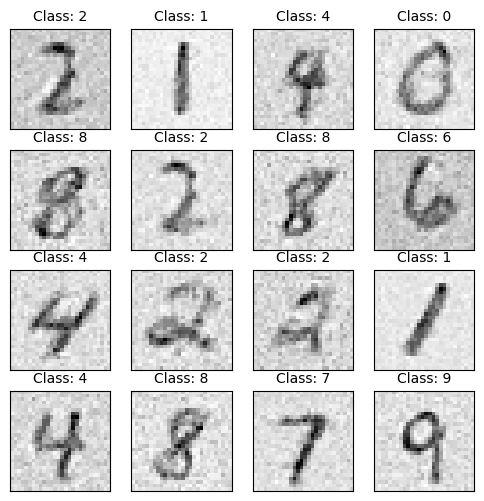

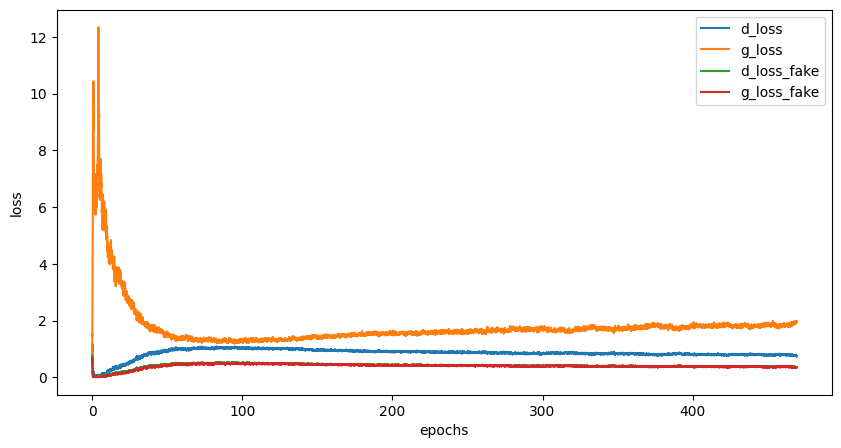

Epoch [470/500], Step[100/469], d_loss: 0.8343, d_loss_fake: 0.4178, g_loss: 1.7185, g_loss_fake: 0.3923, D(x): 0.74, D(G(z)): 0.27
Epoch [470/500], Step[200/469], d_loss: 0.8454, d_loss_fake: 0.3239, g_loss: 2.1322, g_loss_fake: 0.3473, D(x): 0.70, D(G(z)): 0.23
Epoch [470/500], Step[300/469], d_loss: 0.7426, d_loss_fake: 0.3064, g_loss: 1.8924, g_loss_fake: 0.3572, D(x): 0.75, D(G(z)): 0.22
Epoch [470/500], Step[400/469], d_loss: 0.7743, d_loss_fake: 0.4113, g_loss: 1.8333, g_loss_fake: 0.3516, D(x): 0.77, D(G(z)): 0.25


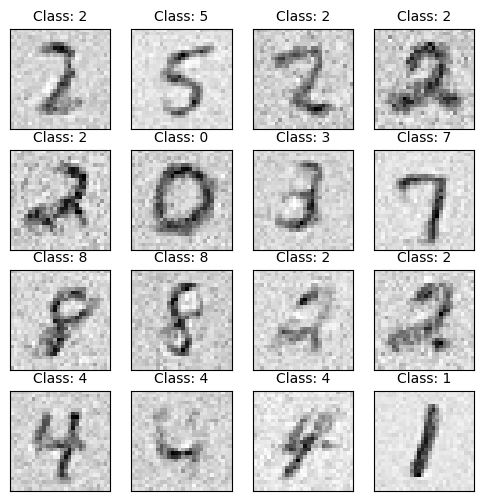

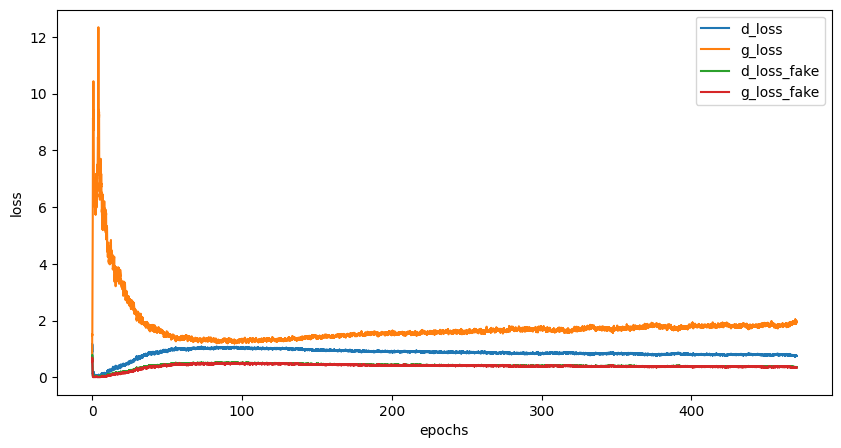

Epoch [471/500], Step[100/469], d_loss: 0.7001, d_loss_fake: 0.3740, g_loss: 1.9142, g_loss_fake: 0.3435, D(x): 0.79, D(G(z)): 0.24
Epoch [471/500], Step[200/469], d_loss: 0.7261, d_loss_fake: 0.2935, g_loss: 2.0314, g_loss_fake: 0.2826, D(x): 0.75, D(G(z)): 0.20
Epoch [471/500], Step[300/469], d_loss: 0.6649, d_loss_fake: 0.2727, g_loss: 1.9081, g_loss_fake: 0.3110, D(x): 0.76, D(G(z)): 0.21
Epoch [471/500], Step[400/469], d_loss: 0.7437, d_loss_fake: 0.3447, g_loss: 1.9966, g_loss_fake: 0.3361, D(x): 0.76, D(G(z)): 0.23


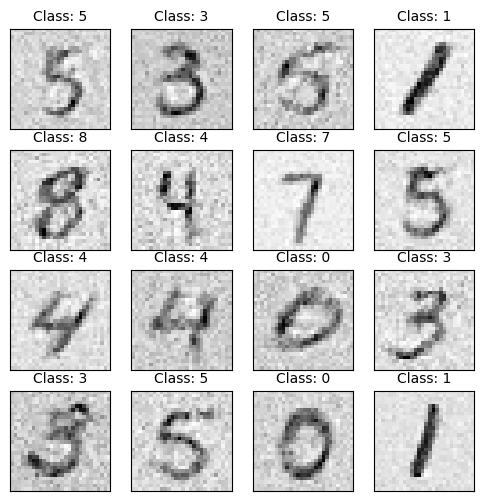

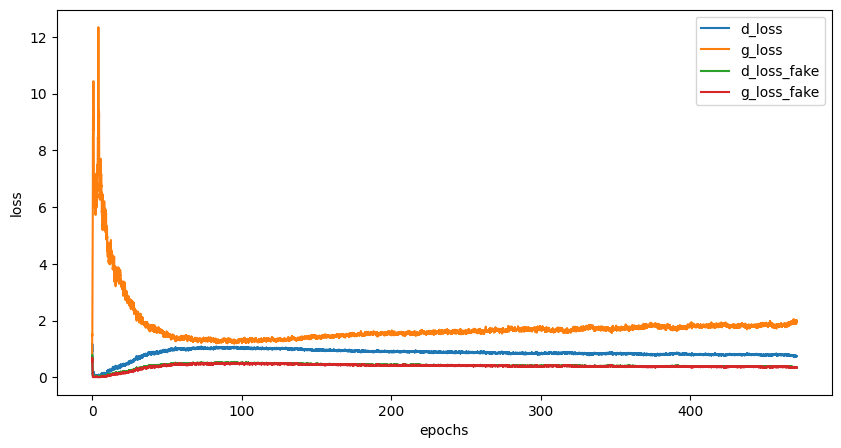

Epoch [472/500], Step[100/469], d_loss: 0.7743, d_loss_fake: 0.4296, g_loss: 1.9988, g_loss_fake: 0.3479, D(x): 0.78, D(G(z)): 0.27
Epoch [472/500], Step[200/469], d_loss: 0.7582, d_loss_fake: 0.3629, g_loss: 1.9468, g_loss_fake: 0.3857, D(x): 0.75, D(G(z)): 0.24
Epoch [472/500], Step[300/469], d_loss: 0.9098, d_loss_fake: 0.4834, g_loss: 1.8575, g_loss_fake: 0.3718, D(x): 0.75, D(G(z)): 0.31
Epoch [472/500], Step[400/469], d_loss: 0.6965, d_loss_fake: 0.3364, g_loss: 1.9368, g_loss_fake: 0.3371, D(x): 0.76, D(G(z)): 0.25


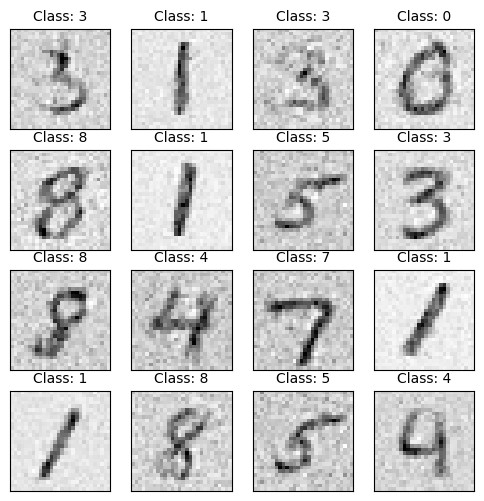

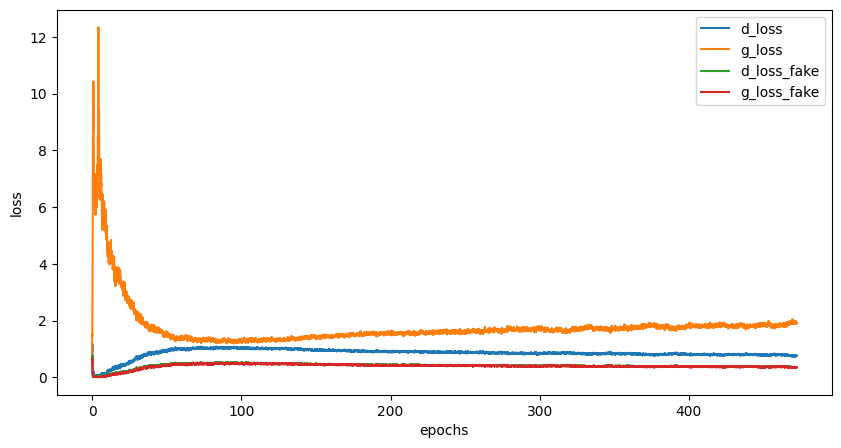

Epoch [473/500], Step[100/469], d_loss: 0.6261, d_loss_fake: 0.3679, g_loss: 1.8225, g_loss_fake: 0.4143, D(x): 0.82, D(G(z)): 0.25
Epoch [473/500], Step[200/469], d_loss: 0.8262, d_loss_fake: 0.4230, g_loss: 1.8632, g_loss_fake: 0.3847, D(x): 0.77, D(G(z)): 0.27
Epoch [473/500], Step[300/469], d_loss: 0.8580, d_loss_fake: 0.3309, g_loss: 1.8646, g_loss_fake: 0.4250, D(x): 0.69, D(G(z)): 0.24
Epoch [473/500], Step[400/469], d_loss: 0.7776, d_loss_fake: 0.3116, g_loss: 1.8347, g_loss_fake: 0.3596, D(x): 0.73, D(G(z)): 0.23


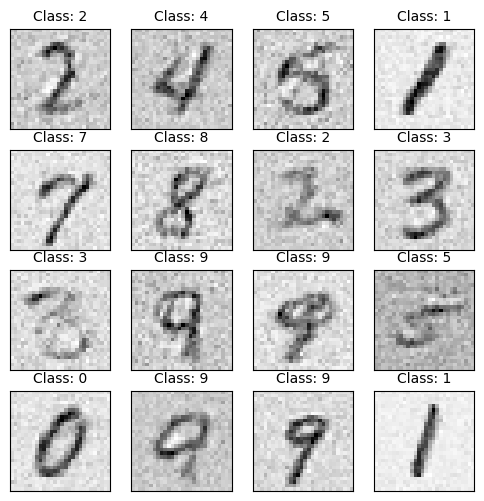

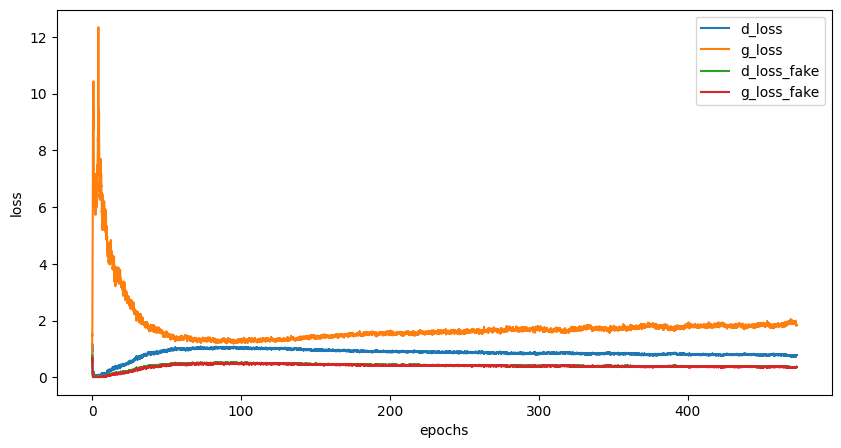

Epoch [474/500], Step[100/469], d_loss: 0.8231, d_loss_fake: 0.3679, g_loss: 1.9504, g_loss_fake: 0.3189, D(x): 0.75, D(G(z)): 0.24
Epoch [474/500], Step[200/469], d_loss: 0.6782, d_loss_fake: 0.3458, g_loss: 1.9589, g_loss_fake: 0.3794, D(x): 0.77, D(G(z)): 0.22
Epoch [474/500], Step[300/469], d_loss: 0.7781, d_loss_fake: 0.4200, g_loss: 1.8904, g_loss_fake: 0.4028, D(x): 0.76, D(G(z)): 0.28
Epoch [474/500], Step[400/469], d_loss: 0.7418, d_loss_fake: 0.3543, g_loss: 2.2697, g_loss_fake: 0.2717, D(x): 0.78, D(G(z)): 0.24


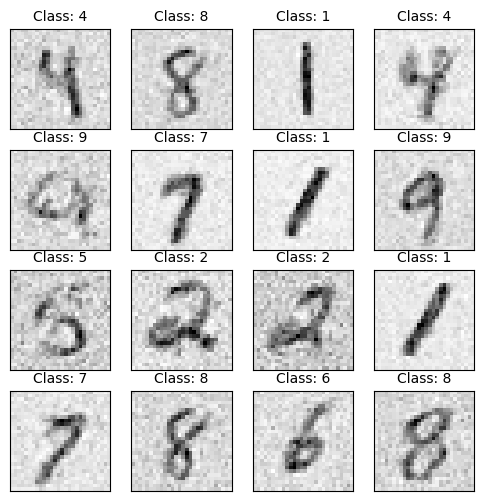

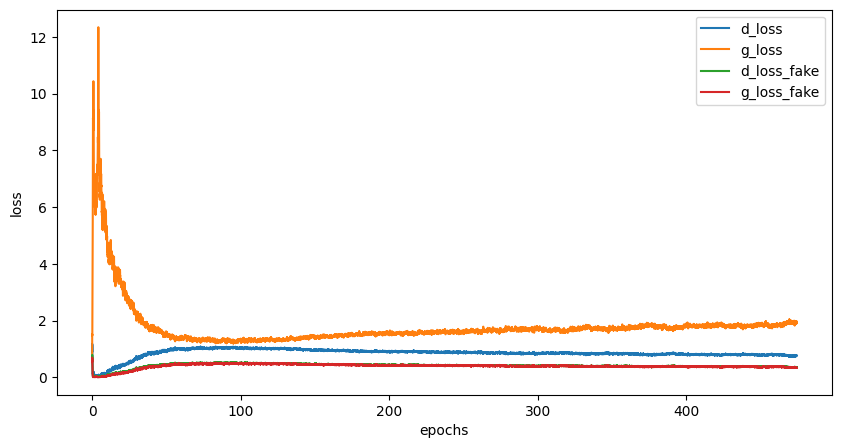

Epoch [475/500], Step[100/469], d_loss: 0.6866, d_loss_fake: 0.3013, g_loss: 2.1431, g_loss_fake: 0.3288, D(x): 0.77, D(G(z)): 0.22
Epoch [475/500], Step[200/469], d_loss: 0.7792, d_loss_fake: 0.3551, g_loss: 1.8850, g_loss_fake: 0.2947, D(x): 0.76, D(G(z)): 0.24
Epoch [475/500], Step[300/469], d_loss: 0.6908, d_loss_fake: 0.3142, g_loss: 1.9910, g_loss_fake: 0.3369, D(x): 0.76, D(G(z)): 0.21
Epoch [475/500], Step[400/469], d_loss: 0.8599, d_loss_fake: 0.3191, g_loss: 1.9280, g_loss_fake: 0.3194, D(x): 0.69, D(G(z)): 0.23


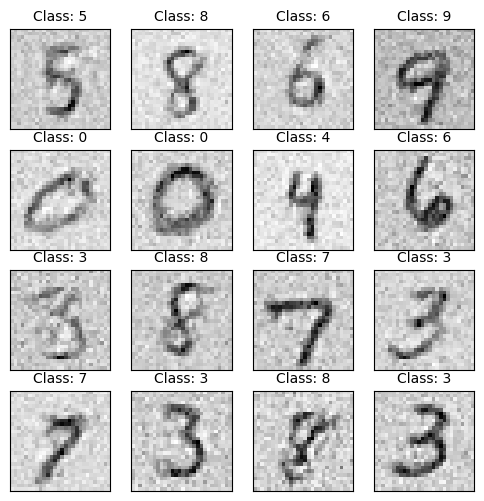

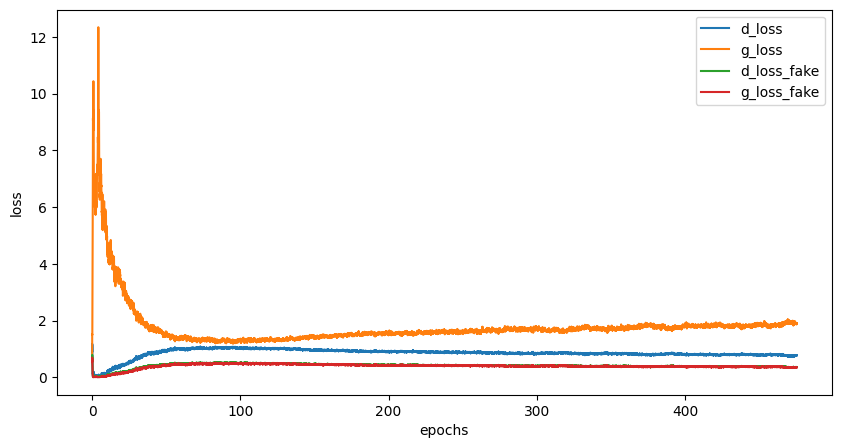

Epoch [476/500], Step[100/469], d_loss: 0.5785, d_loss_fake: 0.2551, g_loss: 2.0692, g_loss_fake: 0.2851, D(x): 0.80, D(G(z)): 0.20
Epoch [476/500], Step[200/469], d_loss: 0.8596, d_loss_fake: 0.3447, g_loss: 1.8831, g_loss_fake: 0.3465, D(x): 0.72, D(G(z)): 0.24
Epoch [476/500], Step[300/469], d_loss: 0.7818, d_loss_fake: 0.3789, g_loss: 1.7234, g_loss_fake: 0.4131, D(x): 0.74, D(G(z)): 0.27
Epoch [476/500], Step[400/469], d_loss: 0.8936, d_loss_fake: 0.3849, g_loss: 1.8019, g_loss_fake: 0.3477, D(x): 0.71, D(G(z)): 0.26


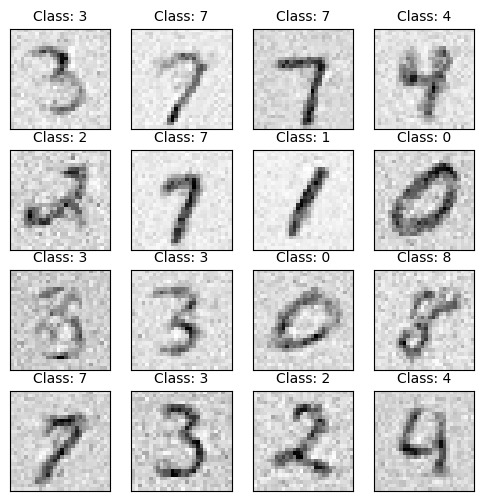

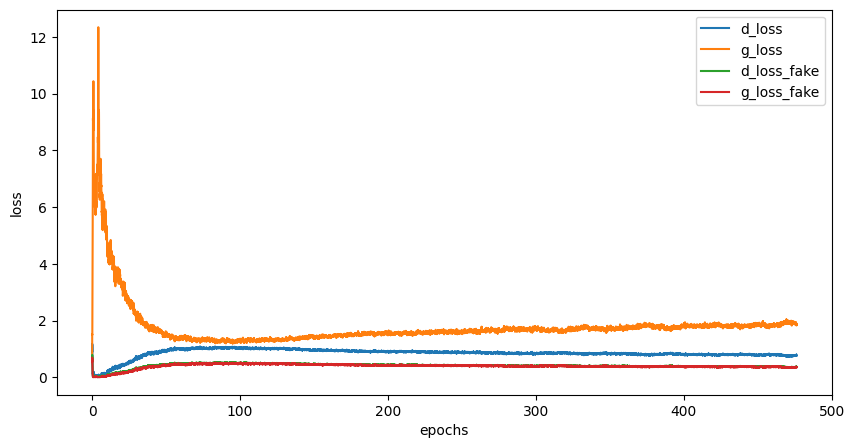

Epoch [477/500], Step[100/469], d_loss: 0.7783, d_loss_fake: 0.4025, g_loss: 1.8494, g_loss_fake: 0.3739, D(x): 0.76, D(G(z)): 0.26
Epoch [477/500], Step[200/469], d_loss: 0.8785, d_loss_fake: 0.3495, g_loss: 2.2454, g_loss_fake: 0.3119, D(x): 0.69, D(G(z)): 0.24
Epoch [477/500], Step[300/469], d_loss: 0.8816, d_loss_fake: 0.4890, g_loss: 1.7380, g_loss_fake: 0.3980, D(x): 0.77, D(G(z)): 0.31
Epoch [477/500], Step[400/469], d_loss: 0.7464, d_loss_fake: 0.3766, g_loss: 1.8193, g_loss_fake: 0.3500, D(x): 0.76, D(G(z)): 0.26


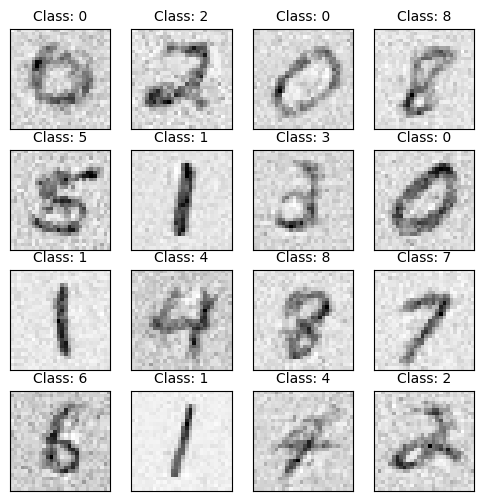

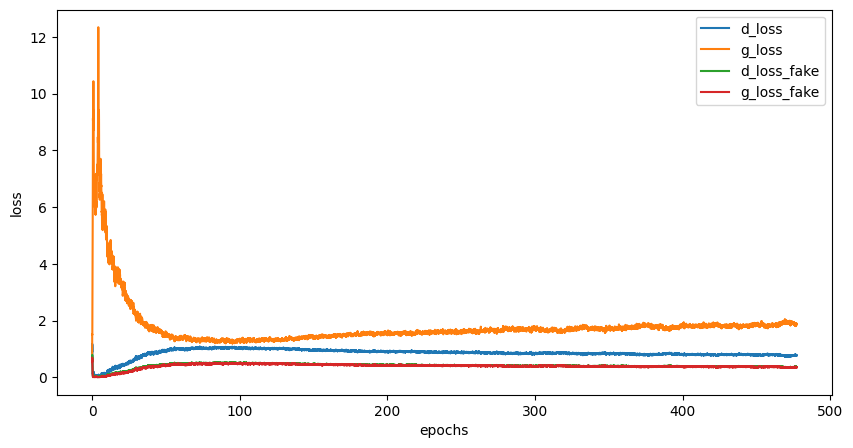

Epoch [478/500], Step[100/469], d_loss: 0.6610, d_loss_fake: 0.4074, g_loss: 1.6665, g_loss_fake: 0.4470, D(x): 0.83, D(G(z)): 0.27
Epoch [478/500], Step[200/469], d_loss: 0.6998, d_loss_fake: 0.3565, g_loss: 1.7883, g_loss_fake: 0.3515, D(x): 0.79, D(G(z)): 0.26
Epoch [478/500], Step[300/469], d_loss: 0.7618, d_loss_fake: 0.3381, g_loss: 1.9140, g_loss_fake: 0.4067, D(x): 0.73, D(G(z)): 0.24
Epoch [478/500], Step[400/469], d_loss: 0.8489, d_loss_fake: 0.3713, g_loss: 2.0241, g_loss_fake: 0.3029, D(x): 0.73, D(G(z)): 0.26


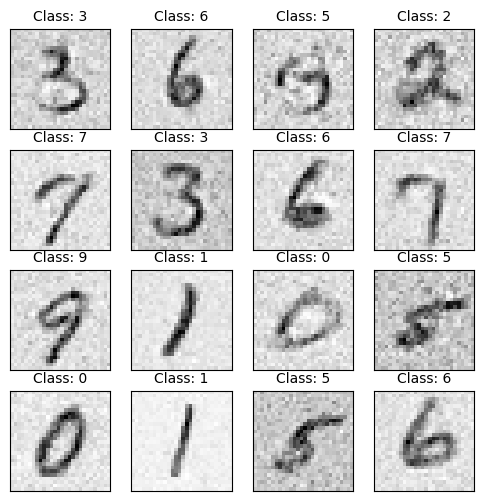

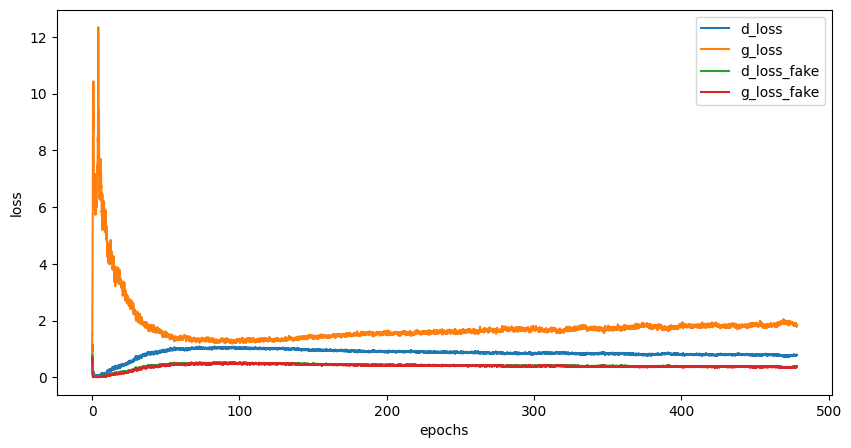

Epoch [479/500], Step[100/469], d_loss: 0.8562, d_loss_fake: 0.4631, g_loss: 1.6138, g_loss_fake: 0.4162, D(x): 0.76, D(G(z)): 0.30
Epoch [479/500], Step[200/469], d_loss: 0.8629, d_loss_fake: 0.4495, g_loss: 1.6898, g_loss_fake: 0.4295, D(x): 0.74, D(G(z)): 0.29
Epoch [479/500], Step[300/469], d_loss: 0.6740, d_loss_fake: 0.3712, g_loss: 1.5523, g_loss_fake: 0.4682, D(x): 0.80, D(G(z)): 0.26
Epoch [479/500], Step[400/469], d_loss: 0.7847, d_loss_fake: 0.3842, g_loss: 1.8274, g_loss_fake: 0.3410, D(x): 0.75, D(G(z)): 0.27


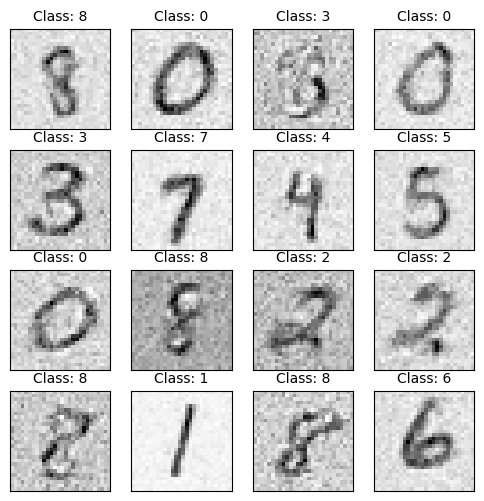

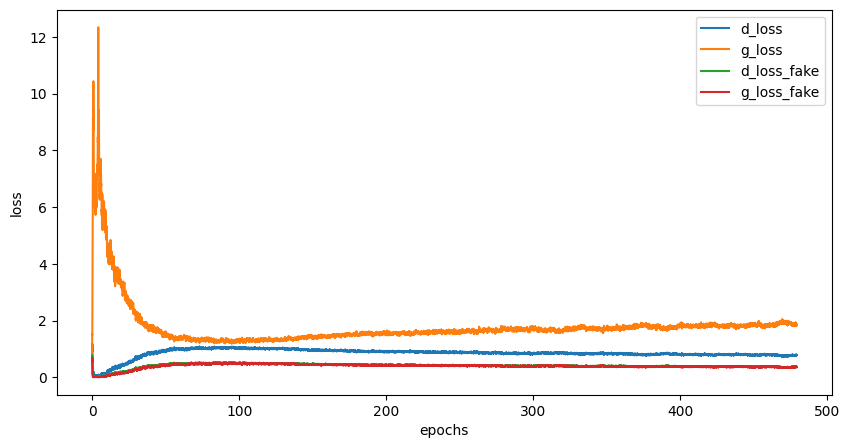

Epoch [480/500], Step[100/469], d_loss: 0.8772, d_loss_fake: 0.4169, g_loss: 1.9371, g_loss_fake: 0.3773, D(x): 0.71, D(G(z)): 0.25
Epoch [480/500], Step[200/469], d_loss: 0.8269, d_loss_fake: 0.3243, g_loss: 2.0319, g_loss_fake: 0.3200, D(x): 0.71, D(G(z)): 0.23
Epoch [480/500], Step[300/469], d_loss: 0.9216, d_loss_fake: 0.3859, g_loss: 2.0643, g_loss_fake: 0.3374, D(x): 0.70, D(G(z)): 0.25
Epoch [480/500], Step[400/469], d_loss: 1.0264, d_loss_fake: 0.4331, g_loss: 1.9552, g_loss_fake: 0.3413, D(x): 0.67, D(G(z)): 0.28


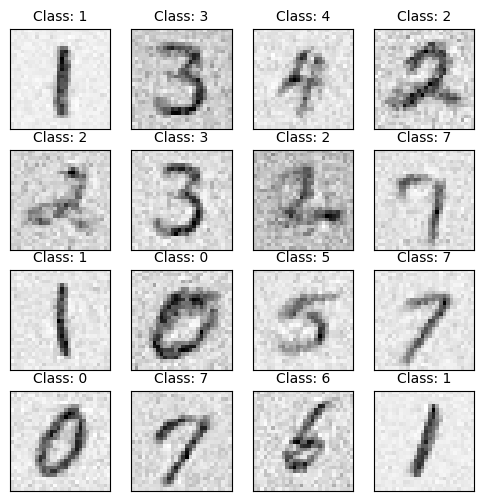

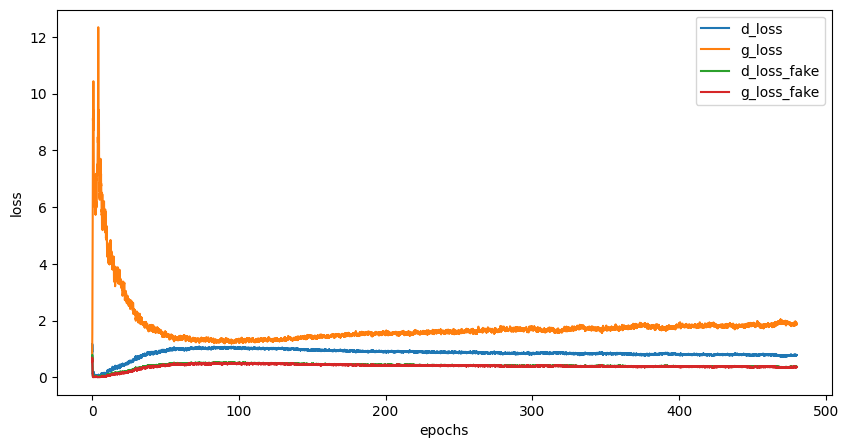

Epoch [481/500], Step[100/469], d_loss: 0.7131, d_loss_fake: 0.3566, g_loss: 1.9070, g_loss_fake: 0.4450, D(x): 0.76, D(G(z)): 0.25
Epoch [481/500], Step[200/469], d_loss: 0.7012, d_loss_fake: 0.4250, g_loss: 1.8060, g_loss_fake: 0.3648, D(x): 0.81, D(G(z)): 0.29
Epoch [481/500], Step[300/469], d_loss: 0.7285, d_loss_fake: 0.3396, g_loss: 1.7186, g_loss_fake: 0.3978, D(x): 0.76, D(G(z)): 0.26
Epoch [481/500], Step[400/469], d_loss: 0.7227, d_loss_fake: 0.3006, g_loss: 1.8794, g_loss_fake: 0.3628, D(x): 0.75, D(G(z)): 0.21


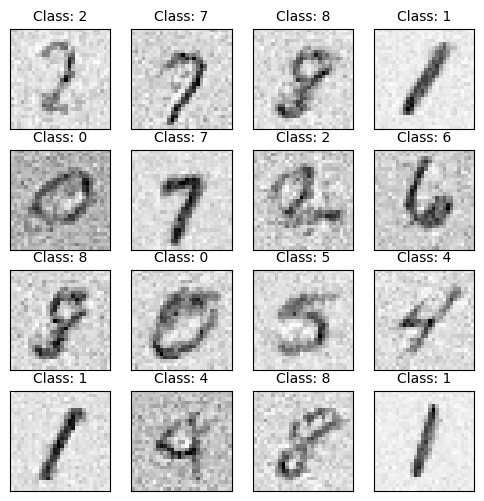

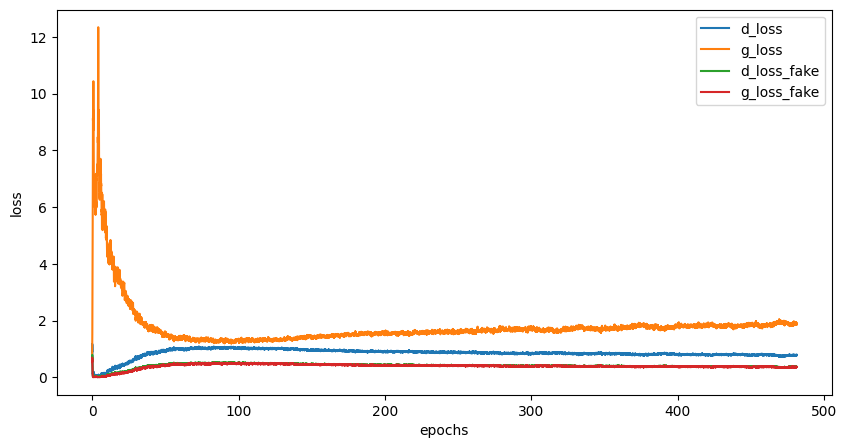

Epoch [482/500], Step[100/469], d_loss: 0.6746, d_loss_fake: 0.3329, g_loss: 1.8283, g_loss_fake: 0.3336, D(x): 0.78, D(G(z)): 0.24
Epoch [482/500], Step[200/469], d_loss: 0.8162, d_loss_fake: 0.3699, g_loss: 1.7784, g_loss_fake: 0.4144, D(x): 0.74, D(G(z)): 0.26
Epoch [482/500], Step[300/469], d_loss: 0.7465, d_loss_fake: 0.3451, g_loss: 1.9388, g_loss_fake: 0.3478, D(x): 0.74, D(G(z)): 0.24
Epoch [482/500], Step[400/469], d_loss: 0.9060, d_loss_fake: 0.4203, g_loss: 2.1239, g_loss_fake: 0.3105, D(x): 0.70, D(G(z)): 0.26


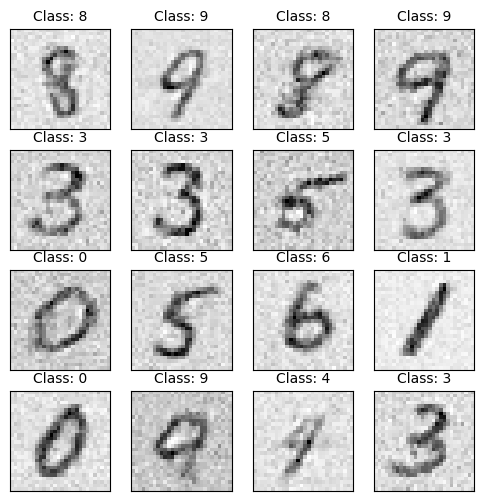

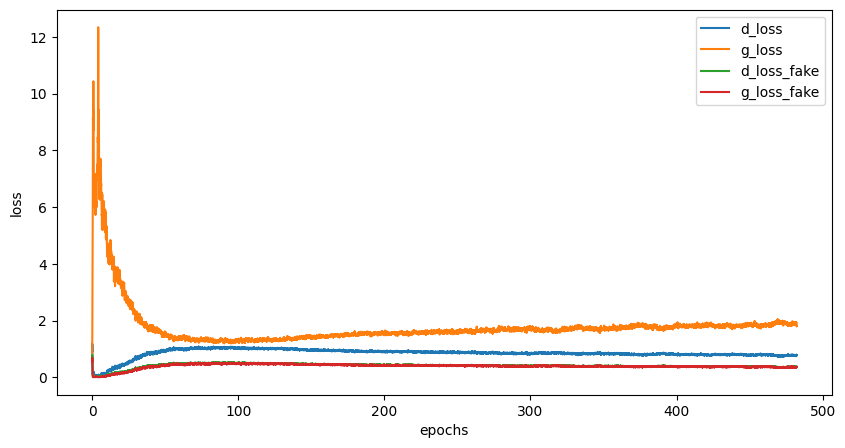

Epoch [483/500], Step[100/469], d_loss: 0.6986, d_loss_fake: 0.2966, g_loss: 2.1317, g_loss_fake: 0.3174, D(x): 0.75, D(G(z)): 0.22
Epoch [483/500], Step[200/469], d_loss: 0.9271, d_loss_fake: 0.3989, g_loss: 1.8224, g_loss_fake: 0.3502, D(x): 0.68, D(G(z)): 0.28
Epoch [483/500], Step[300/469], d_loss: 0.7023, d_loss_fake: 0.3490, g_loss: 1.7873, g_loss_fake: 0.3544, D(x): 0.78, D(G(z)): 0.25
Epoch [483/500], Step[400/469], d_loss: 0.9071, d_loss_fake: 0.3640, g_loss: 1.7668, g_loss_fake: 0.3796, D(x): 0.72, D(G(z)): 0.25


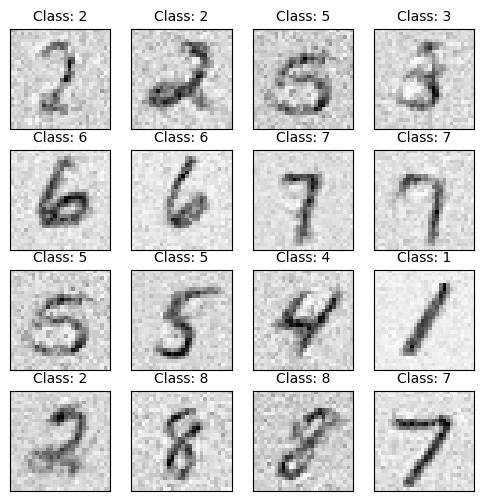

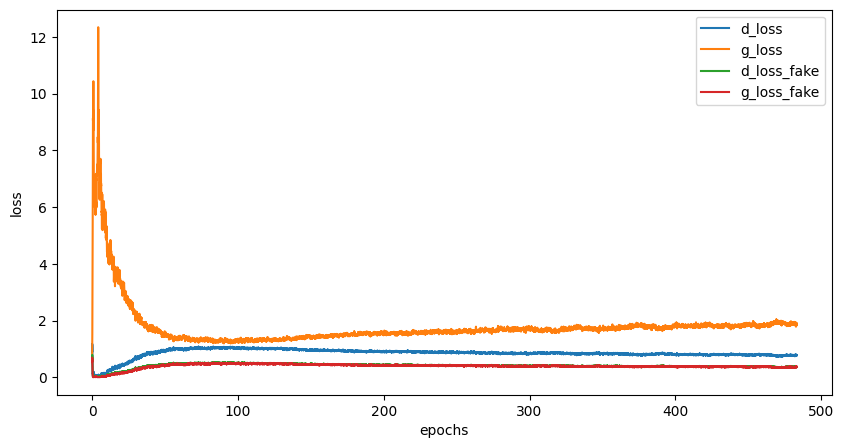

Epoch [484/500], Step[100/469], d_loss: 0.7124, d_loss_fake: 0.3461, g_loss: 1.8250, g_loss_fake: 0.3431, D(x): 0.75, D(G(z)): 0.25
Epoch [484/500], Step[200/469], d_loss: 0.7031, d_loss_fake: 0.2887, g_loss: 1.7900, g_loss_fake: 0.3479, D(x): 0.74, D(G(z)): 0.23
Epoch [484/500], Step[300/469], d_loss: 0.9100, d_loss_fake: 0.4135, g_loss: 1.7450, g_loss_fake: 0.3783, D(x): 0.71, D(G(z)): 0.28
Epoch [484/500], Step[400/469], d_loss: 0.6627, d_loss_fake: 0.3403, g_loss: 1.9569, g_loss_fake: 0.4022, D(x): 0.80, D(G(z)): 0.23


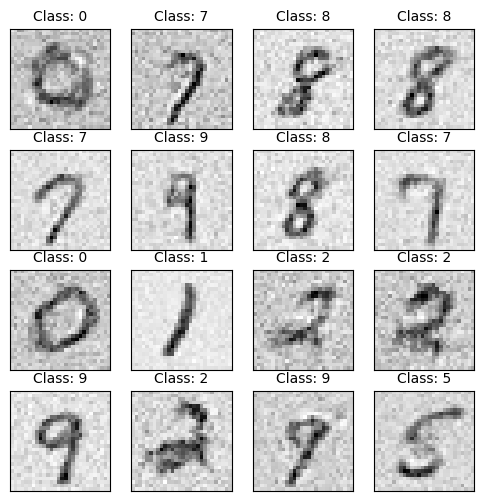

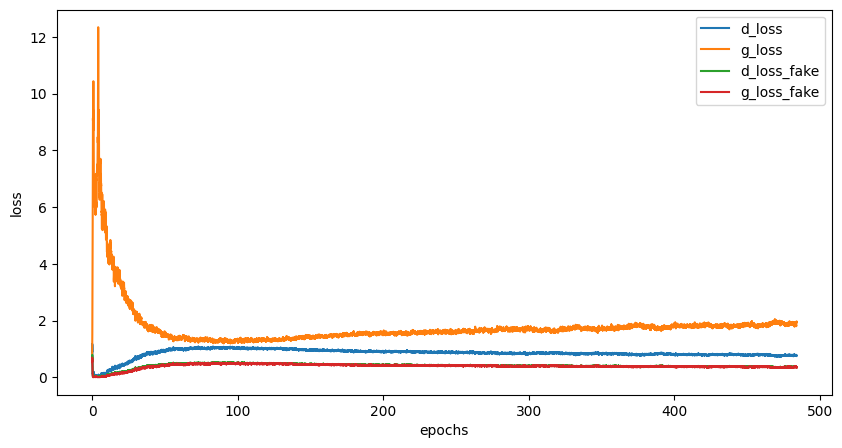

Epoch [485/500], Step[100/469], d_loss: 0.6829, d_loss_fake: 0.3638, g_loss: 1.8184, g_loss_fake: 0.3866, D(x): 0.81, D(G(z)): 0.27
Epoch [485/500], Step[200/469], d_loss: 0.7313, d_loss_fake: 0.3619, g_loss: 2.2863, g_loss_fake: 0.2842, D(x): 0.77, D(G(z)): 0.24
Epoch [485/500], Step[300/469], d_loss: 0.8871, d_loss_fake: 0.3774, g_loss: 1.9276, g_loss_fake: 0.3101, D(x): 0.70, D(G(z)): 0.26
Epoch [485/500], Step[400/469], d_loss: 0.7515, d_loss_fake: 0.3694, g_loss: 1.8939, g_loss_fake: 0.3570, D(x): 0.75, D(G(z)): 0.26


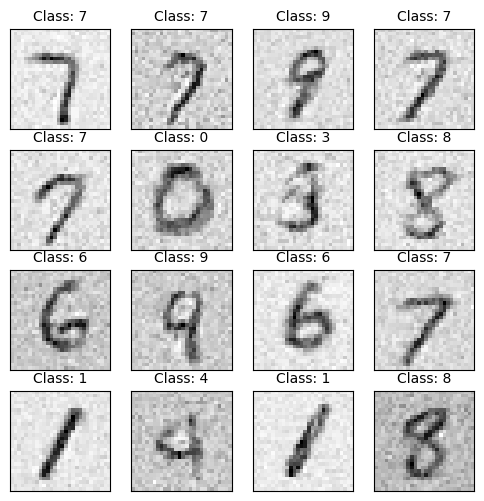

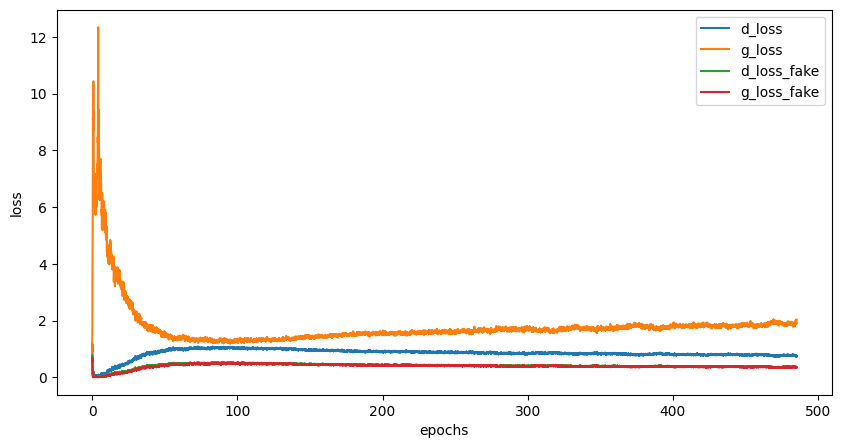

Epoch [486/500], Step[100/469], d_loss: 0.7679, d_loss_fake: 0.4165, g_loss: 1.8321, g_loss_fake: 0.3383, D(x): 0.78, D(G(z)): 0.29
Epoch [486/500], Step[200/469], d_loss: 0.7456, d_loss_fake: 0.3345, g_loss: 1.7708, g_loss_fake: 0.4470, D(x): 0.76, D(G(z)): 0.23
Epoch [486/500], Step[300/469], d_loss: 0.6899, d_loss_fake: 0.2644, g_loss: 1.8191, g_loss_fake: 0.3910, D(x): 0.74, D(G(z)): 0.19
Epoch [486/500], Step[400/469], d_loss: 0.7542, d_loss_fake: 0.2919, g_loss: 2.2765, g_loss_fake: 0.2390, D(x): 0.73, D(G(z)): 0.21


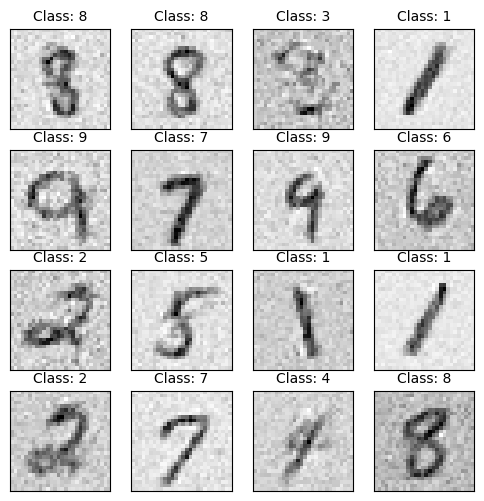

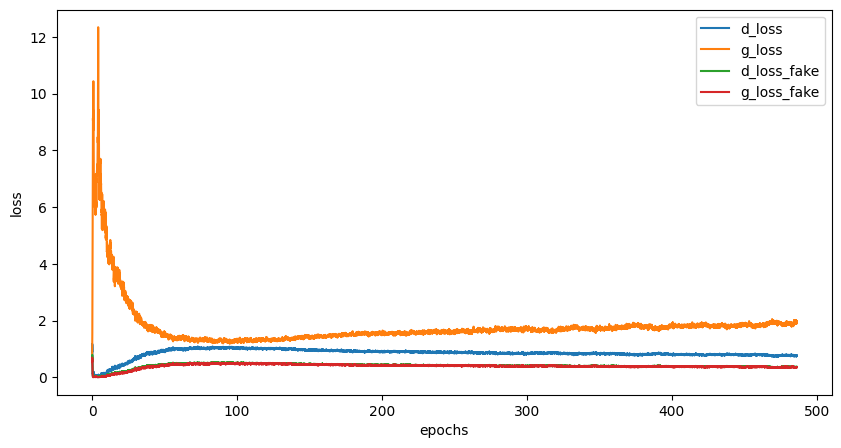

Epoch [487/500], Step[100/469], d_loss: 0.7519, d_loss_fake: 0.4089, g_loss: 1.8029, g_loss_fake: 0.4429, D(x): 0.80, D(G(z)): 0.25
Epoch [487/500], Step[200/469], d_loss: 0.8511, d_loss_fake: 0.4193, g_loss: 1.8889, g_loss_fake: 0.3072, D(x): 0.73, D(G(z)): 0.27
Epoch [487/500], Step[300/469], d_loss: 0.6956, d_loss_fake: 0.3368, g_loss: 1.6684, g_loss_fake: 0.4655, D(x): 0.79, D(G(z)): 0.23
Epoch [487/500], Step[400/469], d_loss: 0.7302, d_loss_fake: 0.3346, g_loss: 1.8030, g_loss_fake: 0.3430, D(x): 0.75, D(G(z)): 0.23


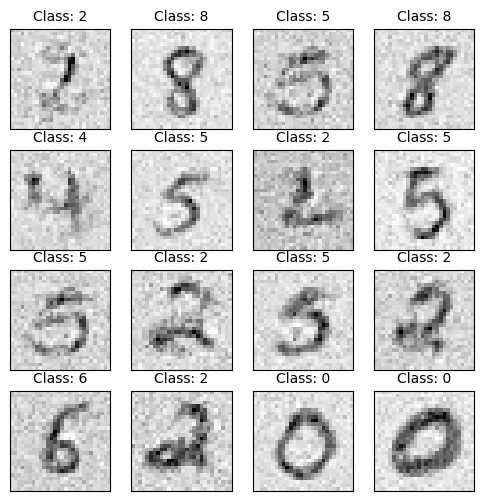

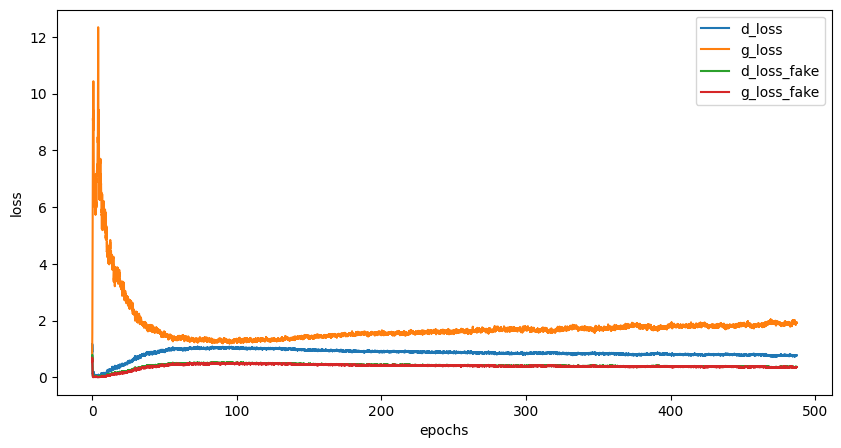

Epoch [488/500], Step[100/469], d_loss: 0.6839, d_loss_fake: 0.3500, g_loss: 1.9172, g_loss_fake: 0.3598, D(x): 0.79, D(G(z)): 0.24
Epoch [488/500], Step[200/469], d_loss: 0.8352, d_loss_fake: 0.3818, g_loss: 1.8643, g_loss_fake: 0.3472, D(x): 0.74, D(G(z)): 0.25
Epoch [488/500], Step[300/469], d_loss: 0.8269, d_loss_fake: 0.4789, g_loss: 2.0142, g_loss_fake: 0.3651, D(x): 0.78, D(G(z)): 0.29
Epoch [488/500], Step[400/469], d_loss: 0.6455, d_loss_fake: 0.3143, g_loss: 1.9219, g_loss_fake: 0.2990, D(x): 0.79, D(G(z)): 0.23


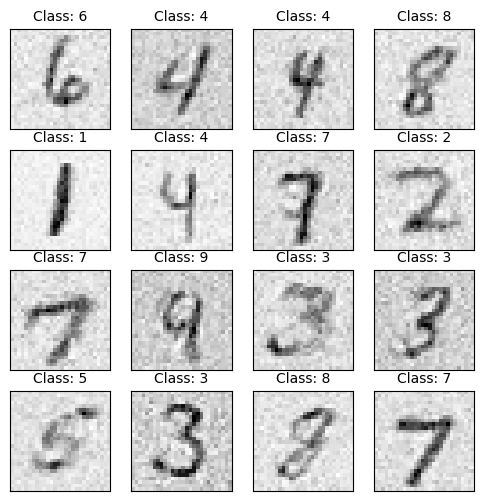

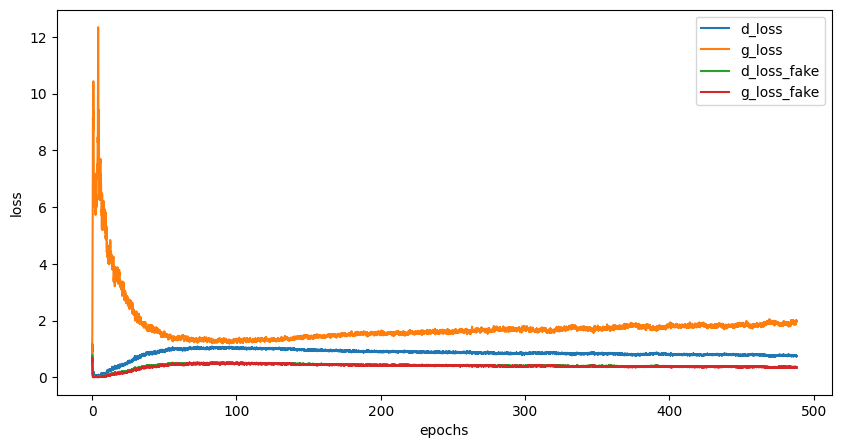

Epoch [489/500], Step[100/469], d_loss: 0.7977, d_loss_fake: 0.4059, g_loss: 2.1258, g_loss_fake: 0.3199, D(x): 0.77, D(G(z)): 0.26
Epoch [489/500], Step[200/469], d_loss: 0.7075, d_loss_fake: 0.3149, g_loss: 2.0975, g_loss_fake: 0.2598, D(x): 0.76, D(G(z)): 0.23
Epoch [489/500], Step[300/469], d_loss: 0.7758, d_loss_fake: 0.3569, g_loss: 1.8550, g_loss_fake: 0.4076, D(x): 0.75, D(G(z)): 0.24
Epoch [489/500], Step[400/469], d_loss: 0.7422, d_loss_fake: 0.3468, g_loss: 1.8696, g_loss_fake: 0.3426, D(x): 0.76, D(G(z)): 0.24


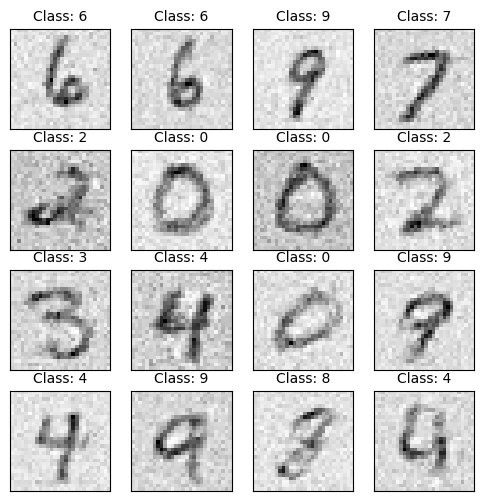

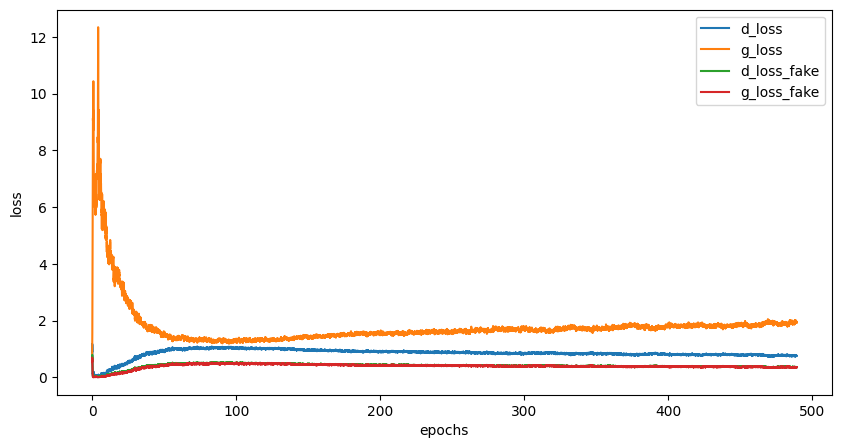

Epoch [490/500], Step[100/469], d_loss: 0.6496, d_loss_fake: 0.2992, g_loss: 1.9876, g_loss_fake: 0.4055, D(x): 0.79, D(G(z)): 0.21
Epoch [490/500], Step[200/469], d_loss: 0.8751, d_loss_fake: 0.3862, g_loss: 2.1933, g_loss_fake: 0.2959, D(x): 0.74, D(G(z)): 0.23
Epoch [490/500], Step[300/469], d_loss: 0.7518, d_loss_fake: 0.3226, g_loss: 1.6812, g_loss_fake: 0.3864, D(x): 0.73, D(G(z)): 0.23
Epoch [490/500], Step[400/469], d_loss: 0.6755, d_loss_fake: 0.3053, g_loss: 1.9984, g_loss_fake: 0.3326, D(x): 0.77, D(G(z)): 0.22


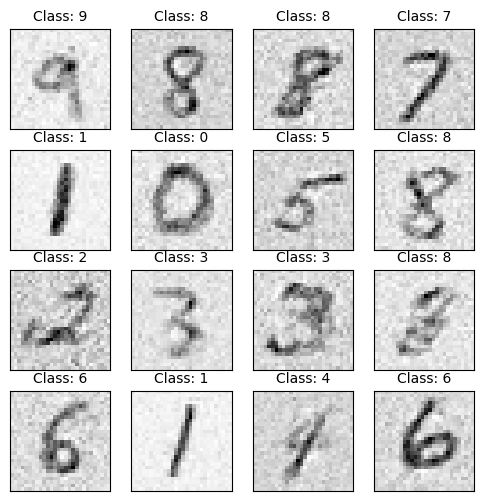

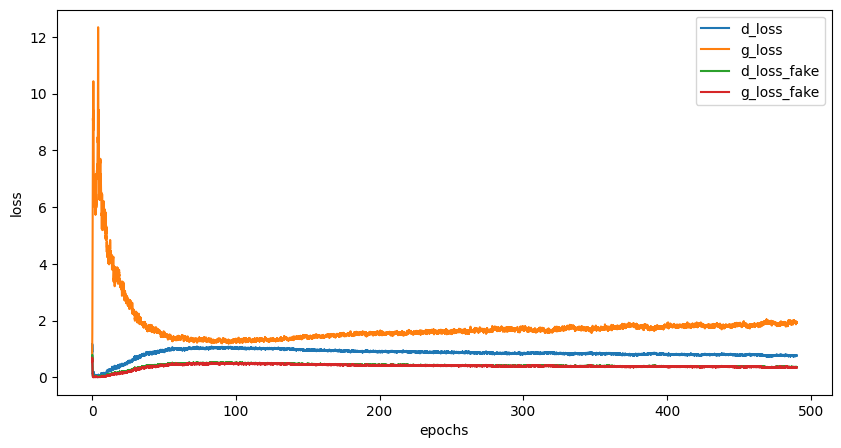

Epoch [491/500], Step[100/469], d_loss: 0.7888, d_loss_fake: 0.3923, g_loss: 1.7982, g_loss_fake: 0.3549, D(x): 0.76, D(G(z)): 0.26
Epoch [491/500], Step[200/469], d_loss: 0.8351, d_loss_fake: 0.4611, g_loss: 2.1343, g_loss_fake: 0.2921, D(x): 0.77, D(G(z)): 0.28
Epoch [491/500], Step[300/469], d_loss: 0.7348, d_loss_fake: 0.3273, g_loss: 2.0823, g_loss_fake: 0.2645, D(x): 0.75, D(G(z)): 0.21
Epoch [491/500], Step[400/469], d_loss: 0.7140, d_loss_fake: 0.3384, g_loss: 2.0715, g_loss_fake: 0.2479, D(x): 0.76, D(G(z)): 0.23


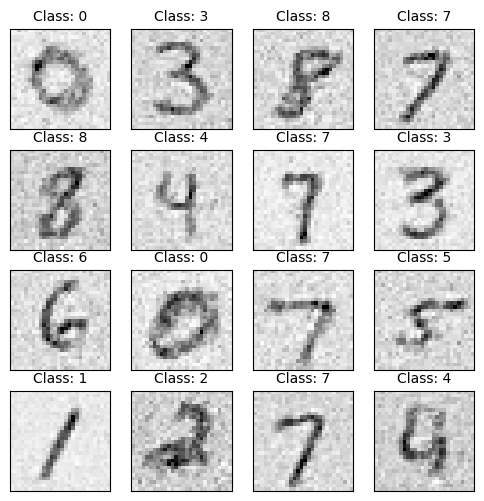

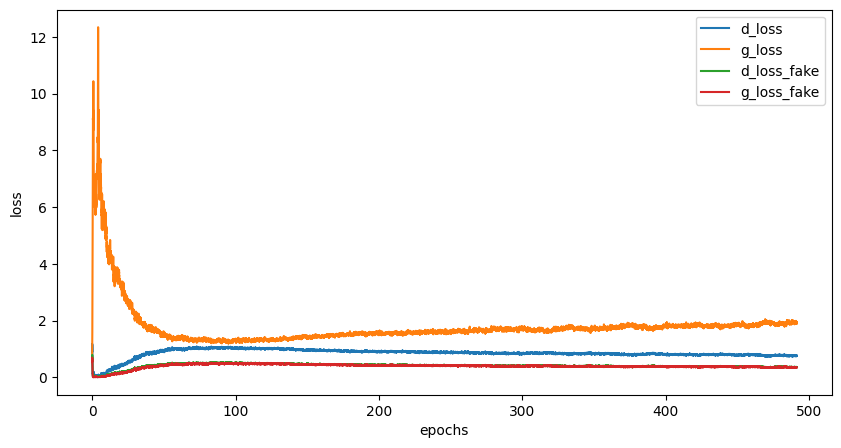

Epoch [492/500], Step[100/469], d_loss: 0.7614, d_loss_fake: 0.3687, g_loss: 1.8918, g_loss_fake: 0.3591, D(x): 0.75, D(G(z)): 0.26
Epoch [492/500], Step[200/469], d_loss: 0.7797, d_loss_fake: 0.3595, g_loss: 1.8830, g_loss_fake: 0.3375, D(x): 0.76, D(G(z)): 0.24
Epoch [492/500], Step[300/469], d_loss: 0.6663, d_loss_fake: 0.3251, g_loss: 1.8000, g_loss_fake: 0.4424, D(x): 0.79, D(G(z)): 0.23
Epoch [492/500], Step[400/469], d_loss: 0.8004, d_loss_fake: 0.3811, g_loss: 1.9946, g_loss_fake: 0.2987, D(x): 0.75, D(G(z)): 0.25


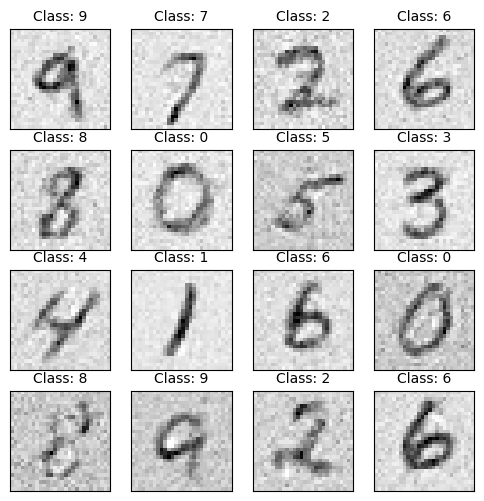

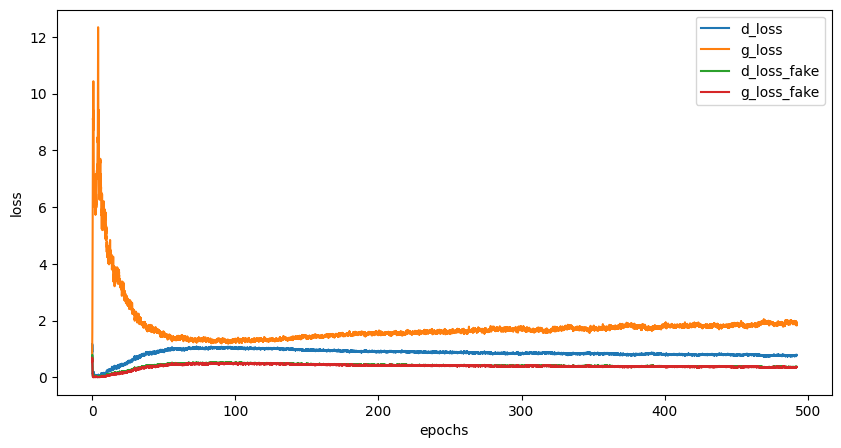

Epoch [493/500], Step[100/469], d_loss: 0.6998, d_loss_fake: 0.3192, g_loss: 1.7884, g_loss_fake: 0.3558, D(x): 0.77, D(G(z)): 0.22
Epoch [493/500], Step[200/469], d_loss: 0.8410, d_loss_fake: 0.4278, g_loss: 1.7859, g_loss_fake: 0.3706, D(x): 0.76, D(G(z)): 0.28
Epoch [493/500], Step[300/469], d_loss: 0.7309, d_loss_fake: 0.4401, g_loss: 1.6878, g_loss_fake: 0.4027, D(x): 0.80, D(G(z)): 0.28
Epoch [493/500], Step[400/469], d_loss: 0.6667, d_loss_fake: 0.2571, g_loss: 1.9241, g_loss_fake: 0.3081, D(x): 0.76, D(G(z)): 0.19


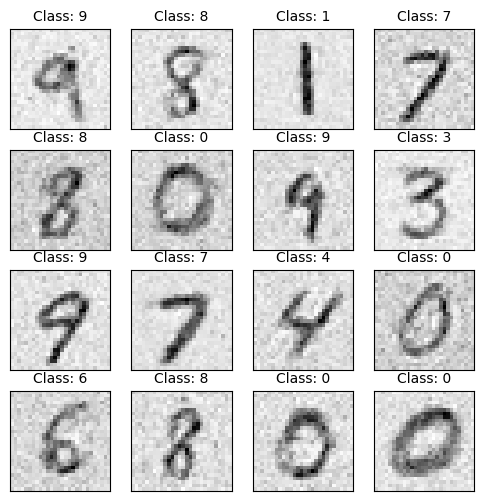

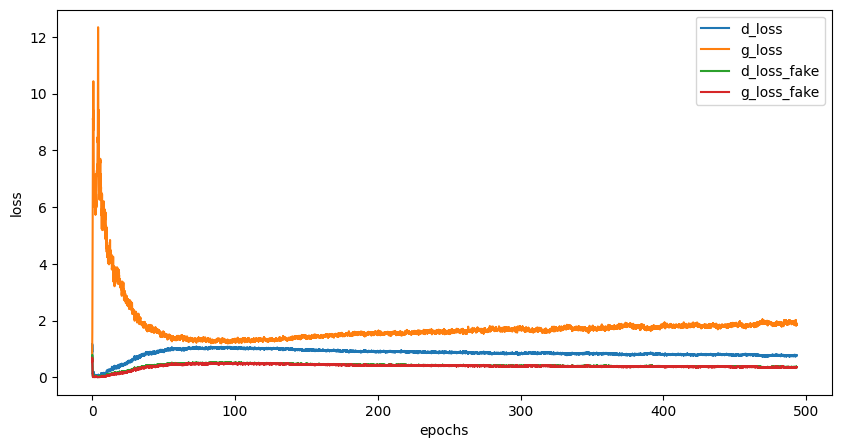

Epoch [494/500], Step[100/469], d_loss: 0.5907, d_loss_fake: 0.3149, g_loss: 1.8479, g_loss_fake: 0.3566, D(x): 0.82, D(G(z)): 0.23
Epoch [494/500], Step[200/469], d_loss: 0.7467, d_loss_fake: 0.3991, g_loss: 1.7348, g_loss_fake: 0.3825, D(x): 0.79, D(G(z)): 0.27
Epoch [494/500], Step[300/469], d_loss: 0.6826, d_loss_fake: 0.2826, g_loss: 1.7945, g_loss_fake: 0.3715, D(x): 0.75, D(G(z)): 0.22
Epoch [494/500], Step[400/469], d_loss: 0.7487, d_loss_fake: 0.3023, g_loss: 1.9781, g_loss_fake: 0.3373, D(x): 0.74, D(G(z)): 0.22


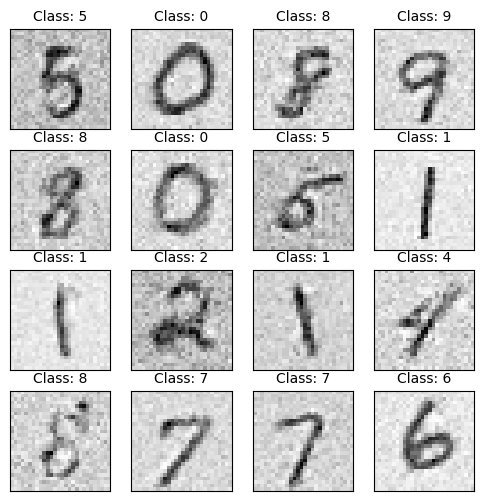

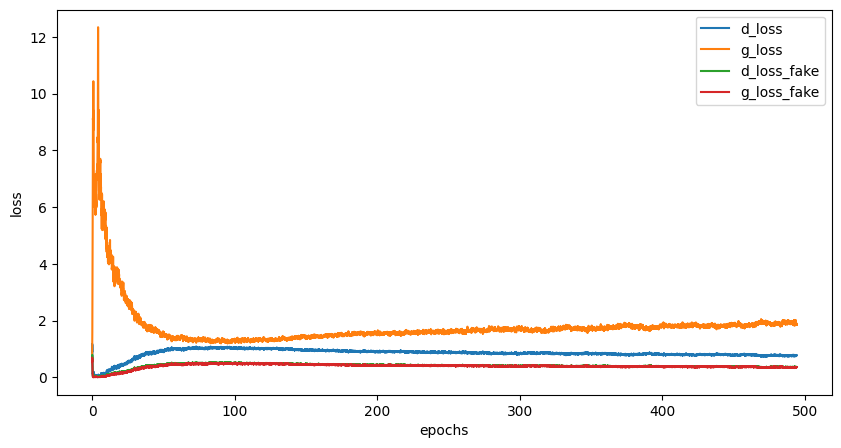

Epoch [495/500], Step[100/469], d_loss: 0.7329, d_loss_fake: 0.3968, g_loss: 1.7241, g_loss_fake: 0.3474, D(x): 0.80, D(G(z)): 0.28
Epoch [495/500], Step[200/469], d_loss: 0.7244, d_loss_fake: 0.3168, g_loss: 2.2678, g_loss_fake: 0.2913, D(x): 0.75, D(G(z)): 0.22
Epoch [495/500], Step[300/469], d_loss: 0.7778, d_loss_fake: 0.3949, g_loss: 1.6913, g_loss_fake: 0.4065, D(x): 0.77, D(G(z)): 0.26
Epoch [495/500], Step[400/469], d_loss: 0.7051, d_loss_fake: 0.3557, g_loss: 1.8374, g_loss_fake: 0.3241, D(x): 0.79, D(G(z)): 0.25


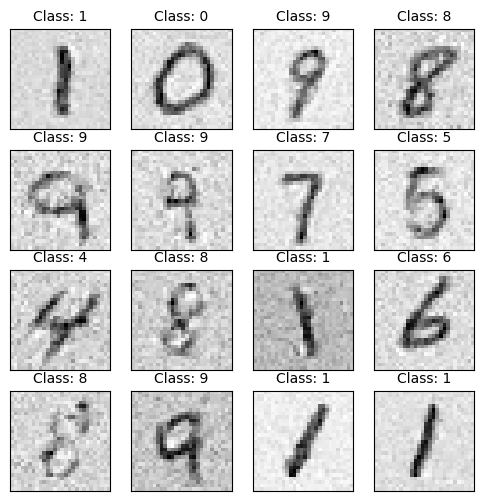

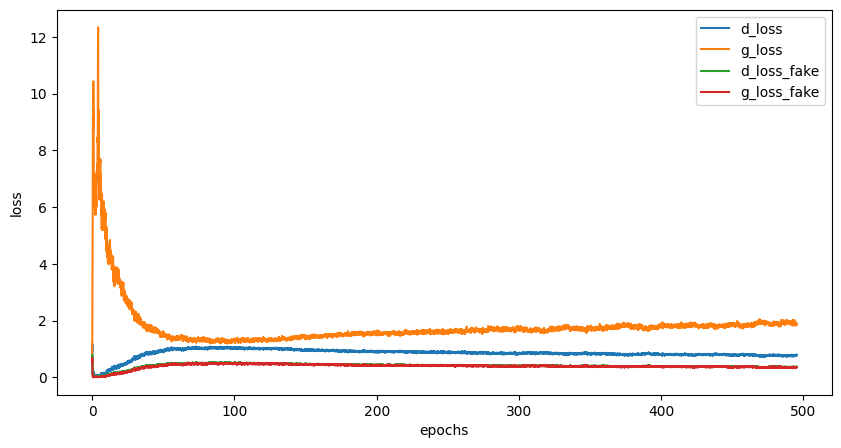

Epoch [496/500], Step[100/469], d_loss: 0.8122, d_loss_fake: 0.3499, g_loss: 2.0785, g_loss_fake: 0.3879, D(x): 0.73, D(G(z)): 0.23
Epoch [496/500], Step[200/469], d_loss: 0.7631, d_loss_fake: 0.3208, g_loss: 2.2279, g_loss_fake: 0.2860, D(x): 0.73, D(G(z)): 0.23
Epoch [496/500], Step[300/469], d_loss: 0.9459, d_loss_fake: 0.4298, g_loss: 1.8124, g_loss_fake: 0.4029, D(x): 0.71, D(G(z)): 0.28
Epoch [496/500], Step[400/469], d_loss: 0.7713, d_loss_fake: 0.3041, g_loss: 1.9370, g_loss_fake: 0.3416, D(x): 0.73, D(G(z)): 0.22


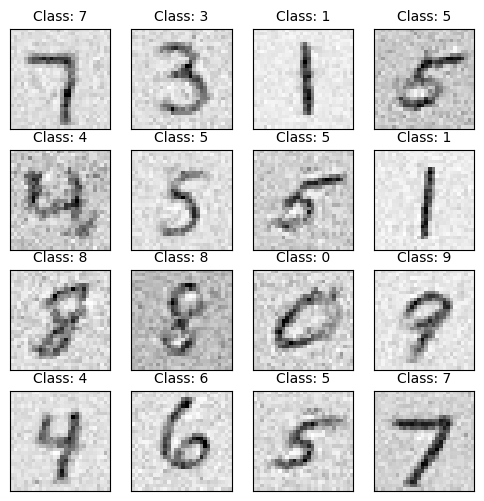

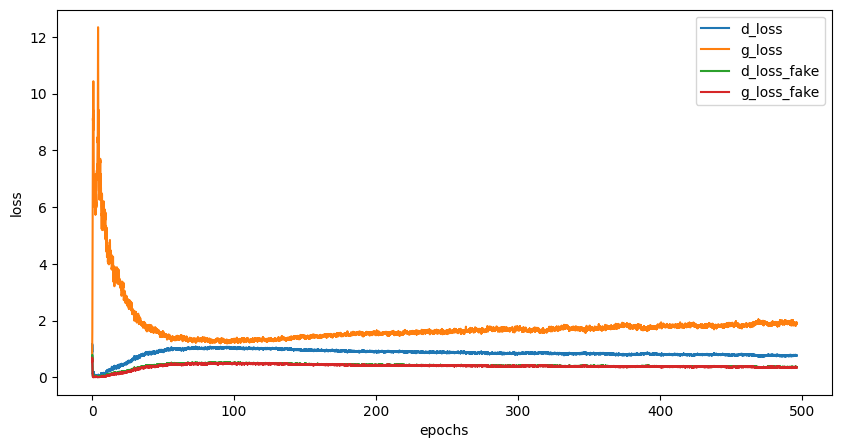

Epoch [497/500], Step[100/469], d_loss: 0.7195, d_loss_fake: 0.3165, g_loss: 1.9748, g_loss_fake: 0.3402, D(x): 0.77, D(G(z)): 0.22
Epoch [497/500], Step[200/469], d_loss: 0.6787, d_loss_fake: 0.3420, g_loss: 1.6846, g_loss_fake: 0.3607, D(x): 0.78, D(G(z)): 0.24
Epoch [497/500], Step[300/469], d_loss: 0.9399, d_loss_fake: 0.3912, g_loss: 1.9147, g_loss_fake: 0.3510, D(x): 0.69, D(G(z)): 0.27
Epoch [497/500], Step[400/469], d_loss: 0.6638, d_loss_fake: 0.3598, g_loss: 1.8044, g_loss_fake: 0.3294, D(x): 0.80, D(G(z)): 0.26


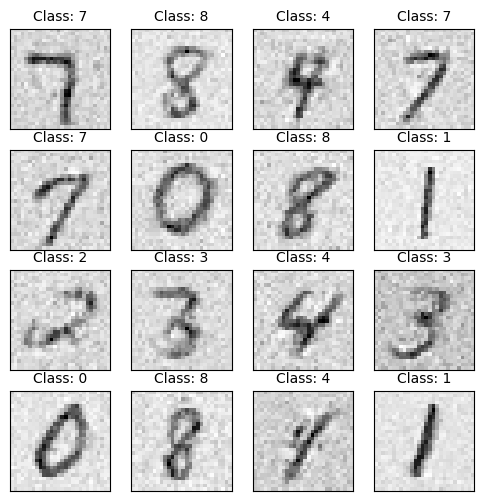

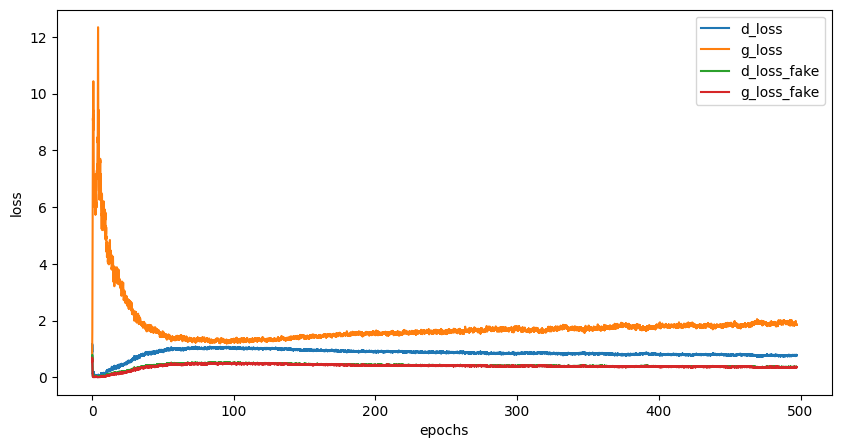

Epoch [498/500], Step[100/469], d_loss: 0.7454, d_loss_fake: 0.3876, g_loss: 1.9630, g_loss_fake: 0.2948, D(x): 0.79, D(G(z)): 0.25
Epoch [498/500], Step[200/469], d_loss: 0.6923, d_loss_fake: 0.3268, g_loss: 1.9432, g_loss_fake: 0.3363, D(x): 0.76, D(G(z)): 0.23
Epoch [498/500], Step[300/469], d_loss: 0.7495, d_loss_fake: 0.3396, g_loss: 1.8069, g_loss_fake: 0.3442, D(x): 0.77, D(G(z)): 0.23
Epoch [498/500], Step[400/469], d_loss: 0.7105, d_loss_fake: 0.3304, g_loss: 1.9723, g_loss_fake: 0.3256, D(x): 0.76, D(G(z)): 0.23


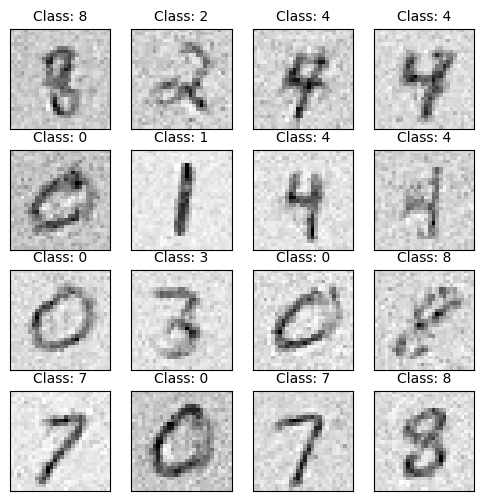

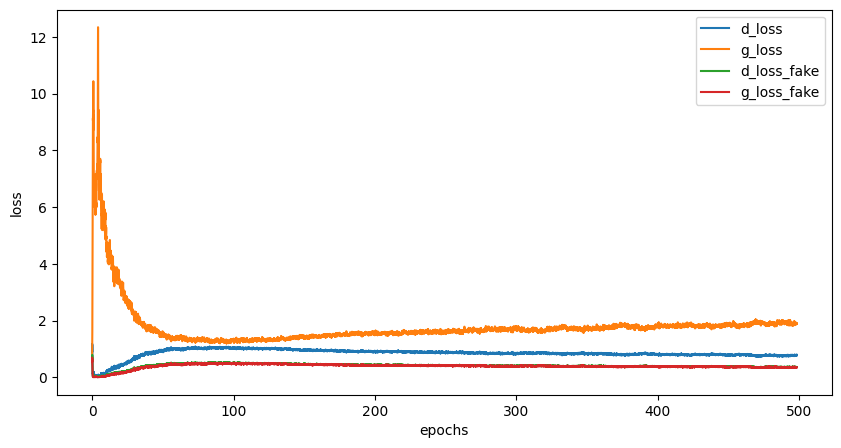

Epoch [499/500], Step[100/469], d_loss: 0.6159, d_loss_fake: 0.3606, g_loss: 1.7891, g_loss_fake: 0.3614, D(x): 0.83, D(G(z)): 0.24
Epoch [499/500], Step[200/469], d_loss: 0.6569, d_loss_fake: 0.2850, g_loss: 2.0156, g_loss_fake: 0.2914, D(x): 0.77, D(G(z)): 0.20
Epoch [499/500], Step[300/469], d_loss: 0.7810, d_loss_fake: 0.4842, g_loss: 1.6505, g_loss_fake: 0.4183, D(x): 0.81, D(G(z)): 0.32
Epoch [499/500], Step[400/469], d_loss: 0.6133, d_loss_fake: 0.3357, g_loss: 2.0148, g_loss_fake: 0.3229, D(x): 0.81, D(G(z)): 0.24


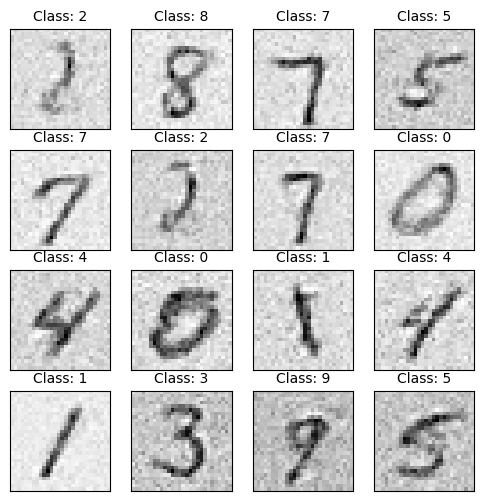

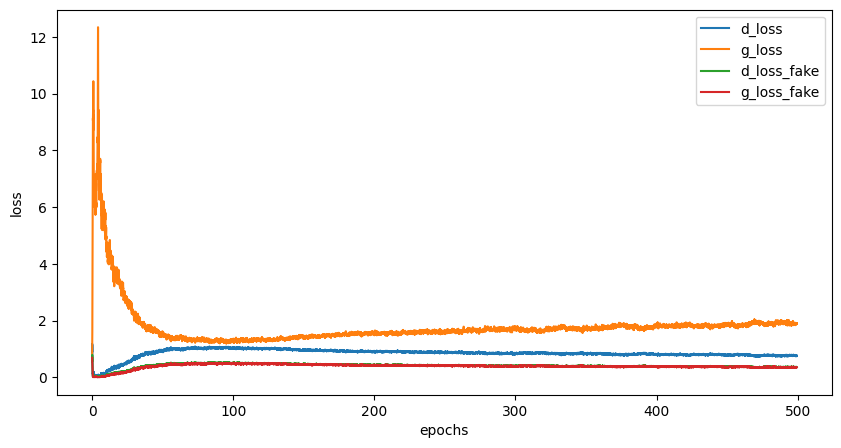

Epoch [500/500], Step[100/469], d_loss: 0.7626, d_loss_fake: 0.4429, g_loss: 2.1125, g_loss_fake: 0.3004, D(x): 0.80, D(G(z)): 0.28
Epoch [500/500], Step[200/469], d_loss: 0.7969, d_loss_fake: 0.3601, g_loss: 2.0822, g_loss_fake: 0.3311, D(x): 0.75, D(G(z)): 0.24
Epoch [500/500], Step[300/469], d_loss: 0.7018, d_loss_fake: 0.3776, g_loss: 1.6394, g_loss_fake: 0.4300, D(x): 0.79, D(G(z)): 0.25
Epoch [500/500], Step[400/469], d_loss: 0.7622, d_loss_fake: 0.3685, g_loss: 1.9794, g_loss_fake: 0.4136, D(x): 0.77, D(G(z)): 0.25


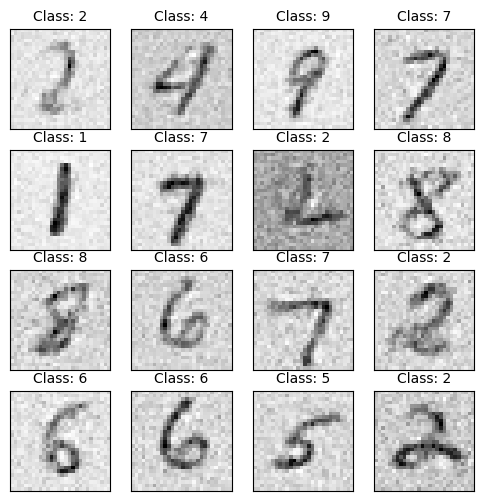

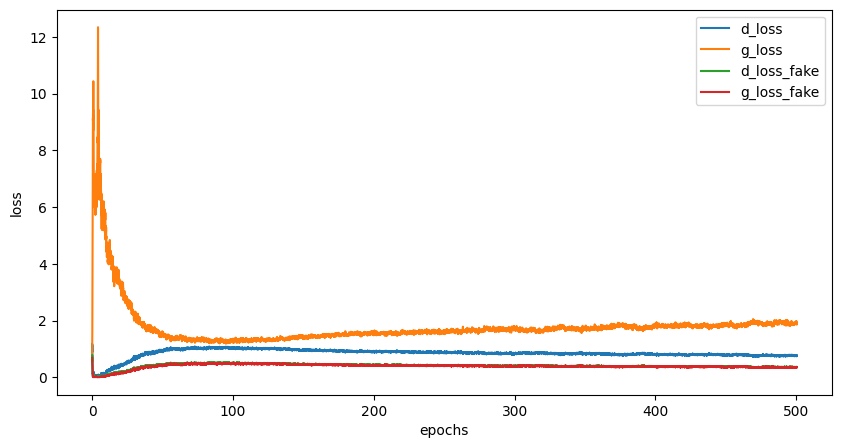

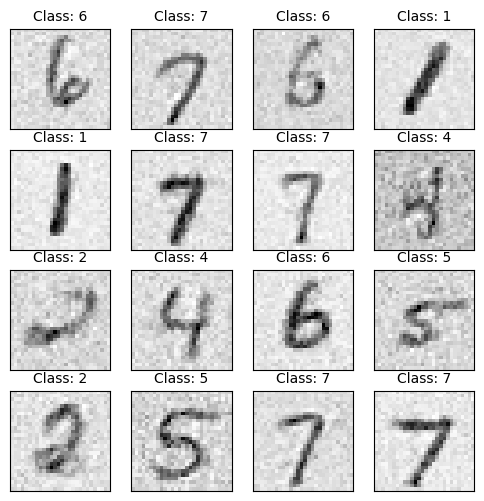

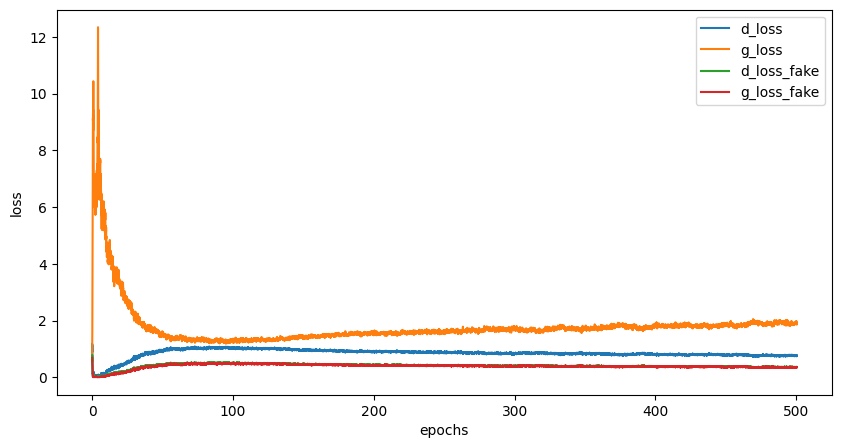

In [137]:
num_epochs = 500
dim_z = 100

num_test_samples = 16
test_noise = Variable(torch.randn(num_test_samples, dim_z).to(device))
d_freq = 1

with_condition = True

discriminator = Discriminator(with_condition=with_condition).to(device)
generator = Generator(with_condition=with_condition).to(device)

lr = 0.0002
d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=lr)
g_optimizer = torch.optim.Adam(generator.parameters(), lr=lr)

d_losses, d_losses_fake, g_losses, g_losses_fake = train_main_loop(generator, discriminator, d_optimizer, g_optimizer, test_noise, num_epochs, d_freq, with_condition)
monitor_images(generator, test_noise, with_condition=with_condition)
monitor_losses(d_losses, d_losses_fake, g_losses, g_losses_fake)